# Problem Set 5, due Nov 13 at 11:59pm.

As usual, you are highly encouraged to start this problem set early.  You have considerable flexibility in how creative you wish to be with this problem set.

## Part 1: Exploring the Titanic

Your mission for this problem set is to use your knowledge of supervised machine learning to try to predict which passengers aboard the Titanic were most likely to survive. The prompts for this part of the problem set are deliberately vague - the goal is to leave it up to you how to structure (most of) your analysis.

To get started, read about the prediction problem on [Kaggle](https://www.kaggle.com/c/titanic). Then, download the data [here](https://www.kaggle.com/c/titanic/data) - you'll want at least the train and test data, maybe more.

### 1.1 Exploratory data analysis

Create 2-3 figures and tables that help give you a feel for the data. Make sure to at least check the data type of each variable, to understand which variables have missing observations (and to formulate a plan for dealing with them), and to understand the distribution of each variable (and determine whether the variables should be normalized or not). Are any variables collinear or highly correlated?

### Dataset dictionary
| Variable |                  Definition                |                                            Key |
|---------:|-------------------------------------------:|-----------------------------------------------:|
| survival |                                   Survival |                                0 = No, 1 = Yes |
|   pclass |                               Ticket class |                      1 = 1st, 2 = 2nd, 3 = 3rd |
|      sex |                                        Sex |                                                |
|      Age |                               Age in years |                                                |
|    sibsp | # of siblings / spouses aboard the Titanic |                                                |
|    parch | # of parents / children aboard the Titanic |                                                |
|   ticket |                              Ticket number |                                                |
|     fare |                             Passenger fare |                                                |
|    cabin |                               Cabin number |                                                |
| embarked |                        Port of Embarkation | C = Cherbourg, Q = Queenstown, S = Southampton |

### Variable Notes

- $pclass$: A proxy for socio-economic status (SES)
1st = Upper,
2nd = Middle,
3rd = Lower

- $age$: Age is fractional if less than 1. If the age is estimated, is it in the form of xx.5

- $sibsp$: The dataset defines family relations in this way...
  - Sibling = brother, sister, stepbrother, stepsister
  - Spouse = husband, wife (mistresses and fiancés were ignored)

- $parch$: The dataset defines family relations in this way...
  - Parent = mother, father
  - Child = daughter, son, stepdaughter, stepson
  - Some children travelled only with a nanny, therefore $parch = 0$ for them.

# Two main approaches are performed in this problem set:
## Version 1: full train.csv as training set
> In this approach, we will use the 892 entries as our full training set for fitting and optimizing the models using the 10-fold CV approach. Then, we will compare the accuracy of the models using the testing dataset contained in the test.csv file from Kaggle and we will report their accuracies by uploading a series of .csv files in the Kaggle website in order to perform a consistent and coherent analysis.

## Version 2: 80% of train.csv as training set and 20% as testing set
> In this case, we will split the train.csv file into a training set (80% ) and a testing set (20%). This is due to the fact that we do not know the true labels of the test.csv observations and thus, it is not possible to conduct a formal error analysis. All the code for this version is included at the end of the problem set for simplicity since it is a simple repetition of the code used for version one, with the only difference of having a different training set containing 80% of the observations from train.csv.

In [1]:
# Importations
import IPython
import scipy as sp
import pandas as pd
import numpy as np
import sklearn
import time

import matplotlib
%matplotlib inline  
import matplotlib.pyplot as plt  

import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import statsmodels.formula.api as smf

c:\python36\lib\site-packages\statsmodels\compat\pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


In [2]:
# Function that creates a Kaggle file (for checking testing data accuracy)
def createKaggleFile(y_hat, filename):
    # Create a file
    filename = filename + ".csv"
    file = open(filename, "w")
    
    # Write content
    file.write("PassengerId,Survived\n") 
    
    for i in range(892, 1310):
        file.write(str(i) + "," + str(int(y_hat[i - 892])) + "\n")
        
    # Close the connection
    file.close()

In [3]:
# Load Train and Test sets
TrainSet = pd.read_csv("train.csv", sep = ",")
display(TrainSet.head())
r, c = TrainSet.shape
OrigVar = TrainSet.columns
print("Training set contains", r, "observations and", c, "variables")

TestSet = pd.read_csv("test.csv", sep = ",")
display(TestSet.head())
r2, c2 = TestSet.shape
print("Testing set contains", r2, "observations and", c2, "variables")

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S


Training set contains 891 observations and 12 variables


,PassengerId,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,892,3,"Kelly, Mr. James",male,34.5,0,0,330911,7.8292,NaN,Q
1,893,3,"Wilkes, Mrs. James (Ellen Needs)",female,47.0,1,0,363272,7.0000,NaN,S
2,894,2,"Myles, Mr. Thomas Francis",male,62.0,0,0,240276,9.6875,NaN,Q
3,895,3,"Wirz, Mr. Albert",male,27.0,0,0,315154,8.6625,NaN,S
4,896,3,"Hirvonen, Mrs. Alexander (Helga E Lindqvist)",female,22.0,1,1,3101298,12.2875,NaN,S


Testing set contains 418 observations and 11 variables


In [4]:
## Exploratory analysis (Initial Summary)
# Variable types and initial summary
print("Training set: Initial analysis")
display(TrainSet.dtypes)
display(np.round(TrainSet.describe(), 3))

print("\nTesting set: Initial analysis")
display(TestSet.dtypes)
display(np.round(TestSet.describe(), 3))

Training set: Initial analysis


PassengerId      int64
Survived         int64
Pclass           int64
Name            object
Sex             object
Age            float64
SibSp            int64
Parch            int64
Ticket          object
Fare           float64
Cabin           object
Embarked        object
dtype: object

,PassengerId,Survived,Pclass,Age,SibSp,Parch,Fare
count,891.000,891.000,891.000,714.000,891.000,891.000,891.000
mean,446.000,0.384,2.309,29.699,0.523,0.382,32.204
std,257.354,0.487,0.836,14.526,1.103,0.806,49.693
min,1.000,0.000,1.000,0.420,0.000,0.000,0.000
25%,223.500,0.000,2.000,20.125,0.000,0.000,7.910
50%,446.000,0.000,3.000,28.000,0.000,0.000,14.454
75%,668.500,1.000,3.000,38.000,1.000,0.000,31.000
max,891.000,1.000,3.000,80.000,8.000,6.000,512.329



Testing set: Initial analysis


PassengerId      int64
Pclass           int64
Name            object
Sex             object
Age            float64
SibSp            int64
Parch            int64
Ticket          object
Fare           float64
Cabin           object
Embarked        object
dtype: object

,PassengerId,Pclass,Age,SibSp,Parch,Fare
count,418.00,418.000,332.000,418.000,418.000,417.000
mean,1100.50,2.266,30.273,0.447,0.392,35.627
std,120.81,0.842,14.181,0.897,0.981,55.908
min,892.00,1.000,0.170,0.000,0.000,0.000
25%,996.25,1.000,21.000,0.000,0.000,7.896
50%,1100.50,3.000,27.000,0.000,0.000,14.454
75%,1204.75,3.000,39.000,1.000,0.000,31.500
max,1309.00,3.000,76.000,8.000,9.000,512.329


In [5]:
# Missing values
# Rows
# Training set
print("Training set")
print("There are " + str( - len(TrainSet.dropna()) + len(TrainSet)) + " rows with missing values in the Training set.")

# Testing set
print("\nTesting set")
print("There are " + str( - len(TestSet.dropna()) + len(TestSet)) + " rows with missing values in the Testing set.")

# Individual analysis (per feature)
print("\nIndividual analysis: Missing values per column")
display(TrainSet.isnull().sum())
display(TestSet.isnull().sum())

Training set
There are 708 rows with missing values in the Training set.

Testing set
There are 331 rows with missing values in the Testing set.

Individual analysis: Missing values per column


PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64

PassengerId      0
Pclass           0
Name             0
Sex              0
Age             86
SibSp            0
Parch            0
Ticket           0
Fare             1
Cabin          327
Embarked         0
dtype: int64

In [6]:
# Transformations 
# String to numerical (Sex: Male = 0, Female = 1)
TrainSet["Sex"] = TrainSet["Sex"].replace(["male", "female"], [0, 1])
TestSet["Sex"] = TestSet["Sex"].replace(["male", "female"], [0, 1])

# String to numerical (Embarked: C = 0, Q = 1, S = 2)
TrainSet["Embarked"] = TrainSet["Embarked"].replace(["C", "Q", "S"], [0, 1, 2])
TestSet["Embarked"] = TestSet["Embarked"].replace(["C", "Q", "S"], [0, 1, 2])

# Check new state
display(TrainSet.head())
print("Training set")
display(TestSet.head())
print("\nTesting set")

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",0,22.0,1,0,A/5 21171,7.2500,NaN,2.0
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",1,38.0,1,0,PC 17599,71.2833,C85,0.0
2,3,1,3,"Heikkinen, Miss. Laina",1,26.0,0,0,STON/O2. 3101282,7.9250,NaN,2.0
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",1,35.0,1,0,113803,53.1000,C123,2.0
4,5,0,3,"Allen, Mr. William Henry",0,35.0,0,0,373450,8.0500,NaN,2.0


Training set


,PassengerId,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,892,3,"Kelly, Mr. James",0,34.5,0,0,330911,7.8292,NaN,1
1,893,3,"Wilkes, Mrs. James (Ellen Needs)",1,47.0,1,0,363272,7.0000,NaN,2
2,894,2,"Myles, Mr. Thomas Francis",0,62.0,0,0,240276,9.6875,NaN,1
3,895,3,"Wirz, Mr. Albert",0,27.0,0,0,315154,8.6625,NaN,2
4,896,3,"Hirvonen, Mrs. Alexander (Helga E Lindqvist)",1,22.0,1,1,3101298,12.2875,NaN,2



Testing set


In [7]:
# Groupby plots function
def GroupbyPlot(n, labels, X, data1, data0, Title):
    # General settings
    # Figure size
    plt.figure(1)
    plt.figure(figsize = (9, 5)) 

    # Font sizes
    plt.rcParams['font.size'] = 14
    plt.rcParams['axes.labelsize'] = 14
    plt.rcParams['axes.titlesize'] = 16
    plt.rcParams['xtick.labelsize'] = 12
    plt.rcParams['ytick.labelsize'] = 12
    plt.rcParams['legend.fontsize'] = 10
    plt.rcParams['figure.titlesize'] = 12

    # axes
    ax = plt.subplot(111)                    
    ax.spines["top"].set_visible(False)  
    ax.spines["right"].set_visible(False)
    ax.get_xaxis().tick_bottom()  
    ax.get_yaxis().tick_left() 

    # Frequencies          
    FREQ_NIVE_L1 = data1[X].value_counts()
    FREQ_NIVE_L0 = data0[X].value_counts()
    n_groups = n

    index = np.arange(n_groups)
    bar_width = 0.35
    opacity = 0.5

    rects1 = plt.bar(index, FREQ_NIVE_L0, bar_width,
                     alpha=opacity,
                     color='b', 
                     label='Survived = 0')

    rects2 = plt.bar(index + bar_width, FREQ_NIVE_L1, bar_width,
                     alpha=opacity,
                     color='r',
                     label='Survived = 1')

    # Labels, Title, and legends
    plt.xlabel(Title)
    plt.ylabel('Frequency')
    plt.title(Title + 'vs Label')
    plt.xticks(index + bar_width/2, labels)
    plt.legend()

    plt.tight_layout()
    plt.show()
    
# Data
TrainSet_Label1 = TrainSet[TrainSet["Survived"] == 1]
TrainSet_Label0 = TrainSet[TrainSet["Survived"] == 0]

print("Frequencies per variable (Survived = 1)")
print("Frequency Ticket class:\n", TrainSet_Label1['Pclass'].value_counts())
print("\nFrequency Sex:\n", TrainSet_Label1['Sex'].value_counts())
print("\nFrequency Siblings/Spouses:\n", TrainSet_Label1['SibSp'].value_counts())
print("\nFrequency Parents/Children:\n", TrainSet_Label1['Parch'].value_counts())
print("\nFrequency Port (embarked):\n", TrainSet_Label1['Embarked'].value_counts())    

Frequencies per variable (Survived = 1)
Frequency Ticket class:
 1    136
3    119
2     87
Name: Pclass, dtype: int64

Frequency Sex:
 1    233
0    109
Name: Sex, dtype: int64

Frequency Siblings/Spouses:
 0    210
1    112
2     13
3      4
4      3
Name: SibSp, dtype: int64

Frequency Parents/Children:
 0    233
1     65
2     40
3      3
5      1
Name: Parch, dtype: int64

Frequency Port (embarked):
 2.0    217
0.0     93
1.0     30
Name: Embarked, dtype: int64


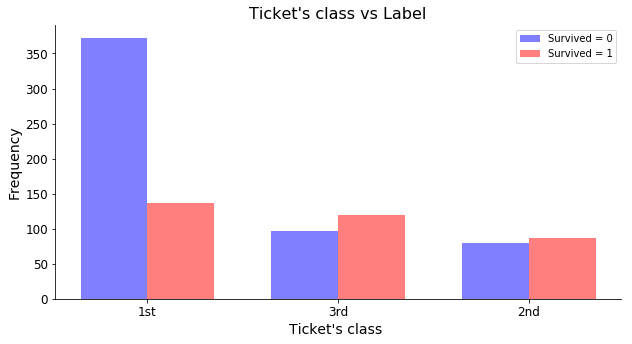

In [8]:
# Ticket's class vs label    
n = 3
labels = ('1st', '3rd', '2nd')
X = 'Pclass'
Title = 'Ticket\'s class '
GroupbyPlot(n, labels, X, TrainSet_Label1, TrainSet_Label0, Title)    

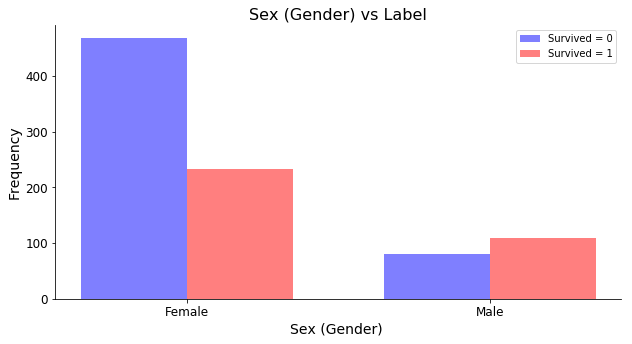

In [9]:
# Gender vs label    
n = 2
labels = ('Female', 'Male')
X = 'Sex'
Title = 'Sex (Gender) '
GroupbyPlot(n, labels, X, TrainSet_Label1, TrainSet_Label0, Title)    

array([1, 0, 3, 4, 2, 5, 8], dtype=int64)

array([1, 0, 4, 3, 2], dtype=int64)

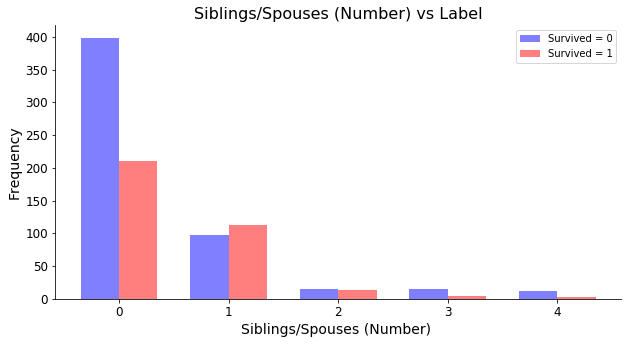

In [89]:
# Siblings/Spouses vs label    
n = 5
labels = ('0', '1', '2', '3', '4')

display(TrainSet_Label0["SibSp"].unique())
display(TrainSet_Label1["SibSp"].unique())

TrainSet_Label0aux = TrainSet_Label0.loc[TrainSet_Label0['SibSp'].isin(labels)]

X = 'SibSp'
Title = 'Siblings/Spouses (Number) '
GroupbyPlot(n, labels, X, TrainSet_Label1, TrainSet_Label0aux, Title)    


array([0, 1, 5, 2, 3, 4, 6], dtype=int64)

array([0, 2, 1, 5, 3], dtype=int64)

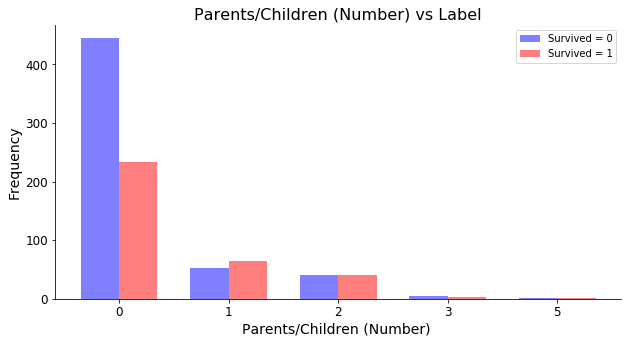

In [88]:
# Parents/Children vs label    
n = 5
labels = ('0', '1', '2', '3', '5')

display(TrainSet_Label0["Parch"].unique())
display(TrainSet_Label1["Parch"].unique())

TrainSet_Label0aux = TrainSet_Label0.loc[TrainSet_Label0['Parch'].isin(labels)]

X = 'Parch'
Title = 'Parents/Children (Number) '
GroupbyPlot(n, labels, X, TrainSet_Label1, TrainSet_Label0aux, Title)    

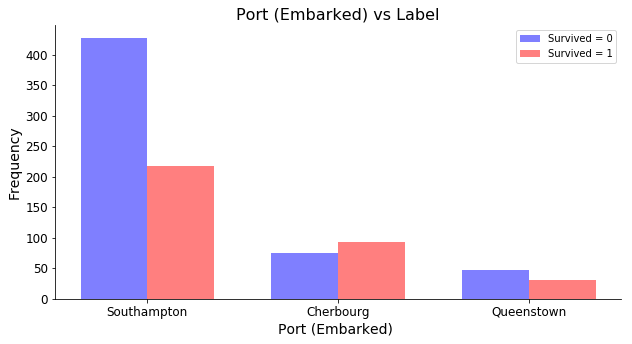

In [12]:
# Port (Embarked) vs label    
n = 3
labels = ('Southampton', 'Cherbourg', 'Queenstown')
X = 'Embarked'
Title = 'Port (Embarked) '
GroupbyPlot(n, labels, X, TrainSet_Label1, TrainSet_Label0, Title)   

Mean value (Training set): 29.6991176471
Mean value (Testing set): 30.2725903614


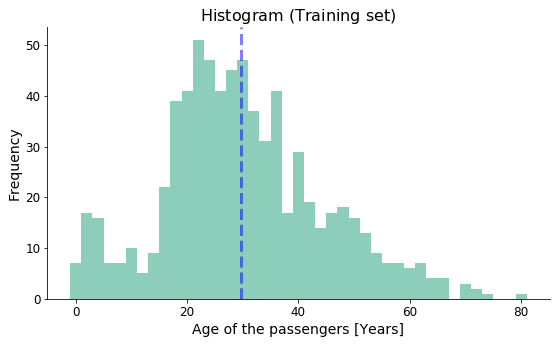

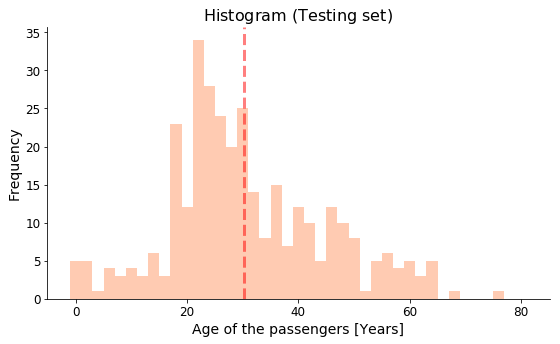

In [13]:
## Histogram (Age)
# General settings
# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Figure size
plt.figure(1)
plt.figure(figsize = (9, 5)) 

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# edit the code below to make the graph look good
plt.title(r'$\mathrm{Histogram\ (Training\ set)}$')
plt.xlabel(r'Age of the passengers [Years]')
plt.ylabel(r'Frequency')

# change binsize (array)
binsize = np.arange(-1.0, 83.0, 2)

# plot
plt.hist(TrainSet["Age"].dropna(), bins = binsize,  color = '#1b9e77', alpha = 0.5)
plt.axvline(np.mean(TrainSet["Age"].dropna()), color = 'b', linestyle = 'dashed', 
            linewidth = 3, alpha = 0.5)

print("Mean value (Training set):", np.mean(TrainSet["Age"].dropna()))


# Figure number and size
plt.figure(2)
plt.figure(figsize = (9, 5)) 

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# edit the code below to make the graph look good
plt.title(r'$\mathrm{Histogram\ (Testing\ set)}$')
plt.xlabel(r'Age of the passengers [Years]')
plt.ylabel(r'Frequency')

# change binsize (array)
binsize = np.arange(-1.0, 83.0, 2)

# plot
plt.hist(TestSet["Age"].dropna(), bins = binsize,  color = '#ff9966', alpha = 0.5)
plt.axvline(np.mean(TestSet["Age"].dropna()), color = 'r', linestyle = 'dashed', 
            linewidth = 3, alpha = 0.5)

print("Mean value (Testing set):", np.mean(TestSet["Age"].dropna()))

Mean value (Training set): 32.2042079686
Mean value (Testing set): 35.6271884892


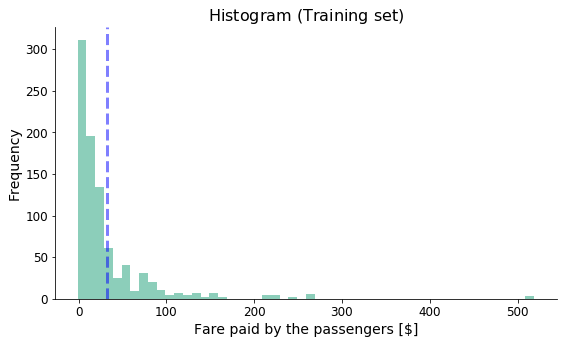

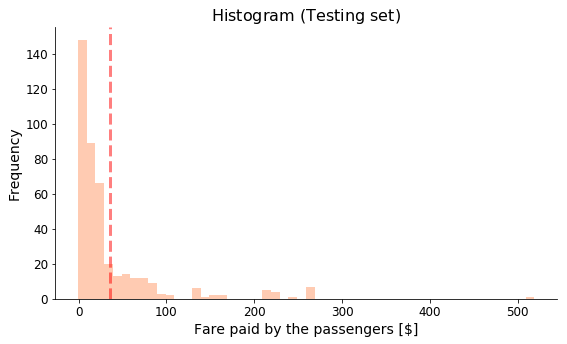

In [91]:
## Histogram (Fare)
# General settings
# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Figure size
plt.figure(1)
plt.figure(figsize = (9, 5)) 

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# edit the code below to make the graph look good
plt.title(r'$\mathrm{Histogram\ (Training\ set)}$')
plt.xlabel(r'Fare paid by the passengers [$]')
plt.ylabel(r'Frequency')

# change binsize (array)
binsize = np.arange(-1.0, 520.0, 10)

# plot
plt.hist(TrainSet["Fare"].dropna(), bins = binsize, color = '#1b9e77', alpha = 0.5)
plt.axvline(np.mean(TrainSet["Fare"].dropna()), color = 'b', linestyle = 'dashed', 
            linewidth = 3, alpha = 0.5)

print("Mean value (Training set):", np.mean(TrainSet["Fare"].dropna()))


# Figure number and size
plt.figure(2)
plt.figure(figsize = (9, 5)) 

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# edit the code below to make the graph look good
plt.title(r'$\mathrm{Histogram\ (Testing\ set)}$')
plt.xlabel(r'Fare paid by the passengers [$]')
plt.ylabel(r'Frequency')

# change binsize (array)
binsize = np.arange(-1.0, 520.0, 10)

# plot
plt.hist(TestSet["Fare"].dropna(), bins = binsize, color = '#ff9966', alpha = 0.5)
plt.axvline(np.mean(TestSet["Fare"].dropna()), color = 'r', linestyle = 'dashed', 
            linewidth = 3, alpha = 0.5)

print("Mean value (Testing set):", np.mean(TestSet["Fare"].dropna()))

c:\python36\lib\site-packages\numpy\core\fromnumeric.py:57: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  return getattr(obj, method)(*args, **kwds)


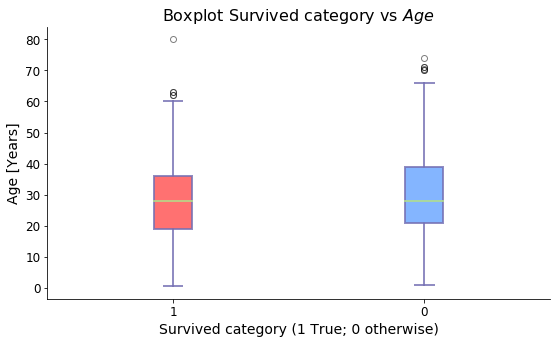

In [102]:
# Boxplots
Variable = 'Age'      # global variable name for generating the boxplots
Unit = '[Years]'      # variable units

# Figure size
fig = plt.figure(1, figsize = (9, 5))

# Create an axes instance
ax = fig.add_subplot(111)

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Boxplot 
bp = plt.boxplot([TrainSet[TrainSet['Survived'] == 1][Variable].dropna(), 
                  TrainSet[TrainSet['Survived'] == 0][Variable].dropna()], 
                  patch_artist = True)

# Visual enhancements: change outline color, fill color and linewidth of the boxes
aux = 0
colors = ['#ff4d4d', '#66a3ff']
for box in bp['boxes']:
    box.set( color = '#7570b3', linewidth = 2, alpha = 0.8)
    box.set( facecolor = colors[aux] )
    aux += 1
    
for whisker in bp['whiskers']:
    whisker.set(color = '#7570b3', linewidth = 2, alpha = 0.8)

for cap in bp['caps']:
    cap.set(color = '#7570b3', linewidth = 2, alpha = 0.8)

for median in bp['medians']:
    median.set(color = '#b2df8a', linewidth = 2, alpha = 0.8)

for flier in bp['fliers']:
    flier.set(marker = 'o', color = '#e7298a', alpha = 0.5)
    
# Axis
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 
ax.set_xlabel("Survived category (1 True; 0 otherwise)")
ax.set_xticklabels([1, 0])
ax.set_ylabel(Variable + " " + Unit)
    
# Plot    
plt.title(r'$\mathrm{Boxplot\ Survived\ category\ vs\  }' + Variable + '$')
plt.show()

c:\python36\lib\site-packages\numpy\core\fromnumeric.py:57: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  return getattr(obj, method)(*args, **kwds)


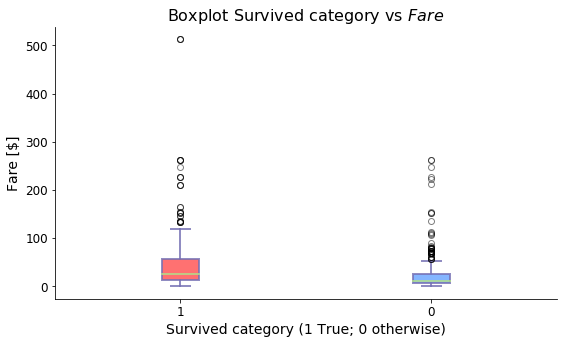

In [101]:
# Boxplots
Variable = 'Fare'  # global variable name for generating the boxplots
Unit = '[$]'       # variable units

# Figure size
fig = plt.figure(1, figsize = (9, 5))

# Create an axes instance
ax = fig.add_subplot(111)

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Boxplot 
bp = plt.boxplot([TrainSet[TrainSet['Survived'] == 1][Variable].dropna(), 
                  TrainSet[TrainSet['Survived'] == 0][Variable].dropna()],
                  patch_artist = True)

# Visual enhancements: change outline color, fill color and linewidth of the boxes
aux = 0
colors = ['#ff4d4d', '#66a3ff']
for box in bp['boxes']:
    box.set( color = '#7570b3', linewidth = 2, alpha = 0.8)
    box.set( facecolor = colors[aux] )
    aux += 1
    
for whisker in bp['whiskers']:
    whisker.set(color = "#7570b3", linewidth = 2, alpha = 0.8)
    
    
for cap in bp['caps']:
    cap.set(color = '#7570b3', linewidth = 2, alpha = 0.8)

for median in bp['medians']:
    median.set(color = '#b2df8a', linewidth = 2, alpha = 0.8)

for flier in bp['fliers']:
    flier.set(marker = 'o', color = '#e7298a', alpha = 0.5)
    
# Axis
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 
ax.set_xlabel("Survived category (1 True; 0 otherwise)")
ax.set_xticklabels([1, 0])
ax.set_ylabel(Variable + " " + Unit)
    
# Plot    
plt.title(r'$\mathrm{Boxplot\ Survived\ category\ vs\  }' + Variable + '$')
plt.show()

In [17]:
# Standardization (Fare and Age)
def standardize(raw_data):
    return ((raw_data - np.mean(raw_data, axis = 0)) / np.std(raw_data, axis = 0))

TrainSet["STDFare"] = standardize(TrainSet["Fare"])
TrainSet["STDAge"] = standardize(TrainSet["Age"])
TestSet["STDFare"] = standardize(TestSet["Fare"])
TestSet["STDAge"] = standardize(TestSet["Age"])

# Check new state
display(TrainSet.head())
print("Training set")
display(TestSet.head())
print("\nTesting set")

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,STDFare,STDAge
0,1,0,3,"Braund, Mr. Owen Harris",0,22.0,1,0,A/5 21171,7.2500,NaN,2.0,-0.502445,-0.530377
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",1,38.0,1,0,PC 17599,71.2833,C85,0.0,0.786845,0.571831
2,3,1,3,"Heikkinen, Miss. Laina",1,26.0,0,0,STON/O2. 3101282,7.9250,NaN,2.0,-0.488854,-0.254825
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",1,35.0,1,0,113803,53.1000,C123,2.0,0.420730,0.365167
4,5,0,3,"Allen, Mr. William Henry",0,35.0,0,0,373450,8.0500,NaN,2.0,-0.486337,0.365167


Training set


,PassengerId,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,STDFare,STDAge
0,892,3,"Kelly, Mr. James",0,34.5,0,0,330911,7.8292,NaN,1,-0.497811,0.298549
1,893,3,"Wilkes, Mrs. James (Ellen Needs)",1,47.0,1,0,363272,7.0000,NaN,2,-0.512660,1.181328
2,894,2,"Myles, Mr. Thomas Francis",0,62.0,0,0,240276,9.6875,NaN,1,-0.464532,2.240662
3,895,3,"Wirz, Mr. Albert",0,27.0,0,0,315154,8.6625,NaN,2,-0.482888,-0.231118
4,896,3,"Hirvonen, Mrs. Alexander (Helga E Lindqvist)",1,22.0,1,1,3101298,12.2875,NaN,2,-0.417971,-0.584229



Testing set


Min Corr: -0.552893220646 Max Corr: 0.536761623349
Variables with minimum correlation
 Pclass
 Fare
Variables with maximum correlation
 Sex
 Survived

Survived correlations
Variables Sex and Survived correlation: 0.543351380658
Variables Fare and Survived correlation: 0.257306522385
Variables Pclass and Survived correlation: -0.338481035961


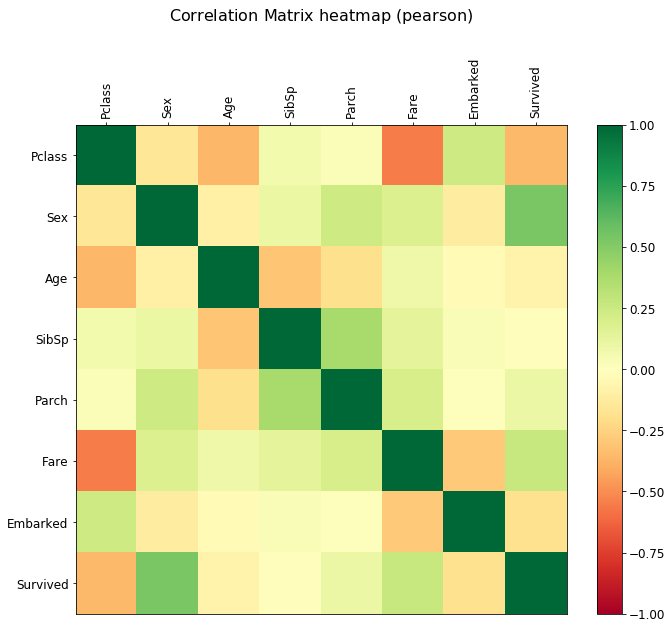

In [103]:
# Correlation map
# Relevant plots (Correlation Heatmap)
# Correlation matrix
Variables = ["Pclass", "Sex", "Age", "SibSp", 
             "Parch", "Fare", "Embarked", "Survived"]
corr = TrainSet[Variables].dropna().corr()     #Correlation matrix
xlabels = TrainSet[Variables].columns          #X labels
ylabels = TrainSet[Variables].columns          #X labels

# Figure size and axes
fig, ax = plt.subplots(figsize = (11, 9))
ax.set_xticks(np.arange(TrainSet.shape[1]) + 0.5, minor=False)
ax.set_yticks(np.arange(TrainSet.shape[0]) + 0.5, minor=False)
ax.invert_yaxis()
ax.xaxis.tick_top()
plt.xticks(rotation = 90)
ax.set_xticklabels(xlabels, minor = False)
ax.set_yticklabels(ylabels, minor = False)

# Plot the heatmap and colorbar. Add title
heatmap = plt.pcolor(corr, cmap = 'RdYlGn', 
                     vmin = -1, vmax = corr.max().max())
plt.title(r'$\mathrm{Correlation\ Matrix\ heatmap\ (pearson)}$',
          y = 1.2)
plt.colorbar()


# Analysis: Min and Max (below 1) correlations
minCorr = corr.min().min()
corr2 = corr[corr < 1]
maxCorr = corr2.max().max()
print("Min Corr:", minCorr, "Max Corr:", maxCorr)

# New dfs with min and max correlations
corrmins = pd.DataFrame(corr.min(), columns = ['MinCorr'])
corrmaxs = pd.DataFrame(corr2.max(), columns = ['MaxCorr'])

# Get variable names for max/min correlations
print('Variables with minimum correlation') 
for i in corrmins[corrmins['MinCorr'] == minCorr].index.tolist():
    print("", i)

print('Variables with maximum correlation') 
for i in corrmaxs[corrmaxs['MaxCorr'] == maxCorr].index.tolist():
    print("", i)


# Correlations with Survived
print("\nSurvived correlations")
Corr_Sex_Surv = TrainSet[["Sex", "Survived"]].dropna().corr().loc["Sex", "Survived"]
print('Variables Sex and Survived correlation:', Corr_Sex_Surv)

Corr_Fare_Surv = TrainSet[["Fare", "Survived"]].dropna().corr().loc["Fare","Survived"]
print('Variables Fare and Survived correlation:', Corr_Fare_Surv)

Corr_Pclass_Surv = TrainSet[["Pclass", "Survived"]].dropna().corr().loc["Pclass","Survived"]
print('Variables Pclass and Survived correlation:', Corr_Pclass_Surv)

In [104]:
# Numerical matrix
display(corr)

,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked,Survived
Pclass,1.000000,-0.150826,-0.365902,0.065187,0.023666,-0.552893,0.244145,-0.356462
Sex,-0.150826,1.000000,-0.099037,0.106296,0.249543,0.182457,-0.109639,0.536762
Age,-0.365902,-0.099037,1.000000,-0.307351,-0.187896,0.093143,-0.032565,-0.082446
SibSp,0.065187,0.106296,-0.307351,1.000000,0.383338,0.139860,0.033064,-0.015523
Parch,0.023666,0.249543,-0.187896,0.383338,1.000000,0.206624,0.011803,0.095265
Fare,-0.552893,0.182457,0.093143,0.139860,0.206624,1.000000,-0.283510,0.266100
Embarked,0.244145,-0.109639,-0.032565,0.033064,0.011803,-0.283510,1.000000,-0.181979
Survived,-0.356462,0.536762,-0.082446,-0.015523,0.095265,0.266100,-0.181979,1.000000


In [19]:
# Collinearity
w, v = np.linalg.eig(corr)
print("Eigen values from correlation matrix:\n", w)
print("\nEigen vectors:\n", v)

Eigen values from correlation matrix:
 [ 2.24290094  1.75782767  1.1196956   0.90692473  0.31547712  0.42745546
  0.6731241   0.55659437]

Eigen vectors:
 [[ 0.47230968 -0.3440103   0.20612775 -0.17043006  0.67173534 -0.25469798
  -0.26442434  0.0320276 ]
 [-0.40464489 -0.23750026  0.48761098  0.18843498 -0.23831921 -0.56043508
  -0.25314203 -0.26761822]
 [-0.06444321  0.54691786 -0.18639231  0.42680625  0.34876081  0.03885952
  -0.44651302 -0.39661595]
 [-0.0991822  -0.51916583 -0.4200137   0.0070416   0.10228821  0.09556138
   0.25186562 -0.67907106]
 [-0.2078218  -0.47823597 -0.28874317  0.255396   -0.07957356  0.29407508
  -0.57656024  0.39276827]
 [-0.49066377  0.06745229 -0.40673463 -0.02017297  0.39694244 -0.4891055
   0.25448242  0.3568059 ]
 [ 0.30636232 -0.14143797  0.07750095  0.82746007  0.01727162 -0.08273595
   0.40174868  0.16399794]
 [-0.47052879 -0.05774154  0.50376702  0.05393015  0.44236303  0.52711463
   0.21119588  0.02098386]]


In [20]:
# Separate Features from label (Survived)
print("Features from training set")
X_Train = TrainSet.drop("Survived", axis = 1)
display(X_Train.head())

print("Labels from training set")
Y_Train = TrainSet["Survived"]
display(Y_Train.head())

Features from training set


,PassengerId,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,STDFare,STDAge
0,1,3,"Braund, Mr. Owen Harris",0,22.0,1,0,A/5 21171,7.2500,NaN,2.0,-0.502445,-0.530377
1,2,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",1,38.0,1,0,PC 17599,71.2833,C85,0.0,0.786845,0.571831
2,3,3,"Heikkinen, Miss. Laina",1,26.0,0,0,STON/O2. 3101282,7.9250,NaN,2.0,-0.488854,-0.254825
3,4,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",1,35.0,1,0,113803,53.1000,C123,2.0,0.420730,0.365167
4,5,3,"Allen, Mr. William Henry",0,35.0,0,0,373450,8.0500,NaN,2.0,-0.486337,0.365167


Labels from training set


0    0
1    1
2    1
3    1
4    0
Name: Survived, dtype: int64

## Observations

Based on our deep exploratory analysis, we have the following preliminary insights from the Titanic's dataset:

### Data type of each variable

As added at the beginning of the problem set, the current dataset contains 12 variables: 11 features and 1 binary label ($Survived$). There are 7 numerical variables and 5 objects/strings: $Name$, $Sex$, $Ticket$, $Cabin$, and $Embarked$. These variables will be eliminated or transformed into numerical ones depending on their usefulness and availability (number of missing values within them) in the following steps.

| Variable    | Type    |
|-------------|---------|
| PassengerId | int64   |
| Survived    | int64   |
| Pclass      | int64   |
| Name        | object  |
| Sex         | object  |
| Age         | float64 |
| SibSp       | int64   |
| Parch       | int64   |
| Ticket      | object  |
| Fare        | float64 |
| Cabin       | object  |
| Embarked    | object  |

Since the $Ticket$ variable contains values in very different formats (different string formats), it will be deleted from the dataset, not including it for the rest of the analysis in the current code. The Same action is performed with the $Name$ variable, following the same reasons.

### Missing values
- Training set: The training set contains 891 rows/observations, where 708 contains at least one missing value in any of the features. There are 177 missing values (19.86%) in the $Age$ column, 687 missing values (77.1%) for the $Cabin$ feature, and 2 missing values (0.22%) for the $Embarked$ variable. Since the number of missing values for the $Cabin$ column is very high (about three-quarters of the size of the dataset), we will exclude it from the rest of our analysis of the Titanic's dataset. Following a similar logic, we will exclude all the rows containing at least one missing value in order to avoid using incomplete observations when training our prediction models for simplicity. Clearly, different approaches could have been performed: mean imputation, hot/cold deck, regression imputation, etc., however, we stick to the simplest approach consisting of deleting those entries without all relevant features. After this procedure, the training dataset will contain 712 observations

- Testing set: The testing set contains 418 rows/observations, with 331 containing missing values in any of the features. There are 86 missing values (20.57%) in the $Age$ feature, 327 missing values (78.23%) for the $Cabin$ variable, and 1 missing value (0.24%) inside the $Fare$ variable. As before, we delete the $Cabin$ variable due to the high concentration of missing values and we also delete all the rows containing missing values. After this procedure, the testing dataset (for the Kaggle competition) will contain 331 observations.

### Transformations/Scale

- Standardization: Based on the range and distribution of the $Age$ (having values from 0.42 to 80 and mean around 30) and $Fare$ (having values from 0 to 512.329) variables as seen in the previous summary tables and histograms, we decide to standardize them, generating the $STDAge$ and $STDFare$ variables inside the dataframe for using them within the predictive models context.

- String to Numerical: The $Sex$ variable is binarized (Male = 0; Female = 1) and the $Embarked$ variable is transformed into a numerical variable where the port initials are replaced by numbers following $C = 0$, $Q = 1$, and  $S = 2$.

These transformations will allow us to exploit these features and obtain better results in terms of accuracy when implementing our machine learning models.

### Plots observations

Based on the plots and the preliminary exploratory analysis performed, we can see the following patterns:

- $Pclass$: the first class ticket is the one with the larger number of survived passengers. However, it is not the one with the best surviving rate. People having a 3rd class ticket tend to have a better chance of surviving than the other groups.

- $Sex$: There is a clear trend/pattern indicating that women tend to have a better chance of surviving than men. This can be seen in one of the previous plots and it is consistent and coherent with the traditional emergency protocol: Women and children should evacuate first during an emergency/accident like the one experienced by the Titanic.

- $SibSp$: In a similar way, having a sibling/spouse tend to increase the chances of surviving but adding more relatives does not significantly increase the chances of surviving.

- $Parch$: Following the previous pattern, we can see from the plot that having Parents/Children tend to increase the surviving chances at the beginning but they do not increase when adding more relatives.

- $Age$: Wide range of observations justify the standardization of the variable. Its average and distribution tend to be very similar when comparing the training and testing sets. Therefore, it does not look like a very important variable in terms of the predictive power of the potential models.

- $Fare$: As with $Age$, its range is very large leading to its standardization in order to be able to use it in an efficient way when fitting predictive models. 

### Correlation analysis (within features)

|          | Pclass    | Sex       | Age       | SibSp     | Parch     | Fare      | Embarked  | Survived  |
|----------|-----------|-----------|-----------|-----------|-----------|-----------|-----------|-----------|
| Pclass   | 1.000000  | -0.150826 | -0.365902 | 0.065187  | 0.023666  | -0.552893 | 0.244145  | -0.356462 |
| Sex      | -0.150826 | 1.000000  | -0.099037 | 0.106296  | 0.249543  | 0.182457  | -0.109639 | 0.536762  |
| Age      | -0.365902 | -0.099037 | 1.000000  | -0.307351 | -0.187896 | 0.093143  | -0.032565 | -0.082446 |
| SibSp    | 0.065187  | 0.106296  | -0.307351 | 1.000000  | 0.383338  | 0.139860  | 0.033064  | -0.015523 |
| Parch    | 0.023666  | 0.249543  | -0.187896 | 0.383338  | 1.000000  | 0.206624  | 0.011803  | 0.095265  |
| Fare     | -0.552893 | 0.182457  | 0.093143  | 0.139860  | 0.206624  | 1.000000  | -0.283510 | 0.266100  |
| Embarked | 0.244145  | -0.109639 | -0.032565 | 0.033064  | 0.011803  | -0.283510 | 1.000000  | -0.181979 |
| Survived | -0.356462 | 0.536762  | -0.082446 | -0.015523 | 0.095265  | 0.266100  | -0.181979 | 1.000000  |

Looking at the correlation matrix, we can notice the minimum correlation is achieved by the $Pclass$ and $Fare$ variables with a value of -0.5528 indicating - as expected - that the $Fare$ paid decreases when the ticket class is "higher" (lower in terms of quality: 3rd class is worse than 1st class) while the maximum correlation between two variables is achieved by the $Survived$ label and the $Sex$ feature, indicating that, as we already observed in our plots, the gender played a fundamental rol in the Titanic accident: the pattern indicates that females tend to have more chances of surviving in the Titanic. Other relevant correlations correspond to the ones achieved by the features $Age$ and $Pclass$ (-0.365) indicating that older people tend to pay for better class tickets and by the features $Parch$ and $SibSp$ (0.383), indicating that there exists a clear relationship between Children/Parents/Spouses/Siblings as expected. Other correlations can be seen from the previous table between variables but none of them is extremely high/low.

In addition, by looking at the eigenvalues of the matrix (check previous code) we can easily notice that there does not exist an explicit collinearity between variables and thus, we do not eliminate/merge any variable, keeping the current dataset.

### 1.2 Correlates of survival

Use whatever methods you can think of to try and figure out what factors seem to determine whether or not a person would survive the sinking of the Titanic. What do you conclude?

In [21]:
# Already done in the previous code chunks

## Observations

###  What factors seem to determine whether or not a person would survive the sinking of the Titanic. What do you conclude?

Based on our previous preliminary discussion and analysis of the dataset (check the previous section including the plots discussion), we have identified the following factors as relevant elements to determine whether or not a person would survive the sinking of the Titanic:

- $Sex$: The gender of the passenger looks like an important factor of classification. As mentioned above, females tend to have better chances of surviving than men and thus, it would be a relevant feature to take into account and be part of our machine learning models. The explanation behind this pattern was already mentioned: evacuation protocols usually start with female and/or children. In terms of the correlation between this feature and the label $Survived$, they reach the largest pearson coefficient value equal to 0.5367. Thus, our models will include this potentially powerful feature.

- $Pclass$: Looking at its correlation with the classification label, we can see that it is the second largest in terms of magnitude and negative (-0.3564), indicating that passengers with worse tickets tend to have less chances of surviving the Titanic's accident. This is consistent with the generated plots, separating the observations by the label variable.

- $Fare$: Following the same pattern as the previous feature, better tickets tend to be more expensive and thus, the $Fare$  tends to be higher for better tickets. Clearly, it is negatively correlated with the $Pclass$ feature as discussed in the previous section and reaches a 0.266 correlation with the label variable indicating that better tickets tend to lead to better chances of surviving.

- $Embarked$: Finally, another potentially relevant correlation with respect to the $Survive$ label consists of the port where the passenger started his/her trip inside the Titanic. The correlation value of -0.189 indicates a negative correlation between both variables, however, it is not as strong as the previous ones.

- Remaining variables: Variables such as $Age$, $SibSp$, and $Parch$ do not have a significant correlation with respect to the label variable $Survived$ and thus, they are not likely to be relevant when fitting the machine learning models. However, we will keep them in the training and testing datasets in order to be able of testing their real importance in the context of the machine learning models we will test.

Therefore, as we already discussed in the previous section, we can conclude based on our preliminary analysis that the most important factors to determine whether or not a person would survive the sinking of the Titanic consists of the gender of the passenger ($Sex$) where women have a clear advantage over men and the "class" of the passenger: people who paid the most expensive tickets (low $Pclass$ and high $Fare$) tend to be more likely to survive the sinking of the Titanic. However, more analysis must be done in the following sections in order to obtain more and deeper insights regarding the dataset and the importance of each feature inside it.

## Part 2: Decision Trees

... Because how can you take a course in Applied Machine Learning without fitting a decision tree?

### 2.1 Decision Tree
Using the basic [Decision Tree](http://scikit-learn.org/stable/modules/tree.html#tree) library in sklearn, fit a model to predict titanic survival. Make sure you come up with an appropriate way of handling each of the input variables before feeding them in to the decision tree. You can use the [DecisionTreeClassifier](http://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html#sklearn.tree.DecisionTreeClassifier) method to implement 10-fold cross-validation. Report the average training and testing accuracy across your 10 folds, and show a diagram of the tree (at least the first three levels).


# Version 1
> - Training set: 100% of the train.csv file (will be used for the 10-fold CV)
- Testing set: 100% of the test.csv file 

In [131]:
# Importations
from sklearn import tree

# Filtered dataset: Relevant features (No ID, Name, Ticket, and Cabin) 
# and standardized ones (Fare and Age)
XTStd = TrainSet.drop(["PassengerId", "Name", "Ticket",
                       "Cabin", "Age", "Fare"], axis = 1)
print("Filtered training set")
display(XTStd.head())

# DropNA version: Rows with missing values are dropped
XTStdNonan = XTStd.dropna()
r3, c3 = XTStdNonan.shape
print("Original number of observations:", XTStd.shape[0])
print("Number of observations (without NaN):", r3, 
      ", Number of features:", c3 - 1, ", One label (Survived)")
YTStdNonan = XTStdNonan["Survived"]
XTStdNonan = XTStdNonan.drop(["Survived"], axis = 1)

# Check data
print("Training set for fitting the model")
display(XTStdNonan.head())
print("Training label")
display(YTStdNonan.head())

# Decision tree
clfnoNaN = tree.DecisionTreeClassifier()
clfnoNaN = clfnoNaN.fit(XTStdNonan, YTStdNonan)

# Feature importance
FeatImp = clfnoNaN.feature_importances_
FeatLab = XTStdNonan.columns
print("Features importance:\n", FeatImp)
print("Feature names:", FeatLab)

# Predictions & Accuracy: Test sets with and without NaN
XTestStdNan = TestSet.drop(["PassengerId", "Name", 
                            "Ticket", "Cabin", "Age", "Fare"], 
                            axis = 1)
XTestStdNonan = TestSet.drop(["PassengerId", "Name", 
                              "Ticket", "Cabin", "Age", "Fare"], 
                             axis = 1).dropna()

# Testing and training predictions
y_hat_test = np.round(clfnoNaN.predict(XTestStdNonan))
y_hat_train = np.round(clfnoNaN.predict(XTStdNonan))

print("Score:", clfnoNaN.score(X = XTStdNonan, y = YTStdNonan))

Filtered training set


,Survived,Pclass,Sex,SibSp,Parch,Embarked,STDFare,STDAge
0,0,3,0,1,0,2.0,-0.502445,-0.530377
1,1,1,1,1,0,0.0,0.786845,0.571831
2,1,3,1,0,0,2.0,-0.488854,-0.254825
3,1,1,1,1,0,2.0,0.420730,0.365167
4,0,3,0,0,0,2.0,-0.486337,0.365167


Original number of observations: 891
Number of observations (without NaN): 712 , Number of features: 7 , One label (Survived)
Training set for fitting the model


,Pclass,Sex,SibSp,Parch,Embarked,STDFare,STDAge
0,3,0,1,0,2.0,-0.502445,-0.530377
1,1,1,1,0,0.0,0.786845,0.571831
2,3,1,0,0,2.0,-0.488854,-0.254825
3,1,1,1,0,2.0,0.420730,0.365167
4,3,0,0,0,2.0,-0.486337,0.365167


Training label


0    0
1    1
2    1
3    1
4    0
Name: Survived, dtype: int64

Features importance:
 [ 0.13866116  0.29736009  0.06086607  0.03089085  0.02151032  0.19883077
  0.25188074]
Feature names: Index(['Pclass', 'Sex', 'SibSp', 'Parch', 'Embarked', 'STDFare', 'STDAge'], dtype='object')
Score: 0.98595505618


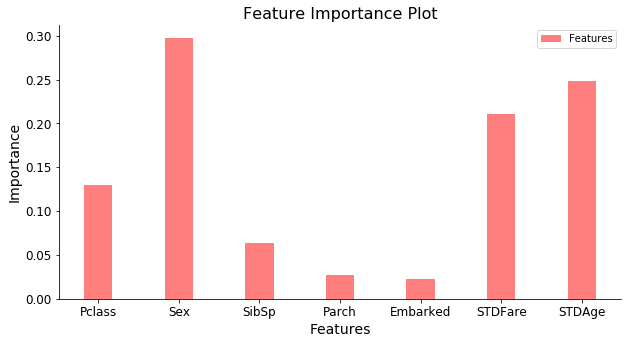

In [23]:
# Feature importance plot
# Figure size
plt.figure(1)
plt.figure(figsize = (9, 5)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Number of bars          
n_groups = len(FeatImp)

# Visual style
index = np.arange(n_groups)
bar_width = 0.35
opacity = 0.5

# Plot
rects1 = plt.bar(index, FeatImp, bar_width,
                 alpha = opacity,
                 color='r', 
                 label='Features')

# Labels, Title, and legends
plt.xlabel("Features")
plt.ylabel('Importance')
plt.title("Feature Importance Plot")
plt.xticks(index , FeatLab)
plt.legend()

plt.tight_layout()
plt.show()    

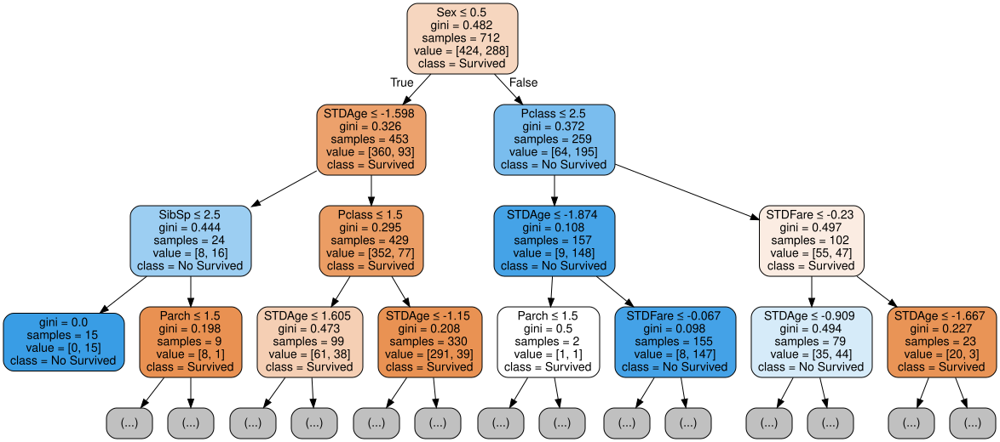

In [24]:
# Plot
# Importations
import graphviz 

# Export to pdf file and plot inline
dot_data = tree.export_graphviz(clfnoNaN, out_file = None, 
                         feature_names = XTStdNonan.columns,  
                         class_names = ["Survived", "No Survived"],  
                         filled = True, rounded = True,  
                         special_characters = True,
                         max_depth = 3)  
graph = graphviz.Source(dot_data) 
graph.render("clfnoNaN") 
graph 

In [25]:
# 10-fold Cross-validation (using sklearn package for testing purposes)
# Importations
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier

# Fit the model
clf = DecisionTreeClassifier(random_state = 0)
CVScores = cross_val_score(clf, XTStdNonan, YTStdNonan, cv = 10)

# Testing score
print("10-fold Cross-validation scores (Testing):\n", CVScores)
print("\nMean accuracy 10-fold CV (Testing):", np.mean(CVScores))

10-fold Cross-validation scores (Testing):
 [ 0.69444444  0.73611111  0.79166667  0.83333333  0.77464789  0.78873239
  0.81690141  0.74647887  0.8         0.81428571]

Mean accuracy 10-fold CV (Testing): 0.779660183322


In [26]:
# Own Cross-Validation method
# Importations
from sklearn.cross_validation import KFold

# Random seed: reproducibility
np.random.seed(1)

# Data
X = XTStdNonan
y = YTStdNonan

# K-folds value
k = 10

# Intercept and feature coefficients
Results = [0 for i in range(0, k)]

# RMSE 
AccTrain = [0 for i in range(0, k)]
AccTest = [0 for i in range(0, k)]
BestAccTest = 0
BestIter = 0
BestImportance = []

# Niters
niters = 0

# CV loop
kf = KFold(n_folds = k, n = len(X), shuffle = True)

# Generate the sets
for train_index, test_index in kf:
    # Iteration number
    print("------------------------- Iteration", niters + 1, "-------------------------")
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Calling the function
    clf = tree.DecisionTreeClassifier()
    clf = clf.fit(X_train, y_train)
    
    # Computing Accuracy
    # Training Accuracy value
    AccTrain[niters] = clf.score(X = X_train, y = y_train) 
        
    # Testing Accuracy value
    AccTest[niters] = clf.score(X = X_test, y = y_test) 
        
    # Best RMSE
    if AccTest[niters] > BestAccTest:
        BestAccTest = AccTest[niters]
        print("BestAccTest", BestAccTest)
        BestIter = niters
        BestImportance = clf.feature_importances_
    
    # Print results
    print("Iteration Results")
    print("-------------------- Accuracy --------------------")
    print("Training set:", AccTrain[niters])
    print("Testing set:", AccTest[niters])
    print("--------------------------------------------------")
    
    # Next iteration
    niters += 1
    
# Summary results
print("\n\nSummary 10-fold Cross-validation")
print("---------------------------------------")
print("Average Accuracy training:", np.mean(AccTrain))
print("Average Accuracy testing:", np.mean(AccTest))
print("Best Accuracy (test):", BestAccTest, "on iteration", 
      BestIter + 1)
print("Importance of features best accuracy (test):\n", 
      BestImportance)
print("---------------------------------------")

------------------------- Iteration 1 -------------------------
BestAccTest 0.763888888889
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.763888888889
--------------------------------------------------
------------------------- Iteration 2 -------------------------
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.736111111111
--------------------------------------------------
------------------------- Iteration 3 -------------------------
BestAccTest 0.816901408451
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------------- Iteration 4 -------------------------
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.619718309859
---------------------------------------------

c:\python36\lib\site-packages\sklearn\cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


## Observations
### Report the average training and testing accuracy across your 10 folds
Based on the previous results, we have that the average training and testing accuracy across the 10-folds are:
- $Accuracy_{training} = 0.987$
- $Accuracy_{testing} = 0.748$

Therefore, we can clearly see that there exists a clear overfitting to the training data when using the decision tree algorithm "as-is" since the depth of the tree ($MaxDepth$ parameter) is very high (by default, nodes are expanded until all leaves are pure or until all leaves contain less than min_samples), leading to a very good accuracy for the training observations but not as good in the case of the test set. Thus, we will tune a new decision tree in the next section taking into account this particular phenomenon.

### Diagram of the tree (at least the first three levels).
Please take a look at the previous outputs. In addition, a .pdf file is created every time the decision tree code is run. Notice that the diagram is consistent with the features importance, as shown below.

### Extra: Feature importances

From the decision tree model, we can easily obtain the features importance of the fitted model:

|  Feature | Importance (Decision Tree, default) |
|:--------:|:-----------------------------------:|
|   Pclass |                          0.12963439 |
|      Sex |                          0.29736009 |
|    SibSp |                          0.06351679 |
|    Parch |                          0.02764753 |
| Embarked |                          0.02301478 |
|  STDFare |                          0.21097538 |
|   STDAge |                          0.24785104 |

Looking at the previous table, we can easily notice that the most important variables for the model consist of the $Sex$ feature, the $STDAge$, the $STDFare$ and the $Pclass$. As expected, the $Sex$ and $STDFare$ variables played a fundamental role inside the model, however, the importance of the $STDAge$ variable was not expected based on the preliminary analysis conducted in the previous section. In this case, it is possible that the $Age$ of the person really matters in terms of the prediction of his/her chances of surviving. On the other hand, as expected, the remaining variables were not significantly important for the model, not having a very powerful predictive effect.

### 2.2 Tree tuning

Use all of the data to re-fit a single decision tree with max_depth = 4 (i.e., no cross-validation). Show the tree diagram and also plot the feature importances. What do you observe?

In [132]:
# Decision tree
clfTuning = tree.DecisionTreeClassifier(max_depth = 4)
clfTuning = clfTuning.fit(XTStdNonan, YTStdNonan)

# Feature importance
FeatImp = clfTuning.feature_importances_
FeatLab = XTestStdNonan.columns
print("Features importance:\n", FeatImp)
print("Feature names:", FeatLab)

# Predictions & Accuracy
XTestStdNonan = TestSet.drop(["PassengerId", "Name", 
                              "Ticket", "Cabin", "Age", "Fare"], 
                             axis = 1).dropna()
y_hat_test = np.round(clfTuning.predict(XTestStdNonan))
y_hat_train = np.round(clfTuning.predict(XTStdNonan))

print("Accuracy (training):", clfTuning.score(X = XTStdNonan, y = YTStdNonan))

Features importance:
 [ 0.22439901  0.56192579  0.05054232  0.00568601  0.          0.04048383
  0.11696304]
Feature names: Index(['Pclass', 'Sex', 'SibSp', 'Parch', 'Embarked', 'STDFare', 'STDAge'], dtype='object')
Accuracy (training): 0.830056179775


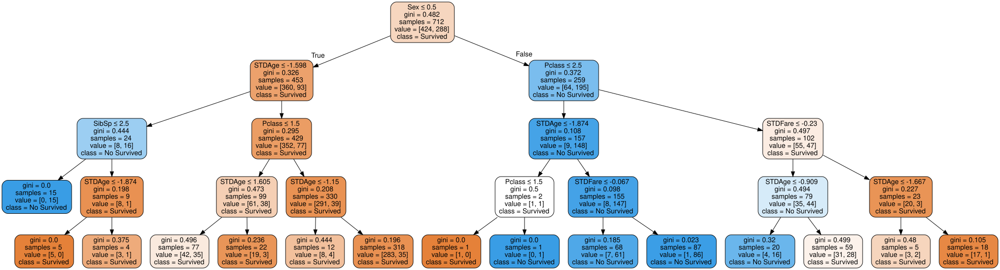

In [28]:
# Plot New Tree Max Depth = 4
# Export to pdf file and plot inline
dot_data = tree.export_graphviz(clfTuning, out_file = None, 
                         feature_names = XTStdNonan.columns,  
                         class_names = ["Survived", "No Survived"],  
                         filled = True, rounded = True,  
                         special_characters = True,
                         max_depth = 4)  
graph = graphviz.Source(dot_data) 
graph.render("clfTuning") 
graph 

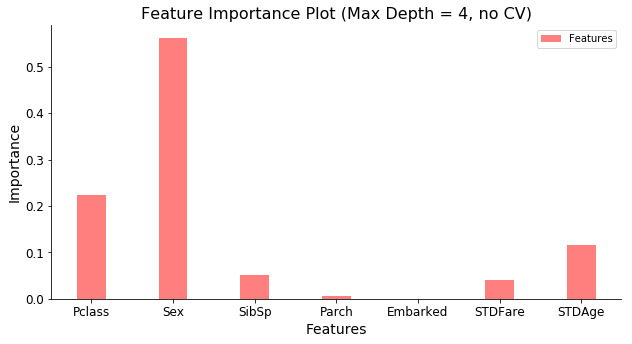

In [133]:
# Feature importance plot
# Figure size
plt.figure(1)
plt.figure(figsize = (9, 5)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Number of bars          
n_groups = len(FeatImp)

# Visual style
index = np.arange(n_groups)
bar_width = 0.35
opacity = 0.5

rects1 = plt.bar(index, FeatImp, bar_width,
                 alpha=opacity, color='r', 
                 label='Features')

# Labels, Title, and legends
plt.xlabel("Features")
plt.ylabel('Importance')
plt.title("Feature Importance Plot (Max Depth = 4, no CV)")
plt.xticks(index, FeatLab)
plt.legend()

plt.tight_layout()
plt.show()    

## Observations

###  Show the tree diagram and also plot the feature importances. What do you observe?

### Tree diagram
The diagram has been plotted in the previous code chunks, showing the 4 layers of the new decision tree. Again, we can easily notice that it is consistent with the feature importances obtained, as shown below.

### Feature importances

We compute the importance of the features of the new decision tree model including only four layers. When comparing the importance of the features of the current model with the original decision tree implementation (vanilla approach), we obtain the following values:

|  Feature | Importance (Decision Tree, vanilla) | Importance (Decision Tree, MD = 4) |
|:--------:|:-----------------------------------:|:----------------------------------:|
|   Pclass |                          0.12963439 |                         0.22439901 |
|      Sex |                          0.29736009 |                         0.56192579 |
|    SibSp |                          0.06351679 |                         0.05054232 |
|    Parch |                          0.02764753 |                         0.00568601 |
| Embarked |                          0.02301478 |                         0.00000000 |
|  STDFare |                          0.21097538 |                         0.04048383 |
|   STDAge |                          0.24785104 |                         0.11696304 |

We can easily notice that we do not obtain exactly the same features importance (as expected) with respect to the ones obtained by the vanilla implementation of the decision tree model. However, we have a similar analysis as before:

Looking at the previous table, we can easily notice that the most important variable for the model consists of the $Sex$ feature, that has increased its importance up to 0.561 (almost doubling its importance with respect to the vanilla implementation). Then, we can see that the new second most important feature is the $Pclass$ variable, increasing its importance from 0.129 up to 0.224, leaving the $STDAge$ feature in the third place with an importance of 0.116, about half of its original importance when performing the vanilla implementation. 

On the other hand, we can see how the $STDFare$ feature decreases its importance in a very significant way from 0.21 to a very low 0.04. One explanation behind this pattern could be the fact that the importance of the $Pclass$ variable has been increased significantly and, as we know from the preliminary analysis, both variables are highly correlated, leading to drop the importance of one of them. Finally, the importance of the variables $SibSp$, $Parch$, and $Embarked$ is even less than in the original implementation, indicating us the low predictive power of them when applying the decision tree model.

Hence, our initial thoughts are consistent and coherent to the first insights obtained from the simple decision tree model in terms of the relevance of each feature for generating useful predictions and insights for the current dataset.

### 2.3 Sensitivity analysis
The built-in algorithm you are using has several parameters which you can tune. Using cross-validation, show how the choice of these parameters affects performance.

First, show how max_depth affects train and test accuracy. On a single axis, plot train and test accuracy as a function of max_depth. Use a red line to show test accuracy and a blue line to show train accuracy.

Second, show how test accuracy relates to both max_depth and min_samples_leaf. Specifically, create a 3-D plot where the x-axis is max_depth, the y-axis is min_samples_leaf, and the z-axis shows accuracy. What combination of max_depth and min-samples_leaf achieves the highest accuracy? How sensitive are the results to these two parameters?

In [30]:
# Accuracy and Max Depth
# Random seed: reproducibility
np.random.seed(1)

# Data
X = XTStdNonan
y = YTStdNonan

# K-folds value
k = 10

# MaxDepth
MaxDepths = np.arange(1, 31, 1) 

# Intercept and feature coefficients
Results = [0 for i in range(0, k)]

# Accuracy 
AccTrain = [[0 for i in range(0, k)] for j in range(0, len(MaxDepths))]
AccTest = [[0 for i in range(0, k)] for j in range(0, len(MaxDepths))]
AVGAccTrain = [0 for j in range(0, len(MaxDepths))]
AVGAccTest = [0 for j in range(0, len(MaxDepths))]

BestAccTest = 0
BestAccTrain = 0
BestMaxDepthTrain = 0
BestMaxDepthTest = 0

BestOuterIter = 0
BestOuterIterTest = 0
BestOuterIterTrain = 0
BestIter = 0

BestImportance = []

BestAVGAccTrain = 0
BestAVGAccTest = 0

# Niters
niters = 0
nouteriter = 0

# CV loop
kf = KFold(n_folds = k, n = len(X), shuffle = True)

# Max Depth loop
for md in MaxDepths:
    print("----------------------- Max depth =", md, "-----------------------" )
    
    # Reset values
    niters = 0
    BestAccTest = 0
    BestAccTrain = 0
    
    # Generate the sets
    for train_index, test_index in kf:
        # Iteration number
        print("------------------ Iteration", niters + 1, "------------------")
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Calling the function
        clf = tree.DecisionTreeClassifier(max_depth = md, random_state = 0)
        clf = clf.fit(X_train, y_train)

        # Computing Accuracy
        # Training Accuracy value
        AccTrain[nouteriter][niters] = clf.score(X = X_train, y = y_train) 

        # Testing Accuracy value
        AccTest[nouteriter][niters] = clf.score(X = X_test, y = y_test) 

        # Best test Accuracy (inner)
        if AccTest[nouteriter][niters] > BestAccTest:
            BestAccTest = AccTest[nouteriter][niters]
            BestIter = niters
            BestOuterIter = nouteriter
            BestImportance = clf.feature_importances_

        # Print results
        print("CV Iteration Results")
        print("-------------------- Accuracy --------------------")
        print("Training set:", AccTrain[nouteriter][niters])
        print("Testing set:", AccTest[nouteriter][niters])
        print("--------------------------------------------------")

        # Next iteration
        niters += 1

    # CV AVG accuracy
    AVGAccTrain[nouteriter] = np.mean(AccTrain[nouteriter])
    AVGAccTest[nouteriter] = np.mean(AccTest[nouteriter])
        
    # Summary results
    print("\n\nSummary 10-fold Cross-validation, Max depth =", md)
    print("---------------------------------------")
    print("Average Accuracy training:",AVGAccTrain[nouteriter])
    print("Average Accuracy testing:", AVGAccTest[nouteriter])
    print("Best Accuracy (test):", BestAccTest, "on iteration", 
          BestIter + 1)
    print("Importance of features best accuracy (test):\n", 
          BestImportance)
    print("---------------------------------------\n\n")
    
    # Best AVG accuracy (train & test)
    if AVGAccTrain[nouteriter] > BestAVGAccTrain:
        BestAVGAccTrain = AVGAccTrain[nouteriter]
        BestOuterIterTrain = nouteriter
        BestMaxDepthTrain = md
    
    if AVGAccTest[nouteriter] > BestAVGAccTest:
        BestAVGAccTest = AVGAccTest[nouteriter]
        BestOuterIterTest = nouteriter
        BestMaxDepthTest = md
        
    # Next outer iteration
    nouteriter += 1
    
# Final results
print("\n\nFinal Results")
print("---------------------------------------")
print("Best Max Depth (training):", MaxDepths[BestOuterIterTrain])
print("Best Accuracy (training):", BestAVGAccTrain)
print("Best Max Depth (testing):", MaxDepths[BestOuterIterTest])
print("Best Accuracy (testing):", BestAVGAccTest)
print("---------------------------------------")

----------------------- Max depth = 1 -----------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 -

-------------------- Accuracy --------------------
Training set: 0.898595943838
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.884555382215
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.892355694228
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203


CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.96879875195
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.959438377535
Testing set: 0.647887323944
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.97503900156
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.661971830986
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.985954806942
Average Accuracy testing: 0.758392018779
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.13286132  0.27594174  0.06397799  0.02038092  0.01097149  0.20832107
  0.28754547]
---------------------------------------


----------------------- Max depth = 19 -----------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9828125
Testin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.69014084507
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.661971830986
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 24
---------------------------------------
Average Accuracy training: 0.987047581903
Average Accuracy testing: 0.761208920188
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.13226576  0.27470481  0.06814177  0.01916891  0.01439632  0.20626661
  0.28505583]
---

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.69014084507
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-----------

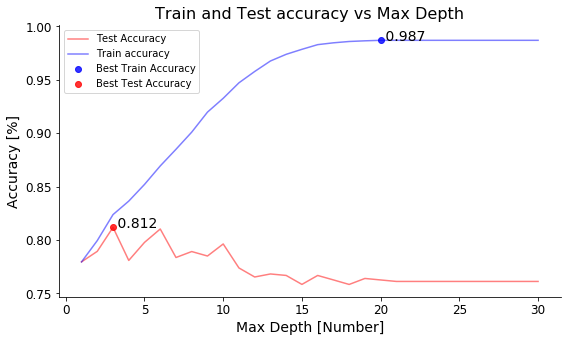

In [31]:
# Plot
# Figure size
plt.figure(1)
plt.figure(figsize = (9, 5)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Labels, Title, and legends
plt.xlabel("Max Depth [Number]")
plt.ylabel('Accuracy [%]')
plt.title("Train and Test accuracy vs Max Depth")


# lines plot and annotations
plt.plot(MaxDepths, AVGAccTest, 'r-', 
         alpha = 0.5, label = "Test Accuracy")
plt.plot(MaxDepths, AVGAccTrain, 'b-', 
         alpha = 0.5, label = "Train accuracy")
plt.scatter(MaxDepths[BestOuterIterTrain], BestAVGAccTrain, 
            color = 'b', alpha = 0.8, label = "Best Train Accuracy")
ax.annotate(' ' + str(np.round(BestAVGAccTrain, 3)), 
            (MaxDepths[BestOuterIterTrain], BestAVGAccTrain))
plt.scatter(MaxDepths[BestOuterIterTest], BestAVGAccTest, 
            color = 'r', alpha = 0.8, label = "Best Test Accuracy")
ax.annotate(' ' + str(np.round(BestAVGAccTest, 3)), 
            (MaxDepths[BestOuterIterTest], BestAVGAccTest))

plt.legend()
plt.show()    

In [109]:
# Max Depth and min-samples_leaf vs Accuracy
# Random seed: reproducibility
np.random.seed(1)

# Data
X = XTStdNonan
y = YTStdNonan

# K-folds value
k = 10

# MaxDepth
MaxDepths = np.arange(1, 31, 1) 

# MinSampleLeaf
MinSampleLeaf = np.arange(1, 101, 1) 

# Intercept and feature coefficients
Results = [0 for i in range(0, k)]

# Accuracy 
AccTrain = [[[0 for i in range(0, k)] for j in range(0, len(MaxDepths))] for l in range(0, len(MinSampleLeaf))]
AccTest = [[[0 for i in range(0, k)] for j in range(0, len(MaxDepths))] for l in range(0, len(MinSampleLeaf))]
AVGAccTrain = [[0 for j in range(0, len(MaxDepths))] for l in range(0, len(MinSampleLeaf))] 
AVGAccTest = [[0 for j in range(0, len(MaxDepths))] for l in range(0, len(MinSampleLeaf))]

BestAccTest = 0
BestAccTrain = 0

BestMDMSIter = 0
BestMDMSTest = 0
BestMDMSTrain = 0
BestIter = 0

BestGlobalTest = 0
BestGlobalMDTest = 0
BestGlobalMSTest = 0

BestGlobalTrain = 0
BestGlobalMDTrain = 0
BestGlobalMSTrain = 0

BestImportance = []

BestAVGAccTrain = 0
BestAVGAccTest = 0

# Niters
ncviter = 0
nmditer = 0
nmsiter = 0

# CV loop
kf = KFold(n_folds = k, n = len(X), shuffle = True)

# Min Sample Leaf loop
for ms in MinSampleLeaf:
    print("----------------------- Min Sample leaf =", ms, "-----------------------" )
    
    # Reset values
    nmditer = 0
    
    # Max Depth loop
    for md in MaxDepths:
        print("------------------ Max depth =", md, "------------------" )

        # Reset values
        ncviter = 0
        BestAccTest = 0
        BestAccTrain = 0

        # Generate the sets
        for train_index, test_index in kf:
            # Iteration number
            print("------------------ Iteration", ncviter + 1, "------------------")
            X_train, X_test = X.iloc[train_index], X.iloc[test_index]
            y_train, y_test = y.iloc[train_index], y.iloc[test_index]

            # Calling the function
            clf = tree.DecisionTreeClassifier(max_depth = md, 
                                              min_samples_leaf = ms, 
                                              random_state = 0)
            clf = clf.fit(X_train, y_train)

            # Computing Accuracy
            # Training Accuracy value
            AccTrain[nmsiter][nmditer][ncviter] = clf.score(X = X_train, y = y_train) 

            # Testing Accuracy value
            AccTest[nmsiter][nmditer][ncviter] = clf.score(X = X_test, y = y_test) 

            # Best test Accuracy (inner)
            if AccTest[nmsiter][nmditer][ncviter] > BestAccTest:
                BestAccTest = AccTest[nmsiter][nmditer][ncviter]
                BestIter = ncviter
                BestOuterIter = nmditer
                BestImportance = clf.feature_importances_

            # Print results
            print("CV Iteration Results")
            print("-------------------- Accuracy --------------------")
            print("Training set:", AccTrain[nmsiter][nmditer][ncviter])
            print("Testing set:", AccTest[nmsiter][nmditer][ncviter])
            print("--------------------------------------------------")

            # Next iteration (CV)
            ncviter += 1

        # CV AVG accuracy
        AVGAccTrain[nmsiter][nmditer] = np.mean(AccTrain[nmsiter][nmditer])
        AVGAccTest[nmsiter][nmditer] = np.mean(AccTest[nmsiter][nmditer])

        # Summary results
        print("\n\nSummary 10-fold Cross-validation, Max depth =", md)
        print("---------------------------------------")
        print("Average Accuracy training:", AVGAccTrain[nmsiter][nmditer])
        print("Average Accuracy testing:", AVGAccTest[nmsiter][nmditer])
        print("Best Accuracy (test):", BestAccTest, "on iteration", 
              BestIter + 1)
        print("Importance of features best accuracy (test):\n", 
              BestImportance)
        print("---------------------------------------\n\n")

        # Best AVG accuracy (train & test)
        if AVGAccTrain[nmsiter][nmditer] > BestAVGAccTrain:
            BestAVGAccTrain = AVGAccTrain[nmsiter][nmditer]
            BestMDMSTrain = nmditer
            BestMaxDepthTrain = md
            BestGlobalMDTrain = md
            BestGlobalMSTrain = ms
            
        if AVGAccTest[nmsiter][nmditer] > BestAVGAccTest:
            BestAVGAccTest = AVGAccTest[nmsiter][nmditer]
            BestOuterIterTest = nmditer
            BestMaxDepthTest = md
            BestGlobalMDTest = md
            BestGlobalMSTest = ms

        # Next Max Depth iteration
        nmditer += 1

    # Max Depth results
    print("\n\nSummary Max Depth =", md, "Min Sample leaf =", ms, "Results")
    print("---------------------------------------")
    print("Best Max Depth (training):", MaxDepths[BestOuterIterTrain])
    print("Best Accuracy (training):", BestAVGAccTrain)
    print("Best Max Depth (testing):", MaxDepths[BestOuterIterTest])
    print("Best Accuracy (testing):", BestAVGAccTest)
    print("---------------------------------------")

    # Next Min Sample leaf iteration
    nmsiter += 1
    
    
# Final results
print("\n\nGlobal Summary Results")
print("---------------------------------------")
print("Best Max Depth (training):", BestGlobalMDTrain)
print("Best Min Sample Leaf (training):", BestGlobalMSTrain)
print("Best Accuracy (training):", BestAVGAccTrain)
print("Best Max Depth (testing):", BestGlobalMDTest)
print("Best Min Sample Leaf (testing):", BestGlobalMSTest)
print("Best Accuracy (testing):", BestAVGAccTest)
print("---------------------------------------")


----------------------- Min Sample leaf = 1 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
-------------------------

-------------------- Accuracy --------------------
Training set: 0.898595943838
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.884555382215
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.892355694228
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203


CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.959438377535
Testing set: 0.647887323944
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.97503900156
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.960998439938
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.69014084507
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.661971830986
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.985954806942
Average Accuracy testing: 0.758392018779
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.13286132  0.27594174  0.06397799  0.02038092  0.01097149  0.20832107
  0.28754547]
-

Training set: 0.9859375
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.619718309859
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.802816901408
------------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.661971830986
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.987047581903
Average Accuracy testing: 0.761208920188
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.13226576  0.27470481  0.06814177  0.01916891  0.01439632  0.20626661
  0.28505583]
---------------------------------------


------------------ Max depth = 30 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.901408450704
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.92511700468
Testing set: 0.69014084507
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.923556942278
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 12
---------------------------------------
Average Accuracy training: 0.916822104134
Average Accuracy testing: 0.76539514867
Best Accuracy (test): 0.859154929577 on iteration 6
Importance of features best accuracy (test):
 [ 0.14722414  0.36692773  0.05236891  0.01752157  0.00422178  0.19242666
  0.21930921]
---------------------------------------


------------------ Max depth = 13 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.923556942278
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.923556942278
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.920436817473
Testing set: 0.69014084507
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.923556942278
Testing set: 0.676056338028
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

-------------------- Accuracy --------------------
Training set: 0.9234375
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9234375
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.91887675507
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.934477379095
Testing set: 0.633802816901
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.923556942278
Testing set

-------------------- Accuracy --------------------
Training set: 0.923556942278
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.920436817473
Testing set: 0.69014084507
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.923556942278
Testing set: 0.676056338028
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.929797191888
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.924469091264
Average Accuracy t

Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.23487885  0.48782353  0.0661311   0.00485521  0.          0.08095044
  0.12536088]
---------------------------------------


------------------ Max depth = 6 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8546875
Testing set: 0.847222222222
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 4 --------------

Training set: 0.917316692668
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.90015600624
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.897035881435
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.907956318253
Testing set: 0.732394366197
-------------------------

Training set: 0.904836193448
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.901716068643
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.907956318253
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.845070422535
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.907147035881
Average Accuracy testing: 0.787969483568
Best Accuracy (test): 0.8732

-------------------- Accuracy --------------------
Training set: 0.90639625585
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.901716068643
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.907956318253
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
T

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.90639625585
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.901716068643
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.907956318253
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859594383775
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.676056338028
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
----------

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.882995319813
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.898595943838
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.895475819033
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.889235569423
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

Best Accuracy (test): 0.859154929577 on iteration 6
Importance of features best accuracy (test):
 [ 0.17874824  0.41730668  0.04980876  0.01684535  0.00340723  0.11612448
  0.21775924]
---------------------------------------


------------------ Max depth = 19 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.890625
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.89375
Testing set: 0.75
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.882995319813
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 4 ------------------
CV 

Average Accuracy testing: 0.77672143975
Best Accuracy (test): 0.859154929577 on iteration 6
Importance of features best accuracy (test):
 [ 0.17874824  0.41730668  0.04980876  0.01684535  0.00340723  0.11612448
  0.21775924]
---------------------------------------


------------------ Max depth = 25 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.890625
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.89375
Testing set: 0.75
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.882995319813
Testing set: 0.788732394366
--------------------------------------------------
-------------

-------------------- Accuracy --------------------
Training set: 0.882995319813
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.884555382215
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.890795631825
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 30
---------------------------------------
Average Accuracy training: 0.889513943058
Average Accuracy testing: 0.77672143975
Best Accuracy (test): 0.859154929577 on iteration 6
Importance of features best accuracy (test):
 [ 0.17874824  0.41730668  0.04980876  0.01684535  0.00340723  0.11612448
  0.21775924]
----------------------

--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851794071763
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.858034321373
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-valid

Training set: 0.88125
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.882995319813
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.878315132605
Testing set: 0.816901408451
--------------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.882995319813
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 16
---------------------------------------
Average Accuracy training: 0.879994637285
Average Accuracy testing: 0.787930359937
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.19327782  0.40142169  0.05441815  0.01839189  0.0063905   0.14057233
  0.18552762]
---------------------------------------


------------------ Max depth = 17 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88125
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88437

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.882995319813
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.878315132605
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879875195008
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.878315132605
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879875195008
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.798751950078
Testing set: 0.901408450704
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593


------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 22
---------------------------------------
Average Accuracy training: 0.871879631435
Average Accuracy testing: 0.793603286385
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.17391021  0.46359767  0.05662719  0.00330557  0.00687875  0.09597493
  0.19970569]
---------------------------------------


------------------ Max depth = 23 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.871875
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8765625
Testing set: 0.777

-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.871879631435
Average Accuracy t

Training set: 0.840873634945
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.845553822153
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847113884555
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.845553822153
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 5
---------------------------------------
Average Accuracy training: 0.843632264041
Average Accuracy testing: 0.787969483568
Best Accuracy (test): 0.87323

-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 12
---------------------------------------
Average Accuracy training: 0.86688499415
Average Accuracy tes

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.86688499415
Average Accuracy testing: 0.790845070423
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.21514107  0.44682982  0.06489858  0.01246891  0.00873589  0.07936864
  0.17255709]
---------------------------------------


------------------ Max depth = 19 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8671875
Testing set: 0.75
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 7
---------------------------------------
Average Accuracy training: 0.860017794462
Average Accuracy testing: 0.789377934272
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.2249846   0.46727401  0.06334533  0.01303941  0.00913559  0.06092656
  0.1612945 ]
---------------------------------------


------------------ Max depth = 8 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8640625
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.862046363105
Average Accuracy testing: 0.785230829421
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.21926268  0.45539005  0.0617343   0.01270778  0.00890325  0.07681388
  0.16518806]
-

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859594383775
Testing set: 0.887323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training se

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 25
---------------------------------------
Average Accuracy training: 0.862046363105
Average Accuracy testing: 0.785230829421
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.21926268  0.45539005  0.0617343   0.01270778  0.00890325  0.07681388
  0.16518806]
---------------------------------------


------------------ Max depth = 26 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
--------------------

Training set: 0.86271450858
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 30
---------------------------------------
Average Accuracy training: 0.862046363105
Average Accuracy testing: 0.785230829421
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.21926268  0.45539005  0.0617343   0.01270778  0.00890325  0.07681388
  0.16518806]
---------------------------------------




Summary Max Depth = 30 Min Sa

Average Accuracy training: 0.844879826443
Average Accuracy testing: 0.773943661972
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.24152575  0.50162857  0.06800256  0.00265251  0.          0.05486162
  0.13132899]
---------------------------------------


------------------ Max depth = 6 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8578125
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8453125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.845553822153
Testing set: 0.845070422535
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
---------------------------------------
Average Accuracy training: 0.860642794462
Average Accuracy testing: 0.782374804382
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.22074029  0.45845893  0.06419061  0.01279342  0.00729851  0.06994902
  0.16656921]
---------------------------------------


------------------ Max depth = 12 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8640625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.856

Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85625
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.760563380282
--------------------------------------------------
---------

Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.858034321373
Testing set: 0.887323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859594383775
Testing set: 0.760563380282
--------------------------------------------------
---

Training set: 0.85647425897
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.858034321373
Testing set: 0.887323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859594383775
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.774647887324
------------------------

Average Accuracy training: 0.852526326053
Average Accuracy testing: 0.789417057903
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.23024883  0.47820737  0.06482749  0.0133445   0.0076129   0.05427457
  0.15148433]
---------------------------------------


------------------ Max depth = 7 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8484375
Testing set: 0.75
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.816901408451
---------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.858034321373
Testing set: 0.887323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.858034321373
Testing set: 0.887323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.848673946958
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788

Training set: 0.848673946958
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 25
---------------------------------------
Average Accuracy training: 0.856116663417
Average Accuracy testing: 0.792194835681
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.22147875  0.45999264  0.06440536  0.01283622  0.00732293  0.06906605
  0.16489806]
---------------------------------------


------------------ Max depth = 26 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85625
Testing set: 0.736111111111
-----------------------------------

Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 1
---------------------------------------
Average Accuracy training: 0.779494929797
Average Accuracy testing: 0.779538341158
Best Accuracy (test): 0.8591

-------------------- Accuracy --------------------
Training set: 0.848673946958
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 8
---------------------------------------
Average Accuracy training: 0.851903276131
Average Accuracy testing: 0.786521909233
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.22751614  0.4725318   0.06668674  0.00249866  0.00752255  0.06873385
  0.15451027]
---------------------------------------


------------------ Max depth = 9 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8515625
Testing set: 

Training set: 0.8484375
Testing set: 0.833333333333
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.845553822153
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.830985915493
----------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.887323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.848673946958
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.848673946958
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 27
---------------------------------------
Average Accuracy training: 0.851903276131
Average Accuracy testing: 0.786521909233
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.22492308  0.46714623  0.06540696  0.00247018  0.00743681  0.07796409
  0.15465265]
-

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.798751950078
Testing set: 0.901408450704
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
--------

-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Te

Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 15
---------------------------------------
Average Accuracy training: 0.848470651326
Average Accuracy testing: 0.789338810642
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.22945445  0.47655751  0.06460383  0.00251994  0.00758664  0.0787314
  0.14054622]
---------------------------------------


------------------ Max depth = 16 ------------------
--------

-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.84399375975
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85023400936
Test

-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Tes

Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.816901408451
--------------------------------------------------




Training set: 0.85023400936
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
---------------------------------------
Average Accuracy training: 0.846285101404
Average Accuracy testing: 0.779538341158
Best Accuracy (test): 0.8591

Training set: 0.842433697348
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 17
---------------------------------------
Average Accuracy training: 0.846285101404
Average Accuracy testing: 0.779538341158
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.22945445  0.47655751  0.06460383  0.00251994  0.00758664  0.0787314
  0.14054622]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85
Testing set: 0.75
-------------------------------------------------

--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8375
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.845553822153
Testing set: 0.704225352113
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 -------

-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 30
---------------------------------------
Average Accuracy training: 0.846285101404
Average Accuracy t

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851794071763
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.837235764431
Average Accuracy testing: 0.77529342723
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.25080146  0.52089344  0.          0.00275438  0.00829245  0.07241212
  0.14484615]
---------------------------------------


------------------ Max depth = 14 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8453125
Testing set: 0.75
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy 

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851794071763
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.837235764431
Average Accuracy testing: 0.77529342723
Best Accuracy (test): 0.859154929577 on iteration 7
Impor

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.798751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80031201248
Testing set: 0.816901408451
--------------------------------------------------
--

Training set: 0.840873634945
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 9
---------------------------------------
Average Accuracy training: 0.835206952028
Average Accuracy testing: 0.771107198748
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.25490421  0.52941451  0.          0.00279944  0.0084281   0.05727724
  0.14717649]
---------------------------------------


------------------ Max depth = 10 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8453125
Testing set: 0.75
--------------------------------------------

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

Training set: 0.829953198128
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.732394366197
-----------------------

-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945


------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
---------

--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
---------------------------------------
Average Accuracy training: 0.832397864665
Average Accuracy testing: 0.773943661972
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accur

-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 15
---------------------------------------
Average Accuracy training: 0.832397864665
Average Accuracy testing: 0.773943661972
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.25629676  0.53230672  0.          0.          0.00847414  0.05987831
  0.14304407]
---------------------------------------


------------------ Max depth = 16 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8390625
Testing set

Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 21
---------------------------------------
Average Accuracy training: 0.832397864665
Average Accuracy testing: 0.773943661972
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.25629676  0.53230672  0.          0.          0.00847414  0.05987831
  0.14304407]
---------------------------------------


------------------ Max depth = 22 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8390625
Testing set: 0.736111111111
--------------------------------------------------
------------

-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713


------------------ Max depth = 2 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8078125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 --------

Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83775351014
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.816901408451
--------------------------------------------------
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 12
---------------------------------------
Average Accuracy training: 0.831617589704
Average Accuracy testing: 0.778169014085
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.25735956  0.53451406  0.00281286  0.          0.00850928  0.06012661
  0.13667762]
---------------------------------------


------------------ Max depth = 13 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8375
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83125
T

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83775351014
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training se

Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83775351014
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.87323943662
--------------------------------------------------
----

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 28
---------------------------------------
Average Accuracy training: 0.831617589704
Average Accuracy testing: 0.778169014085
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.25735956  0.53451406  0.00281286  0.          0.00850928  0.06012661
  0.13667762]
---------------------------------------


------------------ Max depth = 29 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8375
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83125
T

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 9
---------------------------------------
Average Accuracy training: 0.830213533541
Average Accuracy testing: 0.778149452269
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.25937566  0.53870133  0.          0.          0.00759136  0.06246753
  0.13186412]
---------------------------------------


------------------ Max depth = 10 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8359375
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8328125
Testing set: 0.777

-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 15
---------------------------------------
Average Accuracy training: 0.830213533541
Average Accuracy testing: 0.778149452269
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.25937566  0.53870133  0.          0.          0.00759136  0.06246753
  0.13186412]
---------------------------------------


------------------ Max depth = 16 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8359375
Testing set

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83775351014
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.704225352113
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
---------

Training set: 0.826833073323
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.704225352113
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.760563380282
-----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 5
---------------------------------------
Average Accuracy training: 0.826779933697
Average Accuracy testing: 0.782394366197
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.26907812  0.55885252  0.          0.          0.          0.04391647
  0.1281529 ]
---------------------------------------


------------------ Max depth = 6 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8

-------------------- Accuracy --------------------
Training set: 0.8359375
Testing set: 0.722222222222
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8234375
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing se

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8234375
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.887323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 24
------------------------------

Average Accuracy training: 0.827403958658
Average Accuracy testing: 0.785211267606
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.26111296  0.54230956  0.          0.          0.0076422   0.05488963
  0.13404565]
---------------------------------------




Summary Max Depth = 30 Min Sample leaf = 19 Results
---------------------------------------
Best Max Depth (training): 20
Best Accuracy (training): 0.987047581903
Best Max Depth (testing): 6
Best Accuracy (testing): 0.816001564945
---------------------------------------
----------------------- Min Sample leaf = 20 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
--

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 7
---------------------------------------
Average Accuracy training: 0.826467189938
Average Accuracy testing: 0.782413928013
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.26387524  0.54804657  0.          0.          0.00772305  0.0456823
  0.13467285]
---------------------------------------


------------------ Max depth = 8 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834375
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Acc

Training set: 0.833073322933
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.887323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.732394366197
-----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.887323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 20
---------------------------------------
Average Accuracy training: 0.8264671899

Training set: 0.828393135725
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.826467189938
Average Accuracy testing: 0.782413928013
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.26172583  0.54358242  0.          0.          0.00766014  0.05345574
  0.13357586]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834375
Testing set: 0.708333333333
-----------------------------------

--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 2
---------------------------------------
Average Accuracy training: 0.799002535101
Average Accuracy testing: 0.789397496088
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.19586267  0.71626512  0.          0.          0.          0.
  0.08787221]
---------------------------------------


------------------ Max depth = 3 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8171875
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Itera

-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 9
---------------------------------------
Average Accuracy training: 0.825219140016
Average Accuracy testing: 0.782413928013
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.26310463  0.54644608  0.          0.          0.0077005   0.05846152
  0.12428727]
----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.887323943662
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 15
---------------------------------------
Average Accuracy training: 0.825219140

Average Accuracy testing: 0.782413928013
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 [ 0.26310463  0.54644608  0.          0.          0.0077005   0.05846152
  0.12428727]
---------------------------------------


------------------ Max depth = 21 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834375
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8203125
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.830985915493
--------------------------------------------------


Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.774647887324
--------------------------------------------------
--

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.777777777778
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109375
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- A

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
---------

Testing set: 0.722222222222
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875
Testing set: 0.805555555556
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.788732394366
--------------------------------------------------
--------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 28
---------------------------------------
Average Accuracy training: 0.823189840094
Average Accuracy testing: 0.7936228482
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.26593723  0.55232917  0.          0.          0.0077834   0.05269135
  0.12125885]
---------------------------------------


------------------ Max depth = 29 ------------------
--------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 4
---------------------------------------
Average Accuracy training: 0.820380265211
Average Accuracy testing: 0.775312989045
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.26905684  0.57797202  0.          0.          0.          0.03563513
  0.11733601]
---------------------------------------


------------------ Max depth = 5 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8265625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875

Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.27080606  0.5624413   0.          0.          0.          0.04464972
  0.12210292]
---------------------------------------


------------------ Max depth = 12 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8265625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875
Testing set: 0.805555555556
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 -----------

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
----------

Training set: 0.81875
Testing set: 0.805555555556
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.816901408451
-------------------------------

Testing set: 0.805555555556
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.816901408451
--------------------------------------------------
--

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.821875
Testing set: 0.722222222222
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875
Testing set: 0.805555555556
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- A

Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 12
---------------------------------------
Average Accuracy training: 0.821004777691
Average Accuracy testing: 0.786580594679
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.27218154  0.56529807  0.          0.          0.          0.04179051
  0.12072988]
---------------------------------------


------------------ Max depth = 13 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.821875
Testing set: 0.722222222222
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875
Testing set: 0.805555555556
--------------------------------------------------
------------------ I

Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 17
---------------------------------------
Average Accuracy training: 0.821004777691
Average Accuracy testing: 0.786580594679
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.27218154  0.56529807  0.          0.          0.          0.04179051
  0.12072988]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.821875
Testing set: 0.722222222222
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875
Testing set: 0.805555555556
--------------------------------------------------
------------------ I

--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 24
---------------------------------------
Average Accuracy training: 0.821004777691
Average Accuracy testing: 0.786580594679
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.27218154  0.56529807  0.          0.          0.          0.04179051
  0.12072988]
---------------------------------------


------------------ Max depth = 25 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.821875
Testing set: 0.722222222222
--------------------------------------------------
------------------ Iteration 2 ---------

Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
--------

--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 8
---------------------------------------
Average Accuracy training: 0.818507702808
Average Accuracy testing: 0.77529342723
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accurac

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 15
---------------------------------------
Average Accuracy training: 0.818507702808
Average Accuracy testing: 0.77529342723
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.27225351  0.56544753  0.          0.          0.          0.04180156
  0.1204974 ]
---------------------------------------


------------------ Max depth = 16 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908


Training set: 0.81903276131
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 5
---------------------------------------
Average Accuracy training: 0.816947640406
Average Accuracy testing: 0.773884976526
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.28278419  0.58731887  0.          0.          0.          0.02980034
  0.1000966 ]
---------------------------------------


------------------ Max depth = 6 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.821875
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.833333333333
----------------------------------------------

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 19
---------------------------------------
Average Accuracy training: 0.816947640406
Average Accuracy testing: 0.773884976526
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.27865314  0.57873902  0.          0.          0.          0.03569445
  0.1069134 ]
---------------------------------------


------------------ Max depth = 20 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.821875
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.833333

Training set: 0.809672386895
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.816947640406
Average Accuracy testing: 0.773884976526
Best Accuracy (test): 0.8591

---------------------------------------
Average Accuracy training: 0.797129728939
Average Accuracy testing: 0.792194835681
Best Accuracy (test): 0.87323943662 on iteration 3
Importance of features best accuracy (test):
 [ 0.19782181  0.72342964  0.          0.          0.          0.
  0.07874855]
---------------------------------------


------------------ Max depth = 3 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80031201248
Testing set:

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
---------------------------------------
Average Accuracy training: 0.81569934672

--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.833333333333
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 -------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 23
---------------------------------------
Average Accuracy training: 0.815699346724
Average Accuracy testing: 0.77386541471
Best Accuracy (test): 0.833333333333 on iteration 2
Importance of features best accuracy (test):
 [ 0.23948029  0.62097022  0.          0.          0.          0.02790307
  0.11164642]
---------------------------------------


------------------ Max depth = 24 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-----------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.833333333333
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-----------------

Best Accuracy (test): 0.833333333333 on iteration 2
Importance of features best accuracy (test):
 [ 0.23958416  0.62123956  0.          0.          0.          0.02759583
  0.11158045]
---------------------------------------


------------------ Max depth = 14 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.833333333333
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 --------------

Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 20
---------------------------------------
Average Accuracy training: 0.814919071763
Average Accuracy testing: 0.778110328638
Best Accuracy (test): 0.833333333333 on iteration 2
Importance of features best accuracy (test):
 [ 0.23958416  0.62123956  0.          0.          0.          0.02759583
  0.11158045]
---------------------------------------


------------------ Max depth = 21 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.833333333333
--------------------------------------------------
------------------ Ite

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 27
---------------------------------------
Average Accuracy training: 0.814919071763
Average Accuracy testing: 0.778110328638
Best Accuracy (test): 0.833333333333 on iteration 2
Importance of features best accuracy (test):
 [ 0.23958416  0.62123956  0.          0.          0.          0.02759583
  0.11158045]
---------------------------------------


------------------ Max depth = 28 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
T

--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 4
---------------------------------------
Average Accuracy training: 0.813825809282
Average Accuracy testing: 0.769659624413
Best Accuracy (test): 0.830985915493 on iteration 3
Importance of features best accuracy (test):
 [ 0.23354314  0.62698929  0.          0.          0.          0.0211546
  0.11831297]
---------------------------------------


------------------ Max depth = 5 ------------------
------------------ Iteration 1 ------

------------------ Max depth = 12 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8140625
Testing set: 0.722222222222
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809375
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 -------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.813825809282
Average Accuracy testing: 0.769659624413
Best Accuracy (test): 0.830985915493 on iteration 3
Importance of features best accuracy (test):
 [ 0.23295883  0.61504121  0.          0.          0.          0.02397056
  0.1280294 ]
---------------------------------------


------------------ Max depth = 19 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8140625
Testing set: 0.722222222222
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 25
------------------------------

Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 1
---------------------------------------
Average Accuracy training: 0.779494929797
Average Accuracy testing: 0.779538341158
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.  1.  0.  0.  0.  0.  0.]
---------------------------------------


------------------ Max depth = 2 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.75
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 9
---------------------------------------
Average Accuracy training: 0.81289025936
Average Accuracy testing: 0.772456964006
Best Accuracy (test): 0.830985915493 on iteration 3
Importance of features best accuracy (test):
 [ 0.23467869  0.61958186  0.          0.          0.          0.01831581
  0.12742363]
--

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
----------

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109375
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
--------------------


------------------ Max depth = 30 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109375
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------

Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.704225352113
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.816901408451
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 6
---------------------------------------
Average Accuracy training: 0.811174190718
Average Accuracy testing: 0.776682316119
Best Accuracy (test): 0.830985915493 on iteration 5
Importa

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.816901408451
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.811174190718
Average Accuracy testing: 0.776682316119
Best Accuracy (test): 0.830985915493 on iteration 5
Importance of features best accuracy (test):
 [ 0.25280631  0.61255526  0.          0.          0.          0.01798874
  0.11664969]
---------------------------------------


------------------ Max depth = 14 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109

-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.704225352113
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Te

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.816901408451
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.811174190718
Average Accuracy testing: 0.776682316119
Best Accuracy (test): 0.830985915493 on iteration 5
Importance of features best accuracy (test):
 [ 0.25280631  0.61255526  0.          0.          0.          0.01798874
  0.11664969]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109

Best Max Depth (testing): 6
Best Accuracy (testing): 0.816001564945
---------------------------------------
----------------------- Min Sample leaf = 32 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Acc

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 7
---------------------------------------
Average Accuracy training: 0.810706171997
Average Accuracy testing: 0.772456964006
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.28491539  0.59189433  0.          0.          0.          0.02932037
  0.09386991]
---------------------------------------


------------------ Max depth = 8 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810937

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 14
---------------------------------------
Average Accuracy training: 0.810706171997
Average Accuracy testing: 0.772456964006
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.28491539  0.59189433  0.          0.          0.          0.02932037
  0.09386991]
---------------------------------------


------------------ Max depth = 15 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.704225352113
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 21
---------------------------------------
Average Accuracy training: 0.8107061719

Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109375
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.816901408451
--------------------------------------------------
------

Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.704225352113
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
-----------------------

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.704225352113
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
---------------------------------------
Average Accuracy training: 0.810237665757
Average Accuracy testing: 0.775273865415
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.28584934  0.5935389   0.         

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
----------

--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 24
---------------------------------------
Average Accuracy training: 0.810237665757
Average Accuracy testing: 0.775273865415
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.28584934  0.5935389   0.          0.          0.          0.02847878
  0.09213299]
---------------------------------------


------------------ Max depth = 25 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ---------

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8078125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8078125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
--------------------

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.704225352113
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 20
-----------------------------

---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8078125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.732394366197
-----------------------------------------------

--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8078125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80031201248
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 6 ----

-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 9
---------------------------------------
Average Accuracy training: 0.808989128315
Average Accuracy te

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 14
---------------------------------------
Average Accuracy training: 0.8089891283

Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
--

-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 25
---------------------------------------
Average Accuracy training: 0.808989128315
Average Accuracy t

Training set: 0.801872074883
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 30
---------------------------------------
Average Accuracy training: 0.808989128315
Average Accuracy testing: 0.779499217527
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.29030051  0.60313114  0.          0.          0.          0.02924552
  0.07732283]
---------------------------------------




Summary Max Depth = 30 Min S

------------------ Max depth = 6 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------

Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.29032699  0.60318615  0.          0.          0.          0.03009675
  0.07639011]
---------------------------------------


------------------ Max depth = 11 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 --------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 24
---------------------------------------
Average Accuracy training: 0.808364859594
Average Accuracy testing: 0.778090766823
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.29032699  0.60318615  0.          0.          0.          0.03009675
  0.07639011]
---------------------------------------


------------------ Max depth = 25 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.808364859594
Average Accuracy testing: 0.778090766823
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.29032699  0.60318615  0.          0.          0.          0.03009675
  0.07639011]
--

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 9
---------------------------------------
Average Accuracy training: 0.807896840874
Average Accuracy testing: 0.776682316119
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.29040822  0.60335492  0.          0.          0.          0.02982537
  0.07641148]
---------------------------------------


------------------ Max depth = 10 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-----------------

Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.802816901408
--------------------------------------------------
---------

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Acc

Average Accuracy training: 0.807896840874
Average Accuracy testing: 0.776682316119
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.29040822  0.60335492  0.          0.          0.          0.02982537
  0.07641148]
---------------------------------------


------------------ Max depth = 21 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
-------------

Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.802816901408
--------------------------------------------------
---------



Summary Max Depth = 30 Min Sample leaf = 37 Results
---------------------------------------
Best Max Depth (training): 20
Best Accuracy (training): 0.987047581903
Best Max Depth (testing): 6
Best Accuracy (testing): 0.816001564945
---------------------------------------
----------------------- Min Sample leaf = 38 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing s

--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-valid

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
---------------------------------------
Average Accuracy training: 0.807428822153
Average Accuracy testing: 0.78372456964
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.29071758  0.60399765  0.          

Training set: 0.809672386895
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 14
---------------------------------------
Average Accuracy training: 0.807428822153
Average Accuracy testing: 0.78372456964
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.29071758  0.60399765  0.          0.          0.          0.02798424
  0.07730053]
---------------------------------------


------------------ Max depth = 15 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444444444
---------------------------------------------

Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.29071758  0.60399765  0.          0.          0.          0.02798424
  0.07730053]
---------------------------------------


------------------ Max depth = 20 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80031201248
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ---------------

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 25
---------------------------------------
Average Accuracy training: 0.807428822153
Average Accuracy testing: 0.78372456964
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.29071758  0.60399765  0.          0.          0.          0.02798424
  0.07730053]
---------------------------------------


------------------ Max depth = 26 ------------------
-------

Best Accuracy (training): 0.987047581903
Best Max Depth (testing): 6
Best Accuracy (testing): 0.816001564945
---------------------------------------
----------------------- Min Sample leaf = 39 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV I

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.2844013   0.61093408  0.          0.          0.          0.03111095
  0.07355366]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 -------------

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
------------

-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.807272328393
Average Accuracy testing: 0.78372456964
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.2844013   0.61093408  0.          0.          0.          0.03111095
  0.07355366]
---------------------------------------


------------------ Max depth = 30 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
--------------------------------------------------
---

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
---------------------------------------
Average Accuracy training: 0.806960315913
Average Accuracy testing: 0.782316118936
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.28594344  0.6142468   0.          0.          0.          0.02914086
  0.0706689 ]
---------------------------------------


------------------ Max depth = 12 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

Average Accuracy training: 0.806960315913
Average Accuracy testing: 0.782316118936
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.28594344  0.6142468   0.          0.          0.          0.02914086
  0.0706689 ]
---------------------------------------


------------------ Max depth = 21 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
------------

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
------------------------------

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
--------------------------------------------------
---

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 9
---------------------------------------
Average Accuracy training: 0.806648303432
Average Accuracy testing: 0.782316118936
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.28594344  0.6142468   0.          0.          0.          0.02914086
  0.0706689 ]
---------------------------------------


------------------ Max depth = 10 ------------------
---------

------------------ Max depth = 15 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ----------



Summary 10-fold Cross-validation, Max depth = 20
---------------------------------------
Average Accuracy training: 0.806648303432
Average Accuracy testing: 0.782316118936
Best Accuracy (test): 0.830985915493 on iteration 7
Importance of features best accuracy (test):
 [ 0.28594344  0.6142468   0.          0.          0.          0.02914086
  0.0706689 ]
---------------------------------------


------------------ Max depth = 21 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy

Training set: 0.811232449298
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
-----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 12
---------------------------------------
Average Accuracy training: 0.806336290952
Average Accuracy testing: 0.787949921753
Best Accuracy (test): 0.830985915493 on iteration 6
Importance of features best accuracy (test):
 [ 0.2490505   0.65799959  0.          0.          0.          0.02192539
  0.07102452]
---------------------------------------


------------------ Max depth = 13 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125

Average Accuracy testing: 0.787949921753
Best Accuracy (test): 0.830985915493 on iteration 6
Importance of features best accuracy (test):
 [ 0.2490505   0.65799959  0.          0.          0.          0.02192539
  0.07102452]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
---

Training set: 0.803432137285
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
-------------------------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------------

Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.830985915493
--------------------------------------------------
-

Training set: 0.801872074883
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.830985915493
-----------------------

-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.746478873239
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 16
---------------------------------------
Average Accuracy training: 0.80508799727
Average Accuracy t

Training set: 0.8109375
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.845070422535
----------------------------------

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- 

Training set: 0.801872074883
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.830985915493
-----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.819444444444
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7971

Training set: 0.809672386895
Testing set: 0.718309859155
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.845070422535
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
-----------------------

Average Accuracy testing: 0.797887323944
Best Accuracy (test): 0.845070422535 on iteration 3
Importance of features best accuracy (test):
 [ 0.23579438  0.65333131  0.          0.          0.          0.0160993
  0.09477501]
---------------------------------------


------------------ Max depth = 6 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.79375
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.845070422535
--------------------------------------------------
----

Training set: 0.803432137285
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.800405128705
Average Accuracy testing: 0.797887323944
Best Accuracy (test): 0.845070422535 on iteration 3
Importance of features best accuracy (test):
 [ 0.23531079  0.65199138  0.          0.          0.          0.0181172
  0.09458063]
---------------------------------------


------------------ Max depth = 14 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.708333333333
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.79375
Testing set: 0.791666666667
-------------------------------------------

--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80031201248
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 1

Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.788732394366
--------------------------------------------------


--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.830985915493
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 

------------------ Max depth = 13 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.87323943662
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 20
---------------------------------------
Average Accuracy training: 0.796815522621
Average Accuracy testing: 0.797848200313
Best Accuracy (test): 0.87323943662 on iteration 3
Importance of features best accuracy (test):
 [ 0.24510979  0.67914214  0.          0.          0.          0.01588385
  0.05986422]
--

-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 27
---------------------------------------
Average Accuracy training: 0.796815522621
Average Accuracy testing: 0.797848200313
Best Accuracy (test): 0.87323943662 on iteration 3
Importance of features best accuracy (test):
 [ 0.24510979  0.67914214  0.          0.          0.          0.01588385
  0.05986422]
---------------------------------------


------------------ Max depth = 28 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.7916

------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 4
---------------------------------------
Average Accuracy training: 0.792135335413
Average Accuracy testing: 0.796439749609
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25137226  0.69649398  0.          0.          0.          0.00306871
  0.04906505]
---------------------------------------


------------------ Max depth = 5 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
----------------

Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.816901408451
--------------------------------------------------
-

--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.792135335413
Average Accuracy testing: 0.796439749609
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.24818977  0.68767604  0.          0.          0.          0.00518465
  0.05894955]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
-----------------------------

Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.24818977  0.68767604  0.          0.          0.          0.00518465
  0.05894955]
---------------------------------------


------------------ Max depth = 11 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ 

Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.24818977  0.68767604  0.          0.          0.          0.00518465
  0.05894955]
---------------------------------------


------------------ Max depth = 20 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
----------

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 27
----------------------------

-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261


--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accu

--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 

-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 30
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy 

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------------

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
---------

--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25227088  0.69898384  0.          0.          0.          0.00307968
  0.04566561]
---------------------------------------


------------------ Max depth = 14 ------------------
------------------ Iteration 1 ---

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 22
---------------------------------------
Average Accuracy training: 0.790731279

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
--------

------------------ Max depth = 11 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 --------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------------

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
-

------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25227088  0.69898384  0.          0.          0.          0.00307968
  0.04566561]
---------------------------------------


------------------ Max depth = 11 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
--------------

Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
-----------------------------------

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 14
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Impo

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
-

Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25227088  0.69898384  0.          0.          0.          0.00307968
  0.04566561]
---------------------------------------


------------------ Max depth = 19 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------

--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25227088  0.69898384  0.          0.          0.          0.00307968
  0.04566561]
---------------------------------------


------------------ Max depth = 30 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ---------

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
----------------------------

Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25227088  0.69898384  0.          0.          0.          0.00307968
  0.04566561]
---------------------------------------


------------------ Max depth = 22 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
----------

-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871


--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 

Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
-----------------------

Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
-----------------------

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261


------------------ Max depth = 2 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ---------

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 24
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25196002  0.69812253  0.          0.          0.          0.00277685
  0.04714059]
---------------------------------------


------------------ Max depth = 25 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 5
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25196002  0.69812253  0.          

--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 

--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 28
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accu

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 2
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.26519803  0.73480197  0.          

Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25202994  0.69831626  0.          0.          0.          0.00250013
  0.04715367]
---------------------------------------


------------------ Max depth = 14 ------------------
------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------------

-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 6
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25206301  0.69840789  0.          0.          0.          0.00236924
  0.04715986]
----------------------

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 17
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25206301  0.69840789  0.          0.          0.          0.00236924
  0.04715986]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
--------------------

-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25206301  0.69840789  0.          0.          0.          0.00236924
  0.04715986]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
--------

Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
-

Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25209489  0.69849623  0.          0.          0.          0.00224306
  0.04716582]
---------------------------------------


------------------ Max depth = 28 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 -----------

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
-

Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 3
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.8591

Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
-----------------------

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25260753  0.69991663  0.          0.          0.          0.00189422
  0.04558162]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
--------------------

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 7
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25308693  0.70124494  0.          

Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
-

--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ----

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 20
---------------------------------------
Average Accuracy training: 0.790731279

Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          0.          0.          0.          0.0383963 ]
---------------------------------------




Summary Max Depth = 30 Min Sample leaf = 70 Results
---------------------------------------
Best Max Depth (training): 20
Best Accuracy (training): 0.987047581903
Best Max Depth (testing): 6
Best Accuracy (testing): 0.816001564945
---------------------------------------
----------------------- Min Sample leaf = 71 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy ---------------

------------------ Max depth = 12 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 --------

Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 23
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          0.          0.          0.          0.0383963 ]
---------------------------------------


------------------ Max depth = 24 ------------------
-------

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 5
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          

Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 16
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          0.          0.          0.          0.0383963 ]
---------------------------------------


------------------ Max depth = 17 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ I

Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          0.          0.          0.          0.0383963 ]
---------------------------------------


------------------ Max depth = 28 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
-----------

Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 9
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          0.          0.          0.          0.0383963 ]
---------------------------------------


------------------ Max depth = 10 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
--------------

------------------ Max depth = 21 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 --------

Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
----------------------

---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          0.          0.          0.          0.0383963 ]
---------------------------------------


------------------ Max depth = 14 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053

Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
-----------------------

--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 

Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 17
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          0.          0.          0.          0.0383963 ]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
-----------------------------------

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 3
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25671578  0.71129964  0.          0.          0.          0.
  0.03198458]
---------

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 14
----------------------------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------------

Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
-----------------------

Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
-

Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          0.          0.          0.          0.0383963 ]
---------------------------------------


------------------ Max depth = 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 22
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          0.          0.          0.          0.0383963 ]
---------------------------------------


------------------ Max depth = 23 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.79062

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
----------------------

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 8
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
---------

--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-vali

Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
-

Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
-----------------------

Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
-

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 16
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.          0.          0.          0.          0.0383963 ]
---------------------------------------


------------------ Max depth = 17 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.79062

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 27
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25501541  0.70658829  0.         

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accu

-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25527295  0.70730187  0.          0.          0.          0.
  0.03742518]
-----------------------------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------------

Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 22
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25758124  0.71369762  0.          0.          0.          0.
  0.02872114]
---------------------------------------


------------------ Max depth = 23 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
------------------------------------------


------------------ Max depth = 4 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 --------

Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 15
---------------------------------------
Average Accuracy training: 0.790731279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25758124  0.71369762  0.          0.          0.          0.
  0.02872114]
---------------------------------------


------------------ Max depth = 16 ------------------
--------------

-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.736111111111
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set:

--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 19
---------------------------------------
Average Accuracy training: 0.789168779251
Average Accuracy testing: 0.79358372457
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25758124  0.71369762  0.          0.          0.          0.
  0.02872114]
---------------------------------------


------------------ Max depth = 20 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy 

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 1
---------------------------------------
Average Accuracy training: 0.779494929797
Average Accuracy testing: 0.779538341158
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.  1.  0.  0.  0.  0.  0.]
--------

Average Accuracy testing: 0.79358372457
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25758124  0.71369762  0.          0.          0.          0.
  0.02872114]
---------------------------------------


------------------ Max depth = 13 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790625
Testing set: 0.791666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
-----------

Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
-----------------------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
----------------

--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 17
---------------------------------------
Average Accuracy training: 0.788231279251
Average Accuracy testing: 0.790805946792
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25936503  0.71864008  0.          0.          0.          0.00124215
  0.02075274]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ----------

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
--------

---------------------------------------
Average Accuracy training: 0.78745124805
Average Accuracy testing: 0.786580594679
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25936503  0.71864008  0.          0.          0.          0.00124215
  0.02075274]
---------------------------------------


------------------ Max depth = 11 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
T

Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
-

Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 3
---------------------------------------
Average Accuracy training: 0.78745124805
Average Accuracy testing: 0.786580594679
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.2596876   0.71953385  0.          0.          0.          0.
  0.02077855]
---------------------------------------


------------------ Max depth = 4 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 -

Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
------------------------------

Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25936503  0.71864008  0.          0.          0.          0.00124215
  0.02075274]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 -------------

Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25936503  0.71864008  0.          0.          0.          0.00124215
  0.02075274]
---------------------------------------


------------------ Max depth = 9 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 --------------

Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------


--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 1
---------------------------------------
Average Accuracy training: 0.779494929797
Average Accuracy testing: 0.779538341158
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.  1.  0.  0.  0.  0.  0.]
---------------------------------------


------------------ Max depth = 2 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy

Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
---------------------------------------
Average Accuracy training: 0.784955148206
Average Accuracy testing: 0.786580594679
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25936503  0.71864008  0.          0.          0.          0.00124215
  0.02075274]
---------------------------------------


------------------ Max depth = 12 ------------------
------

Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 22
---------------------------------------
Average Accuracy training: 0.784955148206
Average Accuracy testing: 0.786580594679
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.25936503  0.71864008  0.          0.          0.          0.00124215
  0.02075274]
---------------------------------------


------------------ Max depth = 23 ------------------
------

--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787831513261
Testing set: 0.816901408451
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 

Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.20163683  0.73738109  0.          0.          0.          0.06098208
  0.        ]
---------------------------------------


------------------ Max depth = 16 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 4 -------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.783863104524
Average Accuracy testing: 0.785172143975
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 [ 0.20163683  0.73738109  0.          0.          0.          0.06098208
  0.        ]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 8
---------------------------------------
Average Accuracy training: 0.78136700468
Average Accuracy testing: 0.773904538341
Best Accuracy (test): 0.830985915493 on iteration 10
Impor

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
--------

-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456


------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Ac

-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 23
---------------------------------------
Average Accuracy training: 0.78136700468
Average Accuracy t

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 4
---------------------------------------
Average Accuracy training: 0.779494929797
Average Accuracy testing: 0.779538341158
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.          0.8326389   0.          0.          0.          0.14342225
  0.02393885]
---------------------------------------


------------------ Max depth = 5 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Ac

--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Ac

Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
-----------------------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 2
---------------------------------------
Average Accuracy training: 0.7794949297

Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.760563380282
------------------------------

Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 25
---------------------------------------
Average Accuracy training: 0.779494929797
Average Accuracy testing: 0.779538341158
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.          0.83570721  0.          0.          0.          0.14395077
  0.02034202]
---------------------------------------


------------------ Max depth = 26 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ It

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.788732394366
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0

Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.779494929797
Average Accuracy testing: 0.779538341158
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.          0.83570721  0.          0.          0.          0.14395077
  0.02034202]
---------------------------------------


------------------ Max depth = 19 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ It

<IPython.core.display.Javascript object>


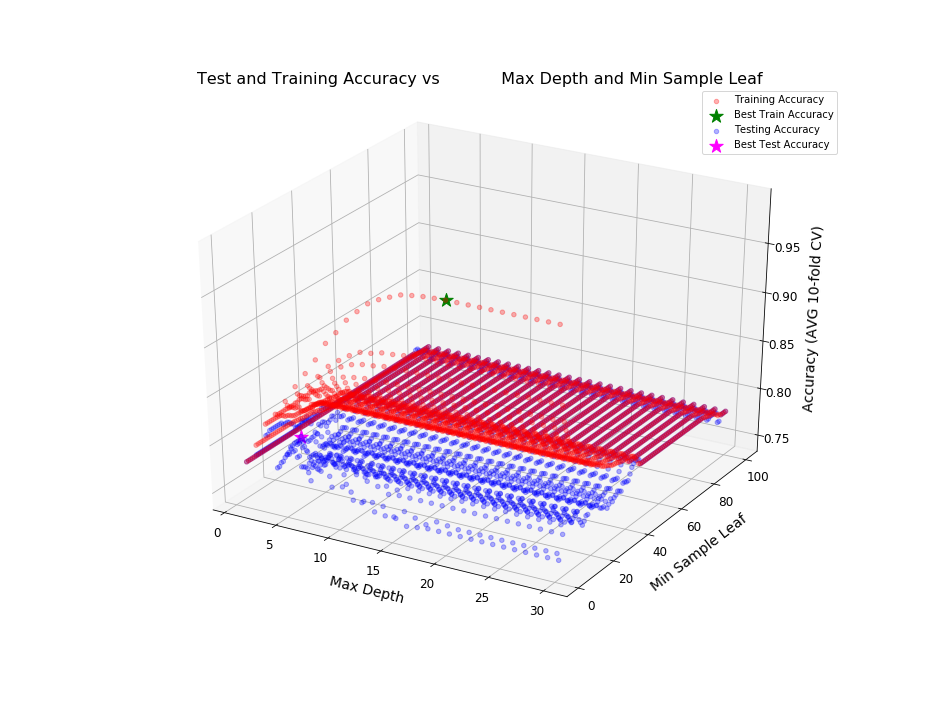

In [110]:
# Plot
# Importations (3D and interactive plot)
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d import proj3d
%matplotlib notebook

# Figure size
fig = plt.figure(figsize = (13, 10)) 
ax = fig.add_subplot(111, projection ='3d')

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Prepare data
X = [0 for i in range(0, len(MaxDepths) * len(MinSampleLeaf))]
Y = [0 for i in range(0, len(MaxDepths) * len(MinSampleLeaf))]
ZTrain = [0 for i in range(0, len(MaxDepths) * len(MinSampleLeaf))]
ZTest = [0 for i in range(0, len(MaxDepths) * len(MinSampleLeaf))]

aux = 0


for md in range(len(MaxDepths)):
    for ms in range(len(MinSampleLeaf)):
        X[aux] = MaxDepths[md]
        Y[aux] = MinSampleLeaf[ms]
        ZTrain[aux] = AVGAccTrain[ms][md] 
        ZTest[aux] = AVGAccTest[ms][md]
        aux += 1

# Title and labels
plt.title('Test and Training Accuracy vs Max Depth and Min Sample Leaf',  y = 1.08)
ax.set_xlabel("Max Depth", labelpad = 10)
ax.set_ylabel("Min Sample Leaf", labelpad = 10)
ax.set_zlabel("Accuracy (AVG 10-fold CV)", labelpad = 10)

# Plot
ax.scatter3D(X, Y, ZTrain, c ='r', marker = 'o', 
             label = "Training Accuracy", alpha = 0.3)
ax.scatter3D(BestGlobalMDTrain, BestGlobalMSTrain, 
             BestAVGAccTrain, c = 'g', marker = '*', 
             label = "Best Train Accuracy", s = 200)
ax.scatter3D(X, Y, ZTest, c ='b', marker = 'o', 
             label = "Testing Accuracy", alpha = 0.3)
ax.scatter3D(BestGlobalMDTest, BestGlobalMSTest,
             BestAVGAccTest, c = '#ff00ff', marker = '*', 
             label = "Best Test Accuracy", s = 200)

#plt.grid()
plt.legend()
plt.show()


<IPython.core.display.Javascript object>


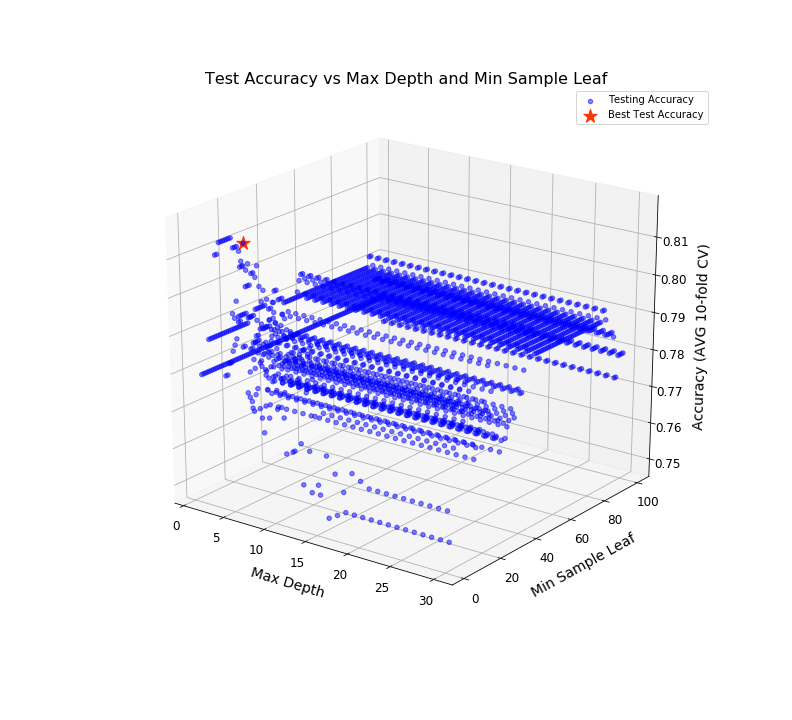

In [114]:
# Plot (only Testing)
# Figure size
fig = plt.figure(figsize = (11, 10)) 
ax = fig.add_subplot(111, projection ='3d')

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Title and labels
plt.title('Test Accuracy vs Max Depth and Min Sample Leaf', 
          y = 1.08)
ax.set_xlabel("Max Depth", labelpad = 10)
ax.set_ylabel("Min Sample Leaf", labelpad = 10)
ax.set_zlabel("Accuracy (AVG 10-fold CV)", labelpad = 10)

# Plot
ax.scatter3D(X, Y, ZTest, c ='b', marker = 'o',
             label = "Testing Accuracy", alpha = 0.5)
ax.scatter3D(BestGlobalMDTest, BestGlobalMSTest,
             BestAVGAccTest, c = '#ff3300', marker = '*', 
             label = "Best Test Accuracy", s = 200)

#plt.grid()
plt.legend()
plt.show()


<IPython.core.display.Javascript object>


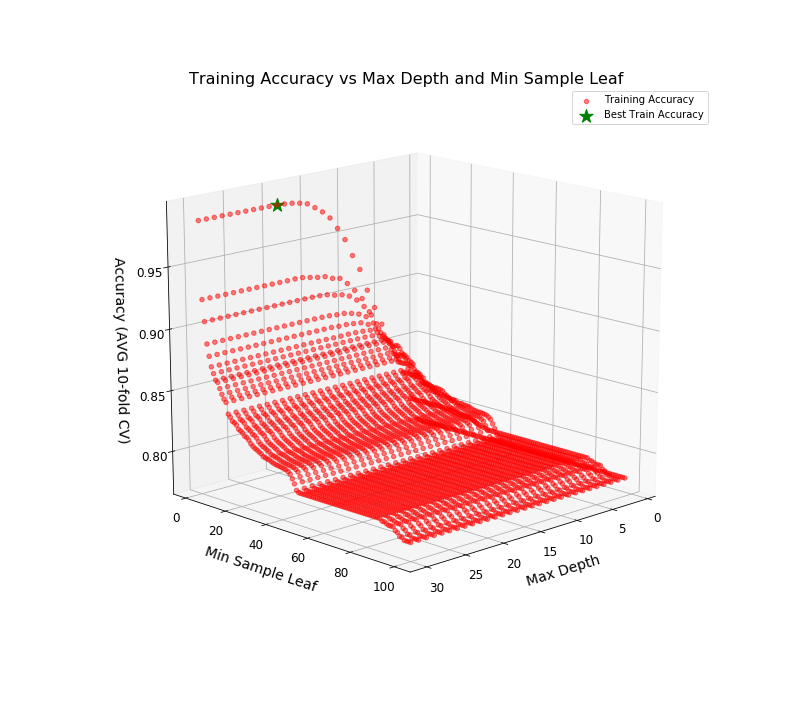

In [113]:
# Plot (only Training)
# Figure size
fig = plt.figure(figsize = (11, 10)) 
ax = fig.add_subplot(111, projection ='3d')

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Title and labels
plt.title('Training Accuracy vs Max Depth and Min Sample Leaf', 
          y = 1.08)
ax.set_xlabel("Max Depth", labelpad = 10)
ax.set_ylabel("Min Sample Leaf", labelpad = 10)
ax.set_zlabel("Accuracy (AVG 10-fold CV)", labelpad = 10)

# Plot
ax.scatter3D(X, Y, ZTrain, c ='r', marker = 'o',
             label = "Training Accuracy", alpha = 0.5)
ax.scatter3D(BestGlobalMDTrain, BestGlobalMSTrain,
             BestAVGAccTrain, c = 'g', marker = '*', 
             label = "Best Train Accuracy", s = 200)

#plt.grid()
plt.legend()
plt.show()


## Observations

### First, show how max_depth affects train and test accuracy. On a single axis, plot train and test accuracy as a function of max_depth. Use a red line to show test accuracy and a blue line to show train accuracy.

The max depth vs train and test accuracy plot can be seen in the previous code section.
For the 3D graphs, please check the interactive plots above. By default, they are static plots but if the code is re-run they will be interactive plots where the user can perform operations such as rotations, zooms, etc.

Based on the Max Depth parameter vs train and test accuracy plot, we can clearly identify the following patterns:
- Train Accuracy: adding more and more layers (increasing the max depth parameter) to the decision tree will positively impact the accuracy within the training set because the model will include more and more possibilities, ending up with a clear and explicit overfitting with regarding the training data. This pattern can be easily seen in the plot where we can observe an increasing curve for the training accuracy, reaching a maximum (steady-state) when the max depth parameter is equal to 20 (Accuracy = 98.7%). After that threshold, there is no improvement in the training set accuracy due to the fact that the model cannot improve its predictive power just by adding extra layers.

- Testing Accuracy: As expected, increasing the value of the max depth parameter will have a negative impact on the testing accuracy because of the overfitting effect experienced by the model to the training dataset. Thus, we can clearly see how there is a decreasing trend in this curve. Looking at the optimal value of the maximum depth of the tree for the testing accuracy, we can see that a maximum depth of 3 layers is the optimal one in terms of testing accuracy (81.2%).

As a summary, we have the following table:

| Set      | Best Accuracy [%] | Best Max Depth | 
|----------|-------------------|----------------|
| Training |              98.7 |             20 |
|  Testing |              81.2 |              3 |


### What combination of max_depth and min-samples_leaf achieves the highest accuracy? How sensitive are the results to these two parameters?

Based on the generated plots for both datasets, the best combinations obtained for the training and testing sets, and the highest accuracies reached are:

| Set      | Best Accuracy [%] | Best Max Depth | Best Min Sample Leaf |
|----------|-------------------|----------------|----------------------|
| Training |              98.7 |             20 |                    1 |
|  Testing |              81.6 |              6 |                    3 |

|                Model               | Training Accuracy [%] | Testing Accuracy [%] |
|------------------------------------|-----------------------|----------------------|
| Decision tree - testing optimized  | 85.799                |  81.600              |
| Decision tree - training optimized | 98.704                |  76.259              |

We can clearly see that the maximum depth of the tree is a critical parameter for the final accuracy of the model when applying it to both the testing and training sets. As we already discussed in previous sections, it is important to understand that adding more layers to the model will clearly increase its accuracy with regarding the training set, incurring in an explicit overfitting of the model to that particular dataset. Therefore, the model loses generalization and prediction accuracy for observations outside of the training dataset and thus, it is no longer useful for out of the sample predictions. This can be clearly seen in the previous table, where the optimal value of the maximum depth parameter for the Testing set is $6$, while it is equal to $20$ when the model is applied to the training set, being consistent with our initial thoughts.

On the other hand, we can see that the optimal number for the minimum sample leaf parameter is larger in the case of the testing set accuracy ($3$ vs $1$) because increasing this value will help the model to be more general in terms of the classification, allowing it to reach better accuracy in out-of-the-sample observations.

Regarding the sensitivity of the results (Accuracy) to these two parameters, we can see that (based on the previous plots) there exist a significant variation in terms of the model performance depending on the combination of these two parameters. As an example, we can see in the plots above how in the case of the training error the accuracy of the model can vary from (approx.) $75$ to $98.7$, and from $75$ to $81.6$ in the testing set case.

Increasing the maximum depth of the tree tends to increase the accuracy of the training set and decrease the accuracy of the testing set while increasing the minimum sample leaf value tends to have the opposite effect. This can be clearly seen in the previous plots. As an example, the training set accuracy falls below 80% when the minimum sample leaf parameter is around 100 no matter the value of the maximum depth of the tree. On the other hand, higher accuracy levels can be achieved when the maximum depth of the tree is increased alongside with a low value for the minimum sample leaf. The opposite effect can be seen in the testing set.

Thus, we can easily conclude that one of the most important steps when fitting prediction/classification models to our data containing a series of hyper-parameters consists of the optimization of these parameters by performing a formal cross-validation approach when training the model to the available data.

### 2.4 Logistic Regression, for comparison
Use a 10-fold cross-validated logistic regression predict survival. Make sure you come up with an appropriate way of handling each of the input variables before feeding them in to the regression. 
* How does the performance of this model compare to the decision tree?
* How do the coefficients from the logistic regression compare to the feature importances from the decision tree? Create a scatter plot that shows this relationship (one dot for each variable, y-axis is feature importance, x-axis is....?)

In [36]:
# Importations
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV

# Simple model (No CV)
Intercept = False
LogReg = LogisticRegression(fit_intercept = Intercept)
LogReg = LogReg.fit(X = XTStdNonan, y = YTStdNonan)
X = XTStdNonan
y = YTStdNonan

# Accuracy
print("Accuracy (full Train set):", 
      LogReg.score(X = XTStdNonan, y = YTStdNonan))

# Coefficients
Betas = LogReg.coef_[0]
Inter = LogReg.intercept_
print("Coefficients:\n", Betas)
print("Intercept:", Inter)

# Display info 
if Intercept == True:
    Coef = [0 for i in range(len(X.columns) + 1)]
    Label = [0 for i in range(len(X.columns) + 1)]

else:
    Coef = [0 for i in range(len(X.columns))]
    Label = [0 for i in range(len(X.columns))]
    
# Create DataFrame with results    
for i in range(0, len(Coef)):
    if i == 0 and Intercept == True:
        Coef[i] = Inter[0]
        Label[i] = "Inter"
    if i > 0 and Intercept == True:
        Coef[i] = Betas[i - 1]
        Label[i] = X.columns[i - 1]
        
    if Intercept == False:
        Coef[i] = Betas[i]
        Label[i] = X.columns[i]
        
# Results        
Results = pd.DataFrame({"Coefficient":Label,
                        "Values": Coef})        
display(Results)

Accuracy (full Train set): 0.789325842697
Coefficients:
 [-0.63919474  2.55067018 -0.31096624 -0.09126042  0.07190027  0.37259716
 -0.43618003]
Intercept: 0.0


,Coefficient,Values
0,Pclass,-0.639195
1,Sex,2.550670
2,SibSp,-0.310966
3,Parch,-0.091260
4,Embarked,0.071900
5,STDFare,0.372597
6,STDAge,-0.436180


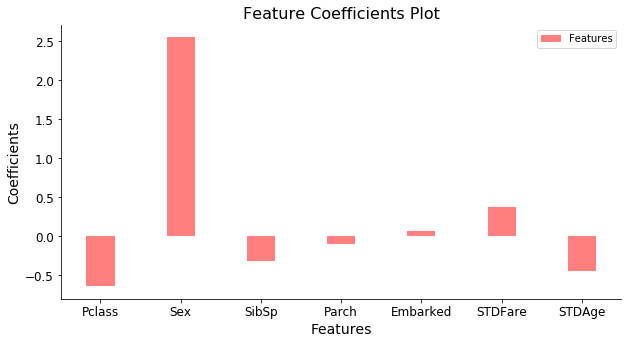

In [37]:
# Plot
# Feature coeff plot
%matplotlib inline

# Figure size
plt.figure(figsize = (9, 5)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Number of bars          
n_groups = len(Coef)

# Visual style
index = np.arange(n_groups)
bar_width = 0.35
opacity = 0.5

rects1 = plt.bar(index, Coef, bar_width,
                 alpha = opacity,
                 color = 'r', 
                 label = 'Features')

# Labels, Title, and legends
plt.xlabel("Features")
plt.ylabel('Coefficients')
plt.title("Feature Coefficients Plot")
plt.xticks(index, Label)
plt.legend()

plt.tight_layout()
plt.show()    

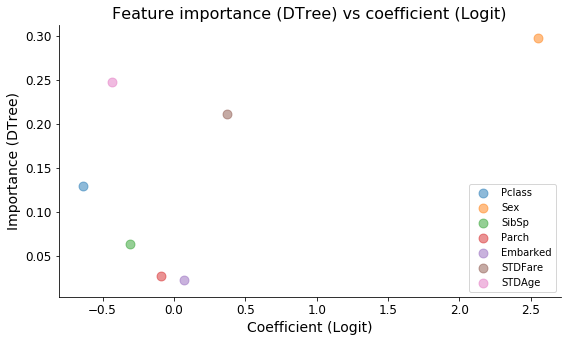

In [38]:
# Scatter plot
# Figure size
fig = plt.figure(figsize = (9, 5)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Title and labels
plt.title('Feature importance (DTree) vs coefficient (Logit)')
ax.set_xlabel("Coefficient (Logit)")
ax.set_ylabel("Importance (DTree)")

# Plot
for i in range(0, len(Coef)):
    ax.scatter(Coef[i], FeatImp[i], marker = 'o', 
               s = 80, label = Label[i], alpha = 0.5)

plt.legend()
plt.show()

In [39]:
# 10-fold Model: Own Cross-Validation method
# Random seed: reproducibility
np.random.seed(1)

# Data
X = XTStdNonan
y = YTStdNonan

# K-folds value
k = 10

# Intercept and feature coefficients
Results = [0 for i in range(0, k)]

# Accuracy 
AccTrain = [0 for i in range(0, k)]
AccTest = [0 for i in range(0, k)]
BestAccTest = 0
BestIter = 0
BestCoeff = []

# Niters
niters = 0

# Intercept
Intercept = False

# CV loop
kf = KFold(n_folds = k, n = len(X), shuffle = True)

# Generate the sets
for train_index, test_index in kf:
    # Iteration number
    print("------------------------- Iteration", niters + 1, "-------------------------")
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Calling the function
    LogitReg = LogisticRegression(fit_intercept = Intercept)
    LogitReg = LogitReg.fit(X_train, y_train)
    
    # Computing Accuracy
    # Training Accuracy value
    AccTrain[niters] = LogitReg.score(X = X_train, y = y_train) 
        
    # Testing Accuracy value
    AccTest[niters] = LogitReg.score(X = X_test, y = y_test) 
        
    # Best RMSE
    if AccTest[niters] > BestAccTest:
        BestAccTest = AccTest[niters]
        print("BestAccTest", BestAccTest)
        BestIter = niters
        BestCoeff = LogitReg.coef_[0]
    
    # Print results
    print("Iteration Results")
    print("-------------------- Accuracy --------------------")
    print("Training set:", AccTrain[niters])
    print("Testing set:", AccTest[niters])
    print("--------------------------------------------------")
    
    # Next iteration
    niters += 1
    
# Summary results
print("\n\nSummary 10-fold Cross-validation")
print("---------------------------------------")
print("Average Accuracy training:", np.mean(AccTrain))
print("Average Accuracy testing:", np.mean(AccTest))
print("Best Accuracy (test):", BestAccTest, "on iteration", BestIter + 1)
print("Coefficients of features best accuracy (test):\n", BestCoeff)
print("---------------------------------------")

------------------------- Iteration 1 -------------------------
BestAccTest 0.763888888889
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7921875
Testing set: 0.763888888889
--------------------------------------------------
------------------------- Iteration 2 -------------------------
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7921875
Testing set: 0.736111111111
--------------------------------------------------
------------------------- Iteration 3 -------------------------
BestAccTest 0.816901408451
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.816901408451
--------------------------------------------------
------------------------- Iteration 4 -------------------------
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790951638066
Testing set: 0.760563380282
-------------------------------------------

<IPython.core.display.Javascript object>


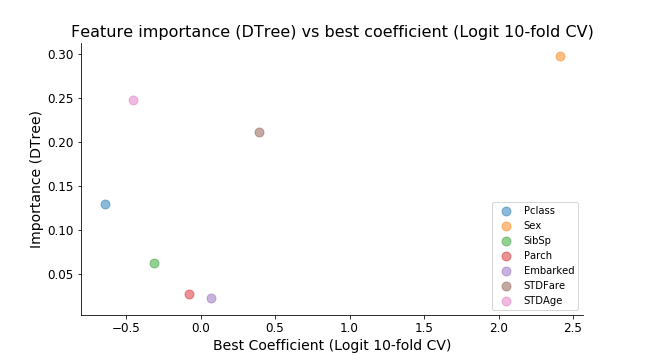

In [115]:
# Scatter plot
# Figure size
fig = plt.figure(figsize = (9, 5)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Title and labels
plt.title('Feature importance (DTree) vs best coefficient (Logit 10-fold CV)')
ax.set_xlabel("Best Coefficient (Logit 10-fold CV)")
ax.set_ylabel("Importance (DTree)")

# Plot
for i in range(0, len(BestCoeff)):
    ax.scatter(BestCoeff[i], FeatImp[i], marker = 'o', 
               s = 80, label = Label[i], alpha = 0.5)

plt.legend()
plt.show()

## Observations
### How does the performance of this model compare to the decision tree?

Based on the previous results, we can construct the following table:

| Model                                  | AVG Training Accuracy [%] | AVG Testing Accuracy [%] |
|----------------------------------------|---------------------------|--------------------------|
| Decision Tree (default)                | 98.704                    |  74.859                  |
| Decision tree - testing optimized      | 85.799                    |  81.600                  |
| Decision tree - training optimized     | 98.704                    |  76.259                  |
| Logistic Regression                    | 78.823                    |  77.676                  |

Looking at the table, we can easily check how the training set accuracy is far better in any of the Decision Tree implementations, reaching values above 85% across all of them while the Logistic regression model is not able to obtain values above 80%. On the other hand, we can see that the testing set accuracy for the Logistic regression model ($77.676$ [%]) is the second best among all the previous Decision tree implementations. In particular, we can clearly see that it is only outperformed by the testing optimized version of the Decision tree ($81.6$ [%]), using the specific values obtained in the previous sections for the maximum depth and minimum sample leaf parameters.

Therefore, we can clearly see one of the disadvantages of the decision tree models: they usually tend to overfit the training data, leading to less general (and less accurate) prediction models in comparison to other machine learning algorithms such as the simple Logistic regression, where without any optimization (no hyperparameters are included), we are able to obtain better results than the vanilla implementation of the decision tree models.

### How do the coefficients from the logistic regression compare to the feature importances from the decision tree? Create a scatter plot that shows this relationship.

Based on the results obtained, we have the following summary table:

|  Feature | Coefficient (10-fold CV Logistic Regression) | Importance (Decision Tree, default) | Importance (Decision Tree, optimized) |
|:--------:|:---------------------------------:|:-----------------------------------:|:-------------------------------------:|
|   Pclass |                       -0.64035278 |                          0.12963439 |                            0.21829350 |
|      Sex |                        2.41477699 |                          0.29736009 |                            0.45337716 |
|    SibSp |                       -0.31164664 |                          0.06351679 |                            0.06146142 |
|    Parch |                       -0.07552999 |                          0.02764753 |                            0.01374363 |
| Embarked |                        0.07205360 |                          0.02301478 |                            0.00000000 |
|  STDFare |                        0.39224989 |                          0.21097538 |                            0.09504841 |
|   STDAge |                       -0.45070246 |                          0.24785104 |                            0.15807587 |

Looking at the previous results we can clearly see the following patterns:

- $Sex$: The most relevant variable among all the models based on its importance (Decision trees) and the coefficient obtained after the Logistic Regression. As expected, it is one of the most relevant variables when predicting the chances of surviving the Titanic accident. It is by far the most relevant variable in terms of magnitude for the Logistic regression and also the most important one in the vanilla and optimized (testing) implementation of the Decision tree models.

- $Pclass$: The second most important variable in the Logistic regression and the optimized Decision tree models. As discussed at the beginning of the current problem set, it will have an important predictive relevance inside the models due to its strong correlation with the label and $Fare$ feature. Important is to notice how its importance changed in the Decision tree model before and after the Hyperparameters optimization, from 0.1296 to 0.2182. In addition, seems like the $Pclass$ feature importance includes the effect of the $STDFare$ feature in the optimized decision tree, decreasing the importance of the fare paid by the passengers to a not relevant amount.

- $STDAge$: Age (standardized) is the third more relevant feature in the Logistic regression and optimized decision tree models. As discussed in previous sections, its predictive power was not as explicit as the previous features when performing the preliminary exploratory analysis, however, it is a very relevant feature of the tested models. Notice how in the vanilla implementation of the decision tree model, the differences in features importance are not as strong as in the optimized version. 

- $SibSP$: Interesting is to see how this feature emerges as a relevant one (in terms of magnitude) for the Logistic regression model while its importance is not significant for both decision tree implementations. However, in all models, we can see that it is the third worst variable in terms of importance.

- $Parch$ and $Embarked$: As with the decision tree models, the relevance in terms of magnitude for the Logistic regression for these two features is irrelevant (not significant), sharing the same order of magnitude between the coefficient of the regression and the importance computed for the decision tree models.

All these relationships can be easily seen in the scatter plot above where important variables for the Logistic Regression will tend to be on the right side of the plot and important features for the Decision trees will tend to be on the top of the graph. At the same time, the scatter plot allows us to contrast the magnitude/relevance of each feature inside each model. Equal importance magnitude will be identified by dots in the diagonal of the previous scatter plot, indicating that the values are exactly the same in both axes.

### 2.5 (Extra Credit): Implement a Decision Tree in Python

For extra credit, put away the canned algorithm from sklearn, and write your own decision tree algorithm. Use the simple recursive algorithm we described in class, and use your algorithm to re-do the analysis in 2.1. Do not worry about implementing bells and whistles. However, you will definitely need the following:
 * A "BuildTree" function that implements the recursive algorithm
 * A function to calculate information gain
 
For this problem, you can consult the internets to see how other have done this. However, you must make your code your own - do not plagiarize the examples of other peoples. Implement the minimum required code to build a decision tree

In [41]:
# Enter your code here

## Observations (Extra Credit)

## Part 3: Putting together the pieces 

Over the past two months, you have learned the nuts and bolts of a large number of machine learning algorithms. This list includes: 
* Linear Regression
* Logistic Regression
* LASSO / Ridge Regression
* Support Vector Machines
* Nearest Neighbor
* k-Nearest Neighbors
* Naive Bayes
* Decision Trees
* Regression Trees
* Random Forests
* Boosted trees
* Perceptrons
* Neural Networks

Here, you will explore how well different algorithms can predict survival on the Titanic.


### 3.1 Horseraces

In addition to logistic regression and the single decision tree, use the following algorithms to predict survival: LASSO regression, k-Nearest Neighbors, [random forest](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html), a [multi-layer perceptron](http://scikit-learn.org/stable/modules/neural_networks_supervised.html) and [Gradient Boosting](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html). Make sure everything you do is carefully cross-validated, and that you are providing the same data to each algorithm, in a sensible way.

Create a barplot that shows how well each algorithm compares relative to the others, separately for the training and testing datsets. Define "performance" in the way you think is most appropriate for this problem, and justify that decision. What algorithm performs best?

*Note:* You might want to consider more than one measures of performance

In [42]:
# Importations
from sklearn.cross_validation import KFold
from sklearn.linear_model import Lasso
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import Ridge
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier

# CV function
def CVKFold(k, X, y, Model, TuningParams):
    # Starting time
    startT = time.time()

    # Random seed: reproducibility
    np.random.seed(1)

    # Intercept and feature coefficients
    Results = [0 for i in range(0, k)]

    # Accuracy Results
    AccTrain = [[0 for i in range(0, k)] for j in range(0, len(TuningParams[0]))]
    AccTest = [[0 for i in range(0, k)] for j in range(0, len(TuningParams[0]))]
    AVGAccTrain = [0 for j in range(0, len(TuningParams[0]))]
    AVGAccTest = [0 for j in range(0, len(TuningParams[0]))]

    # Best values
    BestAccTest = 0
    BestAccTrain = 0
    BestParamTrain = 0
    BestParamTest = 0

    # Best Iterations
    BestOuterIter = 0
    BestOuterIterTest = 0
    BestOuterIterTrain = 0
    BestIter = 0

    # Best importance/Coefficients
    BestImportance = []

    # Best global results
    BestAVGAccTrain = 0
    BestAVGAccTest = 0

    # Niters
    niters = 0
    nouteriter = 0

    # CV loop
    kf = KFold(n_folds = k, n = len(X), shuffle = True)
    
    # Max Depth loop
    for Par in TuningParams[0]:
        print("----------------------- Hyper-Param =", Par, "-----------------------" )

        # Reset values
        niters = 0
        BestAccTest = 0
        BestAccTrain = 0

        # Generate the sets
        for train_index, test_index in kf:
            # Iteration number
            print("------------------ CV Iteration", niters + 1, "------------------")
            X_train, X_test = X.iloc[train_index], X.iloc[test_index]
            y_train, y_test = y.iloc[train_index], y.iloc[test_index]

            # Calling the function/model
            if Model == "Tree":
                clf = tree.DecisionTreeClassifier(max_depth = Par, 
                                                  random_state = 0)
               
            if Model == "Logit":
                clf = LogisticRegression(fit_intercept = False, 
                                         random_state = 0)
            
            if Model == "Lasso":
                clf = Lasso(alpha = Par, 
                            fit_intercept = False, 
                            random_state = 0)
                
            if Model == "Knn":
                clf = KNeighborsClassifier(n_neighbors = Par, 
                                           p = TuningParams[1])
                
            if Model == "RForest":
                clf = RandomForestClassifier(max_depth = Par, 
                                             min_samples_leaf = TuningParams[1],  
                                             n_estimators = TuningParams[2],      
                                             random_state = 0)
            
            if Model == "MLPercept":
                clf = MLPClassifier(alpha = 0.0001, 
                                    learning_rate = TuningParams[2], 
                                    activation = TuningParams[1],    
                                    hidden_layer_sizes = Par,        
                                    random_state = 0)
            
            if Model == "GradientB":
                clf = GradientBoostingClassifier(learning_rate = TuningParams[2],  
                                                 n_estimators = Par,               
                                                 max_depth = TuningParams[1],      
                                                 min_samples_leaf = 1,  
                                                 random_state = 0)      
            
            # Fit the model
            clf = clf.fit(X_train, y_train)
            
            # Special accuracy for Lasso
            if Model == "Lasso":
                # Predictions
                y_hat_train = clf.predict(X_train)
                y_hat_test = clf.predict(X_test)
                
                # Train values
                y_hat_train[y_hat_train > 0.5] = 1
                y_hat_train[y_hat_train <= 0.5] = 0
                AccTrain[nouteriter][niters] = (y_hat_train == y_train).sum().astype(float) / len(y_hat_train)
                                        
                # Test values
                y_hat_test[y_hat_test > 0.5] = 1
                y_hat_test[y_hat_test <= 0.5] = 0
                AccTest[nouteriter][niters] = (y_hat_test == y_test).sum().astype(float) / len(y_hat_test)           

            # Binary classification models
            else:
                # Computing Accuracy/RMSE
                # Training Accuracy value
                AccTrain[nouteriter][niters] = clf.score(X = X_train, y = y_train) 

                # Testing Accuracy value
                AccTest[nouteriter][niters] = clf.score(X = X_test, y = y_test) 

            # Best test Accuracy (inner)
            if AccTest[nouteriter][niters] > BestAccTest:
                BestAccTest = AccTest[nouteriter][niters]
                BestIter = niters
                BestOuterIter = nouteriter
                
                # Coefficients/Importance
                if Model == "Lasso":
                    BestImportance = clf.coef_
                    
                elif Model == "Knn" or Model == "MLPercept":
                    print("Nothing")
                
                else:
                    BestImportance = clf.feature_importances_

            # Print results
            print("CV Iteration Results")
            print("-------------------- Accuracy --------------------")
            print("Training set:", AccTrain[nouteriter][niters])
            print("Testing set:", AccTest[nouteriter][niters])
            print("--------------------------------------------------")

            # Next iteration
            niters += 1

        # CV AVG accuracy
        AVGAccTrain[nouteriter] = np.mean(AccTrain[nouteriter])
        AVGAccTest[nouteriter] = np.mean(AccTest[nouteriter])

        # Summary results
        print("\n\nSummary 10-fold Cross-validation, Param =", Par)
        print("---------------------------------------")
        print("Average Accuracy training:", AVGAccTrain[nouteriter])
        print("Average Accuracy testing:", AVGAccTest[nouteriter])
        print("Best Accuracy (test):", BestAccTest, "on iteration", BestIter + 1)
        print("Importance of features best accuracy (test):\n", BestImportance)
        print("---------------------------------------\n\n")

        # Best AVG accuracy (train & test)
        if AVGAccTrain[nouteriter] > BestAVGAccTrain:
            BestAVGAccTrain = AVGAccTrain[nouteriter]
            BestOuterIterTrain = nouteriter
            BestParamTrain = Par

        if AVGAccTest[nouteriter] > BestAVGAccTest:
            BestAVGAccTest = AVGAccTest[nouteriter]
            BestOuterIterTest = nouteriter
            BestParamTest = Par

        # Next outer iteration
        nouteriter += 1

    # Final results
    print("\n\nFinal Results")
    print("---------------------------------------")
    print("Best Param (training):", BestParamTrain)
    print("Best AVG Accuracy (training):", BestAVGAccTrain)
    print("Best Param (testing):", BestParamTest)
    print("Best AVG Accuracy (testing):", BestAVGAccTest)
    print("---------------------------------------")
    
    return(BestParamTrain, BestParamTest, BestAVGAccTrain, BestAVGAccTest)

In [43]:
# Optimizing models: 10-fold CV and hyperparameters loops
# LASSO regression: Small Test with full Dataset
# Data
X = XTStdNonan
Y = YTStdNonan

# Regression with fixed Lambda (alpha)
clf = Lasso(alpha = 0.01, fit_intercept = False, random_state = 0)
clf = clf.fit(X, Y)

# Predictions and Binarization with 0.5 as threshold
y_hat = clf.predict(X)
y_hat[y_hat > 0.5] = 1
y_hat[y_hat <= 0.5] = 0

# Display accuracy
print("Accuracy (Small test):", np.round((y_hat == Y).sum().astype(float) / len(Y), 3))


# CV function
k = 10
Lambdas = np.arange(0.001, 1.001, 0.001)
TuningParams = [Lambdas]
Model = "Lasso"

# Call the function
ResultsLasso = CVKFold(k, X, Y, Model, TuningParams)

Accuracy (Small test): 0.779
----------------------- Hyper-Param = 0.001 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7828125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.775351014041
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.786271450858
Testing set: 0.732394366197
-------------------------------------------

Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.005
---------------------------------------
Average Accuracy training: 0.780119198518
Average Accuracy testing: 0.779557902973
Best Accuracy (test): 0.859154929577 on iteratio

------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.780031201248
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.013
---------------------------------------
Average Accuracy training: 0.779495173557
Average Accuracy testing: 0.779557902973
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 [ 0.02683148  0.52306083 -0.0

Training set: 0.770670826833
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.780031201248
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.773790951638
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.025
---------------------------------------
Average Accuracy training: 0.779495173557
Average Accuracy testing: 0.779557902973
Best Accuracy (test

------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.786271450858
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.037
---------------------------------------
Average Accuracy training: 0.779963192278
Average Accuracy testing: 0.773943661972
Best Accuracy (test): 0.830985915493 on iteration 10
Importance of features best accuracy (test):
 [ 0.04350958  0.4690111  -0.         -0.          0.03728804  0.07928467
 -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.038 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteratio

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.756630265211
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.770670826833
Testing set: 0.845070422535
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.049
---------------------------------------
Average Accuracy training: 0.7

--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.059
---------------------------------------
Average Accuracy training: 0.761080099454
Average Accuracy testing: 0.757061815336
Best Accuracy (test): 0.830985915493 on iteration 10
Importance of features best accuracy (test):
 [ 0.05105816  0.4040636  -0.          0.          0.0318015   0.06741258
 -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.06 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7578125
Testing set: 0.722222222222
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7640625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Ite

Training set: 0.731669266771
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.748829953198
Testing set: 0.661971830986
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.736349453978
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.742589703588
Testing set: 0.661971830986
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.717628705148
Testing set: 0.732394366197
-----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.636505460218
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.712948517941
Testing set: 0.704225352113
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.716068642746
Testing set: 0.704225352113
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.613104524181
Testing set: 0.704225352113
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.084
---------------------------------------
Average Accuracy training: 0.6

--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.611544461778
Testing set: 0.577464788732
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.634945397816
Testing set: 0.661971830986
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.644305772231
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.589703588144
Testing set: 0.718309859155
--------------------------------------------------


Summary 10-fol

-------------------- Accuracy --------------------
Training set: 0.603744149766
Testing set: 0.633802816901
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.605304212168
Testing set: 0.549295774648
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.622464898596
Testing set: 0.549295774648
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.589703588144
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6

------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.614664586583
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.578783151326
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.580343213729
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.605304212168
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.115
-----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.127
---------------------------------------
Average Accuracy training: 0.598938913807
Average Accuracy testing: 0.59970657277
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.06294399  0.22037167  0.          0.          0.03530516  0.04113043
 -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.128 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy ---------------

Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.0667101   0.18598777  0.          0.          0.03281028  0.03541157
 -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.14 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.59375
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration R

------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Re

Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.07768043  0.0856978   0.          0.          0.02555091  0.01872978
 -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.175 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration

Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
---------------------------------------

Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
----------------------------------------

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration R

Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
----------

Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.234
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.09101404  0.          0.          0.          0.00483069  0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.235 -----------

------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Re

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.259
---------------------------------------
Average Accuracy training: 0.5

Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.27
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration

------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.281
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.08599159  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.282 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
---

Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
-------------------------

--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.306
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.08164288  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.307 -----------------------
---------------

------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.318
-----------------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
--------

Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
----------

Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
-----------

Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
-----------

Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.379
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.06894464  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.38 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------

Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
-----------

Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.404
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.06459593  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.405 -----------

Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.0626825  0.         0.         0.         0.         0.        -0.       ]
---------------------------------------


----------------------- Hyper-Param = 0.416 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
-------------------------------------------------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
--------

Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.439
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.05850773  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.44 ------------

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration R

Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.05415902  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.465 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 

------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.477
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.05189769  0.          0. 

Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.04981031  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.49 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
-

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
--------

-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.

-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6

-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.537
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.04146079  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.538 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Tes

------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.55
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.03919946  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.551 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration R

------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Re

--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.575
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.03485075  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.576 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 -------

-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6

--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
-----------------

Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.608
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test

------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Re

-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 

Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.644
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.0228483  0.         0.         0.         0.         0.        -0.       ]
---------------------------------------


----------------------- Hyper-Param = 0.645 ------------------

Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
----------------------------------------

------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Re

------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.682
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.01623826  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.683 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
---

Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.01415088  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.695 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 

Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
----------------------------------------

--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.717
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.01015007  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.718 -----------------------
---------------

-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Te

Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.742
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.00580136  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.743 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------

Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
----------------------------------------

Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.767
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.00145265  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.768 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
-------------

----------------------- Hyper-Param = 0.779 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Ite

-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5

---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.803 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.815
---------------------------------------
Average Accuracy training: 0.5

-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5

--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
-----------------

 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.851 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
---

Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.862
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.863 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------

------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Re

Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.887
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.888 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Res

Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.9 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
----------------

Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
------------------------------------

Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
---------------------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.58658

------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Re

Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
---

Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.969
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.97 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Resu

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
--------

------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600624024961
Testing set: 0.549295774648
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.994
---------------------------------------
Average Accuracy training: 0.595505801482
Average Accuracy testing: 0.595520344288
Best Accuracy (test): 0.676056338028 on iteration 5
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.995 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

In [44]:
# k-Nearest Neighbors
# Small Test
clf = KNeighborsClassifier(n_neighbors = 10, p = 2)
clf = clf.fit(X, Y)
print("Accuracy example:", clf.score(X, Y) , "\n\n")

# CV parameters
k = 10
Ks = np.arange(1, 31, 1)
ps = np.arange(1, 11, 1)
Model = "Knn"

# Results array and aux variables
ResultsKnn = [0 for i in range(0, len(ps))]
GlobalBestTrain = 0
GlobalBestTest = 0
BestKPTrain = 0
BestKPTest = 0

# Call the function (outer loop for L/p value)
for p in ps:
    print("------------------------------------ Norm L =", p, "------------------------------------")
    TuningParams = [Ks, p]
    ResultsKnn[p - 1] = CVKFold(k, X, Y, Model, TuningParams)
    
    # Global best
    if ResultsKnn[p - 1][2] > GlobalBestTrain:
        BestKPTrain = [ResultsKnn[p - 1][0], p]
        GlobalBestTrain = ResultsKnn[p - 1][2]

    if ResultsKnn[p - 1][3] > GlobalBestTest:
        BestKPTest = [ResultsKnn[p - 1][1], p]
        GlobalBestTest = ResultsKnn[p - 1][3]
        
# Final solution
print("\n\n------------ Final Solution ------------")
print("Best K, L training:", BestKPTrain[0], BestKPTrain[1])
print("Best AVG training Accuracy:", GlobalBestTrain)
print("Best K, L testing:", BestKPTest[0], BestKPTest[1])
print("Best AVG testing Accuracy:", GlobalBestTest)      
        

Accuracy example: 0.830056179775 


------------------------------------ Norm L = 1 ------------------------------------
----------------------- Hyper-Param = 1 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9875
Testing set: 0.708333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.680555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8453125
Testing set: 0.722222222222
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8296875
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.887323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---

-------------------- Accuracy --------------------
Training set: 0.8328125
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8375
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.887323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 25
---------------------------------------
Average Accuracy training: 0.830681064743
Average Accuracy testing: 0.807785602504
Best Accuracy (test): 0.887323943662 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 26 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8375
Testing set: 0.708333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8234375
Testing set: 0.777777777778
-------------------------

-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847113884555
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859594383775
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 4
---------------------------------------
Average Accuracy training: 0.856585

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8390625
Testing set: 0.708333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.825
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.825
Testing set: 0.694444444444
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8203125
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 21
---------------------------------------
Average Accuracy training: 0.818978402886
Average Accuracy testing: 0.799276212833
Best Accuracy (test): 0.87323943662 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 22 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8328125
Testing set: 0.694444444444
-------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------


CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.982839313573
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.704225352113
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.69014084507
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 1
---------------------------------------
Average Accuracy training: 0

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8578125
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.845553822153
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8421875
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.825
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 18
---------------------------------------
Average Accuracy training: 0.81335974064
Average Accuracy testing: 0.782453051643
Best Accuracy (test): 0.845070422535 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 19 

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy ------------

Training set: 0.808112324493
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 25
---------------------------------------
Average Accuracy training: 0.816482790562
Average Accuracy testing: 0.79651799687
Best Accuracy (test): 0.8

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.718309859155
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 28
---------------------------------------
Average Accuracy training: 0.815702028081
Average Accuracy testing: 0.78951486698
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 29 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8328125
Testing set: 0.708333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8140625
Testing set: 0.736111111111
----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8751950078
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 5
---------------------------------------
Average Accuracy training: 0.854714313573
Average Accuracy testing: 0.793661971831
Best Accuracy (test): 0.87323943662 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 6 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8421875
Testing set: 0.694444444444
---------------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8359375
Testing set: 0.722222222222
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.825
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.718309859155
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 12
---------------------------------------
Average Accuracy training: 0.82444

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 15
---------------------------------------
Average Accuracy training: 0.819132459048
Average Accuracy testing: 0.778227699531
Best Accuracy (test): 0.845070422535 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 16 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828125
Testing set: 0.680555555556
------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 22
---------------------------------------
Average Accuracy training: 0.812580684477
Average Accuracy testing: 0.782472613459
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 23 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.825
Testing set: 0.694444444444
-----------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------


CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.718309859155
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 29
---------------------------------------
Average Accuracy training:

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8796875
Testing set: 0.722222222222
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88125
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879875195008
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8375
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.84399375975
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847113884555
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83125
Testing set: 0.708333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8125
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 19
---------------------------------------
Average Accuracy training: 0.81429650936
Average Accuracy testing: 0.788028169014
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 20 

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ---

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 26
---------------------------------------
Average Accuracy training: 0.812267696958
Average Accuracy testing: 0.785269953052
Best Accuracy (test): 0.845070422535 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 27 

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8078125
Testing set: 0.722222222222
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accurac

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8751950078
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.901408450704
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.886115444618
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828125
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 13
---------------------------------------
Average Accuracy training: 0.818976696568
Average Accuracy testing: 0.790825508607
Best Accuracy (test): 0.859154929577 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 14 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8359375
Testing set: 0.708333333333
------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.718309859155
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 16
---------------------------------------
Average Accuracy training: 0.823813621295
Average Accuracy testing: 0.781064162754
Best Accuracy (test): 0.845070422535 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 17 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828125
Testing set: 0.694444444444
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809375
Testing set: 0.805555555556
------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 23
---------------------------------------
Average Accuracy training: 0.813048703198
Average Accuracy testing: 0.788106416275
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 24 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.825
Testing set: 0.694444444444
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8171875
Testing set: 0.763888888889
--------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.798751950078
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.704225352113
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 30
---------------------------------------
Average Accuracy training: 0.807898059672
Average Accuracy testing: 0.779694835681
Best Accuracy (test): 0.859154929577 on iteration 8
Importance of features best accuracy (test):
 []
---------------------------------------




Final Results
-----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88767550702
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 3
---------------------------------------
Average Accuracy training: 0.877966312402
Average Accuracy testing: 0.79505086072
Best Accuracy (test): 0.901408450704 on iteration 7
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 4 ---

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

----------------------- Hyper-Param = 14 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834375
Testing set: 0.708333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8234375
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
------------------------------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 20
---------------------------------------
Average Accuracy training

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 27
---------------------------------------
Average Accuracy training: 0.8107078

Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.982839313573
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.982839313573
Testing set: 0.816901408451
----------------------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8578125
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8578125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ----

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83125
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8265625
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----

-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8299

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ----------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8265625
Testing set: 0.694444444444
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8171875
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.718309859155
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 28
---------------------------------------
Average Accuracy training: 0.808366565913
Average Accuracy testing: 0.779694835681
Best Accuracy (test): 0.845070422535 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 29 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.825
Testing set: 0.722222222222
---------------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8751950078
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8751950078
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy -------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859594383775
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 5
---------------------------------------
Average Accuracy training: 0.854401813573
Average Accuracy testing: 0.793661971831
Best Accuracy (test): 0.87323943662 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 6 ---

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8375
Testing set: 0.722222222222
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8265625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 12
---------------------------------------
Average Accuracy training: 0.82381

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 15
---------------------------------------
Average Accuracy training: 0.822879046412
Average Accuracy testing: 0.778227699531
Best Accuracy (test): 0.845070422535 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 16 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8296875
Testing set: 0.680555555556
-----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 22
---------------------------------------
Average Accuracy training: 0.812424678237
Average Accuracy testing: 0.783881064163
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 23 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8296875
Testing set: 0.694444444444
------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81903276131
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 29
---------------------------------------
Average Accuracy training:

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8796875
Testing set: 0.722222222222
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8796875
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8751950078
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.878315132605
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83775351014
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.848673946958
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.848673946958
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 12
---------------------------------------
Average Accuracy training: 0.823815571373
Average Accuracy testing: 0.796439749609
Best Accuracy (test): 0.859154929577 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 13 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834375
Testing set: 0.708333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109375
Testing set: 0.805555555556
----------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 19
---------------------------------------
Average Accuracy training: 0.815076540562
Average Accuracy testing: 0.788028169014
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 20

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80031201248
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 29
---------------------------------------
Average Accuracy training: 0.805869978549
Average Accuracy testing: 0.779636150235
Best Accuracy (test): 0.845070422535 on iteration 8
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Pa

In [45]:
# Random Forest
# Small Test
clf = RandomForestClassifier(max_depth = 3, 
                             min_samples_leaf = 10,  
                             n_estimators = 100,     
                             random_state = 0)
clf = clf.fit(X, Y)
print("Accuracy example:", clf.score(X, Y) , "\n\n")

# CV function
k = 10
MaxDepth = np.arange(1, 31, 1)
Model = "RForest"
nEstimators = np.arange(100, 160, 10)
mslList = np.arange(1, 10, 5)

# Results array and aux variables
ResultsRForest = [[0 for j in range(0, len(nEstimators))] for i in range(0, len(mslList))]
GlobalBestTrain = 0
GlobalBestTest = 0
BestMD_MS_NEST_Train = 0
BestMD_MS_NEST_Test = 0

aux0 = 0
aux1 = 0


# Call the function
for msl in mslList:
    aux1 = 0
    
    for nEst in nEstimators:
        print("---------------- Min Sample Leaf =", msl, "N-Estimators =", nEst, "----------------")
        TuningParameters = [MaxDepth, msl, nEst]
        ResultsRForest[aux0][aux1] = CVKFold(k, X, Y, Model, TuningParameters)
        
        # Global best
        if ResultsRForest[aux0][aux1][2] > GlobalBestTrain:
            BestMD_MS_NEST_Train = [ResultsRForest[aux0][aux1][0], msl, nEst]
            GlobalBestTrain = ResultsRForest[aux0][aux1][2]

        if ResultsRForest[aux0][aux1][3] > GlobalBestTest:
            BestMD_MS_NEST_Test = [ResultsRForest[aux0][aux1][1], msl, nEst]
            GlobalBestTest = ResultsRForest[aux0][aux1][3]
        
        aux1 += 1
        
    aux0 += 1
    
# Final solution
print("\n\n------------ Final Solution ------------")
print("Best MD, MSL, nEst training:", BestMD_MS_NEST_Train[0], 
      BestMD_MS_NEST_Train[1], BestMD_MS_NEST_Train[2])
print("Best AVG training Accuracy:", GlobalBestTrain)
print("Best MD, MSL, nEst testing:", BestMD_MS_NEST_Test[0], 
      BestMD_MS_NEST_Test[1], BestMD_MS_NEST_Test[2])
print("Best AVG testing Accuracy:", GlobalBestTest)     

Accuracy example: 0.818820224719 


---------------- Min Sample Leaf = 1 N-Estimators = 100 ----------------
----------------------- Hyper-Param = 1 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.79375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.79875

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8484375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.848673946958
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9046875
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.897035881435
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.909516380655
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results


------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.95
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.95007800312
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.957878315133
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.948517940718
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-----

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.971875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.967238689548
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.979719188768
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.971918876755
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results


------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results


------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-----------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-----------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-----------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-----------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8015625
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790951638066
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790951638066
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results

Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846875
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.858034321373
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.830985915493
----------------------------------------------

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9015625
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.903276131045
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.90639625585
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV It

Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9515625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.95007800312
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.959438377535
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.948517940718
Testing set: 0.845070422535
----------------------------------------------

Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.971875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.96879875195
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.979719188768
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.970358814353
Testing set: 0.859154929577
-----------------------------------------------

Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.845070422535
----------------------------------------------

Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.845070422535
--------------------------------------------------
------

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 

Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------

Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.798751950078
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-----

Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.84375
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83775351014
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.830985915493
------------------------------------------------

Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9015625
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.907956318253
Testing set: 0.830985915493
----------------------------------------------

Testing set: 0.833333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9515625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.951638065523
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.95631825273
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.946957878315
Testing set: 0.845070422535
----------------------------------------------

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9703125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.96879875195
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98127925117
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.973478939158
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV It

Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
-----------------------------------------------

Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.845070422535
--------------------------------------------------
------

Training set: 0.9890625
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
---------------------------------

Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------

Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7953125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.780031201248
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV 

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840625
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851794071763
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-

Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.903125
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.907956318253
Testing set: 0.830985915493
-----------------------------------------------

Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.953125
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.951638065523
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.959438377535
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.95007800312
Testing set: 0.830985915493
--------------------------------------------------
------

Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.96879875195
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.979719188768
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.971918876755
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.967238689548
Testing set: 0.845070422535
-----------------------------------------

Training set: 0.984375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.982839313573
Testing set: 0.845070422535
------------------

-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985

Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.887323943662
-------------

Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.887323943662
-------------

Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.887323943662
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.788732394366
-------------

--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790951638066
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.774647887324
--------------------------------------------------
-----------------

------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83775351014
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.858034321373
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851794071763
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.84399375975
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Resu

Training set: 0.9046875
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.901716068643
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.90639625585
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904836193448
Testing set: 0.859154929577
------------------

Training set: 0.9484375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.951638065523
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.959438377535
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.951638065523
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.953198127925
Testing set: 0.859154929577
----------------

Training set: 0.96875
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.967238689548
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.979719188768
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.971918876755
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.970358814353
Testing set: 0.845070422535
------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Tra

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.984399375975
Testi

Training set: 0.7921875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7984375
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.786271450858
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.798751950078
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.746478873239
---------------------

Training set: 0.8515625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85023400936
Testing set: 0.830985915493
----------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.903125
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.903125
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.90639625585
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.90639625585
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training se

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9515625
Testing set: 0.833333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9515625
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.951638065523
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.959438377535
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9796875
Testing set: 0.833333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9703125
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.970358814353
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.979719188768
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Traini

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.985959438378
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Traini

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.798751950078
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.845553822153
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trai

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859594383775
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
---

Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865625
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.830985915493
-----------------------------------------------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86875
Testing set: 0.833333333333
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
--

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8671875
Testing set: 0.833333333333
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV It

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8703125
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8703125
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8703125
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8703125
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Tra

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8015625
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790951638066
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8359375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV 

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.858034321373
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results


Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.887323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
-------------------------------------------------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results


------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8765625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results


--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8765625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV I

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8765625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results


------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8765625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results


--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.798751950078
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iterat

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.84375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83151326053
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
--

Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.816901408451
--------------------------------------------------
-----

Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
-------------------------------------------------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.887323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV I

Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8765625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.859154929577
----------------------------------------------

Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8765625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.859154929577
----------------------------------------------

Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8765625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.859154929577
----------------------------------------------

Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8765625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.859154929577
----------------------------------------------

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7953125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.780031201248
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV 

Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8453125
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.802816901408
--------------------------------------------------
----

Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.816901408451
-------------------------------------------------

Training set: 0.865625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8703125
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.878315132605
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.845070422535
----------------------

Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
-----------------------------------------------

Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
-----------------------------------------------

Training set: 0.86875
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
-------------------------

Training set: 0.86875
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
-------------------------

Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
-----------------------------------------------

Training set: 0.86875
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88143525741
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.845070422535
-------------------------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781591263651
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-----

Training set: 0.8375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847113884555
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.816901408451
-------------------------

Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.858034321373
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.816901408451
------------------------------------------------

Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.878315132605
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.845070422535
---------------------------------------------

Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.871875
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.887323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879875195008
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.845070422535
----------------------

Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.871875
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879875195008
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.845070422535
-----------------------

Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879875195008
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.845070422535
----------------------

Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879875195008
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.845070422535
----------------------------------------------

Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879875195008
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.845070422535
----------------------

Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8734375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879875195008
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.845070422535
----------------------

Training set: 0.7921875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7984375
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.786271450858
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.798751950078
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.746478873239
---------------------

Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8390625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.845553822153
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.816901408451
--------------------------------------------------
----

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8640625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.871875
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8751950078
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set

Training set: 0.871875
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.887323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.87323943662
-------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.876755070203
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -------------------

Training set: 0.876755070203
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.774647887324
--------------

Training set: 0.876755070203
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.774647887324
--------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------

-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867

In [46]:
# Multi-layer Perceptron
# Small Test
clf = MLPClassifier(alpha = 1e-4, 
                    learning_rate = 'constant',   
                    activation = 'identity',      
                    hidden_layer_sizes = (100,), 
                    random_state = 0)
clf = clf.fit(X, Y)
print("Accuracy example:", clf.score(X, Y) , "\n\n")

# CV parameters
k = 10
nlayers = 20
HLayers = [0 for i in range(0, nlayers)]
layerC = (100,)
for n in range(0, nlayers):
    HLayers[n] = layerC * (n + 1)    
    
ActivationRules = ["identity", "logistic", "tanh", "relu"]    
LearningRate = ["constant", "invscaling", "adaptive"]
    
Model = "MLPercept"

# Results array and aux variables
ResultsMLP = [[0 for j in range(0, len(LearningRate))] for i in range(0, len(ActivationRules))]
GlobalBestTrain = 0
GlobalBestTest = 0
BestParamMLTrain = 0
BestParamMLTest = 0

aux0 = 0
aux1 = 0

# Call the function
for Act in ActivationRules:
    aux1 = 0
    
    for LR in LearningRate:
        print("---------------- Activation Rule =", Act, "LRate =", LR, "----------------")
        TuningParameters = [HLayers, Act, LR]
        ResultsMLP[aux0][aux1] = CVKFold(k, X, Y, Model, TuningParameters)
        
        # Global best
        if ResultsMLP[aux0][aux1][2] > GlobalBestTrain:
            BestParamMLTrain = [ResultsMLP[aux0][aux1][0], Act, LR]
            GlobalBestTrain = ResultsMLP[aux0][aux1][2]

        if ResultsMLP[aux0][aux1][3] > GlobalBestTest:
            BestParamMLTest = [ResultsMLP[aux0][aux1][1], Act, LR]
            GlobalBestTest = ResultsMLP[aux0][aux1][3]
        
        aux1 += 1
        
    aux0 += 1
    
# Final solution
print("\n\n------------ Final Solution ------------")
print("Best NLayers, ActRule, LR training:", BestParamMLTrain[0], 
      BestParamMLTrain[1], BestParamMLTrain[2])
print("Best AVG training Accuracy:", GlobalBestTrain)
print("Best NLayers, ActRule, LR testing:", BestParamMLTest[0], 
      BestParamMLTest[1], BestParamMLTest[2])
print("Best AVG testing Accuracy:", GlobalBestTest)    

Accuracy example: 0.794943820225 


---------------- Activation Rule = identity LRate = constant ----------------
----------------------- Hyper-Param = (100,) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7984375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.79375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7921875
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
T

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8140625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8046875
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80031201248
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790951638066
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy 

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7890625
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.786271450858
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7875
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809375
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790951638066
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7953125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.798751950078
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789391575663
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809375
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.786271450858
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy -------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ----------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7953125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.792511700468
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8015625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.786271450858
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8046875
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ----------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8171875
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7953125
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Tr

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7921875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7984375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.79375
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790951638066
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80625
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109375
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ---------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ---------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8140625
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592823712949
Testing set: 0.619718309859
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ----------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586583463339
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.602184087363
Testing set: 0.535211267606
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8127925117
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.817472698908
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.84399375975
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828393135725
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8265625
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8140625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8265625
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8109375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100,)
---------------------------------------
Average Accuracy training: 0.801968603744
Average Accuracy testing: 0.792233959311
Best Accuracy (test): 0.87323943662 on iteration 7
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83125
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8171875
Testing set: 0.791666666667
------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.774647887324
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.815233278081
Average Accuracy testing: 0.80058685446
Best Accuracy (test): 0.901408450704 on iteration 7
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8515625
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.796875
Testing se

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.823816546412
Average Accuracy testing: 0.806259780908
Best Accuracy (test): 0.87323943662 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.81875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.746478873239
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.819134652886
Average Accuracy testing: 0.800665101721
Best Accuracy (test): 0.859154929577 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8171875
Testing set: 0.722222222222
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Ac

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.822098283931
Average Accuracy testing: 0.796439749609
Best Accuracy (test): 0.859154929577 on iteration 7
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Res

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.814920534321
Average Accuracy testing: 0.797867762128
Best Accuracy (test): 0.887323943662 on iteration 6
Importance of features best accuracy (test):
 []
----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797191887676
Testing set: 0.901408450704
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.809672386895
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80655226209
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803432137285
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy ----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826833073323
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795631825273
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.829953198128
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801872074883
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.794071762871
Testing set: 0.901408450704
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815912636505
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82527301092
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83775351014
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.823712948518
Testing set: 0.887323943662
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -----------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80031201248
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.811232449298
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Acc

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8265625
Testing set: 0.722222222222
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.815625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820592823713
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.804992199688
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.871875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8625
Testing set: 0.847222222222
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836193447738
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.848673946958
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875
Testing set: 0.708333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8515625
Testing set: 0.833333333333
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83775351014
Testing set: 0.887323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873634945398
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86875
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8453125
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865834633385
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8515625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8609375
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.878125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859375
Testing set: 0.833333333333
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.884555382215
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8140625
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846875
Testing set: 0.847222222222
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.872074882995
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.825
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8265625
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8796875
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.84375
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.864274570983
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86895475819
Testing set: 0.774647887324
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ----------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85625
Testing set: 0.861111111111
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.845553822153
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842433697348
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Tra

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8703125
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.839313572543
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8671875
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8453125
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.887323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.86271450858
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ----

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853125
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840625
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859594383775
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8578125
Testing set: 0.708333333333
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8578125
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808112324493
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8751950078
Testing set: 0.746478873239
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834633385335
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100,)
---------------------------------------
Average Accuracy training: 0.82163050897
Average Accuracy testing: 0.811874021909
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846875
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8390625
Testing set: 0.847222222222
-----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.882995319813
Testing set: 0.732394366197
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.862359350624
Average Accuracy testing: 0.809057120501
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.871875
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8625
Testing set:

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.878315132605
Testing set: 0.788732394366
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.857053919657
Average Accuracy testing: 0.820266040689
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Tra

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.858034321373
Testing set: 0.830985915493
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.857056113495
Average Accuracy testing: 0.807629107981
Best Accuracy (test): 0.859154929577 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8671875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Ac

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840873634945
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.854557332293
Average Accuracy testing: 0.81048513302
Best Accuracy (test): 0.887323943662 on iteration 3
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Resu

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867394695788
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.854914196568
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847113884555
Testing set: 0.760563380282
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.855022425897
Average Accuracy testing: 0.818896713615
Best Accuracy (test): 0.887323943662 on iteration 7
Importance of features best accuracy (test):
 []
----

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 7 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.845553822153
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.848673946958
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ---------

In [47]:
# Gradient Boosting
# Small Test
clf = GradientBoostingClassifier(learning_rate = 0.01, 
                                 n_estimators = 100,
                                 max_depth = 3, 
                                 min_samples_leaf = 1,
                                 random_state = 0)
clf = clf.fit(X, Y)
print("Accuracy example:", clf.score(X, Y) , "\n\n")

# CV parameters
k = 10
nEstimators = np.arange(100, 500, 100)
MaxDepth = [1, 10, 100, 500]
LearningRate = [0.001, 0.01, 0.1, 1]
    
Model = "GradientB"

# Results array and aux variables
ResultsGBoost = [[0 for j in range(0, len(LearningRate))] for i in range(0, len(MaxDepth))]
GlobalBestTrain = 0
GlobalBestTest = 0
BestParamGBTrain = 0
BestParamGBTest = 0

aux0 = 0
aux1 = 0

# Call the function
for md in MaxDepth:
    aux1 = 0
    
    for LR in LearningRate:
        print("---------------- Max Depth =", md, "LRate =", LR, "----------------")
        TuningParameters = [nEstimators, md, LR]
        ResultsGBoost[aux0][aux1] = CVKFold(k, X, Y, Model, TuningParameters)
        
        # Global best
        if ResultsGBoost[aux0][aux1][2] > GlobalBestTrain:
            BestParamGBTrain = [ResultsGBoost[aux0][aux1][0], md, LR]
            GlobalBestTrain = ResultsGBoost[aux0][aux1][2]

        if ResultsGBoost[aux0][aux1][3] > GlobalBestTest:
            BestParamGBTest = [ResultsGBoost[aux0][aux1][1], md, LR]
            GlobalBestTest = ResultsGBoost[aux0][aux1][3]
        
        aux1 += 1
        
    aux0 += 1
    
# Final solution
print("\n\n------------ Final Solution ------------")
print("Best nEstim, MaxDepth, LR training:", BestParamGBTrain[0], 
      BestParamGBTrain[1], BestParamGBTrain[2])
print("Best AVG training Accuracy:", GlobalBestTrain)
print("Best nEstim, MaxDepth, LR testing:", BestParamGBTest[0], 
      BestParamGBTest[1], BestParamGBTest[2])
print("Best AVG testing Accuracy:", GlobalBestTest)    

Accuracy example: 0.837078651685 


---------------- Max Depth = 1 LRate = 0.001 ----------------
----------------------- Hyper-Param = 100 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.776911076443
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784711388456
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.78125
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7828125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.778471138846
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.786271450858
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8171875
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8234375
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814352574103
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Traini

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.85647425897
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.889235569423
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.878315132605
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88767550702
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.911076443058
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.921996879875
Testing set: 0.718309859155
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.942277691108
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.928237129485
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.975
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.976599063963
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.978159126365
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.708333333333
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.718309859155
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.647887323944
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.647887323944
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.661971830986
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.676056338028
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.704225352113
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.6
Testing set: 0.555555555556
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5921875
Testing set: 0.625
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.595943837754
Testing set: 0.591549295775
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594383775351
Testing set: 0.605633802817
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.58658

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.633802816901
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.647887323944
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.989079563183

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.661971830986
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.722222222222
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.69014084507
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9890625
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9859375
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98751950078
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

In [48]:
# Importations
from sklearn.cross_validation import KFold
from sklearn.linear_model import Lasso
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import Ridge
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier

# Optimal Models: CV for optimal parameters summary
def CVKFold_Opt(k, X, y, Model, OptParams):
    # Starting time
    startT = time.time()

    # Random seed: reproducibility
    np.random.seed(1)

    # Intercept and feature coefficients
    Results = [0 for i in range(0, k)]

    # Accuracy Results
    AccTrain = [0 for i in range(0, k)]
    AccTest = [0 for i in range(0, k)]
    AVGAccTrain = 0
    AVGAccTest = 0

    # Best values
    BestAccTest = 0
    BestAccTrain = 0
   
    # Best Iterations
    BestIterTest = 0
    BestIterTrain = 0
   
    # Best importance/Coefficients
    BestImportance = []

    # Best global results
    BestAVGAccTrain = 0
    BestAVGAccTest = 0

    # Niters
    niters = 0

    # CV loop
    kf = KFold(n_folds = k, n = len(X), shuffle = True)
    
    # Training and testing data
    for train_index, test_index in kf:
        # Iteration number
        print("------------------ CV Iteration", niters + 1, "------------------")
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Calling the function/model
        if Model == "Tree":
            clf = tree.DecisionTreeClassifier(max_depth = OptParams[0], 
                                              min_samples_leaf = OptParams[1],
                                              random_state = 0)
               
        if Model == "Logit":
            clf = LogisticRegression(fit_intercept = False, 
                                     random_state = 0)
            
        if Model == "Lasso":
            clf = Lasso(alpha = OptParams[0], 
                        fit_intercept = False, 
                        random_state = 0)
                
        if Model == "Knn":
            clf = KNeighborsClassifier(n_neighbors = OptParams[0], 
                                       p = OptParams[1])
                
        if Model == "RForest":
            clf = RandomForestClassifier(max_depth = OptParams[0], 
                                         min_samples_leaf = OptParams[1],  
                                         n_estimators = OptParams[2],      
                                         random_state = 0)
            
        if Model == "MLPercept":
            clf = MLPClassifier(alpha = 0.0001, 
                                learning_rate = OptParams[2], 
                                activation = OptParams[1],    
                                hidden_layer_sizes = OptParams[0],        
                                random_state = 0)
            
        if Model == "GradientB":
            clf = GradientBoostingClassifier(learning_rate = OptParams[2],  
                                             n_estimators = OptParams[0],               
                                             max_depth = OptParams[1],      
                                             min_samples_leaf = 1,  
                                             random_state = 0)      
            
        # Fit the model
        clf = clf.fit(X_train, y_train)
            
        # Special accuracy for Lasso
        if Model == "Lasso":
            # Predictions
            y_hat_train = clf.predict(X_train)
            y_hat_test = clf.predict(X_test)
                
            # Train values
            y_hat_train[y_hat_train > 0.5] = 1
            y_hat_train[y_hat_train <= 0.5] = 0
            AccTrain[niters] = (y_hat_train == y_train).sum().astype(float) / len(y_hat_train)
            
            # Test values
            y_hat_test[y_hat_test > 0.5] = 1
            y_hat_test[y_hat_test <= 0.5] = 0
            AccTest[niters] = (y_hat_test == y_test).sum().astype(float) / len(y_hat_test)           

        # Binary classification models
        else:
            # Computing Accuracy/RMSE
            # Training Accuracy value
            AccTrain[niters] = clf.score(X = X_train, y = y_train) 

            # Testing Accuracy value
            AccTest[niters] = clf.score(X = X_test, y = y_test) 

        # Best test Accuracy 
        if AccTest[niters] > BestAccTest:
            BestAccTest = AccTest[niters]
            BestIterTest = niters
        
        # Best training accuracy
        if AccTrain[niters] > BestAccTrain:
            BestAccTrain = AccTrain[niters]
            BestIterTrain = niters
            BestCLF = clf
                
        # Coefficients/Importance
        if Model == "Lasso":
            BestImportance = clf.coef_
                    
        elif Model == "Knn" or Model == "MLPercept" or Model == "Logit":
            print("Nothing")
                
        else:
            BestImportance = clf.feature_importances_

        # Print results
        print("CV Iteration Results")
        print("-------------------- Accuracy --------------------")
        print("Training set:", AccTrain[niters])
        print("Testing set:", AccTest[niters])
        print("--------------------------------------------------")

        # Next iteration
        niters += 1

    # CV AVG accuracy
    AVGAccTrain = np.mean(AccTrain)
    AVGAccTest = np.mean(AccTest)
    ErrorTrain = np.std(AccTrain)
    ErrorTest = np.std(AccTest)

    # Summary results
    print("\n\nSummary 10-fold Cross-validation")
    print("---------------------------------------")
    print("Average Accuracy training:", AVGAccTrain)
    print("Average Accuracy testing:", AVGAccTest)
    print("Best Accuracy (training):", BestAccTrain, 
          "on iteration", BestIterTrain + 1)
    print("Best Accuracy (test):", BestAccTrain, 
          "on iteration", BestIterTest + 1)
    print("Importance of features best accuracy (test):\n", 
          BestImportance)
    print("---------------------------------------\n\n")

    return(AVGAccTrain, AVGAccTest, BestAccTrain, BestAccTrain, BestCLF, ErrorTrain, ErrorTest)

In [49]:
## Optimal models
# Decision Tree
# Optimal Parameters
MaxDepth = 6
MinSampleLeaf = 3

# CV-10fold
k = 10
Params = [MaxDepth, MinSampleLeaf]
RTree = CVKFold_Opt(k, X, Y, "Tree", Params) 

# Predictions
y_hat_tree_train = RTree[4].predict(X)
y_hat_tree_test = RTree[4].predict(XTestStdNonan)

# Score 
print("Accuracy full train set:", RTree[4].score(X, Y))

------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8625
Testing set: 0.791666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8546875
Testing set: 0.847222222222
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.845070422535
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861154446178
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------

In [50]:
# Logistic Regression
# CV-10fold
k = 10
Params = []
RLogit = CVKFold_Opt(k, X, Y, "Logit", Params) 

# Predictions
y_hat_Logit_train = RLogit[4].predict(X)
y_hat_Logit_test = RLogit[4].predict(XTestStdNonan)

# Score 
print("Accuracy full train set:", RLogit[4].score(X, Y))

------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7921875
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7921875
Testing set: 0.736111111111
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783151326053
Testing set: 0.816901408451
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.790951638066
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------

In [51]:
# Lasso
# Optimal Parameters
Lambda = 1e-3

# CV-10fold
k = 10
Params = [Lambda]
RLasso = CVKFold_Opt(k, X, Y, "Lasso", Params) 

# Predictions
y_hat_lasso_train = RLasso[4].predict(X)
y_hat_lasso_train[y_hat_lasso_train > 0.5] = 1
y_hat_lasso_train[y_hat_lasso_train <= 0.5] = 0
y_hat_lasso_train = y_hat_lasso_train.astype(int)

y_hat_lasso_test = RLasso[4].predict(XTestStdNonan)
y_hat_lasso_test[y_hat_lasso_test > 0.5] = 1
y_hat_lasso_test[y_hat_lasso_test <= 0.5] = 0
y_hat_lasso_test = y_hat_lasso_test.astype(int)

# Score 
print("Accuracy full train set:", 
      (y_hat_lasso_train == Y).sum().astype(float) / len(y_hat_lasso_train))

------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.784375
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7828125
Testing set: 0.763888888889
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.775351014041
Testing set: 0.802816901408
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.786271450858
Testing set: 0.732394366197
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
---------------

In [52]:
# Knn
# Optimal Parameters
K = 19
L = 1

# CV-10fold
k = 10
Params = [K, L]
RKnn = CVKFold_Opt(k, X, Y, "Knn", Params)

# Predictions
y_hat_knn_train = RKnn[4].predict(X)
y_hat_knn_test = RKnn[4].predict(XTestStdNonan)

# Score
print("Accuracy full train set:", RKnn[4].score(X, Y))

------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840625
Testing set: 0.75
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8359375
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.822152886115
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.833073322933
Testing set: 0.830985915493
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Noth

In [53]:
# Random Forest 
# Optimal Parameters
MaxDepth = 8
NTrees = 130
MinSample = 1

# CV-10fold
k = 10
Params = [MaxDepth, MinSample, NTrees]
RForest = CVKFold_Opt(k, X, Y, "RForest", Params)

# Predictions
y_hat_RF_train = RForest[4].predict(X)
y_hat_RF_test = RForest[4].predict(XTestStdNonan)

# Score
print("Accuracy full train set:", RForest[4].score(X, Y))

------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.9140625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.921875
Testing set: 0.805555555556
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.92511700468
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.929797191888
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------

In [54]:
# Multi-Layer Perceptron
# Optimal Parameters
Activation = 'relu'
LR = 'constant'
Layers = (100,) * 5 

# CV-10fold
k = 10
Params = [Layers, Activation, LR]
RMLP = CVKFold_Opt(k, X, Y, "MLPercept", Params)

# Predictions
y_hat_MLP_train = RMLP[4].predict(X)
y_hat_MLP_test = RMLP[4].predict(XTestStdNonan)

# Score
print("Accuracy full train set:", RMLP[4].score(X, Y))

------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.871875
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8625
Testing set: 0.847222222222
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853354134165
Testing set: 0.859154929577
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.878315132605
Testing set: 0.788732394366
--------------------------------------------------
------------------ CV Iteration 5 ----------------

In [55]:
# Gradient Boosting
# Optimal Parameters
MaxDepth = 1
NTrees = 300 
LR = 1

# CV-10fold
k = 10
Params = [NTrees, MaxDepth, LR]
RGB = CVKFold_Opt(k, X, Y, "GradientB", Params)

# Predictions
y_hat_GB_train = RGB[4].predict(X)
y_hat_GB_test = RGB[4].predict(XTestStdNonan)

# Score
print("Accuracy full train set:", RGB[4].score(X, Y))

------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8765625
Testing set: 0.819444444444
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8828125
Testing set: 0.777777777778
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.870514820593
Testing set: 0.87323943662
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.882995319813
Testing set: 0.760563380282
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-----

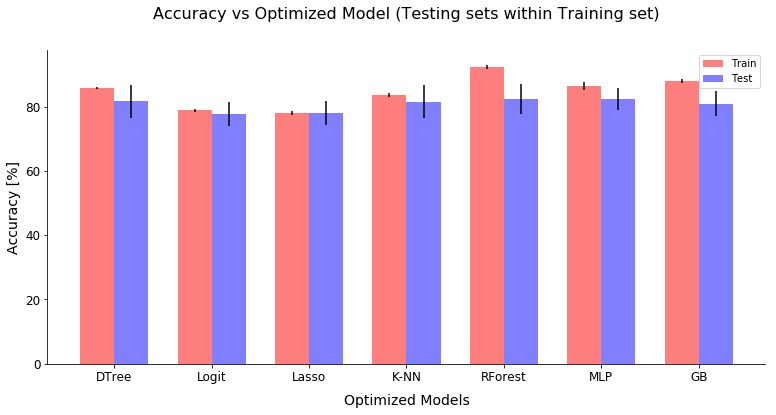

In [56]:
# Comparison Plot (Training bar plot)
# Data
TrainingR = np.zeros(7)
TrainingR[0] = RTree[0]
TrainingR[1] = RLogit[0]
TrainingR[2] = RLasso[0]
TrainingR[3] = RKnn[0]
TrainingR[4] = RForest[0]
TrainingR[5] = RMLP[0]
TrainingR[6] = RGB[0]

ErrorTrain = np.zeros(7)
ErrorTrain[0] = RTree[5]
ErrorTrain[1] = RLogit[5]
ErrorTrain[2] = RLasso[5]
ErrorTrain[3] = RKnn[5]
ErrorTrain[4] = RForest[5]
ErrorTrain[5] = RMLP[5]
ErrorTrain[6] = RGB[5]

TestingR = np.zeros(7)
TestingR[0] = RTree[1]
TestingR[1] = RLogit[1]
TestingR[2] = RLasso[1]
TestingR[3] = RKnn[1]
TestingR[4] = RForest[1]
TestingR[5] = RMLP[1]
TestingR[6] = RGB[1]

ErrorTest = np.zeros(7)
ErrorTest[0] = RTree[6]
ErrorTest[1] = RLogit[6]
ErrorTest[2] = RLasso[6]
ErrorTest[3] = RKnn[6]
ErrorTest[4] = RForest[6]
ErrorTest[5] = RMLP[6]
ErrorTest[6] = RGB[6]


Labels = ["DTree", "Logit", "Lasso", "K-NN", "RForest", "MLP", "GB"]

# Figure size
plt.figure(figsize = (11, 6)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Number of bars          
n_groups = len(TrainingR)

# Visual style
index = np.arange(n_groups)
bar_width = 0.35
opacity = 0.5

rects1 = plt.bar(index, TrainingR * 100, bar_width,
                 yerr = ErrorTrain * 100,
                 alpha = opacity,
                 color = 'r', 
                 label = 'Train')

rects2 = plt.bar(index + bar_width, TestingR * 100, bar_width,
                 yerr = ErrorTest * 100,
                 alpha = opacity,
                 color = 'b', 
                 label = 'Test')


# Labels, Title, and legends
plt.xlabel("Optimized Models", labelpad = 10)
plt.ylabel('Accuracy [%]')
plt.title("Accuracy vs Optimized Model (Testing sets within Training set)", y = 1.08)
plt.xticks(index + bar_width/2, Labels)
plt.legend()

plt.tight_layout()
plt.show()    

## Observations

### Define "performance" in the way you think is most appropriate for this problem, and justify that decision. What algorithm performs best? (You might want to consider more than one measures of performance)

- Performance: Since the problem consists of a classic binary classification prediction, and the fact that the $sciklean$ package can easily compute the Accuracy score of a fitted model, we will use the accuracy of each model (in %) as the main performance metric across all models. The idea is that models with better average testing set accuracies will tend to be more general (not overfitted) allowing us to make better predictions for out-of-the-sample data points. On the other hand, different approaches could be implemented in order to measure the performance of the models: number of true/false positive/negative, application of a confusion matrix with an underlying cost function, etc., however, in order to perform a simple, effective, and easy to follow analysis, we will define the performance of a model as the average accuracy on the testing sets among the 10-fold CV iterations.

Thus, we can obtain the following comparison table in order to contrast the performance of each implemented model:

| Model (testing optimized) | AVG Testing Accuracy [%] | AVG Training Accuracy [%] |  Testing Accuracy (Kaggle test.csv) [%]   |   Optimal Parameters                                          |
|---------------------------|--------------------------|---------------------------|-------------------------------------------------------------|----------------|
| Decision Tree             | 81.60                    | 85.79   |     75.598             | MD = 6, MSL = 3                                             |
| Logistic Regression       | 77.67                    | 78.82    |     76.076            | -                                                           |
| Lasso Regression          | 77.95                    | 77.98     |     76.555           | Lambda = 0.0001                                             |
| K-Nearest Neighbors       | 81.47                    | 83.50      |     74.641          | K = 19, L = 1                                               |
| Random Forest             | 82.30                    | 92.33       |   75.119           | MD = 8, NTree = 130, MSL = 1                                |
| Multi-layer Perceptron    | 82.30                    | 86.39        |   76.076          | Act = "relu", LR = "constant", NLayers = 5 (100 nodes each) |
| Gradient Boosting         | 80.90                    |87.82          |  75.119          | MD = 1, LR = 1, NTrees = 300                                |

Based on the previous plot (check the last chunk of code) and the previous summary table, we can see that the best models in terms of performance in the testing sets are the Random Forest and Multi-layer Perceptron models, reaching an $82.30$% of average accuracy when performing a 10-fold cross-validation approach. Then, they are followed by the optimized Decision tree with $81.6$% and then (very close) the K-NN model, reaching an $81.47$% of accuracy. On the fifth position, we can find the Gradient Boosting model with an $80.9$% of accuracy for the testing set. Finally, the regressions (Lasso and Logistic) are the models with the worse performance among all the tested ones, reaching an AVG testing accuracy below $80$%.

Therefore, both the Random Forest and the Multi-Layer Perceptron algorithms emerges as one of the most suitable models for predicting the chances of surviving the Titanic's accident.

For completeness, when looking at the results obtained by the algorithms in the prediction of the test.csv dataset from Kaggle, we can see that the best results are obtained by the Lasso Regression model ($76.55$% of accuracy) and the Logistic regression/Multi-Layer perceptron models (both with $76.067$% of accuracy). Hence, we can see that the performance of the models in the test.csv dataset, where we do not know the real labels and we can just obtain the accuracy from the Kaggle website via submission, is lower than the AVG accuracy obtained from the 10-fold Cross-validation method. In addition, important is to note the similar accuracies obtained along all the models, with a particular mention to the lowest accuracy of the K-NN model ($74.641$%).

Important is to notice that we will be focus our analysis on the Kaggle submission (test.csv) accuracy since that is the data that was not taken into account when fitting the model and that is part of the online Titanic survival prediction competition.



### 3.2 Error analysis

Perform some error analysis to gain some intuition for where your models are not performing well. Are your models all having problems with the same individuals? Inspect this manually and report your results.

Now, do this a bit more systematically by creating a correlation matrix showing the correlation in predictions between each model. In other words, treat the output of each of your *M* models as a binary vector with one entry for each of the test data, and show how these prediction vectors relate to each other by plotting the *M* x *M* matrix of correlation coefficients. What do you observe?

In [57]:
# Informal Comparison: Differences in classifications
# Full training set (full train.csv file)
Tree_Log  = (y_hat_tree_train == y_hat_Logit_train).sum()
Tree_Lasso = (y_hat_tree_train == y_hat_lasso_train).sum()
Tree_Knn  = (y_hat_tree_train == y_hat_knn_train).sum()
Tree_RF   = (y_hat_tree_train == y_hat_RF_train).sum()
Tree_MLP  = (y_hat_tree_train == y_hat_MLP_train).sum()
Tree_GB   = (y_hat_tree_train == y_hat_GB_train).sum()
Log_Lasso = (y_hat_Logit_train == y_hat_lasso_train).sum()
Log_Knn   = (y_hat_Logit_train == y_hat_knn_train).sum()
Log_RF    = (y_hat_Logit_train == y_hat_RF_train).sum()
Log_MLP   = (y_hat_Logit_train == y_hat_MLP_train).sum()
Log_GB    = (y_hat_Logit_train == y_hat_GB_train).sum()
Lasso_Knn = (y_hat_lasso_train == y_hat_knn_train).sum()
Lasso_RF  = (y_hat_lasso_train == y_hat_RF_train).sum()
Lasso_MLP = (y_hat_lasso_train == y_hat_MLP_train).sum()
Lasso_GB  = (y_hat_lasso_train == y_hat_GB_train).sum()
Knn_RF    = (y_hat_knn_train == y_hat_RF_train).sum()
Knn_MLP   = (y_hat_knn_train == y_hat_MLP_train).sum()
Knn_GB    = (y_hat_knn_train == y_hat_GB_train).sum()
RF_MLP    = (y_hat_RF_train == y_hat_MLP_train).sum()
RF_GB     = (y_hat_RF_train == y_hat_GB_train).sum()
MLP_GB    = (y_hat_MLP_train == y_hat_GB_train).sum()

# Full testing set (from Kaggle)
Tree_LogT  = (y_hat_tree_test == y_hat_Logit_test).sum()
Tree_LassoT = (y_hat_tree_test == y_hat_lasso_test).sum()
Tree_KnnT  = (y_hat_tree_test == y_hat_knn_test).sum()
Tree_RFT   = (y_hat_tree_test == y_hat_RF_test).sum()
Tree_MLPT  = (y_hat_tree_test == y_hat_MLP_test).sum()
Tree_GBT   = (y_hat_tree_test == y_hat_GB_test).sum()
Log_LassoT = (y_hat_Logit_test == y_hat_lasso_test).sum()
Log_KnnT   = (y_hat_Logit_test == y_hat_knn_test).sum()
Log_RFT    = (y_hat_Logit_test == y_hat_RF_test).sum()
Log_MLPT   = (y_hat_Logit_test == y_hat_MLP_test).sum()
Log_GBT    = (y_hat_Logit_test == y_hat_GB_test).sum()
Lasso_KnnT = (y_hat_lasso_test == y_hat_knn_test).sum()
Lasso_RFT  = (y_hat_lasso_test == y_hat_RF_test).sum()
Lasso_MLPT = (y_hat_lasso_test == y_hat_MLP_test).sum()
Lasso_GBT  = (y_hat_lasso_test == y_hat_GB_test).sum()
Knn_RFT    = (y_hat_knn_test == y_hat_RF_test).sum()
Knn_MLPT   = (y_hat_knn_test == y_hat_MLP_test).sum()
Knn_GBT    = (y_hat_knn_test == y_hat_GB_test).sum()
RF_MLPT    = (y_hat_RF_test == y_hat_MLP_test).sum()
RF_GBT     = (y_hat_RF_test == y_hat_GB_test).sum()
MLP_GBT    = (y_hat_MLP_test == y_hat_GB_test).sum()

# Print information (training set)
print("Total number of equal classification (Full training set)")
print("DTree and Logit equals:", Tree_Log, "(", Tree_Log/len(X) * 100, "[%])")
print("DTree and Lasso equals: ", Tree_Lasso, "(", Tree_Lasso/len(X) * 100, "[%])")
print("DTree and Knn equals:", Tree_Knn, "(", Tree_Knn/len(X) * 100, "[%])")
print("DTree and RF equals: ", Tree_RF, "(", Tree_RF/len(X) * 100, "[%])")
print("DTree and MLP equals:", Tree_MLP, "(", Tree_MLP/len(X) * 100, "[%])")
print("DTree and GB equals: ", Tree_GB, "(", Tree_GB/len(X) * 100, "[%])")
print("Logit and Lasso equals:", Log_Lasso, "(", Log_Lasso/len(X) * 100, "[%])")
print("Logit and Knn equals:", Log_Knn, "(", Log_Knn/len(X) * 100, "[%])")
print("Logit and RF equals: ", Log_RF, "(", Log_RF/len(X) * 100, "[%])")
print("Logit and MLP equals:", Log_MLP, "(", Log_MLP/len(X) * 100, "[%])")
print("Logit and GB equals: ", Log_GB, "(", Log_GB/len(X) * 100, "[%])")
print("Lasso and Knn equals:", Lasso_Knn, "(", Lasso_Knn/len(X) * 100, "[%])")
print("Lasso and RF equals: ", Lasso_RF, "(", Lasso_RF/len(X) * 100, "[%])")
print("Lasso and MLP equals:", Lasso_MLP, "(", Lasso_MLP/len(X) * 100, "[%])")
print("Lasso and GB equals: ", Lasso_GB, "(", Lasso_GB/len(X) * 100, "[%])")
print("Knn and RF equals:   ", Knn_RF, "(", Knn_RF/len(X) * 100, " [%])")
print("Knn and MLP equals:  ", Knn_MLP, "(", Knn_MLP/len(X) * 100, "[%])")
print("Knn and GB equals:   ", Knn_GB, "(", Knn_GB/len(X) * 100, "[%])")
print("RF and MLP equals:   ", RF_MLP, "(", RF_MLP/len(X) * 100, "[%])")
print("RF and GB equals:    ", RF_GB, "(", RF_GB/len(X) * 100, "[%])")
print("MLP and GB equals:   ", MLP_GB, "(", MLP_GB/len(X) * 100, "[%])")

# Print information (testing set)
print("\nTotal number of equal classification (Full testing set)")
print("DTree and Logit equals:", Tree_LogT, "(", Tree_LogT/len(XTestStdNonan) * 100, "[%])")
print("DTree and Lasso equals: ", Tree_LassoT, "(", Tree_LassoT/len(XTestStdNonan) * 100, "[%])")
print("DTree and Knn equals:", Tree_KnnT, "(", Tree_KnnT/len(XTestStdNonan) * 100, "[%])")
print("DTree and RF equals: ", Tree_RFT, "(", Tree_RFT/len(XTestStdNonan) * 100, "[%])")
print("DTree and MLP equals:", Tree_MLPT, "(", Tree_MLPT/len(XTestStdNonan) * 100, "[%])")
print("DTree and GB equals: ", Tree_GBT, "(", Tree_GBT/len(XTestStdNonan) * 100, "[%])")
print("Logit and Lasso equals:", Log_LassoT, "(", Log_LassoT/len(XTestStdNonan) * 100, "[%])")
print("Logit and Knn equals:", Log_KnnT, "(", Log_KnnT/len(XTestStdNonan) * 100, "[%])")
print("Logit and RF equals: ", Log_RFT, "(", Log_RFT/len(XTestStdNonan) * 100, "[%])")
print("Logit and MLP equals:", Log_MLPT, "(", Log_MLPT/len(XTestStdNonan) * 100, "[%])")
print("Logit and GB equals: ", Log_GBT, "(", Log_GBT/len(XTestStdNonan) * 100, "[%])")
print("Lasso and Knn equals:", Lasso_KnnT, "(", Lasso_KnnT/len(XTestStdNonan) * 100, " [%])")
print("Lasso and RF equals: ", Lasso_RFT, "(", Lasso_RFT/len(XTestStdNonan) * 100, "[%])")
print("Lasso and MLP equals:", Lasso_MLPT, "(", Lasso_MLPT/len(XTestStdNonan) * 100, "[%])")
print("Lasso and GB equals: ", Lasso_GBT, "(", Lasso_GBT/len(XTestStdNonan) * 100, " [%])")
print("Knn and RF equals:   ", Knn_RFT, "(", Knn_RFT/len(XTestStdNonan) * 100, "[%])")
print("Knn and MLP equals:  ", Knn_MLPT, "(", Knn_MLPT/len(XTestStdNonan) * 100, "[%])")
print("Knn and GB equals:   ", Knn_GBT, "(", Knn_GBT/len(XTestStdNonan) * 100, " [%])")
print("RF and MLP equals:   ", RF_MLPT, "(", RF_MLPT/len(XTestStdNonan) * 100, "[%])")
print("RF and GB equals:    ", RF_GBT, "(", RF_GBT/len(XTestStdNonan) * 100, "[%])")
print("MLP and GB equals:   ", MLP_GBT, "(", MLP_GBT/len(XTestStdNonan) * 100, "[%])")

Total number of equal classification (Full training set)
DTree and Logit equals: 599 ( 84.1292134831 [%])
DTree and Lasso equals:  586 ( 82.3033707865 [%])
DTree and Knn equals: 635 ( 89.1853932584 [%])
DTree and RF equals:  652 ( 91.5730337079 [%])
DTree and MLP equals: 659 ( 92.5561797753 [%])
DTree and GB equals:  629 ( 88.3426966292 [%])
Logit and Lasso equals: 691 ( 97.0505617978 [%])
Logit and Knn equals: 642 ( 90.1685393258 [%])
Logit and RF equals:  611 ( 85.8146067416 [%])
Logit and MLP equals: 620 ( 87.0786516854 [%])
Logit and GB equals:  622 ( 87.3595505618 [%])
Lasso and Knn equals: 621 ( 87.2191011236 [%])
Lasso and RF equals:  604 ( 84.8314606742 [%])
Lasso and MLP equals: 607 ( 85.2528089888 [%])
Lasso and GB equals:  607 ( 85.2528089888 [%])
Knn and RF equals:    643 ( 90.308988764  [%])
Knn and MLP equals:   662 ( 92.9775280899 [%])
Knn and GB equals:    644 ( 90.4494382022 [%])
RF and MLP equals:    671 ( 94.2415730337 [%])
RF and GB equals:     659 ( 92.5561797753 [

In [58]:
# Different rows and matrix
# Create the Matrix (DataFrame for training set)
PredMatrix = pd.DataFrame({"Dtree": y_hat_tree_train,
                           "Logit": y_hat_Logit_train,
                           "Lasso": y_hat_lasso_train.astype(int),
                           "K-NN": y_hat_knn_train,
                           "Random_Forest": y_hat_RF_train, 
                           "ML_Perceptron": y_hat_MLP_train,
                           "GB": y_hat_GB_train})

PredMatrix = PredMatrix[["Dtree", "Logit", "Lasso", "K-NN", "Random_Forest", "ML_Perceptron", "GB"]]

# Check new matrix
display(PredMatrix.head())

print("\nDiff rows Dtree vs Logit:\n", 
      PredMatrix.loc[PredMatrix["Dtree"] != PredMatrix["Logit"]].index)
print("\nDiff rows Dtree vs Lasso:\n", 
      PredMatrix.loc[PredMatrix["Dtree"] != PredMatrix["Lasso"]].index)
print("Diff rows Dtree vs K-NN:\n", 
      PredMatrix.loc[PredMatrix["Dtree"] != PredMatrix["K-NN"]].index)
print("\nDiff rows Dtree vs Random_Forest:\n", 
      PredMatrix.loc[PredMatrix["Dtree"] != PredMatrix["Random_Forest"]].index)
print("\nDiff rows Dtree vs ML_Perceptron:\n", 
      PredMatrix.loc[PredMatrix["Dtree"] != PredMatrix["ML_Perceptron"]].index)
print("\nDiff rows Dtree vs GB:\n", 
      PredMatrix.loc[PredMatrix["Dtree"] != PredMatrix["GB"]].index)

print("Diff rows Logit vs Lasso:\n", 
      PredMatrix.loc[PredMatrix["Logit"] != PredMatrix["Lasso"]].index)
print("\nDiff rows Logit vs K-NN:\n", 
      PredMatrix.loc[PredMatrix["Logit"] != PredMatrix["K-NN"]].index)
print("\nDiff rows Logit vs Random_Forest:\n", 
      PredMatrix.loc[PredMatrix["Logit"] != PredMatrix["Random_Forest"]].index)
print("\nDiff rows Logit vs ML_Perceptron:\n", 
      PredMatrix.loc[PredMatrix["Logit"] != PredMatrix["ML_Perceptron"]].index)
print("\nDiff rows Logit vs GB:\n", 
      PredMatrix.loc[PredMatrix["Logit"] != PredMatrix["GB"]].index)

print("Diff rows Lasso vs K-NN:\n", 
      PredMatrix.loc[PredMatrix["Lasso"] != PredMatrix["K-NN"]].index)
print("\nDiff rows Lasso vs Random_Forest:\n", 
      PredMatrix.loc[PredMatrix["Lasso"] != PredMatrix["Random_Forest"]].index)
print("\nDiff rows Lasso vs ML_Perceptron:\n", 
      PredMatrix.loc[PredMatrix["Lasso"] != PredMatrix["ML_Perceptron"]].index)
print("\nDiff rows Lasso vs GB:\n", 
      PredMatrix.loc[PredMatrix["Lasso"] != PredMatrix["GB"]].index)

print("\nDiff rows K-NN vs Random_Forest:\n", 
      PredMatrix.loc[PredMatrix["K-NN"] != PredMatrix["Random_Forest"]].index)
print("\nDiff rows K-NN vs ML_Perceptron:\n", 
      PredMatrix.loc[PredMatrix["K-NN"] != PredMatrix["ML_Perceptron"]].index)
print("\nDiff rows K-NN vs GB:\n", 
      PredMatrix.loc[PredMatrix["K-NN"] != PredMatrix["GB"]].index)

print("\nDiff rows Random_Forest vs ML_Perceptron:\n", 
      PredMatrix.loc[PredMatrix["Random_Forest"] != PredMatrix["ML_Perceptron"]].index)
print("\nDiff rows Random_Forest vs GB:\n", 
      PredMatrix.loc[PredMatrix["Random_Forest"] != PredMatrix["GB"]].index)

print("\nDiff rows ML_Perceptron vs GB:\n", 
      PredMatrix.loc[PredMatrix["ML_Perceptron"] != PredMatrix["GB"]].index)

,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB
0,0,0,0,0,0,0,0
1,1,1,1,1,1,1,1
2,0,1,1,1,1,1,1
3,1,1,1,1,1,1,1
4,0,0,0,0,0,0,0



Diff rows Dtree vs Logit:
 Int64Index([  2,  13,  16,  20,  21,  23,  27,  29,  34,  35,
            ...
            649, 651, 658, 660, 662, 681, 692, 695, 704, 710],
           dtype='int64', length=113)

Diff rows Dtree vs Lasso:
 Int64Index([  2,  13,  16,  20,  21,  22,  23,  27,  29,  31,
            ...
            651, 658, 660, 662, 681, 692, 695, 704, 707, 710],
           dtype='int64', length=126)
Diff rows Dtree vs K-NN:
 Int64Index([  2,  10,  13,  20,  23,  26,  27,  34,  50,  59,  74,  77,  78,
             82,  87,  88,  92, 110, 111, 137, 146, 162, 172, 179, 197, 199,
            204, 232, 236, 251, 266, 294, 297, 299, 300, 311, 317, 323, 325,
            335, 343, 350, 358, 377, 385, 398, 401, 406, 422, 439, 452, 461,
            478, 489, 512, 515, 534, 536, 537, 555, 556, 561, 564, 586, 587,
            597, 611, 622, 625, 628, 633, 643, 651, 658, 681, 695, 704],
           dtype='int64')

Diff rows Dtree vs Random_Forest:
 Int64Index([  2,  13,  20,  22,  27,  34

In [59]:
# Different rows and matrix
# Create the Matrix (DataFrame for testing set)
PredMatrixTest = pd.DataFrame({"Dtree": y_hat_tree_test,
                               "Logit": y_hat_Logit_test,
                               "Lasso": y_hat_lasso_test.astype(int),
                               "K-NN": y_hat_knn_test,
                               "Random_Forest": y_hat_RF_test, 
                               "ML_Perceptron": y_hat_MLP_test,
                               "GB": y_hat_GB_test})

PredMatrixTest = PredMatrixTest[["Dtree", "Logit", "Lasso", "K-NN", "Random_Forest", "ML_Perceptron", "GB"]]

# Check new matrix
display(PredMatrixTest.head())

print("\nDiff rows Dtree vs Logit:\n", 
      PredMatrixTest.loc[PredMatrixTest["Dtree"] != PredMatrixTest["Logit"]].index)
print("\nDiff rows Dtree vs Lasso:\n", 
      PredMatrixTest.loc[PredMatrixTest["Dtree"] != PredMatrixTest["Lasso"]].index)
print("Diff rows Dtree vs K-NN:\n", 
      PredMatrixTest.loc[PredMatrixTest["Dtree"] != PredMatrixTest["K-NN"]].index)
print("\nDiff rows Dtree vs Random_Forest:\n", 
      PredMatrixTest.loc[PredMatrixTest["Dtree"] != PredMatrixTest["Random_Forest"]].index)
print("\nDiff rows Dtree vs ML_Perceptron:\n", 
      PredMatrixTest.loc[PredMatrixTest["Dtree"] != PredMatrixTest["ML_Perceptron"]].index)
print("\nDiff rows Dtree vs GB:\n", 
      PredMatrixTest.loc[PredMatrixTest["Dtree"] != PredMatrixTest["GB"]].index)

print("Diff rows Logit vs Lasso:\n", 
      PredMatrixTest.loc[PredMatrixTest["Logit"] != PredMatrixTest["Lasso"]].index)
print("\nDiff rows Logit vs K-NN:\n", 
      PredMatrixTest.loc[PredMatrixTest["Logit"] != PredMatrixTest["K-NN"]].index)
print("\nDiff rows Logit vs Random_Forest:\n", 
      PredMatrixTest.loc[PredMatrixTest["Logit"] != PredMatrixTest["Random_Forest"]].index)
print("\nDiff rows Logit vs ML_Perceptron:\n", 
      PredMatrixTest.loc[PredMatrixTest["Logit"] != PredMatrixTest["ML_Perceptron"]].index)
print("\nDiff rows Logit vs GB:\n", 
      PredMatrixTest.loc[PredMatrixTest["Logit"] != PredMatrixTest["GB"]].index)

print("Diff rows Lasso vs K-NN:\n", 
      PredMatrixTest.loc[PredMatrixTest["Lasso"] != PredMatrixTest["K-NN"]].index)
print("\nDiff rows Lasso vs Random_Forest:\n", 
      PredMatrixTest.loc[PredMatrixTest["Lasso"] != PredMatrixTest["Random_Forest"]].index)
print("\nDiff rows Lasso vs ML_Perceptron:\n", 
      PredMatrixTest.loc[PredMatrixTest["Lasso"] != PredMatrixTest["ML_Perceptron"]].index)
print("\nDiff rows Lasso vs GB:\n", 
      PredMatrixTest.loc[PredMatrixTest["Lasso"] != PredMatrixTest["GB"]].index)

print("\nDiff rows K-NN vs Random_Forest:\n", 
      PredMatrixTest.loc[PredMatrixTest["K-NN"] != PredMatrixTest["Random_Forest"]].index + 891)
print("\nDiff rows K-NN vs ML_Perceptron:\n", 
      PredMatrixTest.loc[PredMatrixTest["K-NN"] != PredMatrixTest["ML_Perceptron"]].index + 891)
print("\nDiff rows K-NN vs GB:\n", 
      PredMatrixTest.loc[PredMatrixTest["K-NN"] != PredMatrixTest["GB"]].index + 891)

print("\nDiff rows Random_Forest vs ML_Perceptron:\n", 
      PredMatrixTest.loc[PredMatrixTest["Random_Forest"] != PredMatrixTest["ML_Perceptron"]].index + 891)
print("\nDiff rows Random_Forest vs GB:\n", 
      PredMatrixTest.loc[PredMatrixTest["Random_Forest"] != PredMatrixTest["GB"]].index + 891)

print("\nDiff rows ML_Perceptron vs GB:\n", 
      PredMatrixTest.loc[PredMatrixTest["ML_Perceptron"] != PredMatrixTest["GB"]].index + 891) 

,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB
0,0,0,0,0,0,0,0
1,0,0,1,0,0,0,0
2,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0
4,0,1,1,0,0,0,1



Diff rows Dtree vs Logit:
 Int64Index([  4,   6,   8,  17,  19,  20,  32,  53,  55,  57,  59,  61,  62,
             64,  67,  68,  71,  72,  73,  74,  76,  80,  91, 110, 114, 125,
            128, 131, 134, 140, 144, 154, 157, 159, 160, 163, 185, 187, 193,
            194, 209, 219, 220, 225, 237, 242, 245, 252, 261, 263, 270, 272,
            282, 288, 297, 302, 308, 321, 322, 325, 328],
           dtype='int64')

Diff rows Dtree vs Lasso:
 Int64Index([  1,   4,   6,   8,  17,  18,  19,  20,  32,  53,  54,  55,  57,
             59,  61,  62,  67,  68,  71,  72,  73,  74,  76,  80,  91, 110,
            112, 114, 125, 128, 131, 134, 140, 144, 154, 156, 157, 159, 160,
            163, 170, 185, 187, 193, 194, 209, 219, 220, 225, 237, 239, 242,
            245, 252, 261, 263, 270, 272, 282, 288, 297, 302, 321, 322, 325,
            328],
           dtype='int64')
Diff rows Dtree vs K-NN:
 Int64Index([  6,   8,  20,  21,  26,  29,  30,  32,  53,  55,  59,  61,  64,
             67,  71

Min Corr: 0.62411700526 Max Corr: 0.927337141154
Variables with minimum correlation
 Dtree
 Lasso
Variables with maximum correlation
 Logit
 Lasso


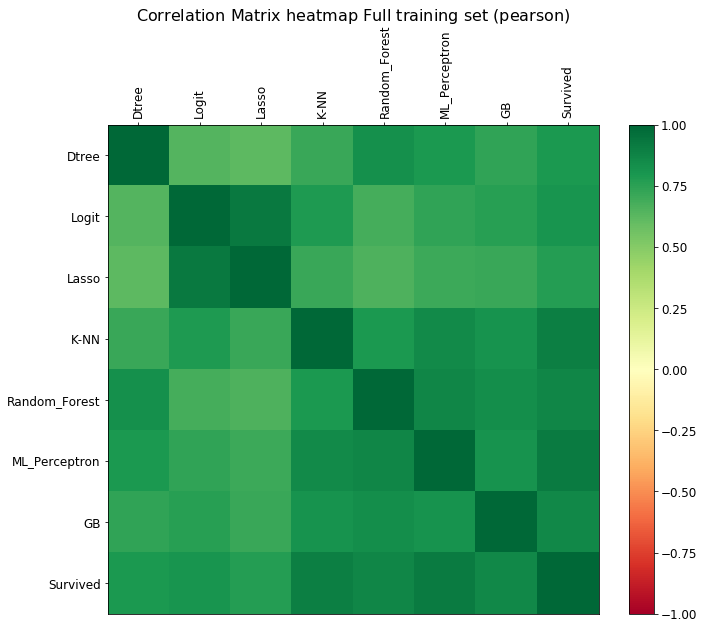

In [120]:
# Correlation map
# Relevant plots (Correlation Heatmap)
# Correlation matrix
corr = PredMatrix.corr()              #Correlation matrix
xlabels = PredMatrix.columns          #X labels
ylabels = PredMatrix.columns          #X labels

# Figure size and axes
fig, ax = plt.subplots(figsize = (11, 9))
ax.set_xticks(np.arange(PredMatrix.shape[1]) + 0.5, minor=False)
ax.set_yticks(np.arange(PredMatrix.shape[0]) + 0.5, minor=False)
ax.invert_yaxis()
ax.xaxis.tick_top()
plt.xticks(rotation = 90)
ax.set_xticklabels(xlabels, minor = False)
ax.set_yticklabels(ylabels, minor = False)

# Plot the heatmap and colorbar. Add title
heatmap = plt.pcolor(corr, cmap = 'RdYlGn', vmin = -1, vmax = corr.max().max())
plt.title(r'$\mathrm{Correlation\ Matrix\ heatmap\ Full\ training\ set\ (pearson)}$', y = 1.2)
plt.colorbar()


# Analysis: Min and Max (below 1) correlations
minCorr = corr.min().min()
corr2 = corr[corr < 1]
maxCorr = corr2.max().max()
print("Min Corr:", minCorr, "Max Corr:", maxCorr)

# New dfs with min and max correlations
corrmins = pd.DataFrame(corr2.min(), columns = ['MinCorr'])
corrmaxs = pd.DataFrame(corr2.max(), columns = ['MaxCorr'])

# Get variable names for max/min correlations
print('Variables with minimum correlation') 
for i in corrmins[corrmins['MinCorr'] == minCorr].index.tolist():
    print("", i)

print('Variables with maximum correlation') 
for i in corrmaxs[corrmaxs['MaxCorr'] == maxCorr].index.tolist():
    print("", i)

In [61]:
    # Correlation matrix (values)
    print("Correlation matrix values (training)")
    display(corr)

Correlation matrix values (training)


,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB
Dtree,1.000000,0.648135,0.611789,0.768761,0.815236,0.836049,0.744096
Logit,0.648135,1.000000,0.936446,0.788879,0.691193,0.718028,0.725550
Lasso,0.611789,0.936446,1.000000,0.726398,0.671998,0.680529,0.681761
K-NN,0.768761,0.788879,0.726398,1.000000,0.791838,0.849370,0.795079
Random_Forest,0.815236,0.691193,0.671998,0.791838,1.000000,0.874238,0.838270
ML_Perceptron,0.836049,0.718028,0.680529,0.849370,0.874238,1.000000,0.816539
GB,0.744096,0.725550,0.681761,0.795079,0.838270,0.816539,1.000000


Min Corr: 0.558139436302 Max Corr: 0.942441830223
Variables with minimum correlation
 Dtree
 GB
Variables with maximum correlation
 Logit
 Lasso


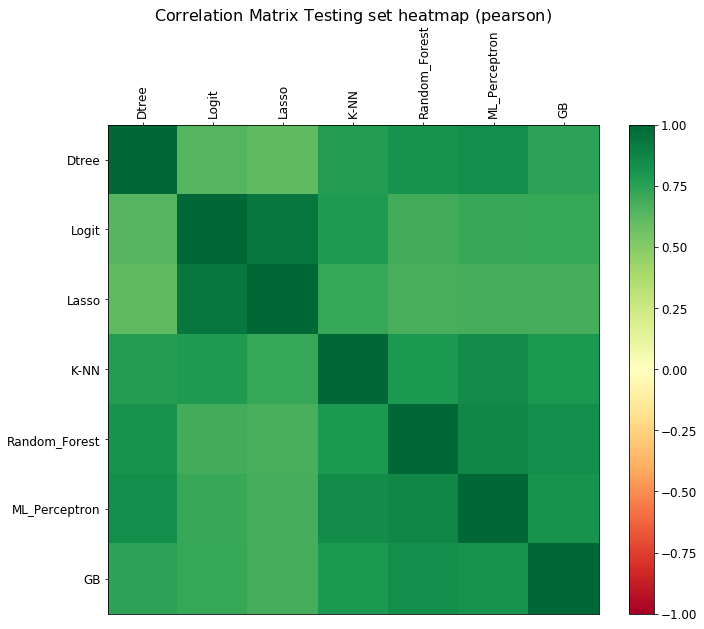

In [62]:
# Correlation map
# Relevant plots (Correlation Heatmap)
# Correlation matrix
corr2 = PredMatrixTest.corr()             # Correlation matrix
xlabels = PredMatrixTest.columns          # X labels
ylabels = PredMatrixTest.columns          # Y labels

# Figure size and axes
fig, ax = plt.subplots(figsize = (11, 9))
ax.set_xticks(np.arange(PredMatrix.shape[1]) + 0.5, minor=False)
ax.set_yticks(np.arange(PredMatrix.shape[0]) + 0.5, minor=False)
ax.invert_yaxis()
ax.xaxis.tick_top()
plt.xticks(rotation = 90)
ax.set_xticklabels(xlabels, minor = False)
ax.set_yticklabels(ylabels, minor = False)

# Plot the heatmap and colorbar. Add title
heatmap = plt.pcolor(corr2, cmap = 'RdYlGn', vmin = -1, vmax = corr2.max().max())
plt.title(r'$\mathrm{Correlation\ Matrix\ Testing\ set\ heatmap\ (pearson)}$', 
          y = 1.2)
plt.colorbar()


# Analysis: Min and Max (below 1) correlations
minCorr = corr2.min().min()
corr2 = corr2[corr2 < 1]
maxCorr = corr2.max().max()
print("Min Corr:", minCorr, "Max Corr:", maxCorr)

# New dfs with min and max correlations
corrmins = pd.DataFrame(corr2.min(), columns = ['MinCorr'])
corrmaxs = pd.DataFrame(corr2.max(), columns = ['MaxCorr'])

# Get variable names for max/min correlations
print('Variables with minimum correlation') 
for i in corrmins[corrmins['MinCorr'] == minCorr].index.tolist():
    print("", i)

print('Variables with maximum correlation') 
for i in corrmaxs[corrmaxs['MaxCorr'] == maxCorr].index.tolist():
    print("", i)

In [63]:
# Correlation matrix (values)
print("Correlation matrix values (testing)")
display(corr2)

Correlation matrix values (testing)


,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB
Dtree,NaN,0.604736,0.573239,0.740984,0.736515,0.697584,0.558139
Logit,0.604736,NaN,0.942442,0.766412,0.744551,0.629562,0.711246
Lasso,0.573239,0.942442,NaN,0.709686,0.725739,0.610923,0.692519
K-NN,0.740984,0.766412,0.709686,NaN,0.790320,0.777851,0.710611
Random_Forest,0.736515,0.744551,0.725739,0.790320,NaN,0.770705,0.699470
ML_Perceptron,0.697584,0.629562,0.610923,0.777851,0.770705,NaN,0.635488
GB,0.558139,0.711246,0.692519,0.710611,0.699470,0.635488,NaN


## Observations

###  Are your models all having problems with the same individuals? Inspect this manually and report your results.

Due to the fact that the statement of the problem is not completely clear with respect to what exactly is the "test dataset", we perform the following analysis:

*Note: Important is to indicate that we do not have access to the true labels of the observations inside the test.csv file and thus, we are unable to analyze if the models are having a problem with the same individuals or not. Therefore, there is no sense in performing an error analysis with the observations from that file. That's the main reason why we will just use some parts of the training set (full or a subset) for this analysis since we know the true labels of the observations inside the train.csv file.

### Version 0: Full train set for checking classification error
Since we were using the train.csv file dataset for fitting our models (and the fact that we do not know the true labels for the test.csv dataset from Kaggle), and that in the next section 3.3 we will use all the training data for fitting the models, we compare the performance of each model with respect to their classification accuracy when classifying observations inside the full training set.

Based on the previous results (from the code section), we have the following summary:

| Models           | Number of equal classifications | Percentage [%] |
|------------------|---------------------------------|----------------|
| DTree and Logit  | 599                             | 84.129         |
| DTree and Lasso  | 586                             | 82.303         |
| DTree and Knn    | 635                             | 89.185         |
| DTree and RF     | 652                             | 91.573         |
| DTree and MLP    | 659                             | 92.556         |
| DTree and GB     | 629                             | 88.342         |
| Logit and Lasso  | 691                             | 97.050         |
| Logit and Knn    | 642                             | 90.168         |
| Logit and RF     | 611                             | 85.814         |
| Logit and MLP    | 620                             | 87.078         |
| Logit and GB     | 622                             | 87.359         |
| Lasso and Knn    | 621                             | 87.219         |
| Lasso and RF     | 604                             | 84.831         |
| Lasso and MLP    | 607                             | 85.252         |
| Lasso and GB     | 607                             | 85.252         |
| Knn and RF       | 643                             | 90.308         |
| Knn and MLP      | 662                             | 92.977         |
| Knn and GB       | 644                             | 90.449         |
| RF and MLP       | 671                             | 94.241         |
| RF and GB        | 659                             | 92.556         |
| MLP and GB       | 652                             | 91.573         |

Clearly, we can see that some models are sharing a lot of predictions with the highest similarity obtained by the Lasso and Logistic regression models ($97$% of coincidences). This is followed by the Random Forest and Multi-Layer Perceptron (MLP) models with $94.241$% of coincidences, very similar to the value obtained by the K-NN and the MLP models ($92.977$%). Similar values are obtained by other models. Clearly, models with a higher number of coincidences will tend to have problems with the same observations as well as reaching a similar accuracy of true positive within a set of rows.

On the other hand, we can see that some models tend to classify the observations in a more different way (lower number of coincidences). The lowest number of coincidences is reached by the Decision tree and Lasso Regression models, with an $82.303$% of coincidences within their predictions for the entire training set.

Based on all our previous work, we can see that the summary results are consistent and coherent with the reported accuracies for each model, where models with higher prediction coincidences tend to have similar accuracies (e.g.: Lasso and Logistic Regressions with $77.95$% vs $77.67$% testing accuracies, and $77.98$% vs $78.82$% training accuracies from the 10-fold Cross-validation). 

### Version 1: Full test set for comparison
In this case, we compare the coincidences for the prediction vectors obtained when the models are applied to the dataset contained in the test.csv file from Kaggle (the one without known labels). Hence, the analysis is coherent since we are using the full dataset train.csv in order to train our models and then we perform predictions on the observations contained in the test.csv file.

Notice that in this case, we are not able to identify the individuals that are having more problems in terms of wrong classifications since we do not have access to their true labels. However, we can compare the prediction vectors in order to obtain information regarding the coincidences between models.

Based on the previous results (from the code section), we have the following summary:

| Models           | Number of equal classifications | Percentage [%] |
|------------------|---------------------------------|----------------|
| DTree and Logit  | 270                             | 81.570         |
| DTree and Lasso  | 265                             | 80.060         |
| DTree and Knn    | 287                             | 86.706         |
| DTree and RF     | 290                             | 87.613         |
| DTree and MLP    | 284                             | 85.800         |
| DTree and GB     | 263                             | 79.456         |
| Logit and Lasso  | 322                             | 97.280         |
| Logit and Knn    | 292                             | 88.217         |
| Logit and RF     | 291                             | 87.915         |
| Logit and MLP    | 273                             | 82.477         |
| Logit and GB     | 286                             | 86.404         |
| Lasso and Knn    | 283                             | 85.498         |
| Lasso and RF     | 288                             | 87.009         |
| Lasso and MLP    | 270                             | 81.570         |
| Lasso and GB     | 283                             | 85.498         |
| Knn and RF       | 296                             | 89.425         |
| Knn and MLP      | 294                             | 88.821         |
| Knn and GB       | 283                             | 85.498         |
| RF and MLP       | 295                             | 89.123         |
| RF and GB        | 284                             | 85.800         |
| MLP and GB       | 274                             | 82.779         |

In this case, we can see that the Logit and Lasso regression models are again the ones with the highest number of conincidences, reaching a $97.280$% of similar predictions being consistent with the results on the training dataset. Then we can see that the K-NN and the Random Forest models reach an $89.123$% of coincidences, very similar to the one obtained within the training set.

On the other hand, the models with the less number of coincidences are the Decision Tree and the Gradient Boosting models ($79.456$%), an unexpected result due to their high number of coincidences in the training set data.

### Version 2: Leave 20% out from training set as our test set
In this approach, we fit the models with 80% of the training set data (from train.csv) using a 10-fold CV (see AFTER the original Final item of the current PS). Then, we make predictions on the remaining 20%. 

In this case, we compare the coincidences for the prediction vectors obtained when the models are applied to the dataset contained in the remaining 20% from the train.csv file from Kaggle (the one with known labels).

Notice that in this case, we are able to identify the individuals that are having more problems in terms of wrong classifications since we have access to their true labels.

Based on the previous results (from the code section), we have the following summary:

| Models           | Number of equal classifications | Percentage [%] |
|------------------|---------------------------------|----------------|
| DTree and Logit  | 133                             | 93.661         |
| DTree and Lasso  | 130                             | 91.549         |
| DTree and Knn    | 119                             | 83.802         |
| DTree and RF     | 123                             | 86.619         |
| DTree and MLP    | 118                             | 83.098         |
| DTree and GB     | 128                             | 90.140         |
| Logit and Lasso  | 139                             | 97.887         |
| Logit and Knn    | 124                             | 87.323         |
| Logit and RF     | 128                             | 90.140         |
| Logit and MLP    | 125                             | 88.028         |
| Logit and GB     | 129                             | 90.845         |
| Lasso and Knn    | 125                             | 88.028         |
| Lasso and RF     | 125                             | 88.028         |
| Lasso and MLP    | 126                             | 88.732         |
| Lasso and GB     | 128                             | 90.140         |
| Knn and RF       | 130                             | 91.549         |
| Knn and MLP      | 131                             | 92.253         |
| Knn and GB       | 127                             | 89.436         |
| RF and MLP       | 129                             | 90.845         |
| RF and GB        | 129                             | 90.845         |
| MLP and GB       | 124                             | 87.323         |

In this case, we can see that the Logit and Lasso regression models are again the ones with the highest number of coincidences, reaching a $97.887$[%] of similar predictions being consistent with the results on the training dataset. Then we can see that the K-NN and the Random Forest models, as well as the Decision Tree and Lasso models, reach a $91.549$[%] of coincidences, higher that the one obtained within the training set.

On the other hand, the models with the less number of coincidences are the Decision Tree and the Multi-layer perceptron models ($83.098$[%]).




### Treat the output of each of your $M$ models as a binary vector with one entry for each of the test data, and show how these prediction vectors relate to each other by plotting the $M$ x $M$ matrix of correlation coefficients. What do you observe?

### Version 0: Full train set for checking classification error

The correlation matrix obtained is the following:

|               | Dtree    | Logit    | Lasso    | K-NN     | Random_Forest | ML_Perceptron | GB       |
|---------------|----------|----------|----------|----------|---------------|---------------|----------|
| Dtree         | 1.000000 | 0.648135 | 0.611789 | 0.768761 |      0.815236 |      0.836049 | 0.744096 |
| Logit         | 0.648135 | 1.000000 | 0.936446 | 0.788879 |      0.691193 |      0.718028 | 0.725550 |
| Lasso         | 0.611789 | 0.936446 | 1.000000 | 0.726398 |      0.671998 |      0.680529 | 0.681761 |
| K-NN          | 0.768761 | 0.788879 | 0.726398 | 1.000000 |      0.791838 |      0.849370 | 0.795079 |
| Random_Forest | 0.815236 | 0.691193 | 0.671998 | 0.791838 |      1.000000 |      0.874238 | 0.838270 |
| ML_Perceptron | 0.836049 | 0.718028 | 0.680529 | 0.849370 |      0.874238 |      1.000000 | 0.816539 |
| GB            | 0.744096 | 0.725550 | 0.681761 | 0.795079 |      0.838270 |      0.816539 | 1.000000 |

Based on the correlation matrix we can observe the following:
- Max correlation: The models with the maximum prediction correlation are Logit and Lasso with a correlation value of $0.936$, indicating that they are more likely to have problems as well as true positive values with the same observations due to the fact that their prediction vectors are very similar. This is not particularly surprising since both approaches involve a regression method with the particularity that the Lasso regression prediction is rounded at the end of the method (0.5 used as threshold) and the fact that the optimal regularization parameter is very low (0.001).

On the second place, we have the Gradient Boosting and the Random Forest models with a pearson correlation value of $0.874$. This was expected since both approaches tend to be very similar in their formulation. Then, we have the Multi-layer perceptron and the K-Nearest Neighbor models with a correlation value of $0.838$. Finally (for the models with correlation above 0.8) we have the Random Forest and the Decision Tree models with a value of $0.815$. Clearly, a high correlation between these two models was expected since as we know, the Random Forest models are based on a set of decision trees and thus, they tend to be very similar in their general aspects (with a higher level of complexity when dealing with Random Trees).

- Min correlation: In this case, we can see that the models with the less likely results are the Decision tree and the Lasso models with a correlation value of $0.648$, indicating that they do not tend to classify the observations in a very similar way. Then, we can see that (as expected) the Logit and Decision tree models are also not so much correlated in terms of their predictions obtaining a value of $0.648$ for the pearson coefficient. Based on the results mentioned in the previous section, we can easily see that this patter was expected due to the high correlation between the Logit and Lasso models. The Same pattern can be seen with the Random Forest model with the Logit ($0.691$) and the Lasso ($0.671$) models, following the analysis performed with regard to the similarities between the Decision Tree and the Random Forest model. Finally, we can also see how the Gradient Boosting model predictions do not have a high correlation value with the predictions from the Lasso model ($0.681$).

Therefore, as expected, we can observe that some models tend to obtain very similar results in terms of the final predictions for the entire dataset (from the train.csv file) due to different reasons such as (1) similar foundations/methodologies for constructing/formulating the models, and (2) similar objective functions to optimize during the model's fit process. 

Important is to remember that in this case we are comparing the predictions for the entire dataset used for training each model by a 10-fold Cross-validation in order to be consistent with the definition of the test set: since each optimized model was obtained using the CV approach, there is no isolated testing set in the database and we do not have access to the true labels of the test.csv dataset in order to identify the models' accuracies.


### Version 1: Full test set for comparison

In this case, we compare the predictions performed for the test.csv dataset. We can compare the correlation between the models and obtain some insights based on the models' accuracies obtained from Kaggle.

The correlation matrix obtained is the following:

|               | Dtree    | Logit    | Lasso    | K-NN     | Random_Forest | ML_Perceptron | GB       |
|---------------|----------|----------|----------|----------|---------------|---------------|----------|
| Dtree         | 1.000000 | 0.604736 | 0.573239 | 0.740984 |      0.736515 |      0.697584 | 0.558139 |
| Logit         | 0.604736 | 1.000000 | 0.942442 | 0.766412 |      0.744551 |      0.629562 | 0.711246 |
| Lasso         | 0.573239 | 0.942442 | 1.000000 | 0.709686 |      0.725739 |      0.610923 | 0.692519 |
| K-NN          | 0.740984 | 0.766412 | 0.709686 | 1.000000 |      0.790320 |      0.777851 | 0.710611 |
| Random_Forest | 0.736515 | 0.744551 | 0.725739 | 0.790320 |      1.000000 |      0.770705 | 0.699470 |
| ML_Perceptron | 0.697584 | 0.629562 | 0.610923 | 0.777851 |      0.770705 |      1.000000 | 0.635488 |
| GB            | 0.558139 | 0.711246 | 0.692519 | 0.710611 |      0.699470 |      0.635488 | 1.000000 |

Based on the correlation matrix we can observe the following:
- Max correlation: In this case, we can see again that the models with the maximum correlation value for their predictions consist of the Logit and Lasso models with a value of $0.942$. Clearly, based on our previous analysis this result is expected because both models were trained with the same data during the 10-fold CV and they share similar foundations and methodologies in order to be fitted to the data. In the second place, we have the value of $0.790$ obtained by the Random Forest and the K-Nearest Neighbor models, a surprise in relation to the results obtained when predicting the labels of the full training set. Important is to notice that we do not have a set of models with correlations above 0.8 as before, indicating that the performance in the testing set will have more dispersion than the one we obtained in the training set.

Then, we have a set of models with correlation values above $0.7$, including the Random Forest with the Multi-Layer Perceptron ($0.770$), the Logit ($0.744$), the Decision Tree ($0.736$), and the Lasso ($0.725$) models. In addition, we have high correlations between the K-NN and the Logit models ($0.766$), and between the K-MM and the Decision Tree models ($0.740$).

- Min correlation: Lower levels of correlation between the predictions of the models are obtained in this case in comparison to the predictions over the training dataset. We can see that the lowest correlation occurs between the Decision Tree and the Gradient Boosting models, reaching a pearson coefficient value of $0.558$, indicating that their solutions on out-of-the-sample data (new entries) are very likely to be different. A similar pattern can be seen in the case of the Lasso and the Decision Tree models ($0.573$), also reaching a very low correlation between their prediction vectors. 

Finally, a series of correlation values between [$0.6, 0.7$[ are obtained for the rest of the models. Therefore, we can see that in overall, all the correlation values between the prediction vectors obtained from all the tested models tend to be lower in this case (with out of the sample observations) in comparison to their predictions within the data used to fit them (full training set). Thus, we can clearly see that the prediction accuracies will tend to be very different depending on the models.


### Version 2: Leave 20% out from training set as our test set

In this case, we compare the predictions performed for 20% that we left out from our analysis (originally from the train.csv file). 

The correlation matrix obtained is the following (for the predictions on the testing set):

|               | Dtree    | Logit    | Lasso    | K-NN     | Random_Forest | ML_Perceptron | GB       |
|---------------|----------|----------|----------|----------|---------------|---------------|----------|
| Dtree         | 1.000000 | 0.859201 | 0.816498 | 0.648984 | 0.715378      | 0.631089      | 0.794161 |
| Logit         | 0.859201 | 1.000000      | 0.954940 | 0.726224 | 0.791287      | 0.739700      | 0.808588 |
| Lasso         | 0.816498 | 0.954940 | 1.000000      | 0.743222 | 0.745952      | 0.757265      | 0.792415 |
| K-NN          | 0.648984 | 0.726224 | 0.743222 | 1.000000      | 0.821111      | 0.833890      | 0.777552 |
| Random_Forest | 0.715378 | 0.791287 | 0.745952 | 0.821111 | 1.000000           | 0.805966      | 0.807837 |
| ML_Perceptron | 0.631089 | 0.739700 | 0.757265 | 0.833890 | 0.805966      | 1.000000          | 0.732594 |
| GB            | 0.794161 | 0.808588 | 0.792415 | 0.777552 | 0.807837      | 0.732594      | 1.000000      |

Based on the correlation matrix we can observe the following:
- Max correlation: In this case, we can see again that the models with the maximum correlation value for their predictions consist of the Logit and Lasso models with a value of $0.954$. Clearly, based on our previous analysis this result is expected because both models were trained with the same data during the 10-fold CV and they share similar foundations and methodologies in order to be fitted to the data. In the second place, we have the value of $0.859$ obtained by the Decision Tree and Logit models, a surprise in relation to the results obtained when predicting the labels of the testing set. Important is to notice that we have several models with correlations around 75, indicating that the performance in the testing set will have more dispersion than the one we obtained in the training set.

Then, we have a set of models with correlation values above $0.8$, including the Random Forest with the Multi-Layer Perceptron ($0.805$), the K-NN ($0.821$), and the Gradient Boosting ($0.807$) models. In addition, we have high correlations between the Lasso and the Decision Tree models ($0.816$), and between the K-NN and the Multi-layer perceptron models ($0.833$).

- Min correlation: We can see that the lowest correlation occurs between the Decision Tree and the Multi-layer perceptron models, reaching a pearson coefficient value of $0.631$, indicating that their solutions on out-of-the-sample data (new entries) are very likely to be different. A similar pattern can be seen in the case of the K-NN and the Decision Tree models ($0.648$), also reaching a very low correlation between their prediction vectors. 

Finally, a series of correlation values between [$0.6, 0.75$[ are obtained for the rest of the models. Therefore, we can see that in overall, all the correlation values between the prediction vectors obtained from all the tested models tend to be lower in this case (with the out of the sample observations) in comparison to their predictions within the data used to fit them (full training set). Thus, we can clearly see that the prediction accuracies will tend to be very different depending on the models.

### 3.3 Develop an ensemble

Create an ensemble learner by hand. Using all of the training data, fit each of the models in 3.1. Then, classify each instance in the test data by taking the majority vote of all of your different fitted models. How accurately do you predict survival? How does this compare to your earlier results? 

*Note:* You will have to decide how to handle tie votes

In [64]:
## Version 1: Fit models with all training data and then check the accuracy of the
## testing set in Kaggle.

# Missing values Test: replace by mean values (0 standardized)
XTestStdNan = XTestStdNan.replace(np.nan, 0)

# Check no missing values
XTestStdNan.isnull().sum()

# Fit Models using optimized parameters
# Decision Tree
# Optimal Parameters
MaxDepth = 6
MinSampleLeaf = 3

RDTreeF = DecisionTreeClassifier(max_depth = MaxDepth,
                                 min_samples_leaf = MinSampleLeaf,
                                 random_state = 0)
# Fit the model
RDTreeF = RDTreeF.fit(X, Y)

# Predictions
y_hat_tree_train = RDTreeF.predict(X)
y_hat_tree_test = RDTreeF.predict(XTestStdNan)

# Testing Kaggle File
createKaggleFile(y_hat_tree_test, "TreeOpt")

# Score
print("Accuracy full train set (Tree): ", RDTreeF.score(X, Y))


# Logistic Regression
RLogF = LogisticRegression(fit_intercept = False,
                           random_state = 0) 

# Fit the model
RLogF = RLogF.fit(X, Y)

# Predictions
y_hat_logit_train = RLogF.predict(X)
y_hat_logit_test = RLogF.predict(XTestStdNan)

# Testing Kaggle File
createKaggleFile(y_hat_logit_test, "LogitOpt")

# Score
print("Accuracy full train set (Logit):", RLogF.score(X, Y))


# Lasso
# Optimal Parameters
Lambda = 1e-3
RLassoF = Lasso(alpha = Lambda, 
                fit_intercept = False, 
                random_state = 0)

# Fit the model
RLassoF = RLassoF.fit(X, Y)

# Predictions
y_hat_lasso_train = RLassoF.predict(X)
y_hat_lasso_train[y_hat_lasso_train > 0.5] = 1
y_hat_lasso_train[y_hat_lasso_train <= 0.5] = 0

y_hat_lasso_test = RLassoF.predict(XTestStdNan)
y_hat_lasso_test[y_hat_lasso_test > 0.5] = 1
y_hat_lasso_test[y_hat_lasso_test <= 0.5] = 0

# Testing Kaggle File
createKaggleFile(y_hat_lasso_test, "LassoOpt")

# Score 
print("Accuracy full train set (Lasso):", 
      (y_hat_lasso_train == Y).sum().astype(float) / len(y_hat_lasso_train))


# Knn
# Optimal Parameters
K = 19
L = 1

RKnnF = KNeighborsClassifier(n_neighbors = K, 
                     p = L)
# Fit the model
RKnnF = RKnnF.fit(X, Y)

# Predictions
y_hat_knn_train = RKnnF.predict(X)
y_hat_knn_test = RKnnF.predict(XTestStdNan)

# Testing Kaggle File
createKaggleFile(y_hat_knn_test, "KNNOpt")

# Score
print("Accuracy full train set (Knn):  ", RKnnF.score(X, Y))


# Random Forest 
# Optimal Parameters
MaxDepth = 8
NTrees = 130
MinSample = 1

RForestF = RandomForestClassifier(max_depth = MaxDepth, 
                                  min_samples_leaf = MinSample,  
                                  n_estimators = NTrees,      
                                  random_state = 0)

# Fit the model
RForestF = RForestF.fit(X, Y)

# Predictions
y_hat_RF_train = RForestF.predict(X)
y_hat_RF_test = RForestF.predict(XTestStdNan)

# Testing Kaggle File
createKaggleFile(y_hat_RF_test, "RFOpt")

# Score
print("Accuracy full train set (RF):   ", RForestF.score(X, Y))


# Multi-Layer Perceptron
# Optimal Parameters
Activation = 'relu'
LR = 'constant'
Layers = (100,) * 5 

RMLPF = MLPClassifier(alpha = 0.0001, 
                      learning_rate = LR, 
                      activation = Activation,
                      hidden_layer_sizes = Layers,
                      random_state = 0)

# Fit the model
RMLPF = RMLPF.fit(X, Y)

# Predictions
y_hat_MLP_train = RMLPF.predict(X)
y_hat_MLP_test = RMLPF.predict(XTestStdNan)

# Testing Kaggle File
createKaggleFile(y_hat_MLP_test, "MLPOpt")

# Score
print("Accuracy full train set (MLP):  ", RMLPF.score(X, Y))


# Gradient Boosting
# Optimal Parameters
MaxDepth = 1
NTrees = 300 
LR = 1

RGBF = GradientBoostingClassifier(learning_rate = LR,  
                                  n_estimators = NTrees,               
                                  max_depth = MaxDepth,      
                                  min_samples_leaf = 1,  
                                  random_state = 0) 

# Fit the models
RGBF = RGBF.fit(X, Y)

# Predictions
y_hat_GB_train = RGBF.predict(X)
y_hat_GB_test = RGBF.predict(XTestStdNan)

# Testing Kaggle File
createKaggleFile(y_hat_GB_test, "GBOpt")

# Score
print("Accuracy full train set (GB):   ", RGBF.score(X, Y))

Accuracy full train set (Tree):  0.856741573034
Accuracy full train set (Logit): 0.789325842697
Accuracy full train set (Lasso): 0.780898876404
Accuracy full train set (Knn):   0.834269662921
Accuracy full train set (RF):    0.918539325843
Accuracy full train set (MLP):   0.866573033708
Accuracy full train set (GB):    0.873595505618


In [74]:
# Prediction DataFrames (train and test)
# Create the Matrix (DataFrame for training set)
PredMatrix = pd.DataFrame({"Dtree": y_hat_tree_train,
                           "Logit": y_hat_logit_train,
                           "Lasso": y_hat_lasso_train.astype(int),
                           "K-NN": y_hat_knn_train,
                           "Random_Forest": y_hat_RF_train, 
                           "ML_Perceptron": y_hat_MLP_train,
                           "GB": y_hat_GB_train})

PredMatrix = PredMatrix[["Dtree", "Logit", "Lasso", "K-NN", "Random_Forest", "ML_Perceptron", "GB"]]

# Create the Matrix (DataFrame for testing set)
PredMatrixTest = pd.DataFrame({"Dtree": y_hat_tree_test,
                               "Logit": y_hat_logit_test,
                               "Lasso": y_hat_lasso_test.astype(int),
                               "K-NN": y_hat_knn_test,
                               "Random_Forest": y_hat_RF_test, 
                               "ML_Perceptron": y_hat_MLP_test,
                               "GB": y_hat_GB_test})

PredMatrixTest = PredMatrixTest[["Dtree", "Logit", "Lasso", "K-NN", "Random_Forest", "ML_Perceptron", "GB"]]

In [75]:
# Ensemble voting (training set)
PredMatrix["SumVote"] = PredMatrix.sum(axis = 1)

# If majority 1, then Survived = 1
mask = PredMatrix.SumVote >= 4
column_name = 'Survived'
PredMatrix.loc[mask, column_name] = 1

# Otherwise Survived = 0
mask = PredMatrix.SumVote < 4
column_name = 'Survived'
PredMatrix.loc[mask, column_name] = 0

# Drop the summation column
PredMatrix = PredMatrix.drop(["SumVote"], axis = 1)
display(PredMatrix.head())

# Final prediction
y_hat_ensemble_train = PredMatrix.Survived.astype(int)

# Accuracy
print("Accuracy ensemble training:", 
      (np.array(y_hat_ensemble_train) == np.array(Y)).sum().astype(float) / len(y_hat_ensemble_train))

,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB,Survived
0,0,0,0,0,0,0,0,0.0
1,1,1,1,1,1,1,1,1.0
2,0,1,1,1,1,1,1,1.0
3,1,1,1,1,1,1,1,1.0
4,0,0,0,0,0,0,0,0.0


Accuracy ensemble training: 0.866573033708


In [76]:
# Ensemble voting (testing set)
PredMatrixTest["SumVote"] = PredMatrixTest.sum(axis = 1)

# If majority 1, then Survived = 1
mask = PredMatrixTest.SumVote >= 4
column_name = 'Survived'
PredMatrixTest.loc[mask, column_name] = 1

# Otherwise Survived = 0
mask = PredMatrixTest.SumVote < 4
column_name = 'Survived'
PredMatrixTest.loc[mask, column_name] = 0

# Drop the summation column
PredMatrixTest = PredMatrixTest.drop(["SumVote"], axis = 1)
display(PredMatrixTest.head())

# Final prediction
y_hat_ensemble_test = PredMatrixTest.Survived.astype(int)

# Testing Kaggle File
createKaggleFile(y_hat_ensemble_test, "EnsembleOpt")

,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB,Survived
0,0,0,0,0,0,0,0,0.0
1,0,0,1,0,0,0,0,0.0
2,0,0,0,0,0,0,0,0.0
3,0,0,0,0,0,0,0,0.0
4,0,1,1,0,0,0,0,0.0


## Observations

### How accurately do you predict survival? How does this compare to your earlier results? (Note: You will have to decide how to handle tie votes)

### Version 1: Predictions on the testing dataset (test.csv) 
In this version (as indicated above), we use the trained models using the full train.csv dataset with the 10-fold Cross-validation approach and we check and compare the predictions on the test.csv dataset. This is consistent and coherent since we did not use any of these observations in order to train and fit our models.

Using the Ensemble model developed above (where no ties can occur since we have an odd number of "votes", 7), we are able to obtain a better performance. Looking at the summary results below, we can clearly see that the Ensemble model is able to obtain a higher accuracy within the testing dataset contained in the test.csv file from Kaggle, reaching a $77.033$[%] of accuracy in this case.

This result was expected since the Ensemble approach will help us to take the "best" of each model by combining their predictive power and weight the results by the number of coincidences (votes) along with all the implemented models. 

| Model                     | Testing Accuracy (Kaggle test.csv) [%]  |   
|---------------------------|-----------------------------------------|
| Decision Tree             |        75.598                           |
| Logistic Regression       |           76.076                        |
| Lasso Regression          |      76.555                             |
| K-Nearest Neighbors       |             74.641                      |
| Random Forest             |         75.119                          |
| Multi-layer Perceptron    |             76.076                      |
| Gradient Boosting         |           75.119                        | 
| Ensemble                  |         77.033                          |

Hence, we can clearly see how the implementation of the Ensemble approach will help us to obtain better results -as expected - in terms of our main performance metric: the prediction accuracy on the testing set from Kaggle that we are not using for training our models.


### Version 2: Predictions on the 20% of the training data set (used as testing set)
In order to be consistent with what we have been studying during the course, we split the data of the train.csv file into a training set ($80$%) and a testing set (20%). We fit our optimized models using the optimal parameters obtained from the 10-fold Cross-validation with the full dataset to the new training set and then we perform the predictions to the remaining 20%  of observations.

Using the Ensemble model developed BELOW (where no ties can occur since we have an odd number of "votes", 7), we are not able to obtain a significantly better performance. Looking at the summary results below, we can see that the Ensemble model is able to obtain some sort of an average accuracy within the testing dataset (20% of the original train.csv file), reaching a $75.119$% of accuracy in this case. In addition, the new ensemble model reaches an accuracy of $75.119$% when using it on the Kaggle test.csv file.

This result was expected since the Ensemble approach will help us to take the "best" of each model by combining their predictive power and weight the results by the number of coincidences (votes) along with all the implemented models. 

| Model                     | Testing Accuracy (Kaggle test.csv) [%]  |   
|---------------------------|-----------------------------------------|
| Decision Tree             |        75.119                           |
| Logistic Regression       |           76.076                        |
| Lasso Regression          |      76.555                             |
| K-Nearest Neighbors       |             75.119                      |
| Random Forest             |         74.162                         |
| Multi-layer Perceptron    |             76.076                      |
| Gradient Boosting         |           73.205                         | 
| Ensemble                  |         75.119                           |



### 3.4 What can we learn from the models?

Revisit your analysis from in part 1.2, now that you have deployed several machine learning models on the task of predicting survival. For each of the models that you fitted in 3.1, do your best to interpret the model itself, and summarize what the model tells you about the factors that were most important in determining survival on the Titanic. Are all of the models telling you the same thing, or do different models suggest different explanations?

## Observations

### Revisit your analysis from in part 1.2, now that you have deployed several machine learning models on the task of predicting survival. For each of the models that you fitted in 3.1, do your best to interpret the model itself, and summarize what the model tells you about the factors that were most important in determining survival on the Titanic.

In section 1.2 we indicated that the most important factors for predicting the survival of the passengers inside the Titanic were $Sex$, $Pclass$, and $Fare$. In addition, we indicated that potentially, the $Embarked$ variable could have an important impact on the prediction models. On the other hand, we guessed that variables such as $Age$, $SibSp$, and $Parch$ were not very powerful and relevant for the models. All based on our initial exploratory analysis, before developing and fitting any of the machine learning models. 

Since both version 1 and 2 are very similar in their results, we develop only one general analysis and interpretation of the models as follows:

### Decision Tree
Based on the results obtained when fitting the model, we can clearly see that it tends to give a very important weight to the following variables:

- $Sex$: The most important one, obtaining very high values (around 50%) of importance inside the model.
- $Pclass$: Second most important variable, with values of importance around 20%
- $Age$: Contrary to our initial thoughts, the $Age$ variable (standardized) is an important feature in this model, with an importance value around 15%.

Therefore, the interpretation is not that different from the one we performed based on the preliminary exploratory analysis: the gender of the passengers will be critical and powerful in terms of the predictive power of the model since the "tradition/policy" of evacuating women and children first played a fundamental role in the Titanic's accident. On the other hand, the class of the ticket clearly played an important role: people from different classes tend to have a different chance of surviving the accident.

### Logistic Regresion
Based on the results obtained when fitting the model, we can clearly see that it tends to give a very important weight to the following variables:

- $Sex$: Again, the gender arises as the most important variable (in terms of coefficient magnitude) in the model.
- $Pclass$: Same as before, the second most important feature consists of the ticket's class.
- $Fare$: Different from the previous model, the fare payed for the ticket (highly correlated with the $Pclass$ feature as we mentioned at the beginning of our analysis) plays an important rol in terms of magnitude in this model.
- $SibSp$: Following the same logic, the number of Siblings/Spouses tend to play a more important rol in this model in comparison to the previous one and (as we will see below) others implemented in this PS.

Again, the interpretation is very similar to the one we performed at the beginning of our analysis and it is not that different in comparison to the previous model. The new addition consists of the fact that the $Fare$ and the number of spouses/siblings $SibSp$ are more important than before. However, this is not strange due to the fact that they are clearly correlated with the $Pclass$ variable ($Fare$) and with the fact that parents with kids had better chances of being part of the evacuation from the ship.

### Lasso Regression
Based on the results obtained when fitting the model, we can clearly see that it tends to give a very important weight to the following variables:

- $Sex$: The gender seems to play a very important role across all the prediction models. Important is to indicate that in terms of magnitude (coefficient) the $Sex$ coefficient is by far the most important within the model, as we can see in the Lasso outputs above and below (version 1 and 2).
- $Fare$: The second most important feature in terms of magnitude. Interesting is to mention that all the rest of the variables have a very poor incidence in the predictions of this model.

In this case, we can see that the Lasso regression model is the first model that has a very "different" structure in terms of the most important variables used for the predictions. Again, the gender plays a very significant role as expected. In addition, the fare of the ticket (and therefore the class) is still useful in this model for predicting the survival of the passengers in the Titanic.

### K-NN
The K-NN model is the first model that does not associate coefficients/importance to the variables. In this case, the analysis will be focused on the total number of neighbors used for obtaining the best models, as well as the distance metric used observing the differences between the training and testing accuracies obtained.

Based on the previous introduction, we can clearly see that the optimal number of neighbors "voting" lies between [19,21] in the case of the testing sets and the L = 1 norm (Manhattan distance) tends to be the best one in terms of prediction accuracy. In the case of training accuracy, the best number of neighbors was 1, while keeping the same L = 1 optimal distance metric.

Therefore, based on the previous analysis and the correlation of the predictions performed for both versions of the problem set where the highest correlations (in average between both versions) were obtained with the Random Forest model, the interpretation and most important features of the model are the following (please see Random Forest analysis below): 

- $Sex$: As with all the previous models, this is the most powerful predictor inside the model.
- $Fare$: As with Lasso, the price of the ticket is the second most important.
- $Age$: Like in the case of the Decision Tree, we have that the age of the passenger has an important power when predicting the survival chances.
- $Pclass$: Just in the fourth place we can find the ticket's class. As before, one explanation of this low importance is the fact that we already have the $Fare$ variable as an important one, and we know that these two features have an important correlation between them.

Again, the overall interpretation of the model is not that different in comparison to our original impression. However, at this point we can clearly see that depending on the model, some characteristics/features are more important/significant than for other models.

### Random Forest
Based on the results obtained when fitting the model, we can clearly see that it tends to give a very important weight to the following variables:

- $Sex$: with an importance above 30%, the $Sex$ variable is again the most important one.
- $Fare$ and $Age$: Both features share a similar importance around 20%.
- $Pclass$: With an importance around 13%, the ticket's class type is the fourth most important variable in the Random Forest model.

Comparing these results with the previous models, we can easily see that it shares a lot of characteristics with the simple Decision Tree model, something expected since the foundations of both approaches lies on the same theory. Again, the $Sex$ of the passenger seems to be by far the most important feature when predicting the survival chances.

### Multi-layer Perceptron
Similar to the K-NN model analysis, it is not so easy and explicit to obtain the coefficients associated with each layer and interpret them. However, we can observe from the prediction correlation matrices (from both version 1 and 2 of our work) how this model tends to share a lot of predictions with the K-NN and Random Forest models and thus, the interpretation is very similar to the ones already mentioned.

For completeness, important is to indicate the fact that the optimal number of hidden layers for the testing accuracies (for both version 1 and 2) are 5 or 6 - 100 nodes each - and the fact that a constant learning rate tends to reach the best results.

### Gradient Boosting
Based on the results obtained when fitting the model, we can clearly see that it tends to give a very important weight to the following variables:

- $Fare$: With an importance around 72%, is by far the most relevant feature used inside the model in order to predict the Survived label within the testing set. In addition, it is the largest magnitude of importance obtained across all models, indicating how important is this feature for the Gradient Boosting model.
- $Age$: In the second place, we can find the age of the passenger, with an importance around 20% inside the model.

Hence, this is by far the most different model across all the implemented ones in terms of the relevant variables for predicting the survival chances inside the Titanic. For the first time, the $Sex$ variable is not the most important one, only reaching around 2% of importance in the model (negligible). Same orders of magnitude are achieved by the other features, and thus, the explanation suggested by the model is different: The fare (and thus, the ticket's class) and the age of the person inside the Titanic played the most fundamental roles in order to determine their survival chances.

## Are all of the models telling you the same thing, or do different models suggest different explanations?

Based on our previous deep interpretation and analysis of all the models implemented in this problem set, we can separate the models into two main sets: 
- Set 1: the most important variable consists of the $Sex$ of the passenger alongside with the $Fare$ or $Pclass$ of the ticket bought. Therefore, the explanation/interpretation is very similar to the one we discussed at the beginning of our analysis based on the preliminary exploratory analysis performed and the discussion above: Due to the classic evacuation policies/traditions, the gender and the age of the passengers played a fundamental role in order to be able to get a seat in one of the evacuation ships as well as the "class" of the passengers. All models but the Gradient Boosting approach can be classified in this set.
- Set 2: as mentioned above, this set is composed by the Gradient Boosting model alone since it is the only one where the gender is not playing a fundamental role. In this case, the interpretation/explanation for predicting the survival chances of the individuals is as follows: The fare of the ticket (class of the passenger), as well as his/her age, are fundamental in order to determine if the passenger was going to survive or not the Titanic's accident.



# Below this chunk, all the code of the second approach (split the train.csv data into 80% training set and 20% testing set) is included. 

# Clearly, it is a simple repetition of all the previous code. The same analysis as in the version 1 approach is also included (check Markdown cells below).

# Version 2
> - Training set: 80% of the train.csv file
- Testing set: remaining 20% of the train.csv file 

In [152]:
# Train and Test sets
# Random seed
np.random.seed(seed = 0)

# 80% of the data goes to the training dataset
XTStdNonan["Survived"] = YTStdNonan
Xtrain = XTStdNonan.sample(frac = 0.8, random_state = np.random.seed(seed = 0))
Xtrain.sort_index(inplace = True)
rtr, ctr = Xtrain.shape
print("Total number of observations (training set):", rtr)
Ytrain = Xtrain["Survived"]

# Remaining 20% of the data goes to the testing dataset
Xtest = XTStdNonan.loc[~XTStdNonan.index.isin(Xtrain.index)]
Xtest.sort_index(inplace = True)
rtest, ctest = Xtest.shape
print("Total number of observations (testing set):", rtest)
Ytest = Xtest["Survived"]

# Display both sets (head)
display(Xtrain.drop("Survived", axis = 1).head())
display(Ytrain.head())
Xtest = Xtest.drop("Survived", axis = 1)
display(Xtest.head())
display(Ytest.head())

Total number of observations (training set): 570
Total number of observations (testing set): 142


,Pclass,Sex,SibSp,Parch,Embarked,STDFare,STDAge
0,3,0,1,0,2.0,-0.502445,-0.530377
1,1,1,1,0,0.0,0.786845,0.571831
2,3,1,0,0,2.0,-0.488854,-0.254825
3,1,1,1,0,2.0,0.420730,0.365167
4,3,0,0,0,2.0,-0.486337,0.365167


0    0
1    1
2    1
3    1
4    0
Name: Survived, dtype: int64

,Pclass,Sex,SibSp,Parch,Embarked,STDFare,STDAge
10,3,1,1,1,2.0,-0.312172,-1.770360
12,3,0,0,0,2.0,-0.486337,-0.668153
22,3,1,0,0,1.0,-0.486756,-1.012592
27,1,0,3,2,2.0,4.647001,-0.737041
37,3,0,0,0,2.0,-0.486337,-0.599265


10    1
12    0
22    1
27    0
37    0
Name: Survived, dtype: int64

In [153]:
# Own Cross-Validation method
# Importations
from sklearn.cross_validation import KFold

# Random seed: reproducibility
np.random.seed(1)

# Data
Xtrain = Xtrain.drop("Survived", axis = 1)
X = Xtrain
y = Ytrain

# K-folds value
k = 10

# Intercept and feature coefficients
Results = [0 for i in range(0, k)]

# RMSE 
AccTrain = [0 for i in range(0, k)]
AccTest = [0 for i in range(0, k)]
BestAccTest = 0
BestIter = 0
BestImportance = []

# Niters
niters = 0

# CV loop
kf = KFold(n_folds = k, n = len(X), shuffle = True)

# Generate the sets
for train_index, test_index in kf:
    # Iteration number
    print("------------------------- Iteration", niters + 1, "-------------------------")
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Calling the function
    clf = tree.DecisionTreeClassifier()
    clf = clf.fit(X_train, y_train)
    
    # Computing Accuracy
    # Training Accuracy value
    AccTrain[niters] = clf.score(X = X_train, y = y_train) 
        
    # Testing Accuracy value
    AccTest[niters] = clf.score(X = X_test, y = y_test) 
        
    # Best RMSE
    if AccTest[niters] > BestAccTest:
        BestAccTest = AccTest[niters]
        print("BestAccTest", BestAccTest)
        BestIter = niters
        BestImportance = clf.feature_importances_
    
    # Print results
    print("Iteration Results")
    print("-------------------- Accuracy --------------------")
    print("Training set:", AccTrain[niters])
    print("Testing set:", AccTest[niters])
    print("--------------------------------------------------")
    
    # Next iteration
    niters += 1
    
# Summary results
print("\n\nSummary 10-fold Cross-validation")
print("---------------------------------------")
print("Average Accuracy training:", np.mean(AccTrain))
print("Average Accuracy testing:", np.mean(AccTest))
print("Best Accuracy (test):", BestAccTest, "on iteration", 
      BestIter + 1)
print("Importance of features best accuracy (test):\n", 
      BestImportance)
print("---------------------------------------")

------------------------- Iteration 1 -------------------------
BestAccTest 0.736842105263
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.736842105263
--------------------------------------------------
------------------------- Iteration 2 -------------------------
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.649122807018
--------------------------------------------------
------------------------- Iteration 3 -------------------------
Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------------- Iteration 4 -------------------------
BestAccTest 0.842105263158
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------

## Observations
### Report the average training and testing accuracy across your 10 folds
Based on the previous results, we have that the average training and testing accuracy across the 10-folds are:
- $Accuracy_{training} = 0.992$
- $Accuracy_{testing} = 0.759$

Therefore, we can clearly see that there exists a clear overfitting to the training data when using the decision tree algorithm "as-is" since the depth of the tree ($MaxDepth$ parameter) is very high (by default, nodes are expanded until all leaves are pure or until all leaves contain less than min_samples), leading to a very good accuracy for the training observations but not as good in the case of the test set. Thus, we will tune a new decision tree in the next section taking into account this particular phenomenon.

### Diagram of the tree (at least the first three levels).
Please take a look at the previous outputs. In addition, a .pdf file is created every time the decision tree code is run. Notice that the diagram is consistent with the feature importances, as shown below.

### Extra: Feature importances

From the decision tree model, we can easily obtain the features importance of the fitted model:

|  Feature | Importance (Decision Tree, default) |
|:--------:|:-----------------------------------:|
|   Pclass |                          0.12404813 |
|      Sex |                          0.29552792 |
|    SibSp |                          0.03488653 |
|    Parch |                          0.00742530 |
| Embarked |                          0.01910331 |
|  STDFare |                          0.20772417 |
|   STDAge |                          0.31128464 |

Looking at the previous table, we can easily notice that the most important variables for the model consist of the $STDAge$ feature, the $Sex$, the $STDFare$ and the $Pclass$. As expected, the $STDAge$, $Sex$, and $STDFare$ variables played a fundamental role inside the model, however, the importance of the $STDAge$ variable was not expected based on the preliminary analysis conducted in the previous section. In this case, it is possible that the $Age$ of the person really matters in terms of the prediction of his/her chances of surviving. On the other hand, as expected, the remaining variables were not significantly important for the model, not having a very powerful predictive effect.

In [156]:
# Decision tree
clfTuning2 = tree.DecisionTreeClassifier(max_depth = 4)
clfTuning2 = clfTuning2.fit(Xtrain, Ytrain)

# Feature importance
FeatImp = clfTuning2.feature_importances_
FeatLab = Xtrain.columns
print("Features importance:\n", FeatImp)
print("Feature names:", FeatLab)

# Predictions & Accuracy
y_hat_test = np.round(clfTuning2.predict(Xtest))
y_hat_train = np.round(clfTuning2.predict(Xtrain))

print("Accuracy (training):", clfTuning2.score(X = Xtrain, y = Ytrain))
print("Accuracy (testing):", clfTuning2.score(X = Xtest, y = Ytest))


Features importance:
 [ 0.21065078  0.53693227  0.0798618   0.          0.          0.04948637
  0.12306878]
Feature names: Index(['Pclass', 'Sex', 'SibSp', 'Parch', 'Embarked', 'STDFare', 'STDAge'], dtype='object')
Accuracy (training): 0.843859649123
Accuracy (testing): 0.838028169014


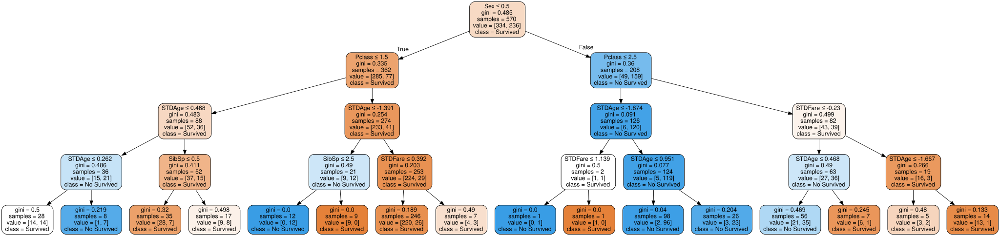

In [157]:
# Plot New Tree Max Depth = 4
# Export to pdf file and plot inline
dot_data = tree.export_graphviz(clfTuning2, out_file = None, 
                         feature_names = X_train.columns,  
                         class_names = ["Survived", "No Survived"],  
                         filled = True, rounded = True,  
                         special_characters = True,
                         max_depth = 4)  
graph = graphviz.Source(dot_data) 
graph.render("clfTuning2") 
graph 

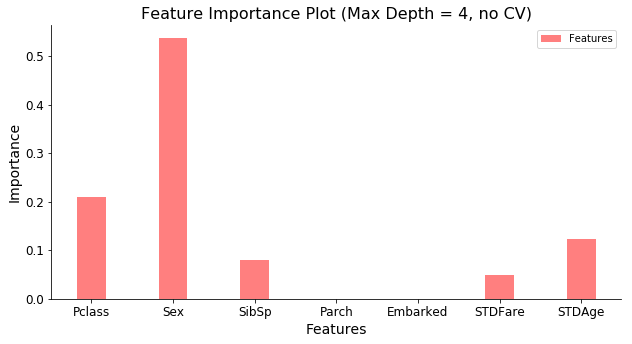

In [158]:
# Feature importance plot
# Figure size
plt.figure(1)
plt.figure(figsize = (9, 5)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Number of bars          
n_groups = len(FeatImp)

# Visual style
index = np.arange(n_groups)
bar_width = 0.35
opacity = 0.5

rects1 = plt.bar(index, FeatImp, bar_width,
                 alpha=opacity, color='r', 
                 label='Features')

# Labels, Title, and legends
plt.xlabel("Features")
plt.ylabel('Importance')
plt.title("Feature Importance Plot (Max Depth = 4, no CV)")
plt.xticks(index, FeatLab)
plt.legend()

plt.tight_layout()
plt.show()    

## Observations

###  Show the tree diagram and also plot the feature importances. What do you observe?

### Tree diagram
The diagram has been plotted in the previous code chunks, showing the 4 layers of the new decision tree. Again, we can easily notice that it is consistent with the feature importances obtained, as shown below.

### Feature importances

We compute the feature importances for the new decision tree model including only four layers. When comparing the feature importances of the current model with the original decision tree implementation (vanilla approach), we obtain the following values:

|  Feature | Importance (Decision Tree, default) | Importance (Decision Tree, MD = 4) |
|:--------:|:-----------------------------------:| :---------------------------------:|
|   Pclass |                          0.12404813 | 0.21065078 |
|      Sex |                          0.29552792 | 0.53693227|
|    SibSp |                          0.03488653 | 0.07986180|
|    Parch |                          0.00742530 | 0.00000000|
| Embarked |                          0.01910331 | 0.00000000|
|  STDFare |                          0.20772417 | 0.04948637|
|   STDAge |                          0.31128464 | 0.12306878|

We can easily notice that we do not obtain exactly the same features importance (as expected) with respect to the ones obtained by the vanilla implementation of the decision tree model. However, we have a similar analysis as before:

Looking at the previous table, we can easily notice that the most important variable for the model consists of the $Sex$ feature, that has increased its importance up to 0.536 (almost doubling its importance with respect to the vanilla implementation). Then, we can see that the new second most important feature is the $Pclass$ variable, increasing its importance from 0.124 up to 0.210, leaving the $STDAge$ feature in the third place with an importance of 0.123, less than half of its original importance when performing the vanilla implementation. 

On the other hand, we can see how the $STDFare$ feature decreases its importance in a very significant way from 0.207 to a very low 0.049. One explanation behind this pattern could be the fact that the importance of the $Pclass$ variable has been increased significantly and, as we know from the preliminary analysis, both variables are highly correlated, leading to drop the importance of one of them. Finally, the importance of the variables $SibSp$, $Parch$, and $Embarked$ is even less than in the original implementation, indicating us the low predictive power of them when applying the decision tree model.

Hence, our initial thoughts are consistent and coherent to the first insights obtained from the simple decision tree model in terms of the relevance of each feature for generating useful predictions and insights for the current dataset.

In [159]:
# Accuracy and Max Depth
# Random seed: reproducibility
np.random.seed(1)

# Data
X = Xtrain
y = Ytrain

# K-folds value
k = 10

# MaxDepth
MaxDepths = np.arange(1, 31, 1) 

# Intercept and feature coefficients
Results = [0 for i in range(0, k)]

# Accuracy 
AccTrain = [[0 for i in range(0, k)] for j in range(0, len(MaxDepths))]
AccTest = [[0 for i in range(0, k)] for j in range(0, len(MaxDepths))]
AVGAccTrain = [0 for j in range(0, len(MaxDepths))]
AVGAccTest = [0 for j in range(0, len(MaxDepths))]

BestAccTest = 0
BestAccTrain = 0
BestMaxDepthTrain = 0
BestMaxDepthTest = 0

BestOuterIter = 0
BestOuterIterTest = 0
BestOuterIterTrain = 0
BestIter = 0

BestImportance = []

BestAVGAccTrain = 0
BestAVGAccTest = 0

# Niters
niters = 0
nouteriter = 0

# CV loop
kf = KFold(n_folds = k, n = len(X), shuffle = True)

# Max Depth loop
for md in MaxDepths:
    print("----------------------- Max depth =", md, "-----------------------" )
    
    # Reset values
    niters = 0
    BestAccTest = 0
    BestAccTrain = 0
    
    # Generate the sets
    for train_index, test_index in kf:
        # Iteration number
        print("------------------ Iteration", niters + 1, "------------------")
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Calling the function
        clf = tree.DecisionTreeClassifier(max_depth = md, random_state = 0)
        clf = clf.fit(X_train, y_train)

        # Computing Accuracy
        # Training Accuracy value
        AccTrain[nouteriter][niters] = clf.score(X = X_train, y = y_train) 

        # Testing Accuracy value
        AccTest[nouteriter][niters] = clf.score(X = X_test, y = y_test) 

        # Best test Accuracy (inner)
        if AccTest[nouteriter][niters] > BestAccTest:
            BestAccTest = AccTest[nouteriter][niters]
            BestIter = niters
            BestOuterIter = nouteriter
            BestImportance = clf.feature_importances_

        # Print results
        print("CV Iteration Results")
        print("-------------------- Accuracy --------------------")
        print("Training set:", AccTrain[nouteriter][niters])
        print("Testing set:", AccTest[nouteriter][niters])
        print("--------------------------------------------------")

        # Next iteration
        niters += 1

    # CV AVG accuracy
    AVGAccTrain[nouteriter] = np.mean(AccTrain[nouteriter])
    AVGAccTest[nouteriter] = np.mean(AccTest[nouteriter])
        
    # Summary results
    print("\n\nSummary 10-fold Cross-validation, Max depth =", md)
    print("---------------------------------------")
    print("Average Accuracy training:",AVGAccTrain[nouteriter])
    print("Average Accuracy testing:", AVGAccTest[nouteriter])
    print("Best Accuracy (test):", BestAccTest, "on iteration", 
          BestIter + 1)
    print("Importance of features best accuracy (test):\n", 
          BestImportance)
    print("---------------------------------------\n\n")
    
    # Best AVG accuracy (train & test)
    if AVGAccTrain[nouteriter] > BestAVGAccTrain:
        BestAVGAccTrain = AVGAccTrain[nouteriter]
        BestOuterIterTrain = nouteriter
        BestMaxDepthTrain = md
    
    if AVGAccTest[nouteriter] > BestAVGAccTest:
        BestAVGAccTest = AVGAccTest[nouteriter]
        BestOuterIterTest = nouteriter
        BestMaxDepthTest = md
        
    # Next outer iteration
    nouteriter += 1
    
# Final results
print("\n\nFinal Results")
print("---------------------------------------")
print("Best Max Depth (training):", MaxDepths[BestOuterIterTrain])
print("Best Accuracy (training):", BestAVGAccTrain)
print("Best Max Depth (testing):", MaxDepths[BestOuterIterTest])
print("Best Accuracy (testing):", BestAVGAccTest)
print("---------------------------------------")

----------------------- Max depth = 1 -----------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.908382066277
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.898635477583
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.898635477583
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.90253411306
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.986354775828
Testing set: 0.736842105263
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.978167641326
Average Accuracy testing: 0.763157894737
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.14580281  0.29710011  0.0478574   0.02220802  0.02483776  0.24192167
  0.22027224]
---------------------------------------


----------------------- Max depth = 14 -----------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.986354775828
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trai

Best Accuracy (test): 0.824561403509 on iteration 4
Importance of features best accuracy (test):
 [ 0.13038759  0.29552792  0.04657715  0.01179465  0.02253637  0.18755494
  0.30562139]
---------------------------------------


----------------------- Max depth = 20 -----------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.649122807018
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.649122807018
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
--------------------

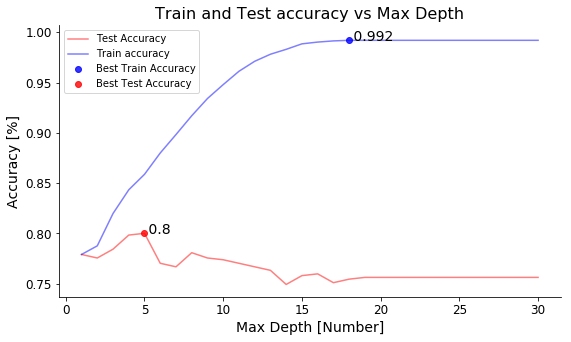

In [160]:
# Plot
# Figure size
plt.figure(1)
plt.figure(figsize = (9, 5)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Labels, Title, and legends
plt.xlabel("Max Depth [Number]")
plt.ylabel('Accuracy [%]')
plt.title("Train and Test accuracy vs Max Depth")


# lines plot and annotations
plt.plot(MaxDepths, AVGAccTest, 'r-', 
         alpha = 0.5, label = "Test Accuracy")
plt.plot(MaxDepths, AVGAccTrain, 'b-', 
         alpha = 0.5, label = "Train accuracy")
plt.scatter(MaxDepths[BestOuterIterTrain], BestAVGAccTrain, 
            color = 'b', alpha = 0.8, label = "Best Train Accuracy")
ax.annotate(' ' + str(np.round(BestAVGAccTrain, 3)), 
            (MaxDepths[BestOuterIterTrain], BestAVGAccTrain))
plt.scatter(MaxDepths[BestOuterIterTest], BestAVGAccTest, 
            color = 'r', alpha = 0.8, label = "Best Test Accuracy")
ax.annotate(' ' + str(np.round(BestAVGAccTest, 3)), 
            (MaxDepths[BestOuterIterTest], BestAVGAccTest))

plt.legend()
plt.show()    

In [162]:
# Max Depth and min-samples_leaf vs Accuracy
# Random seed: reproducibility
np.random.seed(1)

# Data
X = Xtrain
y = Ytrain

# K-folds value
k = 10

# MaxDepth
MaxDepths = np.arange(1, 31, 1) 

# MinSampleLeaf
MinSampleLeaf = np.arange(1, 101, 1) 

# Intercept and feature coefficients
Results = [0 for i in range(0, k)]

# Accuracy 
AccTrain = [[[0 for i in range(0, k)] for j in range(0, len(MaxDepths))] for l in range(0, len(MinSampleLeaf))]
AccTest = [[[0 for i in range(0, k)] for j in range(0, len(MaxDepths))] for l in range(0, len(MinSampleLeaf))]
AVGAccTrain = [[0 for j in range(0, len(MaxDepths))] for l in range(0, len(MinSampleLeaf))] 
AVGAccTest = [[0 for j in range(0, len(MaxDepths))] for l in range(0, len(MinSampleLeaf))]

BestAccTest = 0
BestAccTrain = 0

BestMDMSIter = 0
BestMDMSTest = 0
BestMDMSTrain = 0
BestIter = 0

BestGlobalTest = 0
BestGlobalMDTest = 0
BestGlobalMSTest = 0

BestGlobalTrain = 0
BestGlobalMDTrain = 0
BestGlobalMSTrain = 0

BestImportance = []

BestAVGAccTrain = 0
BestAVGAccTest = 0

# Niters
ncviter = 0
nmditer = 0
nmsiter = 0

# CV loop
kf = KFold(n_folds = k, n = len(X), shuffle = True)

# Min Sample Leaf loop
for ms in MinSampleLeaf:
    print("----------------------- Min Sample leaf =", ms, "-----------------------" )
    
    # Reset values
    nmditer = 0
    
    # Max Depth loop
    for md in MaxDepths:
        print("------------------ Max depth =", md, "------------------" )

        # Reset values
        ncviter = 0
        BestAccTest = 0
        BestAccTrain = 0

        # Generate the sets
        for train_index, test_index in kf:
            # Iteration number
            print("------------------ Iteration", ncviter + 1, "------------------")
            X_train, X_test = X.iloc[train_index], X.iloc[test_index]
            y_train, y_test = y.iloc[train_index], y.iloc[test_index]

            # Calling the function
            clf = tree.DecisionTreeClassifier(max_depth = md, 
                                              min_samples_leaf = ms, 
                                              random_state = 0)
            clf = clf.fit(X_train, y_train)

            # Computing Accuracy
            # Training Accuracy value
            AccTrain[nmsiter][nmditer][ncviter] = clf.score(X = X_train, y = y_train) 

            # Testing Accuracy value
            AccTest[nmsiter][nmditer][ncviter] = clf.score(X = X_test, y = y_test) 

            # Best test Accuracy (inner)
            if AccTest[nmsiter][nmditer][ncviter] > BestAccTest:
                BestAccTest = AccTest[nmsiter][nmditer][ncviter]
                BestIter = ncviter
                BestOuterIter = nmditer
                BestImportance = clf.feature_importances_

            # Print results
            print("CV Iteration Results")
            print("-------------------- Accuracy --------------------")
            print("Training set:", AccTrain[nmsiter][nmditer][ncviter])
            print("Testing set:", AccTest[nmsiter][nmditer][ncviter])
            print("--------------------------------------------------")

            # Next iteration (CV)
            ncviter += 1

        # CV AVG accuracy
        AVGAccTrain[nmsiter][nmditer] = np.mean(AccTrain[nmsiter][nmditer])
        AVGAccTest[nmsiter][nmditer] = np.mean(AccTest[nmsiter][nmditer])

        # Summary results
        print("\n\nSummary 10-fold Cross-validation, Max depth =", md)
        print("---------------------------------------")
        print("Average Accuracy training:", AVGAccTrain[nmsiter][nmditer])
        print("Average Accuracy testing:", AVGAccTest[nmsiter][nmditer])
        print("Best Accuracy (test):", BestAccTest, "on iteration", 
              BestIter + 1)
        print("Importance of features best accuracy (test):\n", 
              BestImportance)
        print("---------------------------------------\n\n")

        # Best AVG accuracy (train & test)
        if AVGAccTrain[nmsiter][nmditer] > BestAVGAccTrain:
            BestAVGAccTrain = AVGAccTrain[nmsiter][nmditer]
            BestMDMSTrain = nmditer
            BestMaxDepthTrain = md
            BestGlobalMDTrain = md
            BestGlobalMSTrain = ms
            
        if AVGAccTest[nmsiter][nmditer] > BestAVGAccTest:
            BestAVGAccTest = AVGAccTest[nmsiter][nmditer]
            BestOuterIterTest = nmditer
            BestMaxDepthTest = md
            BestGlobalMDTest = md
            BestGlobalMSTest = ms

        # Next Max Depth iteration
        nmditer += 1

    # Max Depth results
    print("\n\nSummary Max Depth =", md, "Min Sample leaf =", ms, "Results")
    print("---------------------------------------")
    print("Best Max Depth (training):", MaxDepths[BestOuterIterTrain])
    print("Best Accuracy (training):", BestAVGAccTrain)
    print("Best Max Depth (testing):", MaxDepths[BestOuterIterTest])
    print("Best Accuracy (testing):", BestAVGAccTest)
    print("---------------------------------------")

    # Next Min Sample leaf iteration
    nmsiter += 1
    
    
# Final results
print("\n\nGlobal Summary Results")
print("---------------------------------------")
print("Best Max Depth (training):", BestGlobalMDTrain)
print("Best Min Sample Leaf (training):", BestGlobalMSTrain)
print("Best Accuracy (training):", BestAVGAccTrain)
print("Best Max Depth (testing):", BestGlobalMDTest)
print("Best Min Sample Leaf (testing):", BestGlobalMSTest)
print("Best Accuracy (testing):", BestAVGAccTest)
print("---------------------------------------")


----------------------- Min Sample leaf = 1 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
-----------

-------------------- Accuracy --------------------
Training set: 0.90253411306
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.881091617934
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.884990253411
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.925925925926
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 7
---------------------------------------
Average Accuracy training: 0.898245614035
Average Accuracy te

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.986354775828
Testing set: 0.736842105263
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.978167641326
Average Accuracy testing: 0.763157894737
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.14580281  0.29710011  0.0478574   0.02220802  0.02483776  0.24192167
  0.22027224]
---------------------------------------


------------------ Max depth = 14 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.986354775828
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.992007797271
Average Accuracy 

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 2
-------------------------------

Training set: 0.912280701754
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.894736842105
Testing set: 0.666666666667
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.929824561404
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.908382066277
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.916179337232
Testing set: 0.736842105263
-----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.937621832359
Testing set: 0.649122807018
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.927875243665
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.925925925926
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.925925925926
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

Training set: 0.931773879142
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.925925925926
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.925925925926
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.923976608187
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.92007797271
Testing set: 0.80701754386
-------------------------

-------------------- Accuracy --------------------
Training set: 0.923976608187
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.92007797271
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.929824561404
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.925925925926
Testing set: 0.736842105263
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 28
---------------------------------------
Average Accuracy training: 0.926510721248
Average Accuracy tes

--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 4
---------------------------------------
Average Accuracy training: 0.839961013645
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.21033424  0.55990542  0.04139073  0.          0.          0.04673996
  0.14162965]
---------------------------------------


------------------ Max depth = 5 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836257309942
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 -------

Average Accuracy testing: 0.780701754386
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 [ 0.17594166  0.3697281   0.04512924  0.01115155  0.00602008  0.19947003
  0.19255933]
---------------------------------------


------------------ Max depth = 12 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.900584795322
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.898635477583
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.914230019493
Testing set: 0.649122807018
----------------------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904483430799
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.912280701754
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.90253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.908382066277
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

Average Accuracy testing: 0.768421052632
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 [ 0.16944872  0.35608369  0.04805073  0.01038665  0.01341036  0.19431285
  0.20830698]
---------------------------------------


------------------ Max depth = 25 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.908382066277
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.904483430799
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.916179337232
Testing set: 0.631578947368
----------------------------------------

----------------------- Min Sample leaf = 4 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
-----------

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.877192982456
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879142300195
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.896686159844
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 14
---------------------------------------
Average Accuracy training: 0.887524366472
Average Accuracy testing: 0.780701754386
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 [ 0.18183955  0.40187644  0.01615169  0.00971325  0.01513495  0.19107997
  0.18420415]
---------------------------------------


------------------ Max depth = 15 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88693957115
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.

--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879142300195
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.881091617934
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.894736842105
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88693957115
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88693957115
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.896686159844
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 27
---------------------------------------
Average Accuracy training: 0.887524366472
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 [ 0.18183955  0.40187644  0.01615169  0.00971325  0.01513495  0.19107997
  0.18420415]
---------------------------------------


------------------ Max depth = 28 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0

--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 3
---------------------------------------
Average Accuracy training: 0.818713450292
Average Accuracy testing: 0.79298245614
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 [ 0.26803666  0.59941995  0.          0.          0.          0.05147671
  0.08106668]
---------------------------------------


------------------ Max depth = 4 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 2 ------

Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.884990253411
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88693957115
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.771929824561
--------------------------------------------------
----

Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.16836294  0.44817868  0.02319197  0.01497113  0.00399518  0.14575328
  0.19554682]
---------------------------------------


------------------ Max depth = 17 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.888888888889
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.88693957115
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.892787524366
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.883040935673
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

-------------------- Accuracy --------------------
Training set: 0.883040935673
Testing set: 0.824561403509
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.877972709552
Average Accuracy testing: 0.789473684211
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.16644567  0.44307495  0.02292787  0.00944089  0.01026654  0.10303041
  0.24481368]
---------------------------------------


------------------ Max depth = 30 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.888888888889
Testin

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875243664717
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 6
---------------------------------------
Average Accuracy training: 0.855945419103
Average Accuracy testing: 0.801754385965
Best Accuracy (test): 0.859649122807 on iteration 9
Importance of features best accuracy (test):
 [ 0.21298079  0.47773755  0.05953406  0

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.894736842105
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875243664717
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 19
---------------------------------------
Average Accuracy training: 0.868421052632
Average Accuracy testing: 0.80350877193
Best Accuracy (test): 0.894736842105 on iteration 9
Importance of features best accuracy (test):
 [ 0.1927321   0.43231769  0.05408158  0.02870599  0.00768618  0.10504746
  0.179429  ]
---------------------------------------


------------------ Max depth = 20 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-valida

Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.719298245614
--------------------------------------------------
--

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

Training set: 0.857699805068
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.862573099415
Average Accuracy testing: 0.784210526316
Best Accuracy (test): 0.85964

------------------ Max depth = 6 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 

-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Te

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 19
---------------------------------------
Average Accuracy training: 0.854970760234
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 [ 0.22411994  0.47865028  0.00952148  0.          0.00394603  0.11368755
  0.17007472]
---------------------------------------


------------------ Max depth = 20 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
--------------

--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 

Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 2
---------------------------------------
Average Accuracy training: 0.787524366472
Average Accuracy testing: 0.775438596491
Best Accuracy (test): 0.859649

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

Average Accuracy testing: 0.794736842105
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 [ 0.23211178  0.49571838  0.00986101  0.          0.00408674  0.10381551
  0.15440658]
---------------------------------------


------------------ Max depth = 17 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.736842105263
-----------------------------------------

-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285


------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 6
---------------------------------------
Average Accuracy training: 0.844054580897
Average Accuracy testing: 0.784210526316
Best Accuracy (test): 0.877192982456 on iteration 6
Importance of features best accuracy (test):
 [ 0.24126257  0.5152616   0.01024977  0.00520516  0.          0.10477975
  0.12324116]
---------------------------------------


------------------ Max depth = 7 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 -----

Average Accuracy testing: 0.785964912281
Best Accuracy (test): 0.877192982456 on iteration 6
Importance of features best accuracy (test):
 [ 0.23398958  0.49972877  0.00994079  0.00504825  0.00407409  0.1186147
  0.12860382]
---------------------------------------


------------------ Max depth = 14 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842105263158
Testing set: 0.701754385965
-----------------------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 20
---------------------------------------
Average Accuracy training: 0.84619883040

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842105263158
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836257309942
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------

Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.80701754386
--------------------------------------------------
---

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
---------------------------------------
Average Accuracy training: 0.837816764133
Average Accuracy testing: 0.787719298246
Best Accuracy (test): 0.877192982456 on iteration 8
Importance of features best accuracy (test):
 [ 0.21784338  0.52499238  0.          0.01281919  0.0106716   0.07308379
  0.16058966]
---------------------------------------


------------------ Max depth = 11 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842105263158
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 23
---------------------------------------
Average Accuracy training: 0.837816764133
Average Accuracy testing: 0.787719298246
Best Accuracy (test): 0.877192982456 on iteration 8
Importance of features best accuracy (test):
 [ 0.21784338  0.52499238  0.          0.01281919  0.0106716   0.07308379
  0.16058966]
---------------------------------------


------------------ Max depth = 24 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

Average Accuracy training: 0.837816764133
Average Accuracy testing: 0.787719298246
Best Accuracy (test): 0.877192982456 on iteration 8
Importance of features best accuracy (test):
 [ 0.21784338  0.52499238  0.          0.01281919  0.0106716   0.07308379
  0.16058966]
---------------------------------------


------------------ Max depth = 30 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.701754385965


CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834307992203
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
----------

-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
T

Average Accuracy testing: 0.784210526316
Best Accuracy (test): 0.859649122807 on iteration 8
Importance of features best accuracy (test):
 [ 0.22344511  0.5384923   0.          0.          0.01094601  0.06351007
  0.16360651]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.701754385965
----------------------------------------

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 3
------------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
---------------------------------------
Average Accuracy training: 0.830604288499
Average Accuracy testing: 0.789473684211
Best Accuracy (test): 0.859649122807 on iteration 8
Importance of features best accuracy (test):
 [ 0.22457036  0.54120409  0.          0.          0.00711716  0.06420362
  0.16290478]
---------------------------------------


------------------ Max depth = 11 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 17
---------------------------------------
Average Accuracy training: 0.830604288499
Average Accuracy testing: 0.789473684211
Best Accuracy (test): 0.859649122807 on iteration 8
Importance of features best accuracy (test):
 [ 0.22457036  0.54120409  0.          0.          0.00711716  0.06420362
  0.16290478]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
--------------

--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8

Summary Max Depth = 30 Min Sample leaf = 13 Results
---------------------------------------
Best Max Depth (training): 18
Best Accuracy (training): 0.992007797271
Best Max Depth (testing): 5
Best Accuracy (testing): 0.808771929825
---------------------------------------
----------------------- Min Sample leaf = 14 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7836257309

-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.894736842105
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 7
---------------------------------------
Average Accuracy training: 0.829239766082
Average Accuracy testing: 0.8
Best Accuracy (test): 0.894736842105 on iteration 8
Importance of features best accuracy (test):
 [ 0.23083479  0.5549191   0.          0.          0.00729752  0.0616639
  0.14528469]
-----------------------------------

Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 14
---------------------------------------
Average Accuracy training: 0.829239766082
Average Accuracy testing: 0.8
Best Accuracy (test): 0.894736842105 on iteration 8
Importance of features best accuracy (test):
 [ 0.22900068  0.55188097  0.          0.          0.00725757  0.06356949
  0.14829129]
---------------------------------------


------------------ Max depth = 15 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.771929824561
--------------------------------------------------
-----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836257309942
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.894736842105
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training se

Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836257309942
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.80701754386
--------------------------------------------------
---

Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.877192982456
--------------------------------------------------
---

Training set: 0.820662768031
Testing set: 0.894736842105
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 12
---------------------------------------
Average Accuracy training: 0.828460038986
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.894736842105 on iteration 8
Importance of features best accuracy (test):
 [ 0.23083888  0.55631094  0.          0.          0.00731582  0.05988526
  0.14564909]
---------------------------------------


------------------ Max depth =

-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834307992203
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834307992203
T

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.828460038986
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.894736842105 on iteration 8
Importance of features best accuracy (test):
 [ 0.23083888  0.55631094  0.          0.          0.00731582  0.05988526
  0.14564909]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 2
---------------------------------------
Average Accuracy training: 0.787329434698
Average Accuracy testing: 0.775438596491
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.27307635  0.72692365  0.          0.          0.          0.          0.        ]
---------------------------------------


------------------ Max depth = 3 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing se

Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.894736842105
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------



Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.859649122807
--------------------------------------------------
---

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.894736842105
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 24
---------------------------------------
Average Accuracy training: 0.8278752436

Summary Max Depth = 30 Min Sample leaf = 16 Results
---------------------------------------
Best Max Depth (training): 18
Best Accuracy (training): 0.992007797271
Best Max Depth (testing): 5
Best Accuracy (testing): 0.808771929825
---------------------------------------
----------------------- Min Sample leaf = 17 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7836257309

---------------------------------------


------------------ Max depth = 8 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834307992203
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.842105263158
-------------------------------------

Training set: 0.830409356725
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834307992203
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.736842105263
-----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 21
---------------------------------------
Average Accuracy training: 0.82514619883
Average Accuracy testing: 0.79298245614
Best Accuracy (test): 0.877192982456 on iteration 6
Importance of features best accuracy (test):
 [ 0.24826436  0.55072087  0.          0.          0.          0.06793814
  0.13307663]
---------------------------------------


------------------ Max depth = 22 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 28
---------------------------------------
Average Accuracy training: 0.82514619883
Average Accuracy testing: 0.79298245614
Best Accuracy (test): 0.877192982456 on iteration 6
Importance of features best accuracy (test):
 [ 0.24826436  0.55072087  0.          0.          0.          0.06793814
  0.13307663]
---------------------------------------


------------------ Max depth = 29 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
----------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------

Average Accuracy testing: 0.794736842105
Best Accuracy (test): 0.877192982456 on iteration 6
Importance of features best accuracy (test):
 [ 0.25035097  0.55534957  0.          0.          0.          0.06851398
  0.12578549]
---------------------------------------


------------------ Max depth = 20 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.701754385965
----------------------------------------

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.824171539961
Average Accuracy testing: 0.794736842105
Best Accuracy (test): 0.877192982456 on iteration 6
Importance of features best accuracy (test):
 [ 0.25035097  0.55534957  0.         

Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 2
---------------------------------------
Average Accuracy training: 0.787134502924
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.27307635  0.72692365  0.          0.          0.          0.          0.        ]
---------------------------------------


------------------ Max depth = 3 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.80701754386
----------------------------------

Training set: 0.82261208577
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.877192982456
------------------------

--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 

Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 23
---------------------------------------
Average Accuracy training: 0.823196881092
Average Accuracy testing: 0.794736842105
Best Accuracy (test): 0.877192982456 on iteration 6
Importance of features best accuracy (test):
 [ 0.25513229  0.56595589  0.          0.          0.          0.05792657
  0.12098525]
---------------------------------------


------------------ Max depth = 24 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.789473684211
------------------------------

-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292



------------------ Max depth = 7 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 

Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.789473684211
--------------------------------------------------
-

Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.736842105263
--------------------------------------------------
---

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 4
---------------------------------------
Average Accuracy training: 0.819493177388
Average Accuracy testing: 0.808771929825
Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accuracy (test):
 [ 0.26262103  0.5988688   0.          0.          0.          0.03907926
  0.0994309 ]
---------------------------------------


------------------ Max depth = 5 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0

Training set: 0.82261208577
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
------------------------

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 19
----------------------------

Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
-

------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 3
---------------------------------------
Average Accuracy training: 0.81656920078
Average Accuracy testing: 0.80350877193
Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accuracy (test):
 [ 0.26954563  0.61465933  0.          0.          0.          0.04010968
  0.07568537]
---------------------------------------


------------------ Max depth = 4 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

Training set: 0.826510721248
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.819688109162
Average Accuracy testing: 0.801754385965
Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accuracy (test):
 [ 0.2565247  0.584967   0.         0.         0.         0.0381721
  0.1203362]
---------------------------------------


------------------ Max depth = 19 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.789473684211
-------------------------------------

Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accuracy (test):
 [ 0.2565247  0.584967   0.         0.         0.         0.0381721
  0.1203362]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 -------

Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.877192982456
--------------------------------------------------
--

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
---------------------------------------
Average Accuracy training: 0.818713450292
Average Accuracy testing: 0.80350877193
Best Accuracy (test): 0.859649122807 on iteration 9
Importance of features best accuracy (test):
 [ 0.25823372  0.58886416  0.          0.          0.          0.03842641
  0.11447571]
---------------------------------------


------------------ Max depth = 11 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 17
---------------------------------------
Average Accuracy training: 0.818713450292
Average Accuracy testing: 0.80350877193
Best Accuracy (test): 0.859649122807 on iteration 9
Importance of features best accuracy (test):
 [ 0.25823372  0.58886416  0.          0.          0.          0.03842641
  0.11447571]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
---------------

Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 24
---------------------------------------
Average Accuracy training: 0.818713450292
Average Accuracy testing: 0.80350877193
Best Accuracy (test): 0.859649122807 on iteration 9
Impor

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
T

--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 23
---------------------------------------
Average Accuracy training: 0.817933723197

Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 30
---------------------------------------
Average Accuracy training: 0.817933723197
Average Accuracy testing: 0.801754385965
Best Accuracy (test): 0.859649122807 on iteration 9
Importance of features best accuracy (test):
 [ 0.26306953  0.59989154  0.          0.          0.          0.039146
  0.09789293]
---------------------------------------




Summary Max Depth = 30 Min Sample leaf = 24 Results
----------

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 7
------------------------------

Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accuracy (test):
 [ 0.26672072  0.60821753  0.          0.          0.          0.03221819
  0.09284356]
---------------------------------------


------------------ Max depth = 15 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 22
---------------------------------------
Average Accuracy training: 0.817543859649
Average Accuracy testing: 0.805263157895
Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accuracy (test):
 [ 0.26672072  0.60821753  0.          

Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
-----------------------

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
---------

Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 14
---------------------------------------
Average Accuracy training: 0.817543859649
Average Accuracy testing: 0.805263157895
Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accuracy (test):
 [ 0.26738974  0.60974313  0.          0.          0.          0.03026436
  0.09260277]
---------------------------------------


------------------ Max depth = 

---------------------------------------


------------------ Max depth = 22 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
------------------------------------

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 28
---------------------------------------
Average Accuracy training: 0.817543859649
Average Accuracy testing: 0.805263157895
Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accuracy (test):
 [ 0.26738974  0.60974313  0.          0.          0.          0.03026436
  0.09260277]
---------------------------------------


------------------ Max depth = 29 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
---------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 20
---------------------------------------
Average Accuracy training: 0.816764132554
Average Accuracy testing: 0.80350877193
Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accura

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.877192982456
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 27
-----------------------------

-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 3
---------------------------------------
Average Accuracy training: 0.816374269006
Average Accuracy testing: 0.808771929825
Best Accuracy (test): 0.912280701754 on iteration 9
Importance of features best accuracy (test):
 [ 0.27621874  0.62987638  0.          0.          0.          0.02958409
  0.0643208 ]
---------------------------------------


------------------ Max depth = 4 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing s

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.912280701754
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
---------

--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 2
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.27307635  0.72692365  0.          0.          0.          0.          0.        ]
---------------------------------------


------------------ Max depth = 3 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 --------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.912280701754
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
---------------------------------------
Average Accuracy training: 0.816374269006
Average Accuracy testing: 0.814035087719
Best Accuracy (test): 0.912280701754 on iteration 9
Importance of features best accuracy (test):
 [ 0.26919187  0.61385263  0.          0.          0.          0.02883148
  0.08812402]
--

Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.912280701754
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 18
---------------------------------------
Average Accuracy training: 0.816374269006
Average Accuracy testing: 0.814035087719
Best Accuracy (test): 0.91228

  0.08812402]
---------------------------------------


------------------ Max depth = 27 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
------------------------

--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 -

Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.912280701754
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.816374269006
Average Accuracy testing: 0.814035087719
Best Accuracy (test): 0.91228

-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Tes

Training set: 0.80701754386
Testing set: 0.912280701754
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.816374269006
Average Accuracy testing: 0.814035087719
Best Accuracy (test): 0.912280701754 on iteration 9
Importance of features best accuracy (test):
 [ 0.27241397  0.62120014  0.          0.          0.          0.03051468
  0.07587121]
---------------------------------------


------------------ Max depth = 30 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
------------------------------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 15
---------------------------------------
Average Accuracy training: 0.816179337232
Average Accuracy testing: 0.814035087719
Best Accuracy (test): 0.912280701754 on iteration 9
Importance of features best accuracy (test):
 [ 0.27241397  0.62120014  0.          0.          0.          0.03051468
  0.07587121]
---------------------------------------


------------------ Max depth = 16 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0

Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
--

Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 2
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.27307635  0.72692365  0.          0.          0.          0.          0.        ]
---------------------------------------


------------------ Max depth = 3 -

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.912280701754
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
------------------------------

Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
--

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.754385964912
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 7
---------------------------------------
Average Accuracy training: 0.815399610136
Average Accuracy testing: 0.80701754386
Best Accuracy (test): 0.912280701754 on iteration 9
Importance of features best accuracy (test):
 [ 0.27301556  0.62257199  0.          0.          0.          0.03189295
  0.0725195 ]
---------------------------------------


------------------ Max depth = 8 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-----------------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
------------

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
----------

Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
-----------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.912280701754
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.754385964912
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.8136452241

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.912280701754
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.754385964912
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 30
---------------------------------------
Average Accuracy training: 0.813645224172
Average Accuracy testing: 0.80701754386
Best Accuracy (test): 0.912280701754 on iteration 9
Importance of features best accuracy (test):
 [ 0.27270236  0.62185779  0.          0.          0.          0.03051685
  0.074923  ]
---------------------------------------




Summary Max Depth = 30 Min Sample leaf = 34 Results
---------------------------------------
Best Max Depth (training): 18
Best Accuracy (t

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.754385964912
--------------------------------------------------
----

------------------ Max depth = 29 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.912280701754
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 19
---------------------------------------
Average Accuracy training: 0.810331384016
Average Accuracy testing: 0.8
Best Accuracy (test): 0.912280701754 on iteration 9
Importance of features best accuracy (test):
 [ 0.27498666  0.6270668   0.          0.          0.          0.03101283
  0.06693371]
---------------------------------------


------------------ Max depth = 20 ------------------
------------------ Iteration 1 --------------

Training set: 0.810916179337
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.912280701754
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 30
---------------------------------------
Average Accuracy training: 0.810331384016
Average Accuracy testing: 0.8
Best Accuracy (test): 0.912280701754 on iteration 9
Importance of features best accuracy (test):
 [ 0.27498666  0.6270668   0.          0.          0.          0.03101283
  0.06693371]
---------------------------------------




Summary Max Depth = 30 Min Sample leaf 

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
-----------------------------

Training set: 0.80701754386
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 22
---------------------------------------
Average Accuracy training: 0.799415204678
Average Accuracy testing: 0.79649122807
Best Accuracy (test): 0.859649122807 on iteration 8
Importance of features best accuracy (test):
 [ 0.26204684  0.63152066  0.          0.          0.          0.02280536
  0.08362714]
---------------------------------------


------------------ Max depth = 2

Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.789473684211
--------------------------------------------------
-

Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.789473684211
--------------------------------------------------
-

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.79298245614
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 4
Importance of features best accuracy (test):
 [ 0.25329869  0.67427591  0.          

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.701754385965
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 30
---------------------------------------
Average Accuracy training: 0.791812865497
Average Accuracy testing: 0.782456140351
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.25841418  0.68789324  0.          0.          0.          0.01390307
  0.03978951]
---------------------------------------




Summary Max Depth = 30 Min Sample leaf = 39 Results
---------------------------------------
Best Max Depth (training): 18
Best Accuracy (training): 0.992007797271
Best Max Depth (testing): 5
Best Accuracy (testing): 0.814035087719
---------------------------------------
----------------

Training set: 0.787524366472
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
---------------------------------------
Average Accuracy training: 0.788499025341
Average Accuracy testing: 0.780701754386
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.25841418  0.68789324  0.          0.          0.          0.01390307
  0.03978951]
---------------------------------------


------------------ Max depth = 12 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.789473684211
----------------------------

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
---------

---------------------------------------
Best Max Depth (training): 18
Best Accuracy (training): 0.992007797271
Best Max Depth (testing): 5
Best Accuracy (testing): 0.814035087719
---------------------------------------
----------------------- Min Sample leaf = 41 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
---------------------

Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------




--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 23
---------------------------------------
Average Accuracy training: 0.786744639376
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.25841418  0.68789324  0.          0.          0.          0.01390307
  0.03978951]
---------------------------------------


------------------ Max depth = 24 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ---

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 15
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26136235  0.69574122  0.          0.          0.          0.01406169
  0.02883474]
---------------------------------------


------------------ Max depth = 16 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
-----------------------------

--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 8
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26136235  0.69574122  0.          0.          0.          0.01406169
  0.02883474]
---------------------------------------


------------------ Max depth = 9 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
----------------

-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
T

---------------------------------------
----------------------- Min Sample leaf = 44 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.77777777777

------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 12
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26136235  0.69574122  0.          0.          0.          0.01406169
  0.02883474]
---------------------------------------


------------------ Max depth = 13 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
---------------

-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994


Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
-----------------------

Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
-

Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
-

Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 7
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26136235  0.69574122  0.          0.          0.          0.01406169
  0.02883474]
---------------------------------------


------------------ Max depth = 8 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
---------

Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
-----------------------

-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
T

Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
------------------------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------

Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26688391  0.71043949  0.          0.          0.          0.00104244
  0.02163415]
---------------------------------------


------------------ Max depth = 4 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316

Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26173457  0.69673206  0.          0.          0.          0.01288648
  0.0286469 ]
---------------------------------------


------------------ Max depth = 15 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 25
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26173457  0.69673206  0.          0

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
-----------------------

--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 28
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26246286  0.69867073  0.          0.          0.          0.0118002
  0.02706622]
---------------------------------------


------------------ Max depth = 29 ------------------
------------------ Iteration 1 -----

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
---------

Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
-

--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 

Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
---

-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472


------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
T

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 27
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.2640963   0.70301893  0.          0.          0.          0.00930057
  0.02358419]
---------------------------------------


------------------ Max depth = 28 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
--------------

Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------




Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
--

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26474087  0.70473476  0.          0.          0.          0.00906393
  0.02146043]
---------------------------------------


------------------ Max depth = 5 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
-----------------------------------------

Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26416464  0.70320085  0.          0.          0.          0.0090442
  0.0235903 ]
---------------------------------------


------------------ Max depth = 16 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

------------------ Max depth = 9 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration

--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 19
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26476126  0.70478904  0.          0.          0.          0.00898762
  0.02146208]
---------------------------------------


------------------ Max depth = 20 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ---

Summary Max Depth = 30 Min Sample leaf = 56 Results
---------------------------------------
Best Max Depth (training): 18
Best Accuracy (training): 0.992007797271
Best Max Depth (testing): 5
Best Accuracy (testing): 0.814035087719
---------------------------------------
----------------------- Min Sample leaf = 57 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7836257309

------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26494614  0.70528117  0.          0.          0.          0.00829562
  0.02147707]
---------------------------------------


------------------ Max depth = 12 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
---------------

Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 22
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.85964

Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 3
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26716242  0.71118086  0.          0.          0.          0.
  0.02165673]
---------------------------------------


------------------ Max depth = 4 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
---------------------------------------

Summary 10-fold Cross-validation, Max depth = 14
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26494614  0.70528117  0.          0.          0.          0.00829562
  0.02147707]
---------------------------------------


------------------ Max depth = 15 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-----------------

Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26494614  0.70528117  0.          0.          0.          0.00829562
  0.02147707]
---------------------------------------


------------------ Max depth = 26 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
----------------------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 4
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26494614  0.70528117  0.          0.          0.          0.00829562
  0.02147707]
---

Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26494614  0.70528117  0.          0.          0.          0.00829562
  0.02147707]
---------------------------------------


------------------ Max depth = 16 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
----------------------------------------

Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 26
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26494614  0.70528117  0.          0.          0.          0.00829562
  0.02147707]
---------------------------------------


------------------ Max depth = 27 ------------------
--------

Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 7
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26494614  0.70528117  0.          0.          0.          0.00829562
  0.02147707]
---------------------------------------


------------------ Max depth = 8 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
---------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------

Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
-

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
------------------------

--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-valida

------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 25
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26494614  0.70528117  0.          0.          0.          0.00829562
  0.02147707]
---------------------------------------


------------------ Max depth = 26 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
---------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 6
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.2653901   0.70646298  0.          0.          0.          0.00663386
  0.02151306]
---------------------------------------


------------------ Max depth = 7 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 17
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.2653901   0.70646298  0.          0.          0.          0.00663386
  0.02151306]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
--------------

Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
-

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
-----------------------

Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 2
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10

Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
------------------------

Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26592977  0.70789959  0.          0.          0.          0.00461383
  0.02155681]
---------------------------------------


------------------ Max depth = 29 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
-------------------------

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 1
-------------------------------

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
----------

Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26609006  0.70832628  0.          0.          0.          0.00401385
  0.0215698 ]
---------------------------------------


------------------ Max depth = 24 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.68421052631

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 5
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26609006  0.70832628  0.          0.

Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
-------------------------

Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 27
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26609006  0.70832628  0.          0.          0.          0.00401385
  0.0215698 ]
---------------------------------------


------------------ Max depth = 28 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
-----------------------------

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 20
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.26609006  0.70832628  0.          0.          0.          0.00401385
  0.0215698 ]
---------------------------------------


------------------ Max depth = 21 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 

--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 

Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
-------------------------

-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
T

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------

Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
------------------------

--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 

------------------ Max depth = 10 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.684210526316
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteratio

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 21
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.763157894737
Best Accuracy (test): 0.80701754386 on iteration 8
Importance of features best accuracy (test):
 [ 0.28412974  0.68473942  0.          0.          0.          0.00396954
  0.0271613 ]
---------------------------------------


------------------ Max depth = 22 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
---------------

---------------------------------------


------------------ Max depth = 3 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
-------------------------------------

-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211


Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 25
---------------------------------------
Average Accuracy training: 0.784210526316
Average Accuracy testing: 0.766666666667
Best Accuracy (test): 0.80701754386 on iteration 8
Importance of features best accuracy (test):
 [ 0.28412974  0.68473942  0.          0.          0.          0.00396954
  0.0271613 ]
---------------------------------------


------------------ Max depth = 26 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
--------

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.80701754386
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778


CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 11
---------------------------------------
Average Accuracy training: 0.780506822612
Average Accuracy testing: 0.771929824561
Best Accuracy (test): 0.842105263158 on iteration 9
Import

------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 22
---------------------------------------
Average Accuracy training: 0.780506822612
Average Accuracy testing: 0.771929824561
Best Accuracy (test): 0.842105263158 on iteration 9
Importance of features best accuracy (test):
 [ 0.10612485  0.83335405  0.          0.          0.          0.04209971
  0.01842139]
---------------------------------------


------------------ Max depth = 23 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
--------------

-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 4
---------------------------------------
Average Accuracy training: 0.780506822612
Average Accuracy tes

Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 15
---------------------------------------
Average Accuracy training: 0.780506822612
Average Accuracy testing: 0.771929824561
Best Accuracy (test): 0.842105263158 on iteration 9
Importance of features best accuracy (test):
 [ 0.10612485  0.83335405  0.          0.          0.          0.04209971
  0.01842139]
---------------------------------------


------------------ Max depth = 16 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
----------------------------

Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
-----------------------

-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 8
---------------------------------------
Average Accuracy training: 0.780506822612
Average Accuracy testing: 0.771929824561
Best Accuracy (test): 0.842105263158 on iteration 9
Importance of features best accuracy (test):
 [ 0.10725441  0.84222398  0.          0.          0.          0.03895216
  0.01156945]
------------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 20
---------------------------------------
Average Accuracy training: 0.780506822612
Average Accuracy testing: 0.771929824561
Best Accuracy (test): 0.842105263158 on iteration 9
Importance of features best accuracy (test):
 [ 0.10725441  0.84222398  0.          0.          0.          0.03895216
  0.01156945]
---------------------------------------


------------------ Max depth = 21 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set:

Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
-----------------------

------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 13
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.08713397  0.85920754  0.          0

Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 24
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.08713397  0.85920754  0.          0.          0.          0.04765692
  0.00600156]
---------------------------------------


------------------ Max depth = 25 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
-----------------------------

Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 5
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.          0.87045594  0.          0.          0.          0.11914478
  0.01039928]
---------------------------------------


------------------ Max depth = 6 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
--------

------------------ Max depth = 17 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteratio

Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.          0.87045594  0.          0.          0.          0.11914478
  0.01039928]
---------------------------------------


------------------ Max depth = 29 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
----------

Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.         0.8707179  0.         0.         0.         0.1292821  0.       ]
---------------------------------------


------------------ Max depth = 22 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 -------

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255


------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 6
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.         0.8707179  0.         0.         0.         0.1292821  0.       ]
---------------------------------------


------------------ Max depth = 7 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7797270

------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 17
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.         0.8707179  0.         0.         0.         0.1292821  0.       ]
---------------------------------------


------------------ Max depth = 18 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- A

-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561


CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training 

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
----------

Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
-----------------------

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 23
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.         0.8707179  0.         0.         0.         0.1292821  0.       ]
---------------------------------------


------------------ Max depth = 24 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575

------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
---------

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-----------

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-----------

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
----------

---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.         0.8707179  0.         0.         0.         0.1292821  0.       ]
---------------------------------------




Summary Max Depth = 30 Min Sample leaf = 87 Results
---------------------------------------
Best Max Depth (training): 18
Best Accuracy (training): 0.992007797271
Best Max Depth (testing): 5
Best Accuracy (testing): 0.814035087719
---------------------------------------
----------------------- Min Sample leaf = 88 -----------------------
------------------ Max depth = 1 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ---

Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------




-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 22
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy te

Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.          0.87385848  0.          0.          0.          0.11961051
  0.00653101]
---------------------------------------


------------------ Max depth = 4 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 14
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.          0.87385848  0.          0.          0.          0.11961051
  0.00653101]
---------------------------------------


------------------ Max depth = 15 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 

------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
---

--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.          0.87808864  0.          0.          0.          0.11534873
  0.00656262]
---------------------------------------


------------------ Max depth = 30 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ---

Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.          0.87808864  0.          0.          0.          0.11534873
  0.00656262]
---------------------------------------


------------------ Max depth = 11 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
-------

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 3
---------------------------------------
Average Accuracy training: 0.778947368421

------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
----------

Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
-----------------------

------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-----------

Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
---

------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.          0.88163225  0.          0.          0.          0.11177864
  0.00658911]
---------------------------------------


------------------ Max depth = 30 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
--------------

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 10
------------------------------

------------------ Max depth = 22 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteratio

------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
---------

-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Te

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 25
---------------------------------------
Average Accuracy training: 0.77894736842

--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 

Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
-

-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 29
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy te

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
---------

------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
---------

Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
---

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 24
------------------------------

------------------ Max depth = 6 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration

Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 [ 0.          0.9084706   0.          0.          0.          0.08578386
  0.00574554]
---------------------------------------


------------------ Max depth = 17 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
----------------------------------------

-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
------------------ Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Max depth = 28
---------------------------------------
Average Accuracy training: 0.778947368421
Average Accuracy te

Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.754385964912
--------------------------------------------------
------------------ Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.842105263158
--------------------------------------------------
------------------ Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.824561403509
--------------------------------------------------
---


------------------ Max depth = 21 ------------------
------------------ Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ Iterati

<IPython.core.display.Javascript object>


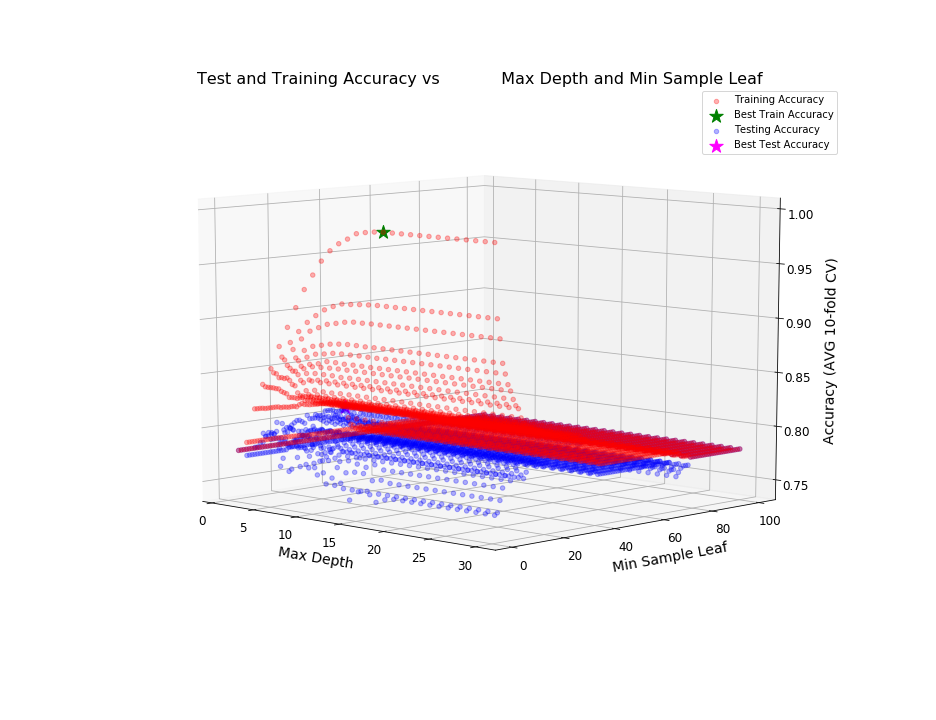

In [163]:
# Plot
# Importations (3D and interactive plot)
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d import proj3d
%matplotlib notebook

# Figure size
fig = plt.figure(figsize = (13, 10)) 
ax = fig.add_subplot(111, projection ='3d')

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Prepare data
X2 = [0 for i in range(0, len(MaxDepths) * len(MinSampleLeaf))]
Y2 = [0 for i in range(0, len(MaxDepths) * len(MinSampleLeaf))]
ZTrain2 = [0 for i in range(0, len(MaxDepths) * len(MinSampleLeaf))]
ZTest2 = [0 for i in range(0, len(MaxDepths) * len(MinSampleLeaf))]

aux = 0


for md in range(len(MaxDepths)):
    for ms in range(len(MinSampleLeaf)):
        X2[aux] = MaxDepths[md]
        Y2[aux] = MinSampleLeaf[ms]
        ZTrain2[aux] = AVGAccTrain[ms][md] 
        ZTest2[aux] = AVGAccTest[ms][md]
        aux += 1

# Title and labels
plt.title('Test and Training Accuracy vs \
           Max Depth and Min Sample Leaf',  y = 1.08)
ax.set_xlabel("Max Depth", labelpad = 10)
ax.set_ylabel("Min Sample Leaf", labelpad = 10)
ax.set_zlabel("Accuracy (AVG 10-fold CV)", labelpad = 10)

# Plot
ax.scatter3D(X2, Y2, ZTrain2, c ='r', marker = 'o', 
             label = "Training Accuracy", alpha = 0.3)
ax.scatter3D(BestGlobalMDTrain, BestGlobalMSTrain, 
             BestAVGAccTrain, c = 'g', marker = '*', 
             label = "Best Train Accuracy", s = 200)
ax.scatter3D(X2, Y2, ZTest2, c ='b', marker = 'o', 
             label = "Testing Accuracy", alpha = 0.3)
ax.scatter3D(BestGlobalMDTest, BestGlobalMSTest,
             BestAVGAccTest, c = '#ff00ff', marker = '*', 
             label = "Best Test Accuracy", s = 200)

#plt.grid()
plt.legend()
plt.show()


<IPython.core.display.Javascript object>


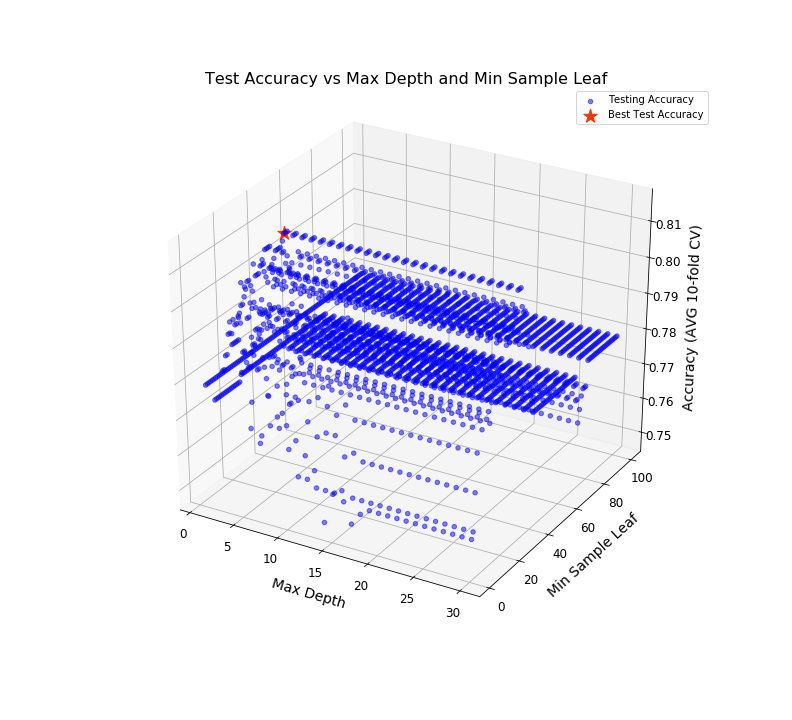

In [164]:
# Plot (only Testing)
# Figure size
fig = plt.figure(figsize = (11, 10)) 
ax = fig.add_subplot(111, projection ='3d')

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Title and labels
plt.title('Test Accuracy vs Max Depth and Min Sample Leaf', 
          y = 1.08)
ax.set_xlabel("Max Depth", labelpad = 10)
ax.set_ylabel("Min Sample Leaf", labelpad = 10)
ax.set_zlabel("Accuracy (AVG 10-fold CV)", labelpad = 10)

# Plot
ax.scatter3D(X2, Y2, ZTest2, c ='b', marker = 'o',
             label = "Testing Accuracy", alpha = 0.5)
ax.scatter3D(BestGlobalMDTest, BestGlobalMSTest,
             BestAVGAccTest, c = '#ff3300', marker = '*', 
             label = "Best Test Accuracy", s = 200)

#plt.grid()
plt.legend()
plt.show()


<IPython.core.display.Javascript object>


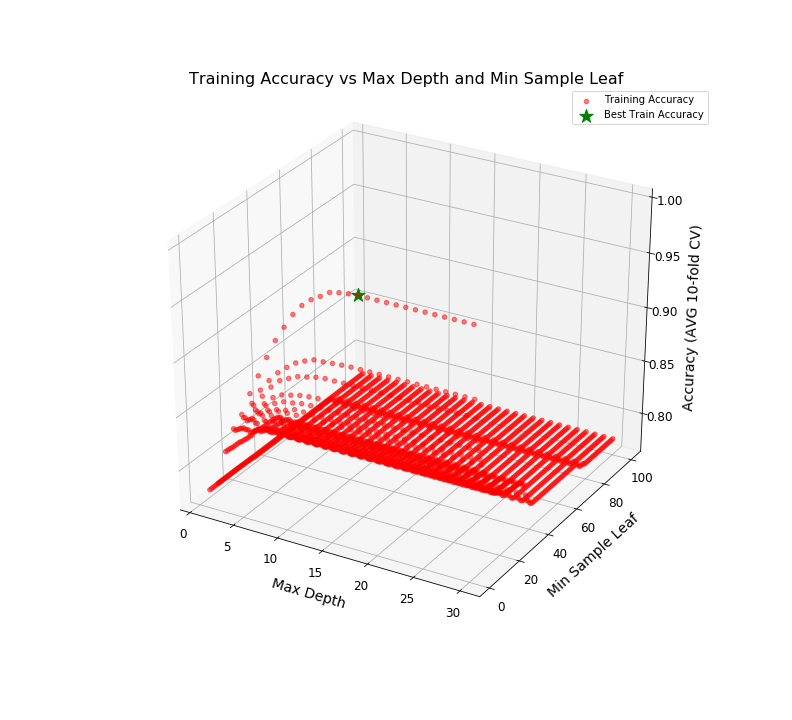

In [166]:
# Plot (only Training)
# Figure size
fig = plt.figure(figsize = (11, 10)) 
ax = fig.add_subplot(111, projection ='3d')

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# Title and labels
plt.title('Training Accuracy vs Max Depth and Min Sample Leaf', 
          y = 1.08)
ax.set_xlabel("Max Depth", labelpad = 10)
ax.set_ylabel("Min Sample Leaf", labelpad = 10)
ax.set_zlabel("Accuracy (AVG 10-fold CV)", labelpad = 10)

# Plot
ax.scatter3D(X2, Y2, ZTrain2, c ='r', marker = 'o',
             label = "Training Accuracy", alpha = 0.5)
ax.scatter3D(BestGlobalMDTrain, BestGlobalMSTrain,
             BestAVGAccTrain, c = 'g', marker = '*', 
             label = "Best Train Accuracy", s = 200)

#plt.grid()
plt.legend()
plt.show()

## Observations

### First, show how max_depth affects train and test accuracy. On a single axis, plot train and test accuracy as a function of max_depth. Use a red line to show test accuracy and a blue line to show train accuracy.

The max depth vs train and test accuracy plot can be seen in the previous code section.
For the 3D graphs, please check the interactive plots above. By default, they are static plots but if the code is re-run they will be interactive plots where the user can perform operations such as rotations, zooms, etc.

Based on the Max Depth parameter vs train and test accuracy plot, we can clearly identify the following patterns:
- Train Accuracy: adding more and more layers (increasing the max depth parameter) to the decision tree will positively impact the accuracy within the training set because the model will include more and more possibilities, ending up with a clear and explicit overfitting with regarding the training data. This pattern can be easily seen in the plot where we can observe an increasing curve for the training accuracy, reaching a maximum (steady-state) when the max depth parameter is equal to 18 (Accuracy = 99.2%). After that threshold, there is no improvement in the training set accuracy due to the fact that the model cannot improve its predictive power just by adding extra layers.

- Testing Accuracy: As expected, increasing the value of the max depth parameter will have a negative impact on the testing accuracy because of the overfitting effect experienced by the model to the training dataset. Thus, we can clearly see how there is a decreasing trend in this curve. Looking at the optimal value of the maximum depth of the tree for the testing accuracy, we can see that a maximum depth of 5 layers is the optimal one in terms of testing accuracy (81.4%).

As a summary, we have the following table:

| Set      | Best Accuracy [%] | Best Max Depth | 
|----------|-------------------|----------------|
| Training |              99.2 |             18 |
|  Testing |              81.4 |              4 |


### What combination of max_depth and min-samples_leaf achieves the highest accuracy? How sensitive are the results to these two parameters?

Based on the generated plots for both datasets, the best combinations obtained for the training and testing sets, and the highest accuracies reached are:

| Set      | Best Accuracy [%] | Best Max Depth | Best Min Sample Leaf |
|----------|-------------------|----------------|----------------------|
| Training |              99.2 |             18 |                    1 |
|  Testing |              81.4 |              5 |                    29|

|                Model               | Training Accuracy [%] | Testing Accuracy [%] |
|------------------------------------|-----------------------|----------------------|
| Decision tree - testing optimized  | 81.637                |  81.403              |
| Decision tree - training optimized | 99.200                |  75.438              |

We can clearly see that the maximum depth of the tree is a critical parameter for the final accuracy of the model when applying it to both the testing and training sets. As we already discussed in previous sections, it is important to understand that adding more layers to the model will clearly increase its accuracy with regarding the training set, incurring in an explicit overfitting of the model to that particular dataset. Therefore, the model loses generalization and prediction accuracy for observations outside of the training dataset and thus, it is no longer useful for out of the sample predictions. This can be clearly seen in the previous table, where the optimal value of the maximum depth parameter for the Testing set is $6$, while it is equal to $20$ when the model is applied to the training set, being consistent with our initial thoughts.

On the other hand, we can see that the optimal number for the minimum sample leaf parameter is larger in the case of the testing set accuracy ($29$ vs $1$) because increasing this value will help the model to be more general in terms of the classification, allowing it to reach better accuracy in out-of-the-sample observations.

Regarding the sensitivity of the results (Accuracy) to these two parameters, we can see that (based on the previous plots) there exist a significant variation in terms of the model performance depending on the combination of these two parameters. As an example, we can see in the plots above how in the case of the training error the accuracy of the model can vary from (approx.) $75$ to $99.5$, and from $75$ to $82$ in the testing set case.

Increasing the maximum depth of the tree tends to increase the accuracy of the training set and decrease the accuracy of the testing set while increasing the minimum sample leaf value tends to have the opposite effect. This can be clearly seen in the previous plots. As an example, the training set accuracy falls below 80% when the minimum sample leaf parameter is around 100 no matter the value of the maximum depth of the tree. On the other hand, higher accuracy levels can be achieved when the maximum depth of the tree is increased alongside with a low value for the minimum sample leaf. The opposite effect can be seen in the testing set.

Thus, we can easily conclude that one of the most important steps when fitting prediction/classification models to our data containing a series of hyper-parameters consists of the optimization of these parameters by performing a formal cross-validation approach when training the model to the available data.

In [167]:
# 10-fold Model: Own Cross-Validation method
# Random seed: reproducibility
np.random.seed(1)

# Data
X = Xtrain
y = Ytrain

# K-folds value
k = 10

# Intercept and feature coefficients
Results = [0 for i in range(0, k)]

# Accuracy 
AccTrain = [0 for i in range(0, k)]
AccTest = [0 for i in range(0, k)]
BestAccTest = 0
BestIter = 0
BestCoeff = []

# Niters
niters = 0

# Intercept
Intercept = False

# CV loop
kf = KFold(n_folds = k, n = len(X), shuffle = True)

# Generate the sets
for train_index, test_index in kf:
    # Iteration number
    print("------------------------- Iteration", niters + 1, "-------------------------")
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Calling the function
    LogitReg = LogisticRegression(fit_intercept = Intercept)
    LogitReg = LogitReg.fit(X_train, y_train)
    
    # Computing Accuracy
    # Training Accuracy value
    AccTrain[niters] = LogitReg.score(X = X_train, y = y_train) 
        
    # Testing Accuracy value
    AccTest[niters] = LogitReg.score(X = X_test, y = y_test) 
        
    # Best RMSE
    if AccTest[niters] > BestAccTest:
        BestAccTest = AccTest[niters]
        print("BestAccTest", BestAccTest)
        BestIter = niters
        BestCoeff = LogitReg.coef_[0]
    
    # Print results
    print("Iteration Results")
    print("-------------------- Accuracy --------------------")
    print("Training set:", AccTrain[niters])
    print("Testing set:", AccTest[niters])
    print("--------------------------------------------------")
    
    # Next iteration
    niters += 1
    
# Summary results
print("\n\nSummary 10-fold Cross-validation")
print("---------------------------------------")
print("Average Accuracy training:", np.mean(AccTrain))
print("Average Accuracy testing:", np.mean(AccTest))
print("Best Accuracy (test):", BestAccTest, "on iteration", BestIter + 1)
print("Coefficients of features best accuracy (test):\n", BestCoeff)
print("---------------------------------------")

------------------------- Iteration 1 -------------------------
BestAccTest 0.771929824561
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.771929824561
--------------------------------------------------
------------------------- Iteration 2 -------------------------
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.719298245614
--------------------------------------------------
------------------------- Iteration 3 -------------------------
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.719298245614
--------------------------------------------------
------------------------- Iteration 4 -------------------------
BestAccTest 0.80701754386
Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.80701754386
-----------------------------------

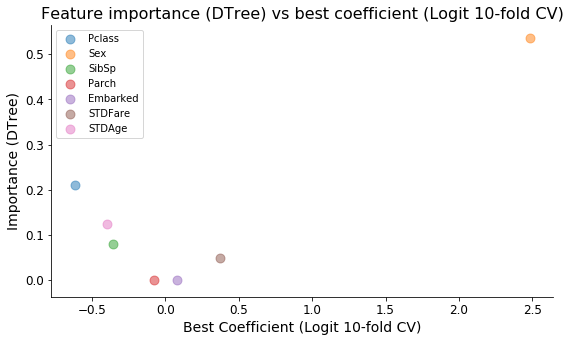

In [169]:
# Scatter plot
# Figure size
%matplotlib inline
fig = plt.figure(figsize = (9, 5)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Title and labels
plt.title('Feature importance (DTree) vs best coefficient (Logit 10-fold CV)')
ax.set_xlabel("Best Coefficient (Logit 10-fold CV)")
ax.set_ylabel("Importance (DTree)")

# Plot
for i in range(0, len(BestCoeff)):
    ax.scatter(BestCoeff[i], FeatImp[i], marker = 'o', 
               s = 80, label = Label[i], alpha = 0.5)

plt.legend()
plt.show()

## Observations
### How does the performance of this model compare to the decision tree?

Based on the previous results, we can construct the following table:

| Model                                  | AVG Training Accuracy [%] | AVG Testing Accuracy [%] |
|----------------------------------------|---------------------------|--------------------------|
| Decision Tree (default)                | 99.200                    |  75.900                  |
| Decision tree - testing optimized      | 81.637                    |  81.403                  |
| Decision tree - training optimized     | 99.200                    |  75.438                  |
| Logistic Regression                    | 78.849                    |  77.894                  |

Looking at the table, we can easily check how the training set accuracy is far better in any of the Decision Tree implementations, reaching values above 81% across all of them while the Logistic regression model is not able to obtain values above 80%. On the other hand, we can see that the testing set accuracy for the Logistic regression model ($77.894$%) is the second best among all the previous Decision tree implementations. In particular, we can clearly see that it is only outperformed by the testing optimized version of the Decision tree ($81.403$%), using the specific values obtained in the previous sections for the maximum depth and minimum sample leaf parameters.

Therefore, we can clearly see one of the disadvantages of the decision tree models: they usually tend to overfit the training data, leading to less general (and less accurate) prediction models in comparison to other machine learning algorithms such as the simple Logistic regression, where without any optimization (no hyperparameters are included), we are able to obtain better results than the vanilla implementation of the decision tree models.

### How do the coefficients from the logistic regression compare to the feature importances from the decision tree? Create a scatter plot that shows this relationship.

Based on the results obtained, we have the following summary table:

|  Feature | Coefficients (10-fold CV Logistic Regression) | Importance (Decision Tree, default) | Importance (Decision Tree, MD = 4) |
|:--------:|:-----------------------------------:|:---------------------------------:||:---------------------------------:|
|   Pclass |           -0.61310009             |    0.12404813 | 0.21065078 |
|      Sex |           2.48608347              |    0.29552792 | 0.53693227|
|    SibSp |           -0.35759181              |   0.03488653 | 0.07986180|
|    Parch |           -0.07422253              |   0.00742530 | 0.00000000|
| Embarked |          0.08314321             |   0.01910331 | 0.00000000|
|  STDFare |           0.37035266             |  0.20772417 | 0.04948637|
|   STDAge |          -0.39593216              |   0.31128464 | 0.12306878|

Looking at the previous results we can clearly see the following patterns:

- $Sex$: The most relevant variable among all the models based on its importance (Decision trees) and the coefficient obtained after the Logistic Regression. As expected, it is one of the most relevant variables when predicting the chances of surviving the Titanic accident. It is by far the most relevant variable in terms of magnitude for the Logistic regression and also the most important one in the vanilla and optimized (testing) implementation of the Decision tree models.

- $Pclass$: The second most important variable in the Logistic regression and the optimized Decision tree models. As discussed at the beginning of the current problem set, it will have an important predictive relevance inside the models due to its strong correlation with the label and $Fare$ feature. Important is to notice how its importance changed in the Decision tree model before and after the Hyperparameters optimization, from 0.124 to 0.210. In addition, seems like the $Pclass$ feature importance includes the effect of the $STDFare$ feature in the optimized decision tree, decreasing the importance of the fare paid by the passengers to a not relevant amount.

- $STDAge$: Age (standardized) is the third more relevant feature in the Logistic regression and optimized decision tree models. As discussed in previous sections, its predictive power was not as explicit as the previous features when performing the preliminary exploratory analysis, however, it is a very relevant feature of the tested models. Notice how in the vanilla implementation of the decision tree model, the differences in features importance are not as strong as in the optimized version. 

- $SibSP$: Interesting is to see how this feature emerges as a relevant one (in terms of magnitude) for the Logistic regression model while its importance is not significant for both decision tree implementations. However, in all models, we can see that it is the third worst variable in terms of importance.

- $Parch$ and $Embarked$: As with the decision tree models, the relevance in terms of magnitude for the Logistic regression for these two features is irrelevant (not significant), sharing the same order of magnitude between the coefficient of the regression and the importance computed for the decision tree models.

All these relationships can be easily seen in the scatter plot above where important variables for the Logistic Regression will tend to be on the right side of the plot and important features for the Decision trees will tend to be on the top of the graph. At the same time, the scatter plot allows us to contrast the magnitude/relevance of each feature inside each model. Equal importance magnitude will be identified by dots in the diagonal of the previous scatter plot, indicating that the values are exactly the same in both axes.

## Part 3: Putting together the pieces 

Over the past two months, you have learned the nuts and bolts of a large number of machine learning algorithms. This list includes: 
* Linear Regression
* Logistic Regression
* LASSO / Ridge Regression
* Support Vector Machines
* Nearest Neighbor
* k-Nearest Neighbors
* Naive Bayes
* Decision Trees
* Regression Trees
* Random Forests
* Boosted trees
* Perceptrons
* Neural Networks

Here, you will explore how well different algorithms can predict survival on the Titanic.


### 3.1 Horseraces

In addition to logistic regression and the single decision tree, use the following algorithms to predict survival: LASSO regression, k-Nearest Neighbors, [random forest](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html), a [multi-layer perceptron](http://scikit-learn.org/stable/modules/neural_networks_supervised.html) and [Gradient Boosting](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html). Make sure everything you do is carefully cross-validated, and that you are providing the same data to each algorithm, in a sensible way.

Create a barplot that shows how well each algorithm compares relative to the others, separately for the training and testing datsets. Define "performance" in the way you think is most appropriate for this problem, and justify that decision. What algorithm performs best?

*Note:* You might want to consider more than one measures of performance

In [170]:
# Optimizing models: 10-fold CV and hyperparameters loops
# LASSO regression: Small Test with full Dataset
# Data
X = Xtrain
Y = Ytrain

# Regression with fixed Lambda (alpha)
clf = Lasso(alpha = 0.01, fit_intercept = False, random_state = 0)
clf = clf.fit(X, Y)

# Predictions and Binarization with 0.5 as threshold
y_hat = clf.predict(X)
y_hat[y_hat > 0.5] = 1
y_hat[y_hat <= 0.5] = 0

# Display accuracy
print("Accuracy (Small test):", np.round((y_hat == Y).sum().astype(float) / len(Y), 3))


# CV function
k = 10
Lambdas = np.arange(0.001, 1.001, 0.001)
TuningParams = [Lambdas]
Model = "Lasso"

# Call the function
ResultsLasso = CVKFold(k, X, Y, Model, TuningParams)

Accuracy (Small test): 0.781
----------------------- Hyper-Param = 0.001 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.789473684211
----------------------

-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.775828460039
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7

Training set: 0.779727095517
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.775828460039
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.014
---------------------------------------
Average Accuracy training: 0.780701754386
Average Accuracy testing: 0.780701754386
Best Accuracy (test

Training set: 0.775828460039
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.775828460039
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.719298245614
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.719298245614
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.036
---------------------------------------
Average Accuracy training: 0.780506822612
Average Accuracy testing: 0.780701754386
Best Accuracy (test): 0.859649122807 on iteration 9
Importance of features best accuracy (test):
 [ 0.03374991  0.47613495 -0.          0.          0.0582891   0.08145516
 -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.037 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------

--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.762183235867
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.769980506823
Testing set: 0.771929824561
--------------------------------------------------
-----------------

-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.766081871345
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.769980506823
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7

------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.74269005848
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.729044834308
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.736842105263
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.732943469786
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Res

Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.711500974659
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.736842105263
Testing set: 0.649122807018
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.083
---------------------------------------
Average Accuracy training: 0.715789473684
Average Accuracy testing: 0.708771929825
Best Accuracy (test): 0.80701754386 on iteration 9
Importance of features best accuracy (test):
 [ 0.04987923  0.3391045   0.          0.          0.04682078  0.05726759
 -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.084 ------------

----------------------- Hyper-Param = 0.094 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.697855750487
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.719298245614
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.621832358674
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.651072124756
Testing set: 0.631578947368
--------------------------------------------------


----------------------- Hyper-Param = 0.106 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592592592593
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.592592592593
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.578947368421
--------------------------------------------------


-------------------- Accuracy --------------------
Training set: 0.567251461988
Testing set: 0.578947368421
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.606237816764
Testing set: 0.526315789474
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.578947368421
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.58

Training set: 0.592592592593
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.590643274854
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.13
---------------------------------------
Average Accuracy training: 0.587329434698
Average Accuracy testing: 0.584210526316
Best Accuracy (test): 0.666666666667 on iteration 1
Importance of features best accuracy (test):
 [ 0.06316859  0.22114008  0.          0.          0.03944361  0.04091537
 -0.        ]
---------------------------------------


----------------------- Hyp

Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.600389863548
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
----------------------------------------

Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.152
---------------------------------------
Average Accuracy training: 0.586354775828
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.08032835  0.17421395  0.          0.          0.01870528  0.01667603
 -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.153 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.578947368421
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
---------

Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
----------------------------------------

Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.177
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.08786531  0.10214262  0.          0.          0.0137877   0.00149376
 -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.178 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------

Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.188
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration

Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
-----------

------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.212
------------------

Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
-----------

Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.237
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.10007521  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.238 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
----------

-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5

------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Re

Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.272
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.09390934  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.273 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
---------------------------------------

--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
-----------------

------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.297
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.08950515  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.298 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration R

Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.309
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.08739114  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.31 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
-----------

Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.08562946  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.32 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
--------

Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
----------------------------------------

-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.344
---------------------------------------
Average Accuracy training: 0.585964912281
Average Ac

Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
-----------

Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
-----------------------------------------

Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
-----------

------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.391
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.0729454  0.         0.         0.         0.         0.        -0.       ]
---------------------------------------


----------------------- Hyper-Param = 0.392 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Re

------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.416
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.06854121  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.417 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration R

Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
-----------

------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.438
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.06466552  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.439 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration R

Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.45
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.06255151  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hype

-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5

 [ 0.05867582  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.473 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy 

------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Re

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Re

Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
-----------

Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.519
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.05039595  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.52 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
-----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.528
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.04881044  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.529 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy ----------------

------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Re

Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.04440625  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.554 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
-------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
----------------------------------------

Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
----------------------------------------

------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.6
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.03612637  0.          0.    

------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.612
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.03401236  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.613 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration R

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.622
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.03225069  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.623 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy ----------------

Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
-----------

Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
----------------------------------------

-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5

Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.02397081  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.67 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

Summary 10-fold Cross-validation, Param = 0.694
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.01956662  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.695 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Res

Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
-----------

Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.01569093  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.717 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Tes

-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.728
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.01357692  0.          0.          0.          0.          0.         -0.        ]
------------------

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Re

Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.00970124  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.751 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
-------

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Re

-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5

Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.788
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.00300687  0.          0.          0.          0.          0.         -0.        ]
---------------------------------------


----------------------- Hyper-Param = 0.789 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
---------------------------------------

--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.8
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best

------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.81
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
-

Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
-----------

Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.835
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.836 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ----------

------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Re

------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Re

Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
----------------------------------------

Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.883 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iterati

Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.895
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.896 -----------------------
------------------ CV Iteration 1 ----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.92
-------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.943 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iterati

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Re

------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.967
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.968 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

Training set: 0.584795321637
Testing set: 0.59649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.586744639376
Testing set: 0.578947368421
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 0.976
---------------------------------------
Average Accuracy training: 0.585964912281
Average Accuracy testing: 0.585964912281
Best Accuracy (test): 0.684210526316 on iteration 2
Importance of features best accuracy (test):
 [ 0.  0.  0.  0.  0.  0. -0.]
---------------------------------------


----------------------- Hyper-Param = 0.977 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
---------------

-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.5

In [171]:
# k-Nearest Neighbors
# Small Test
clf = KNeighborsClassifier(n_neighbors = 10, p = 2)
clf = clf.fit(X, Y)
print("Accuracy example:", clf.score(X, Y) , "\n\n")

# CV parameters
k = 10
Ks = np.arange(1, 31, 1)
ps = np.arange(1, 11, 1)
Model = "Knn"

# Results array and aux variables
ResultsKnn = [0 for i in range(0, len(ps))]
GlobalBestTrain = 0
GlobalBestTest = 0
BestKPTrain = 0
BestKPTest = 0

# Call the function (outer loop for L/p value)
for p in ps:
    print("------------------------------------ Norm L =", p, "------------------------------------")
    TuningParams = [Ks, p]
    ResultsKnn[p - 1] = CVKFold(k, X, Y, Model, TuningParams)
    
    # Global best
    if ResultsKnn[p - 1][2] > GlobalBestTrain:
        BestKPTrain = [ResultsKnn[p - 1][0], p]
        GlobalBestTrain = ResultsKnn[p - 1][2]

    if ResultsKnn[p - 1][3] > GlobalBestTest:
        BestKPTest = [ResultsKnn[p - 1][1], p]
        GlobalBestTest = ResultsKnn[p - 1][3]
        
# Final solution
print("\n\n------------ Final Solution ------------")
print("Best K, L training:", BestKPTrain[0], BestKPTrain[1])
print("Best AVG training Accuracy:", GlobalBestTrain)
print("Best K, L testing:", BestKPTest[0], BestKPTest[1])
print("Best AVG testing Accuracy:", GlobalBestTest)      

Accuracy example: 0.822807017544 


------------------------------------ Norm L = 1 ------------------------------------
----------------------- Hyper-Param = 1 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.988304093567
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -------

Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.771929824561
-----------------------------------------

------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.824561403509
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 7
---------------------------------------
Average Accuracy training: 0.839961013645
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.859649122807 on iteration 8
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 8 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.84015594

-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842105263158
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.894736842105
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.824561403509
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 22
---------------------------------------
Average Accuracy training: 0.824756335283
Average Accuracy testing: 0.810526315789
Best Accuracy (test): 0.894736842105 on iteration 4
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 23 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.789473684211
-------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.988304093567
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.736842105263
---------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 4
---------------------------------------
Average Accuracy training: 0.844639

Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.754385964912
-----------------------------------------

-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training s

-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.894736842105
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.842105263158
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 23
---------------------------------------
Average Accuracy training: 0.815399610136
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.877192982456 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 24

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.842105263158
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 27
---------------------------------------
Average Accuracy training: 0.808771929825
Average Accuracy testing: 0.79649122807
Best Accuracy (test): 0.894736842105 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 28 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.988304093567
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------


CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842105263158
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 4
---------------------------------------
Average Accuracy training: 0.843469785575
Average Accuracy testing: 0.782456140351
Best Accuracy (test): 0.824561403509 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 5 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.789473684211
---------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ----------------

-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 11
---------------------------------------
Average Accuracy training: 0.820272904483
Aver

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.842105263158
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 18
---------------------------------------
Average Accuracy training: 0.808382066277
Average Accuracy testing: 0.79298245614
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 19 -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.842105263158
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 21
---------------------------------------
Average Accuracy training: 0.811111111111
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.894736842105 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 22 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.789473684211
------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.894736842105
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy ----------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy ----------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 5
---------------------------------------
Average Accuracy training: 0.849122807018
Average Accuracy testing: 0.780701754386
Best Accuracy (test): 0.842105263158 on iteration 8
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Para

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy ----------

Training set: 0.814814814815
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.80701754386
-------------

-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 15
---------------------------------------
Average Accuracy training: 0.805458089669
Average Accuracy testing: 0.782456140351
Best Accuracy (test): 0.824561403509 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 16 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.771929824561
------------------------------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 5
---------------------------------------
Average Accuracy training: 0.849317738791
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.824561403509 on iteration 8
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 6 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842105263

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy ----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.824561403509
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 22
---------------------------------------
Average Accuracy training: 0.806432748538
Average Accuracy testing: 0.8
Best Accuracy (test): 0.894736842105 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 23 -----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 25
---------------------------------------
Average Accuracy training: 0.801169590643
Average Accuracy testing: 0.782456140351
Best Accuracy (test): 0.877192982456 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 26 -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.842105263158
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 28
---------------------------------------
Average Accuracy training: 0.797076023392
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 29

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879142300195
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accu

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 9
---------------------------------------
Average Accuracy training:

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 12
---------------------------------------
Average Accuracy training: 0.820467836257
Average Accuracy testing: 0.782456140351
Best Accuracy (test): 0.824561403509 on iteration 8
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 13 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.789473684211
---------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy ----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.824561403509
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 19
---------------------------------------
Average Accuracy training: 0.807407407407
Average Accuracy testing: 0.784210526316
Best Accuracy (test): 0.877192982456 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 20 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.771929824561
--------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Acc

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 5
---------------------------------------
Average Accuracy training: 0.849122807018
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.824561403509 on iteration 8
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Para

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.824561403509
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 19
---------------------------------------
Average Accuracy training: 0.8068

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.824561403509
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 22
---------------------------------------
Average Accuracy training: 0.804873294347
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.894736842105 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 23 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.754385964912
--------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 25
---------------------------------------
Average Accuracy training: 0.799805068226
Average Accuracy testing: 0.785964912281
Best Accuracy (test): 0.894736842105 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 26 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.736842105263
---------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.842105263158
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 28
---------------------------------------
Average Accuracy training: 0.796296296296
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 29 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.736842105263
-------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.881091617934
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875243664717
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -----------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------

Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.842105263158
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 22
---------------------------------------
Average Accuracy training: 0.804483430799
Average Accuracy testing: 0.801754385965
Best Accuracy (test): 0.894736842105 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 23 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Res

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 25
---------------------------------------
Average Accuracy training: 0.799025341131
Average Accuracy testing: 0.782456140351
Best Accuracy (test): 0.894736842105 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 26 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.736842105263
--------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.842105263158
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 28
---------------------------------------
Average Accuracy training: 0.79649122807
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 29 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.736842105263
--------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.883040935673
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.877192982456
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875243664717
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------

-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.842105263158
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 22
---------------------------------------
Average Accuracy training: 0.803703703704
Average Accuracy testing: 0.801754385965
Best Accuracy (test): 0.894736842105 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = 23 -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.754385964912
-----------------------------------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

-------------------- Accuracy --------------------
Training set: 0.875243664717
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 5
---------------------------------------
Average Accuracy training: 0.848538011696
Average Accuracy testing: 0.777192982456
Best Accuracy (test): 0.824561403509 on iteration 8
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Para

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy -------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.824561403509
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 19
---------------------------------------
Average Accuracy training: 0.8066

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

In [172]:
# Random Forest
# Small Test
clf = RandomForestClassifier(max_depth = 3, 
                             min_samples_leaf = 10,  
                             n_estimators = 100,     
                             random_state = 0)
clf = clf.fit(X, Y)
print("Accuracy example:", clf.score(X, Y) , "\n\n")

# CV function
k = 10
MaxDepth = np.arange(1, 31, 1)
Model = "RForest"
nEstimators = np.arange(100, 160, 10)
mslList = np.arange(1, 10, 5)

# Results array and aux variables
ResultsRForest = [[0 for j in range(0, len(nEstimators))] for i in range(0, len(mslList))]
GlobalBestTrain = 0
GlobalBestTest = 0
BestMD_MS_NEST_Train = 0
BestMD_MS_NEST_Test = 0

aux0 = 0
aux1 = 0


# Call the function
for msl in mslList:
    aux1 = 0
    
    for nEst in nEstimators:
        print("---------------- Min Sample Leaf =", msl, "N-Estimators =", nEst, "----------------")
        TuningParameters = [MaxDepth, msl, nEst]
        ResultsRForest[aux0][aux1] = CVKFold(k, X, Y, Model, TuningParameters)
        
        # Global best
        if ResultsRForest[aux0][aux1][2] > GlobalBestTrain:
            BestMD_MS_NEST_Train = [ResultsRForest[aux0][aux1][0], msl, nEst]
            GlobalBestTrain = ResultsRForest[aux0][aux1][2]

        if ResultsRForest[aux0][aux1][3] > GlobalBestTest:
            BestMD_MS_NEST_Test = [ResultsRForest[aux0][aux1][1], msl, nEst]
            GlobalBestTest = ResultsRForest[aux0][aux1][3]
        
        aux1 += 1
        
    aux0 += 1
    
# Final solution
print("\n\n------------ Final Solution ------------")
print("Best MD, MSL, nEst training:", BestMD_MS_NEST_Train[0], 
      BestMD_MS_NEST_Train[1], BestMD_MS_NEST_Train[2])
print("Best AVG training Accuracy:", GlobalBestTrain)
print("Best MD, MSL, nEst testing:", BestMD_MS_NEST_Test[0], 
      BestMD_MS_NEST_Test[1], BestMD_MS_NEST_Test[2])
print("Best AVG testing Accuracy:", GlobalBestTest)     

Accuracy example: 0.817543859649 


---------------- Min Sample Leaf = 1 N-Estimators = 100 ----------------
----------------------- Hyper-Param = 1 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Train

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.927875243665
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.918128654971
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.908382066277
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.914230019493
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.961013645224
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.953216374269
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Res

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98440545809
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.976608187135
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.974658869396
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Res

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
------

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iterat

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Resul

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Re

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.923976608187
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.918128654971
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.908382066277
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.910331384016
Testing set: 0.789473684211
--------------------------------------------------
-----------------

Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.957115009747
Testing set: 0.754385964912
----------------------------------------

Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.976608187135
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.978557504873
Testing set: 0.771929824561
----------------------------------------

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iterati

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iterat

Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------


------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-----

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iterat

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.775828460039
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Res

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Re

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.923976608187
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.916179337232
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.910331384016
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.912280701754
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Re

Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.957115009747
Testing set: 0.736842105263
----------------------------------------

Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.978557504873
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.789473684211
-----------------------------------------

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iterati

Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------


Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------


--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iterat

Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------


--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.769980506823
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.824561403509
--------------------------------------------------
------------------

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.754385964912
--------------------------------------------------
-----------------

--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.923976608187
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.914230019493
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.912280701754
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.914230019493
Testing set: 0.789473684211
--------------------------------------------------
-----------------

Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.964912280702
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.966861598441
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.959064327485
Testing set: 0.736842105263
----------------------------------------

Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.982456140351
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.789473684211
----------------------------------------

Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.754385964912
--------------------------------------------------


--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iterati

Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
-

Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
-

Training set: 0.992202729045
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
-----------------------

------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Resu

Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.754385964912
-----------------------------------------

Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.925925925926
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.916179337232
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.912280701754
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.914230019493
Testing set: 0.789473684211
-----------------------------------------

Training set: 0.964912280702
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.964912280702
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.959064327485
Testing set: 0.771929824561
-----------

Training set: 0.98440545809
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.982456140351
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.789473684211
------------

Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
-

Training set: 0.992202729045
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
----------------------

Training set: 0.990253411306
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
----------------------

Training set: 0.990253411306
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
----------------------

Training set: 0.990253411306
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
----------------------

Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.7738791423
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.771929824561
-------------------------------------------

--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.771929824561
--------------------------------------------------
-----------------

Training set: 0.918128654971
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.912280701754
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.918128654971
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.910331384016
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.910331384016
Testing set: 0.842105263158
-----------

-------------------- Accuracy --------------------
Training set: 0.962962962963
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.957115009747
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.957115009747
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.955165692008
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.95

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.980506822612
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.976608187135
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.982456140351
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.771929824561
-----------

-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 22
---------------------------------------
Average Accuracy training: 0.992007797271
Average Accur

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 25
---------------------------------------
Average Accuracy training: 0.992007797271
Average Accuracy testing: 0.801754385965
Best Accuracy (test): 0.842105263158 on iteration 4
Importance of features best accuracy (test):
 [ 0.09273101  0.24534405  0.05219313  0.03848178  0.03308705  0.25450237
  0.28366062

------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 28
---------------------------------------
Average Accuracy training: 0.992007797271
Average Accuracy testing: 0.801754385965
Best Accuracy (test): 0.842105263158 on iteration 4
Importance of features best accuracy (test):
 [ 0.09273101  0.24534405  0.05219313  0.03848178  0.03308705  0.25450237
  0.28366062]
---------------------------------------


----------------------- Hyper-Param = 29 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Resul

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 1
---------------------------------------
Average Accuracy training: 0.786159844055
Average Accuracy testing: 0.778947368421
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.2   0.27  0.09  0.06  0.15  0.15  0.08]
---------------------------------------


--

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 4
---------------------------------------
Average Accuracy training: 0.836647173489
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.842105263158 on iteration 4
Importance of features best accuracy (test):
 [ 0.14911041  0.47985647  0.03482857  0.03491436  0.04214614  0.16117813
  0.09796592]

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 7
---------------------------------------
Average Accuracy training: 0.859844054581
Average Accuracy testing: 0.79649122807
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.14057163  0.44542103  0.04672524  0.02857294  0.03713468  0.16546031
  0.13611417]


CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 10
---------------------------------------
Average Accuracy training: 0.864717348928
Average Accuracy testing: 0.80350877193
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.14139648  0.43900812  0.04394906  0.02855801  0.03670717  0.17323724
  0.13714392]


CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 13
---------------------------------------
Average Accuracy training: 0.864912280702
Average Accuracy testing: 0.8
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13605122  0.4382917   0.04441987  0.02814412  0.03782884  0.17679702
  0.13846724]
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 16
---------------------------------------
Average Accuracy training: 0.864717348928
Average Accuracy testing: 0.8
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13602259  0.43820108  0.04443702  0.02812359  0.03780955  0.17659939
  0.13880678]
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 19
---------------------------------------
Average Accuracy training: 0.864717348928
Average Accuracy testing: 0.8
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13602259  0.43820108  0.04443702  0.02812359  0.03780955  0.17659939
  0.13880678]
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 22
---------------------------------------
Average Accuracy training: 0.864717348928
Average Accuracy testing: 0.8
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13602259  0.43820108  0.04443702  0.02812359  0.03780955  0.17659939
  0.13880678]
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 25
---------------------------------------
Average Accuracy training: 0.864717348928
Average Accuracy testing: 0.8
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13602259  0.43820108  0.04443702  0.02812359  0.03780955  0.17659939
  0.13880678]
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 28
---------------------------------------
Average Accuracy training: 0.864717348928
Average Accuracy testing: 0.8
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13602259  0.43820108  0.04443702  0.02812359  0.03780955  0.17659939
  0.13880678]
----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 1
---------------------------------------
Average Accuracy training: 0.784990253411
Average Accuracy testing: 0.775438596491
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.20909091  0.26363636  0.08181818  0.05454545  0.14545455  0.17272727
  0.07272727]
-

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 4
---------------------------------------
Average Accuracy training: 0.834502923977
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.842105263158 on iteration 4
Importance of features best accuracy (test):
 [ 0.14961338  0.47635984  0.03365352  0.03305191  0.04041802  0.16753578
  0.09936756]


------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 7
---------------------------------------
Average Accuracy training: 0.861013645224
Average Accuracy testing: 0.791228070175
Best Accuracy (test): 0.842105263158 on iteration 4
Importance of features best accuracy (test):
 [ 0.14000453  0.44230992  0.04551

--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 10
---------------------------------------
Average Accuracy training: 0.865692007797
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.842105263158 on iteration 4
Importance of features best

------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 13
---------------------------------------
Average Accuracy training: 0.865886939571
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13616835  0.43667569  0.04311

--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 16
---------------------------------------
Average Accuracy training: 0.866081871345
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best 

------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 19
---------------------------------------
Average Accuracy training: 0.866081871345
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13614233  0.4365933   0.04313

------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 22
---------------------------------------
Average Accuracy training: 0.866081871345
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13614233  0.4365933   0.04313

------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 25
---------------------------------------
Average Accuracy training: 0.866081871345
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13614233  0.4365933   0.04313

------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = 28
---------------------------------------
Average Accuracy training: 0.866081871345
Average Accuracy testing: 0.798245614035
Best Accuracy (test): 0.859649122807 on iteration 4
Importance of features best accuracy (test):
 [ 0.13614233  0.4365933   0.04313

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Re

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Resu

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Res

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration R

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy ----------------

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration R

--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
-----------------

--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
-----------------

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration R

------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration R

------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.769980506823
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Resu

------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836257309942
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834307992203
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836257309942
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Res

--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.824561403509
--------------------------------------------------
-----------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.842105263158
----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.824561403509
----------------------------------------

------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Re

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.824561403509
----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.824561403509
----------------------------------------

--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.824561403509
--------------------------------------------------
-----------------

--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.824561403509
--------------------------------------------------
-----------------

Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.771929824561
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.771929824561
------------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834307992203
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842105263158
Testing set: 0.842105263158
-----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.842105263158
-----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.842105263158
----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.80701754386
-----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.824561403509
----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.824561403509
----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.824561403509
----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.824561403509
----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.824561403509
----------------------------------------

Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.775828460039
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.80701754386
-----------------------------------------

Training set: 0.840155945419
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.754385964912
--------------

-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.865497076023
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.8

Training set: 0.873294346979
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.754385964912
-------------

Training set: 0.87134502924
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.754385964912
-------------

Training set: 0.87134502924
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.754385964912
------------

Training set: 0.87134502924
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.754385964912
------------

Training set: 0.87134502924
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.754385964912
------------

Training set: 0.863547758285
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
-----------

Training set: 0.863547758285
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
-----------

In [173]:
# Multi-layer Perceptron
# Small Test
clf = MLPClassifier(alpha = 1e-4, 
                    learning_rate = 'constant',   
                    activation = 'identity',      
                    hidden_layer_sizes = (100,), 
                    random_state = 0)
clf = clf.fit(X, Y)
print("Accuracy example:", clf.score(X, Y) , "\n\n")

# CV parameters
k = 10
nlayers = 20
HLayers = [0 for i in range(0, nlayers)]
layerC = (100,)
for n in range(0, nlayers):
    HLayers[n] = layerC * (n + 1)    
    
ActivationRules = ["identity", "logistic", "tanh", "relu"]    
LearningRate = ["constant", "invscaling", "adaptive"]
    
Model = "MLPercept"

# Results array and aux variables
ResultsMLP = [[0 for j in range(0, len(LearningRate))] for i in range(0, len(ActivationRules))]
GlobalBestTrain = 0
GlobalBestTest = 0
BestParamMLTrain = 0
BestParamMLTest = 0

aux0 = 0
aux1 = 0

# Call the function
for Act in ActivationRules:
    aux1 = 0
    
    for LR in LearningRate:
        print("---------------- Activation Rule =", Act, "LRate =", LR, "----------------")
        TuningParameters = [HLayers, Act, LR]
        ResultsMLP[aux0][aux1] = CVKFold(k, X, Y, Model, TuningParameters)
        
        # Global best
        if ResultsMLP[aux0][aux1][2] > GlobalBestTrain:
            BestParamMLTrain = [ResultsMLP[aux0][aux1][0], Act, LR]
            GlobalBestTrain = ResultsMLP[aux0][aux1][2]

        if ResultsMLP[aux0][aux1][3] > GlobalBestTest:
            BestParamMLTest = [ResultsMLP[aux0][aux1][1], Act, LR]
            GlobalBestTest = ResultsMLP[aux0][aux1][3]
        
        aux1 += 1
        
    aux0 += 1
    
# Final solution
print("\n\n------------ Final Solution ------------")
print("Best NLayers, ActRule, LR training:", BestParamMLTrain[0], 
      BestParamMLTrain[1], BestParamMLTrain[2])
print("Best AVG training Accuracy:", GlobalBestTrain)
print("Best NLayers, ActRule, LR testing:", BestParamMLTest[0], 
      BestParamMLTest[1], BestParamMLTest[2])
print("Best AVG testing Accuracy:", GlobalBestTest)    

Accuracy example: 0.79649122807 


---------------- Activation Rule = identity LRate = constant ----------------
----------------------- Hyper-Param = (100,) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy -------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.754385964912
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100,)
---------------------------------------
Average Accuracy training: 0.798440545809
Average Accuracy testing: 0.785964912281
Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.719298245614
-------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy ----------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy ----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---------

c:\python36\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:564: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.797270955166
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.795321637427
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ----------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.588693957115
Testing set: 0.561403508772
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.594541910331
Testing set: 0.508771929825
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.793372319688
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836257309942
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ------------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.754385964912
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100,)
---------------------------------------
Average Accuracy training: 0.806627680312
Average Accuracy testing: 0.79649122807
Best Accuracy (test): 0.877192982456 on iteration 9
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.803118908382
Testing set: 0.719298245614
--------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.83469785575
Average Accuracy testing: 0.812280701754
Best Accuracy (test): 0.912280701754 on iteration 9
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.805068226121
Testing 

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.833723196881
Average Accuracy testing: 0.794736842105
Best Accuracy (test): 0.842105263158 on iteration 8
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842105263158
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Train

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.847173489279
Average Accuracy testing: 0.808771929825
Best Accuracy (test): 0.894736842105 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accur

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.842105263158
Average Accuracy testing: 0.814035087719
Best Accuracy (test): 0.877192982456 on iteration 4
Importance of features best accuracy (test):
 []
--------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 8 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.801169590643
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.736842105263
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 10

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 9 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.789473684211
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.808966861598
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.894736842105
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy ---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.82261208577
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.814814814815
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.832358674464
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875243664717
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.892787524366
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.896686159844
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875243664717
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.883040935673
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.888888888889
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879142300195
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.888888888889
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.873294346979
Testing set: 0.894736842105
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Acc

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.884990253411
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836257309942
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Acc

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875243664717
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879142300195
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.894736842105
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842105263158
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834307992203
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.830409356725
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.898635477583
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.890838206628
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.912280701754
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.898635477583
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy ---------

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.884990253411
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.849902534113
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy -

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.83820662768
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.881091617934
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ------------------
Nothing
CV Iteration Results
-------------------- Accu

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.855750487329
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.890838206628
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Ac

Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.888888888889
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.859649122807
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.884990253411
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.844054580897
Testing set: 0.894736842105
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.836257309942
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100,)
---------------------------------------
Average Accuracy training: 0.838986354776
Average Accuracy testing: 0.80350877193
Best Accuracy (test): 0.877192982456 on iteration 8
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.883040935673
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.87134502924
Testing set: 0.754385964912
---------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.875243664717
Testing set: 0.736842105263
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.891812865497
Average Accuracy testing: 0.79649122807
Best Accuracy (test): 0.912280701754 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.884990253411
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.892787524366
Testing

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.869395711501
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.859844054581
Average Accuracy testing: 0.805263157895
Best Accuracy (test): 0.859649122807 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.881091617934
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Train

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.879142300195
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.80701754386
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.866081871345
Average Accuracy testing: 0.79298245614
Best Accuracy (test): 0.842105263158 on iteration 6
Importance of features best accuracy (test):
 []
---------------------------------------


----------------------- Hyper-Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100) -----------------------
------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accura

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.789473684211
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100)
---------------------------------------
Average Accuracy training: 0.859649122807
Average Accuracy testing: 0.805263157895
Best Accuracy (test): 0.859649122807 on iteration 7
Importance of features best accuracy (test):
 []
--------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.890838206628
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 10 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.771929824561
--------------------------------------------------


Summary 10-fold Cross-validation, Param = (100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 1

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.867446393762
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.812865497076
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.857699805068
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 9 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

In [174]:
# Gradient Boosting
# Small Test
clf = GradientBoostingClassifier(learning_rate = 0.01, 
                                 n_estimators = 100,
                                 max_depth = 3, 
                                 min_samples_leaf = 1,
                                 random_state = 0)
clf = clf.fit(X, Y)
print("Accuracy example:", clf.score(X, Y) , "\n\n")

# CV parameters
k = 10
nEstimators = np.arange(100, 500, 100)
MaxDepth = [1, 10, 100, 500]
LearningRate = [0.001, 0.01, 0.1, 1]
    
Model = "GradientB"

# Results array and aux variables
ResultsGBoost = [[0 for j in range(0, len(LearningRate))] for i in range(0, len(MaxDepth))]
GlobalBestTrain = 0
GlobalBestTest = 0
BestParamGBTrain = 0
BestParamGBTest = 0

aux0 = 0
aux1 = 0

# Call the function
for md in MaxDepth:
    aux1 = 0
    
    for LR in LearningRate:
        print("---------------- Max Depth =", md, "LRate =", LR, "----------------")
        TuningParameters = [nEstimators, md, LR]
        ResultsGBoost[aux0][aux1] = CVKFold(k, X, Y, Model, TuningParameters)
        
        # Global best
        if ResultsGBoost[aux0][aux1][2] > GlobalBestTrain:
            BestParamGBTrain = [ResultsGBoost[aux0][aux1][0], md, LR]
            GlobalBestTrain = ResultsGBoost[aux0][aux1][2]

        if ResultsGBoost[aux0][aux1][3] > GlobalBestTest:
            BestParamGBTest = [ResultsGBoost[aux0][aux1][1], md, LR]
            GlobalBestTest = ResultsGBoost[aux0][aux1][3]
        
        aux1 += 1
        
    aux0 += 1
    
# Final solution
print("\n\n------------ Final Solution ------------")
print("Best nEstim, MaxDepth, LR training:", BestParamGBTrain[0], 
      BestParamGBTrain[1], BestParamGBTrain[2])
print("Best AVG training Accuracy:", GlobalBestTrain)
print("Best nEstim, MaxDepth, LR testing:", BestParamGBTest[0], 
      BestParamGBTest[1], BestParamGBTest[2])
print("Best AVG testing Accuracy:", GlobalBestTest)    

Accuracy example: 0.836842105263 


---------------- Max Depth = 1 LRate = 0.001 ----------------
----------------------- Hyper-Param = 100 -----------------------
------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.783625730994
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.777777777778
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.779727095517
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.818713450292
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.824561403509
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.810916179337
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.863547758285
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.894736842105
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.898635477583
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.894736842105
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.888888888889
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.883040935673
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 8 ------------------
CV Iteration Results
-------------------- Accuracy ------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.953216374269
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.955165692008
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.961013645224
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 6 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.939571150097
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 7 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98440545809
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.986354775828
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.98440545809
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -------------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.859649122807
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.576998050682
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.575048732943
Testing set: 0.684210526316
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.598440545809
Testing set: 0.473684210526
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.582846003899
Testing set: 0.614035087719
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy -----------------

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.666666666667
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Trainin

CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.992202729045
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 1.0
Testing set: 0.701754385965
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.990253411306
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training

In [188]:
## Optimal models
# Missing values Test: replace by mean values (0 standardized)
XTestStdNan = XTestStdNan.replace(np.nan, 0)

# Check no missing values
XTestStdNan.isnull().sum()

# Decision Tree
# Optimal Parameters
MaxDepth = 5
MinSampleLeaf = 29

# CV-10fold
k = 10
Params = [MaxDepth, MinSampleLeaf]
RTree = CVKFold_Opt(k, X, Y, "Tree", Params) 

# Predictions
y_hat_tree_train = RTree[4].predict(X)
y_hat_tree_test = RTree[4].predict(Xtest)
y_hat_tree_test2 = RTree[4].predict(XTestStdNan)

# Score 
print("Accuracy train set:", RTree[4].score(X, Y))
print("Accuracy test set (remaining 20%):", RTree[4].score(Xtest, Ytest))

# Testing Kaggle File
createKaggleFile(y_hat_tree_test2, "TreeOpt2")

------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.80701754386
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.816764132554
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Resu

In [189]:
# Logistic Regression
# CV-10fold
k = 10
Params = []
RLogit = CVKFold_Opt(k, X, Y, "Logit", Params) 

# Predictions
y_hat_Logit_train = RLogit[4].predict(X)
y_hat_Logit_test = RLogit[4].predict(Xtest)
y_hat_Logit_test2 = RLogit[4].predict(XTestStdNan)

# Score 
print("Accuracy full train set:", RLogit[4].score(X, Y))
print("Accuracy test set (remaining 20%):", RLogit[4].score(Xtest, Ytest))

# Testing Kaggle File
createKaggleFile(y_hat_Logit_test2, "LogitOpt2")

------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.791423001949
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.799220272904
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.80701754386
--------------------------------------------------
------------------ CV Iteration 5 ---

In [190]:
# Lasso
# Optimal Parameters
Lambda = 0.038

# CV-10fold
k = 10
Params = [Lambda]
RLasso = CVKFold_Opt(k, X, Y, "Lasso", Params) 

# Predictions
y_hat_lasso_train = RLasso[4].predict(X)
y_hat_lasso_train[y_hat_lasso_train > 0.5] = 1
y_hat_lasso_train[y_hat_lasso_train <= 0.5] = 0
y_hat_lasso_train = y_hat_lasso_train.astype(int)

y_hat_lasso_test = RLasso[4].predict(Xtest)
y_hat_lasso_test[y_hat_lasso_test > 0.5] = 1
y_hat_lasso_test[y_hat_lasso_test <= 0.5] = 0
y_hat_lasso_test = y_hat_lasso_test.astype(int)

y_hat_lasso_test2 = RLasso[4].predict(XTestStdNan)
y_hat_lasso_test2[y_hat_lasso_test2 > 0.5] = 1
y_hat_lasso_test2[y_hat_lasso_test2 <= 0.5] = 0
y_hat_lasso_test2 = y_hat_lasso_test2.astype(int)


# Score 
print("Accuracy full train set:", 
      (y_hat_lasso_train == Y).sum().astype(float) / len(y_hat_lasso_train))
print("Accuracy test set (remaining 20%):", 
      (y_hat_lasso_test == Ytest).sum().astype(float) / len(y_hat_lasso_test))

# Testing Kaggle File
createKaggleFile(y_hat_lasso_test2, "LassoOpt2")

------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.787524366472
Testing set: 0.719298245614
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.785575048733
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.781676413255
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Re

In [191]:
# Knn
# Optimal Parameters
K = 21
L = 1

# CV-10fold
k = 10
Params = [K, L]
RKnn = CVKFold_Opt(k, X, Y, "Knn", Params)

# Predictions
y_hat_knn_train = RKnn[4].predict(X)
y_hat_knn_test = RKnn[4].predict(Xtest)
y_hat_knn_test2 = RKnn[4].predict(XTestStdNan)

# Score
print("Accuracy full train set:", RKnn[4].score(X, Y))
print("Accuracy test set (remaining 20%):", RKnn[4].score(Xtest, Ytest))

# Testing Kaggle File
createKaggleFile(y_hat_knn_test2, "KnnOpt2")

------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.828460038986
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.840155945419
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.834307992203
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.826510721248
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 5 --

In [192]:
# Random Forest 
# Optimal Parameters
MaxDepth = 11
NTrees = 100
MinSample = 1

# CV-10fold
k = 10
Params = [MaxDepth, MinSample, NTrees]
RForest = CVKFold_Opt(k, X, Y, "RForest", Params)

# Predictions
y_hat_RF_train = RForest[4].predict(X)
y_hat_RF_test = RForest[4].predict(Xtest)
y_hat_RF_test2 = RForest[4].predict(XTestStdNan)

# Score
print("Accuracy full train set:", RForest[4].score(X, Y))
print("Accuracy test set (remaining 20%):", RForest[4].score(Xtest, Ytest))

# Testing Kaggle File
createKaggleFile(y_hat_RF_test2, "RFOpt2")

------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.972709551657
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.966861598441
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.972709551657
Testing set: 0.771929824561
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.964912280702
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Re

In [218]:
# Multi-Layer Perceptron
# Optimal Parameters
Activation = 'tanh'
LR = 'constant'
Layers = (100,) * 6 

# CV-10fold
k = 10
Params = [Layers, Activation, LR]
RMLP = CVKFold_Opt(k, X, Y, "MLPercept", Params)

# Predictions
y_hat_MLP_train = RMLP[4].predict(X)
y_hat_MLP_test = RMLP[4].predict(Xtest)
y_hat_MLP_test2 = RMLP[4].predict(XTestStdNan)

# Score
print("Accuracy full train set:", RMLP[4].score(X, Y))
print("Accuracy test set (remaining 20%):", RMLP[4].score(Xtest, Ytest))

# Testing Kaggle File
createKaggleFile(y_hat_MLP_test2, "MLPOpt2")

------------------ CV Iteration 1 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.853801169591
Testing set: 0.842105263158
--------------------------------------------------
------------------ CV Iteration 2 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.820662768031
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 3 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.847953216374
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
Nothing
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.842105263158
Testing set: 0.877192982456
--------------------------------------------------
------------------ CV Iteration 5 --

In [194]:
# Gradient Boosting
# Optimal Parameters
MaxDepth = 1
NTrees = 100 
LR = 1

# CV-10fold
k = 10
Params = [NTrees, MaxDepth, LR]
RGB = CVKFold_Opt(k, X, Y, "GradientB", Params)

# Predictions
y_hat_GB_train = RGB[4].predict(X)
y_hat_GB_test = RGB[4].predict(Xtest)
y_hat_GB_test2 = RGB[4].predict(XTestStdNan)

# Score
print("Accuracy full train set:", RGB[4].score(X, Y))
print("Accuracy test set (remainig 20%):", RGB[4].score(Xtest, Ytest))

# Testing Kaggle File
createKaggleFile(y_hat_GB_test2, "GBOpt2")

------------------ CV Iteration 1 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.789473684211
--------------------------------------------------
------------------ CV Iteration 2 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.851851851852
Testing set: 0.736842105263
--------------------------------------------------
------------------ CV Iteration 3 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.861598440546
Testing set: 0.754385964912
--------------------------------------------------
------------------ CV Iteration 4 ------------------
CV Iteration Results
-------------------- Accuracy --------------------
Training set: 0.846003898635
Testing set: 0.824561403509
--------------------------------------------------
------------------ CV Iteration 5 ------------------
CV Iteration Re

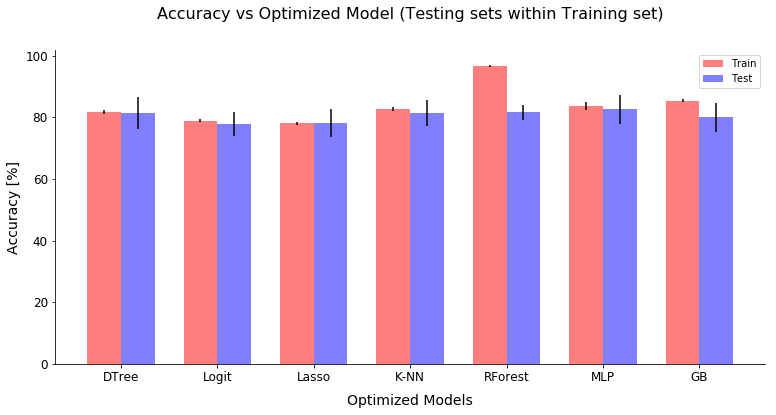

In [185]:
# Comparison Plot (Training bar plot)
# Data
TrainingR = np.zeros(7)
TrainingR[0] = RTree[0]
TrainingR[1] = RLogit[0]
TrainingR[2] = RLasso[0]
TrainingR[3] = RKnn[0]
TrainingR[4] = RForest[0]
TrainingR[5] = RMLP[0]
TrainingR[6] = RGB[0]

ErrorTrain = np.zeros(7)
ErrorTrain[0] = RTree[5]
ErrorTrain[1] = RLogit[5]
ErrorTrain[2] = RLasso[5]
ErrorTrain[3] = RKnn[5]
ErrorTrain[4] = RForest[5]
ErrorTrain[5] = RMLP[5]
ErrorTrain[6] = RGB[5]

TestingR = np.zeros(7)
TestingR[0] = RTree[1]
TestingR[1] = RLogit[1]
TestingR[2] = RLasso[1]
TestingR[3] = RKnn[1]
TestingR[4] = RForest[1]
TestingR[5] = RMLP[1]
TestingR[6] = RGB[1]

ErrorTest = np.zeros(7)
ErrorTest[0] = RTree[6]
ErrorTest[1] = RLogit[6]
ErrorTest[2] = RLasso[6]
ErrorTest[3] = RKnn[6]
ErrorTest[4] = RForest[6]
ErrorTest[5] = RMLP[6]
ErrorTest[6] = RGB[6]


Labels = ["DTree", "Logit", "Lasso", "K-NN", "RForest", "MLP", "GB"]

# Figure size
plt.figure(figsize = (11, 6)) 

# Font sizes
plt.rcParams['font.size'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 12

# axes
ax = plt.subplot(111)                    
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left() 

# Number of bars          
n_groups = len(TrainingR)

# Visual style
index = np.arange(n_groups)
bar_width = 0.35
opacity = 0.5

rects1 = plt.bar(index, TrainingR * 100, bar_width,
                 yerr = ErrorTrain * 100,
                 alpha = opacity,
                 color = 'r', 
                 label = 'Train')

rects2 = plt.bar(index + bar_width, TestingR * 100, bar_width,
                 yerr = ErrorTest * 100,
                 alpha = opacity,
                 color = 'b', 
                 label = 'Test')


# Labels, Title, and legends
plt.xlabel("Optimized Models", labelpad = 10)
plt.ylabel('Accuracy [%]')
plt.title("Accuracy vs Optimized Model (Testing sets within Training set)", y = 1.08)
plt.xticks(index + bar_width/2, Labels)
plt.legend()

plt.tight_layout()
plt.show()    

## Observations

### Define "performance" in the way you think is most appropriate for this problem, and justify that decision. What algorithm performs best? (You might want to consider more than one measures of performance)

- Performance: Since the problem consists of a classic binary classification prediction, and the fact that the $sciklean$ package can easily compute the Accuracy score of a fitted model, we will use the accuracy of each model (in %) as the main performance metric across all models. The idea is that models with better average testing set accuracies will tend to be more general (not overfitted) allowing us to make better predictions for out-of-the-sample data points. On the other hand, different approaches could be implemented in order to measure the performance of the models: number of true/false positive/negative, application of a confusion matrix with an underlying cost function, etc., however, in order to perform a simple, effective, and easy to follow analysis, we will define the performance of a model as the average accuracy on the testing sets among the 10-fold CV iterations.

Thus, we can obtain the following comparison table in order to contrast the performance of each implemented model:

| Model (testing optimized) | AVG Testing Accuracy [%] | AVG Training Accuracy [%] |  Testing Accuracy (Kaggle test.csv) [%]   |   Optimal Parameters                                          |
|---------------------------|--------------------------|---------------------------|-------------------------------------------------------------|----------------|
| Decision Tree             | 77.464                    | 81.754   |     75.119             | MD = 5, MSL = 29                                             |
| Logistic Regression       | 79.577                    | 79.122    |     76.076            | -                                                           |
| Lasso Regression          | 77.464                    | 78.070     |     76.555           | Lambda = 0.038                                             |
| K-Nearest Neighbors       | 80.985                    | 83.157      |     75.119          | K = 21, L = 1                                               |
| Random Forest             | 82.394                    | 95.964       |   74.162           | MD = 11, NTree = 100, MSL = 1                                |
| Multi-layer Perceptron    | 80.281                    | 85.263        |   76.076          | Act = "tanh", LR = "constant", NLayers = 6 (100 nodes each) |
| Gradient Boosting         | 81.690                    |85.087          |  73.205          | MD = 1, LR = 1, NTrees = 100                                |

Based on the previous plot (check the last chunk of code) and the previous summary table, we can see that the best models in terms of performance in the testing sets are the Random Forest and Gradient Boosting models, reaching an 82.39% of average accuracy when performing a 10-fold cross-validation approach with the RF model. Then, they are followed by the optimized K-NN model with 80.985% and then (very close) the Multi-layer Perceptron model, reaching an 80.28% of accuracy. On the fifth position, we can find the Logistic Regression model with a 79.577% of accuracy for the testing set. Finally, the Lasso Regression and the Decision Tree are the models with the worse performance among all the tested ones, reaching an AVG testing accuracy of 77.464%.

Therefore, both the Random Forest and the Gradient Boosting algorithms emerge as one of the most suitable models for predicting the chances of surviving the Titanic's accident.

For completeness, when looking at the results obtained by the algorithms in the prediction of the test.csv dataset from Kaggle, we can see that the best results are obtained by the Lasso Regression model ($76.55$% of accuracy) and the Logistic regression/Multi-Layer perceptron models (both with $76.067$% of accuracy). Hence, we can see that the performance of the models in the test.csv dataset, where we do not know the real labels and we can just obtain the accuracy from the Kaggle website via submission, is lower than the AVG accuracy obtained from the 10-fold Cross-validation method. In addition, important is to note the similar accuracies obtained along with all the models, with a particular mention to the lowest accuracy of the Gradient Boosting model ($73.205$%).

Important is to notice that in this version we will focus our analysis on the 20% of the original train.csv dataset - treated as a testing set - accuracy since that is the data that was not taken into account when fitting the model and that is part of the online Titanic survival prediction competition. In addition, we know the true labels (something that we did not have in the Version one of this PS).

### 3.2 Error analysis

Perform some error analysis to gain some intuition for where your models are not performing well. Are your models all having problems with the same individuals? Inspect this manually and report your results.

Now, do this a bit more systematically by creating a correlation matrix showing the correlation in predictions between each model. In other words, treat the output of each of your *M* models as a binary vector with one entry for each of the test data, and show how these prediction vectors relate to each other by plotting the *M* x *M* matrix of correlation coefficients. What do you observe?




In [195]:
# Informal Comparison: Differences in classifications
# Full training set (full train.csv file)
Tree_Log  = (y_hat_tree_train == y_hat_Logit_train).sum()
Tree_Lasso = (y_hat_tree_train == y_hat_lasso_train).sum()
Tree_Knn  = (y_hat_tree_train == y_hat_knn_train).sum()
Tree_RF   = (y_hat_tree_train == y_hat_RF_train).sum()
Tree_MLP  = (y_hat_tree_train == y_hat_MLP_train).sum()
Tree_GB   = (y_hat_tree_train == y_hat_GB_train).sum()
Log_Lasso = (y_hat_Logit_train == y_hat_lasso_train).sum()
Log_Knn   = (y_hat_Logit_train == y_hat_knn_train).sum()
Log_RF    = (y_hat_Logit_train == y_hat_RF_train).sum()
Log_MLP   = (y_hat_Logit_train == y_hat_MLP_train).sum()
Log_GB    = (y_hat_Logit_train == y_hat_GB_train).sum()
Lasso_Knn = (y_hat_lasso_train == y_hat_knn_train).sum()
Lasso_RF  = (y_hat_lasso_train == y_hat_RF_train).sum()
Lasso_MLP = (y_hat_lasso_train == y_hat_MLP_train).sum()
Lasso_GB  = (y_hat_lasso_train == y_hat_GB_train).sum()
Knn_RF    = (y_hat_knn_train == y_hat_RF_train).sum()
Knn_MLP   = (y_hat_knn_train == y_hat_MLP_train).sum()
Knn_GB    = (y_hat_knn_train == y_hat_GB_train).sum()
RF_MLP    = (y_hat_RF_train == y_hat_MLP_train).sum()
RF_GB     = (y_hat_RF_train == y_hat_GB_train).sum()
MLP_GB    = (y_hat_MLP_train == y_hat_GB_train).sum()

# Full testing set (remaining 20%)
Tree_LogT  = (y_hat_tree_test == y_hat_Logit_test).sum()
Tree_LassoT = (y_hat_tree_test == y_hat_lasso_test).sum()
Tree_KnnT  = (y_hat_tree_test == y_hat_knn_test).sum()
Tree_RFT   = (y_hat_tree_test == y_hat_RF_test).sum()
Tree_MLPT  = (y_hat_tree_test == y_hat_MLP_test).sum()
Tree_GBT   = (y_hat_tree_test == y_hat_GB_test).sum()
Log_LassoT = (y_hat_Logit_test == y_hat_lasso_test).sum()
Log_KnnT   = (y_hat_Logit_test == y_hat_knn_test).sum()
Log_RFT    = (y_hat_Logit_test == y_hat_RF_test).sum()
Log_MLPT   = (y_hat_Logit_test == y_hat_MLP_test).sum()
Log_GBT    = (y_hat_Logit_test == y_hat_GB_test).sum()
Lasso_KnnT = (y_hat_lasso_test == y_hat_knn_test).sum()
Lasso_RFT  = (y_hat_lasso_test == y_hat_RF_test).sum()
Lasso_MLPT = (y_hat_lasso_test == y_hat_MLP_test).sum()
Lasso_GBT  = (y_hat_lasso_test == y_hat_GB_test).sum()
Knn_RFT    = (y_hat_knn_test == y_hat_RF_test).sum()
Knn_MLPT   = (y_hat_knn_test == y_hat_MLP_test).sum()
Knn_GBT    = (y_hat_knn_test == y_hat_GB_test).sum()
RF_MLPT    = (y_hat_RF_test == y_hat_MLP_test).sum()
RF_GBT     = (y_hat_RF_test == y_hat_GB_test).sum()
MLP_GBT    = (y_hat_MLP_test == y_hat_GB_test).sum()

# Print information (training set)
print("Total number of equal classification (Full training set)")
print("DTree and Logit equals:", Tree_Log, "(", Tree_Log/len(X) * 100, "[%])")
print("DTree and Lasso equals: ", Tree_Lasso, "(", Tree_Lasso/len(X) * 100, "[%])")
print("DTree and Knn equals:", Tree_Knn, "(", Tree_Knn/len(X) * 100, "[%])")
print("DTree and RF equals: ", Tree_RF, "(", Tree_RF/len(X) * 100, "[%])")
print("DTree and MLP equals:", Tree_MLP, "(", Tree_MLP/len(X) * 100, "[%])")
print("DTree and GB equals: ", Tree_GB, "(", Tree_GB/len(X) * 100, "[%])")
print("Logit and Lasso equals:", Log_Lasso, "(", Log_Lasso/len(X) * 100, "[%])")
print("Logit and Knn equals:", Log_Knn, "(", Log_Knn/len(X) * 100, "[%])")
print("Logit and RF equals: ", Log_RF, "(", Log_RF/len(X) * 100, "[%])")
print("Logit and MLP equals:", Log_MLP, "(", Log_MLP/len(X) * 100, "[%])")
print("Logit and GB equals: ", Log_GB, "(", Log_GB/len(X) * 100, "[%])")
print("Lasso and Knn equals:", Lasso_Knn, "(", Lasso_Knn/len(X) * 100, "[%])")
print("Lasso and RF equals: ", Lasso_RF, "(", Lasso_RF/len(X) * 100, "[%])")
print("Lasso and MLP equals:", Lasso_MLP, "(", Lasso_MLP/len(X) * 100, "[%])")
print("Lasso and GB equals: ", Lasso_GB, "(", Lasso_GB/len(X) * 100, "[%])")
print("Knn and RF equals:   ", Knn_RF, "(", Knn_RF/len(X) * 100, " [%])")
print("Knn and MLP equals:  ", Knn_MLP, "(", Knn_MLP/len(X) * 100, "[%])")
print("Knn and GB equals:   ", Knn_GB, "(", Knn_GB/len(X) * 100, "[%])")
print("RF and MLP equals:   ", RF_MLP, "(", RF_MLP/len(X) * 100, "[%])")
print("RF and GB equals:    ", RF_GB, "(", RF_GB/len(X) * 100, "[%])")
print("MLP and GB equals:   ", MLP_GB, "(", MLP_GB/len(X) * 100, "[%])")

# Print information (testing set)
print("\nTotal number of equal classification (Full testing set)")
print("DTree and Logit equals:", Tree_LogT, "(", Tree_LogT/len(Xtest) * 100, "[%])")
print("DTree and Lasso equals: ", Tree_LassoT, "(", Tree_LassoT/len(Xtest) * 100, "[%])")
print("DTree and Knn equals:", Tree_KnnT, "(", Tree_KnnT/len(Xtest) * 100, "[%])")
print("DTree and RF equals: ", Tree_RFT, "(", Tree_RFT/len(Xtest) * 100, "[%])")
print("DTree and MLP equals:", Tree_MLPT, "(", Tree_MLPT/len(Xtest) * 100, "[%])")
print("DTree and GB equals: ", Tree_GBT, "(", Tree_GBT/len(Xtest) * 100, "[%])")
print("Logit and Lasso equals:", Log_LassoT, "(", Log_LassoT/len(Xtest) * 100, "[%])")
print("Logit and Knn equals:", Log_KnnT, "(", Log_KnnT/len(Xtest) * 100, "[%])")
print("Logit and RF equals: ", Log_RFT, "(", Log_RFT/len(Xtest) * 100, "[%])")
print("Logit and MLP equals:", Log_MLPT, "(", Log_MLPT/len(Xtest) * 100, "[%])")
print("Logit and GB equals: ", Log_GBT, "(", Log_GBT/len(Xtest) * 100, "[%])")
print("Lasso and Knn equals:", Lasso_KnnT, "(", Lasso_KnnT/len(Xtest) * 100, " [%])")
print("Lasso and RF equals: ", Lasso_RFT, "(", Lasso_RFT/len(Xtest) * 100, "[%])")
print("Lasso and MLP equals:", Lasso_MLPT, "(", Lasso_MLPT/len(Xtest) * 100, "[%])")
print("Lasso and GB equals: ", Lasso_GBT, "(", Lasso_GBT/len(Xtest) * 100, " [%])")
print("Knn and RF equals:   ", Knn_RFT, "(", Knn_RFT/len(Xtest) * 100, "[%])")
print("Knn and MLP equals:  ", Knn_MLPT, "(", Knn_MLPT/len(Xtest) * 100, "[%])")
print("Knn and GB equals:   ", Knn_GBT, "(", Knn_GBT/len(Xtest) * 100, " [%])")
print("RF and MLP equals:   ", RF_MLPT, "(", RF_MLPT/len(Xtest) * 100, "[%])")
print("RF and GB equals:    ", RF_GBT, "(", RF_GBT/len(Xtest) * 100, "[%])")
print("MLP and GB equals:   ", MLP_GBT, "(", MLP_GBT/len(Xtest) * 100, "[%])")

Total number of equal classification (Full training set)
DTree and Logit equals: 511 ( 89.649122807 [%])
DTree and Lasso equals:  493 ( 86.4912280702 [%])
DTree and Knn equals: 500 ( 87.7192982456 [%])
DTree and RF equals:  483 ( 84.7368421053 [%])
DTree and MLP equals: 510 ( 89.4736842105 [%])
DTree and GB equals:  517 ( 90.701754386 [%])
Logit and Lasso equals: 546 ( 95.7894736842 [%])
Logit and Knn equals: 487 ( 85.4385964912 [%])
Logit and RF equals:  472 ( 82.8070175439 [%])
Logit and MLP equals: 495 ( 86.8421052632 [%])
Logit and GB equals:  516 ( 90.5263157895 [%])
Lasso and Knn equals: 469 ( 82.2807017544 [%])
Lasso and RF equals:  466 ( 81.7543859649 [%])
Lasso and MLP equals: 483 ( 84.7368421053 [%])
Lasso and GB equals:  500 ( 87.7192982456 [%])
Knn and RF equals:    495 ( 86.8421052632  [%])
Knn and MLP equals:   534 ( 93.6842105263 [%])
Knn and GB equals:    503 ( 88.2456140351 [%])
RF and MLP equals:    505 ( 88.5964912281 [%])
RF and GB equals:     506 ( 88.7719298246 [%

In [196]:
# Different rows and matrix
# Create the Matrix (DataFrame for training set)
PredMatrix2 = pd.DataFrame({"Dtree": y_hat_tree_train,
                           "Logit": y_hat_Logit_train,
                           "Lasso": y_hat_lasso_train.astype(int),
                           "K-NN": y_hat_knn_train,
                           "Random_Forest": y_hat_RF_train, 
                           "ML_Perceptron": y_hat_MLP_train,
                           "GB": y_hat_GB_train})

PredMatrix2 = PredMatrix2[["Dtree", "Logit", "Lasso", "K-NN",
                           "Random_Forest", "ML_Perceptron", "GB"]]

# Check new matrix
display(PredMatrix2.head())

print("\nDiff rows Dtree vs Logit:\n", 
      PredMatrix2.loc[PredMatrix2["Dtree"] != PredMatrix2["Logit"]].index)
print("\nDiff rows Dtree vs Lasso:\n", 
      PredMatrix2.loc[PredMatrix2["Dtree"] != PredMatrix2["Lasso"]].index)
print("Diff rows Dtree vs K-NN:\n", 
      PredMatrix2.loc[PredMatrix2["Dtree"] != PredMatrix2["K-NN"]].index)
print("\nDiff rows Dtree vs Random_Forest:\n", 
      PredMatrix2.loc[PredMatrix2["Dtree"] != PredMatrix2["Random_Forest"]].index)
print("\nDiff rows Dtree vs ML_Perceptron:\n", 
      PredMatrix2.loc[PredMatrix2["Dtree"] != PredMatrix2["ML_Perceptron"]].index)
print("\nDiff rows Dtree vs GB:\n", 
      PredMatrix2.loc[PredMatrix2["Dtree"] != PredMatrix2["GB"]].index)

print("Diff rows Logit vs Lasso:\n", 
      PredMatrix2.loc[PredMatrix2["Logit"] != PredMatrix2["Lasso"]].index)
print("\nDiff rows Logit vs K-NN:\n", 
      PredMatrix2.loc[PredMatrix2["Logit"] != PredMatrix2["K-NN"]].index)
print("\nDiff rows Logit vs Random_Forest:\n", 
      PredMatrix2.loc[PredMatrix2["Logit"] != PredMatrix2["Random_Forest"]].index)
print("\nDiff rows Logit vs ML_Perceptron:\n", 
      PredMatrix2.loc[PredMatrix2["Logit"] != PredMatrix2["ML_Perceptron"]].index)
print("\nDiff rows Logit vs GB:\n", 
      PredMatrix2.loc[PredMatrix2["Logit"] != PredMatrix2["GB"]].index)

print("Diff rows Lasso vs K-NN:\n", 
      PredMatrix2.loc[PredMatrix2["Lasso"] != PredMatrix2["K-NN"]].index)
print("\nDiff rows Lasso vs Random_Forest:\n", 
      PredMatrix2.loc[PredMatrix2["Lasso"] != PredMatrix2["Random_Forest"]].index)
print("\nDiff rows Lasso vs ML_Perceptron:\n", 
      PredMatrix2.loc[PredMatrix2["Lasso"] != PredMatrix2["ML_Perceptron"]].index)
print("\nDiff rows Lasso vs GB:\n", 
      PredMatrix2.loc[PredMatrix2["Lasso"] != PredMatrix2["GB"]].index)

print("\nDiff rows K-NN vs Random_Forest:\n", 
      PredMatrix2.loc[PredMatrix2["K-NN"] != PredMatrix2["Random_Forest"]].index)
print("\nDiff rows K-NN vs ML_Perceptron:\n", 
      PredMatrix2.loc[PredMatrix2["K-NN"] != PredMatrix2["ML_Perceptron"]].index)
print("\nDiff rows K-NN vs GB:\n", 
      PredMatrix2.loc[PredMatrix2["K-NN"] != PredMatrix2["GB"]].index)

print("\nDiff rows Random_Forest vs ML_Perceptron:\n", 
      PredMatrix2.loc[PredMatrix2["Random_Forest"] != PredMatrix2["ML_Perceptron"]].index)
print("\nDiff rows Random_Forest vs GB:\n", 
      PredMatrix2.loc[PredMatrix2["Random_Forest"] != PredMatrix2["GB"]].index)

print("\nDiff rows ML_Perceptron vs GB:\n", 
      PredMatrix2.loc[PredMatrix2["ML_Perceptron"] != PredMatrix2["GB"]].index)

,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB
0,0,0,0,0,0,0,0
1,1,1,1,1,1,1,1
2,1,1,1,0,1,0,1
3,1,1,1,1,1,1,1
4,0,0,0,0,0,0,0



Diff rows Dtree vs Logit:
 Int64Index([ 14,  17,  18,  22,  24,  29,  39,  48,  58,  62,  66,  67,  71,
             84,  86,  90, 112, 143, 157, 174, 207, 211, 228, 231, 237, 242,
            245, 263, 268, 273, 283, 286, 302, 303, 320, 345, 351, 357, 377,
            380, 387, 399, 400, 407, 408, 414, 425, 439, 445, 459, 470, 493,
            497, 507, 530, 543, 553, 555, 568],
           dtype='int64')

Diff rows Dtree vs Lasso:
 Int64Index([ 14,  17,  18,  19,  22,  24,  29,  48,  50,  58,  62,  66,  67,
             70,  71,  77,  84,  86,  90, 101, 112, 143, 156, 157, 174, 191,
            207, 211, 225, 228, 230, 231, 233, 237, 242, 245, 263, 268, 273,
            275, 281, 283, 286, 303, 315, 320, 339, 340, 345, 351, 357, 377,
            380, 383, 387, 399, 400, 404, 407, 408, 414, 425, 431, 439, 445,
            459, 468, 470, 497, 507, 510, 519, 530, 543, 553, 555, 568],
           dtype='int64')
Diff rows Dtree vs K-NN:
 Int64Index([  2,   9,  17,  26,  39,  45,  48,  61, 

In [197]:
# Different rows and matrix
# Create the Matrix (DataFrame for testing set)
PredMatrixTest2 = pd.DataFrame({"Dtree": y_hat_tree_test,
                               "Logit": y_hat_Logit_test,
                               "Lasso": y_hat_lasso_test.astype(int),
                               "K-NN": y_hat_knn_test,
                               "Random_Forest": y_hat_RF_test, 
                               "ML_Perceptron": y_hat_MLP_test,
                               "GB": y_hat_GB_test})

PredMatrixTest2 = PredMatrixTest2[["Dtree", "Logit", "Lasso", 
                                   "K-NN", "Random_Forest", "ML_Perceptron", "GB"]]

# Check new matrix
display(PredMatrixTest2.head())

print("\nDiff rows Dtree vs Logit:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Dtree"] != PredMatrixTest2["Logit"]].index)
print("\nDiff rows Dtree vs Lasso:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Dtree"] != PredMatrixTest2["Lasso"]].index)
print("Diff rows Dtree vs K-NN:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Dtree"] != PredMatrixTest2["K-NN"]].index)
print("\nDiff rows Dtree vs Random_Forest:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Dtree"] != PredMatrixTest2["Random_Forest"]].index)
print("\nDiff rows Dtree vs ML_Perceptron:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Dtree"] != PredMatrixTest2["ML_Perceptron"]].index)
print("\nDiff rows Dtree vs GB:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Dtree"] != PredMatrixTest2["GB"]].index)

print("Diff rows Logit vs Lasso:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Logit"] != PredMatrixTest2["Lasso"]].index)
print("\nDiff rows Logit vs K-NN:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Logit"] != PredMatrixTest2["K-NN"]].index)
print("\nDiff rows Logit vs Random_Forest:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Logit"] != PredMatrixTest2["Random_Forest"]].index)
print("\nDiff rows Logit vs ML_Perceptron:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Logit"] != PredMatrixTest2["ML_Perceptron"]].index)
print("\nDiff rows Logit vs GB:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Logit"] != PredMatrixTest2["GB"]].index)

print("Diff rows Lasso vs K-NN:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Lasso"] != PredMatrixTest2["K-NN"]].index)
print("\nDiff rows Lasso vs Random_Forest:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Lasso"] != PredMatrixTest2["Random_Forest"]].index)
print("\nDiff rows Lasso vs ML_Perceptron:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Lasso"] != PredMatrixTest2["ML_Perceptron"]].index)
print("\nDiff rows Lasso vs GB:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Lasso"] != PredMatrixTest2["GB"]].index)

print("\nDiff rows K-NN vs Random_Forest:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["K-NN"] != PredMatrixTest2["Random_Forest"]].index + 891)
print("\nDiff rows K-NN vs ML_Perceptron:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["K-NN"] != PredMatrixTest2["ML_Perceptron"]].index + 891)
print("\nDiff rows K-NN vs GB:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["K-NN"] != PredMatrixTest2["GB"]].index + 891)

print("\nDiff rows Random_Forest vs ML_Perceptron:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Random_Forest"] != PredMatrixTest2["ML_Perceptron"]].index + 891)
print("\nDiff rows Random_Forest vs GB:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["Random_Forest"] != PredMatrixTest2["GB"]].index + 891)

print("\nDiff rows ML_Perceptron vs GB:\n", 
      PredMatrixTest2.loc[PredMatrixTest2["ML_Perceptron"] != PredMatrixTest2["GB"]].index + 891) 

,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB
0,0,1,1,1,1,1,1
1,0,0,0,0,0,0,0
2,1,1,1,1,1,1,1
3,1,1,1,1,1,1,0
4,0,0,0,0,0,0,0



Diff rows Dtree vs Logit:
 Int64Index([0, 74, 75, 79, 96, 104, 110, 117, 136], dtype='int64')

Diff rows Dtree vs Lasso:
 Int64Index([0, 11, 74, 75, 79, 93, 96, 104, 110, 117, 136, 141], dtype='int64')
Diff rows Dtree vs K-NN:
 Int64Index([  0,  13,  17,  20,  26,  45,  71,  73,  74,  75,  79,  80,  90,
             93,  97, 101, 110, 117, 127, 128, 136, 138, 141],
           dtype='int64')

Diff rows Dtree vs Random_Forest:
 Int64Index([  0,  13,  46,  67,  71,  73,  74,  75,  79,  80,  90,  97, 104,
            116, 117, 127, 128, 136, 138],
           dtype='int64')

Diff rows Dtree vs ML_Perceptron:
 Int64Index([  0,  13,  20,  45,  46,  68,  71,  73,  74,  75,  79,  90,  93,
             96, 101, 104, 110, 116, 122, 127, 128, 136, 138, 141],
           dtype='int64')

Diff rows Dtree vs GB:
 Int64Index([0, 3, 13, 73, 74, 75, 79, 90, 93, 97, 102, 113, 128, 136], dtype='int64')
Diff rows Logit vs Lasso:
 Int64Index([11, 93, 141], dtype='int64')

Diff rows Logit vs K-NN:
 Int64Index

Min Corr: 0.612015064902 Max Corr: 0.909467657875
Variables with minimum correlation
 Lasso
 Random_Forest
Variables with maximum correlation
 Logit
 Lasso


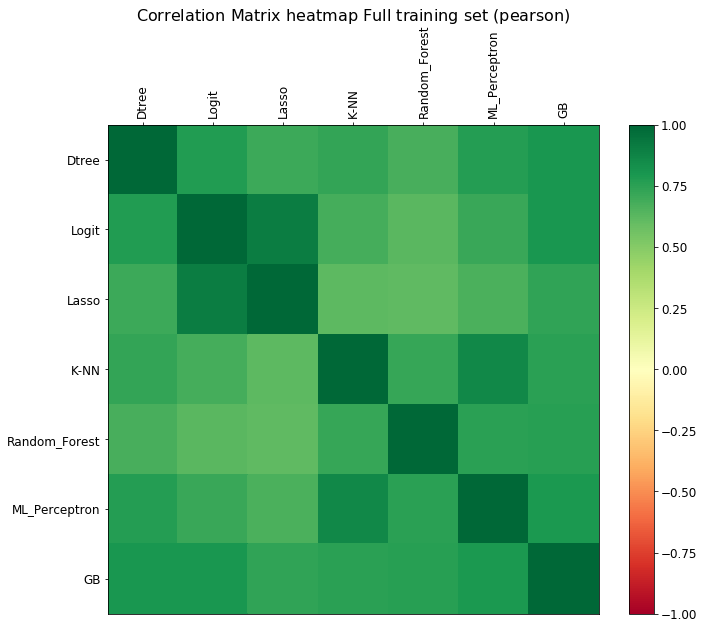

In [198]:
# Correlation map
# Relevant plots (Correlation Heatmap)
# Correlation matrix
corrT2 = PredMatrix2.corr()            #Correlation matrix
xlabels = PredMatrix2.columns          #X labels
ylabels = PredMatrix2.columns          #X labels

# Figure size and axes
fig, ax = plt.subplots(figsize = (11, 9))
ax.set_xticks(np.arange(PredMatrix2.shape[1]) + 0.5, minor=False)
ax.set_yticks(np.arange(PredMatrix2.shape[0]) + 0.5, minor=False)
ax.invert_yaxis()
ax.xaxis.tick_top()
plt.xticks(rotation = 90)
ax.set_xticklabels(xlabels, minor = False)
ax.set_yticklabels(ylabels, minor = False)

# Plot the heatmap and colorbar. Add title
heatmap = plt.pcolor(corrT2, cmap = 'RdYlGn', vmin = -1, vmax = corrT2.max().max())
plt.title(r'$\mathrm{Correlation\ Matrix\ heatmap\ Full\ training\ set\ (pearson)}$', y = 1.2)
plt.colorbar()


# Analysis: Min and Max (below 1) correlations
minCorr = corrT2.min().min()
corrT2 = corrT2[corrT2 < 1]
maxCorr = corrT2.max().max()
print("Min Corr:", minCorr, "Max Corr:", maxCorr)

# New dfs with min and max correlations
corrmins = pd.DataFrame(corrT2.min(), columns = ['MinCorr'])
corrmaxs = pd.DataFrame(corrT2.max(), columns = ['MaxCorr'])

# Get variable names for max/min correlations
print('Variables with minimum correlation') 
for i in corrmins[corrmins['MinCorr'] == minCorr].index.tolist():
    print("", i)

print('Variables with maximum correlation') 
for i in corrmaxs[corrmaxs['MaxCorr'] == maxCorr].index.tolist():
    print("", i)

In [199]:
# Correlation matrix (values)
print("Correlation matrix values (training)")
display(corrT2)

Correlation matrix values (training)


,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB
Dtree,NaN,0.773550,0.708137,0.732903,0.674041,0.770499,0.803948
Logit,0.773550,NaN,0.909468,0.682987,0.632406,0.712830,0.800272
Lasso,0.708137,0.909468,NaN,0.618240,0.612015,0.670651,0.740420
K-NN,0.732903,0.682987,0.618240,NaN,0.719646,0.862907,0.751342
Random_Forest,0.674041,0.632406,0.612015,0.719646,NaN,0.757064,0.763609
ML_Perceptron,0.770499,0.712830,0.670651,0.862907,0.757064,NaN,0.796312
GB,0.803948,0.800272,0.740420,0.751342,0.763609,0.796312,NaN


Min Corr: 0.631088877164 Max Corr: 0.954940139472
Variables with minimum correlation
 Dtree
 ML_Perceptron
Variables with maximum correlation
 Logit
 Lasso


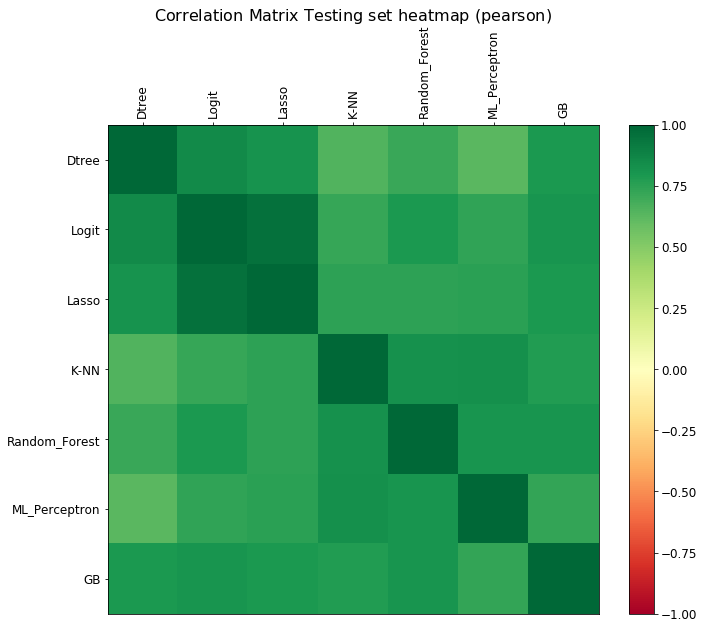

In [214]:
# Correlation map
# Relevant plots (Correlation Heatmap)
# Correlation matrix
corrTT2 = PredMatrixTest2.corr()             # Correlation matrix
xlabels = PredMatrixTest2.columns          # X labels
ylabels = PredMatrixTest2.columns          # Y labels

# Figure size and axes
fig, ax = plt.subplots(figsize = (11, 9))
ax.set_xticks(np.arange(PredMatrixTest2.shape[1]) + 0.5, minor=False)
ax.set_yticks(np.arange(PredMatrixTest2.shape[0]) + 0.5, minor=False)
ax.invert_yaxis()
ax.xaxis.tick_top()
plt.xticks(rotation = 90)
ax.set_xticklabels(xlabels, minor = False)
ax.set_yticklabels(ylabels, minor = False)

# Plot the heatmap and colorbar. Add title
heatmap = plt.pcolor(corrTT2, cmap = 'RdYlGn', vmin = -1, vmax = corrTT2.max().max())
plt.title(r'$\mathrm{Correlation\ Matrix\ Testing\ set\ heatmap\ (pearson)}$', 
          y = 1.2)
plt.colorbar()


# Analysis: Min and Max (below 1) correlations
minCorr = corrTT2.min().min()
corrTT2 = corrTT2[corrTT2 < 1]
maxCorr = corrTT2.max().max()
print("Min Corr:", minCorr, "Max Corr:", maxCorr)

# New dfs with min and max correlations
corrmins = pd.DataFrame(corrTT2.min(), columns = ['MinCorr'])
corrmaxs = pd.DataFrame(corrTT2.max(), columns = ['MaxCorr'])

# Get variable names for max/min correlations
print('Variables with minimum correlation') 
for i in corrmins[corrmins['MinCorr'] == minCorr].index.tolist():
    print("", i)

print('Variables with maximum correlation') 
for i in corrmaxs[corrmaxs['MaxCorr'] == maxCorr].index.tolist():
    print("", i)

In [215]:
# Correlation matrix (values)
print("Correlation matrix values (testing)")
display(corrTT2)

Correlation matrix values (testing)


,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB
Dtree,NaN,0.859201,0.816498,0.648984,0.715378,0.631089,0.794161
Logit,0.859201,NaN,0.954940,0.726224,0.791287,0.739700,0.808588
Lasso,0.816498,0.954940,NaN,0.743222,0.745952,0.757265,0.792415
K-NN,0.648984,0.726224,0.743222,NaN,0.821111,0.833890,0.777552
Random_Forest,0.715378,0.791287,0.745952,0.821111,NaN,0.805966,0.807837
ML_Perceptron,0.631089,0.739700,0.757265,0.833890,0.805966,NaN,0.732594
GB,0.794161,0.808588,0.792415,0.777552,0.807837,0.732594,NaN


### 3.3 Develop an ensemble

Create an ensemble learner by hand. Using all of the training data, fit each of the models in 3.1. Then, classify each instance in the test data by taking the majority vote of all of your different fitted models. How accurately do you predict survival? How does this compare to your earlier results? 

*Note:* You will have to decide how to handle tie votes

In [203]:
# Ensemble voting (training set)
PredMatrix2["SumVote"] = PredMatrix2.sum(axis = 1)

# If majority 1, then Survived = 1
mask = PredMatrix2.SumVote >= 4
column_name = 'Survived'
PredMatrix2.loc[mask, column_name] = 1

# Otherwise Survived = 0
mask = PredMatrix2.SumVote < 4
column_name = 'Survived'
PredMatrix2.loc[mask, column_name] = 0

# Drop the summation column
PredMatrix = PredMatrix2.drop(["SumVote"], axis = 1)
display(PredMatrix2.head())

# Final prediction
y_hat_ensemble_train2 = PredMatrix2.Survived.astype(int)

# Accuracy
print("Accuracy ensemble training:", 
      (np.array(y_hat_ensemble_train2) == np.array(Y)).sum().astype(float) / len(y_hat_ensemble_train2))

,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB,SumVote,Survived
0,0,0,0,0,0,0,0,0,0.0
1,1,1,1,1,1,1,1,7,1.0
2,1,1,1,0,1,0,1,5,1.0
3,1,1,1,1,1,1,1,7,1.0
4,0,0,0,0,0,0,0,0,0.0


Accuracy ensemble training: 0.857894736842


In [208]:
# Ensemble voting (testing set 20%)
PredMatrixTest2["SumVote"] = PredMatrixTest2.sum(axis = 1)

# If majority 1, then Survived = 1
mask = PredMatrixTest2.SumVote >= 4
column_name = 'Survived'
PredMatrixTest2.loc[mask, column_name] = 1

# Otherwise Survived = 0
mask = PredMatrixTest2.SumVote < 4
column_name = 'Survived'
PredMatrixTest2.loc[mask, column_name] = 0

# Drop the summation column
PredMatrixTest2 = PredMatrixTest2.drop(["SumVote"], axis = 1)
display(PredMatrixTest2.head())

# Final prediction
y_hat_ensemble_test2 = PredMatrixTest2.Survived.astype(int)

# Accuracy
print("Accuracy ensemble testing:", 
      (np.array(y_hat_ensemble_test2) == np.array(Ytest)).sum().astype(float) / len(y_hat_ensemble_test2))

,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB,Survived
0,0,1,1,1,1,1,1,1.0
1,0,0,0,0,0,0,0,0.0
2,1,1,1,1,1,1,1,1.0
3,1,1,1,1,1,1,0,1.0
4,0,0,0,0,0,0,0,0.0


Accuracy ensemble testing: 0.795774647887


In [209]:
# Create the Matrix (DataFrame for testing set in Kaggle)
PredMatrixTest22 = pd.DataFrame({"Dtree": y_hat_tree_test2,
                               "Logit": y_hat_Logit_test2,
                               "Lasso": y_hat_lasso_test2.astype(int),
                               "K-NN": y_hat_knn_test2,
                               "Random_Forest": y_hat_RF_test2, 
                               "ML_Perceptron": y_hat_MLP_test2,
                               "GB": y_hat_GB_test2})

PredMatrixTest22 = PredMatrixTest22[["Dtree", "Logit", "Lasso", "K-NN", 
                                     "Random_Forest", "ML_Perceptron", "GB"]]

# Check new matrix
display(PredMatrixTest22.head())

,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB
0,0,0,0,0,0,0,0
1,1,0,1,0,0,0,0
2,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0
4,1,1,1,1,1,1,1


In [210]:
# Ensemble voting (testing set in Kaggle)
PredMatrixTest22["SumVote"] = PredMatrixTest22.sum(axis = 1)

# If majority 1, then Survived = 1
mask = PredMatrixTest22.SumVote >= 4
column_name = 'Survived'
PredMatrixTest22.loc[mask, column_name] = 1

# Otherwise Survived = 0
mask = PredMatrixTest22.SumVote < 4
column_name = 'Survived'
PredMatrixTest22.loc[mask, column_name] = 0

# Drop the summation column
PredMatrixTest22 = PredMatrixTest22.drop(["SumVote"], axis = 1)
display(PredMatrixTest2.head())

# Final prediction
y_hat_ensemble_test22 = PredMatrixTest22.Survived.astype(int)

# Testing Kaggle File
createKaggleFile(y_hat_ensemble_test22, "EnsembleOpt2")

,Dtree,Logit,Lasso,K-NN,Random_Forest,ML_Perceptron,GB,Survived
0,0,1,1,1,1,1,1,1.0
1,0,0,0,0,0,0,0,0.0
2,1,1,1,1,1,1,1,1.0
3,1,1,1,1,1,1,0,1.0
4,0,0,0,0,0,0,0,0.0


# End of the code...
### Just as a recommendation for next semesters: try to be very explicit about the testing set that will be used in the PS since I realized that the test.csv file was not the one asked in this PS (originally) after talking with the TA via email about it, so I needed to re-do the entire homework with my second version (split the train.csv dataset into 80% of training set and 20% as testing set).

### On the other hand, it has been a super nice course!, I really enjoyed it!. PSets are nice and useful. Thanks for a good semester.